# Restricted Boltzmann Machine - MNIST

## Imports

In [14]:
!pip install --upgrade numpy

In [15]:
import sys, datetime
import os
# numpy
import numpy as np
from numpy import exp,sqrt,log,log10,sign,power,cosh,sinh,tanh,floor
rng = np.random.default_rng(12345)
np.set_printoptions(precision=4)

# matplotlib
import matplotlib as mpl
%matplotlib inline
from matplotlib.ticker import NullFormatter, MaxNLocator
mpl.rcParams.update({"font.size": 12})  #"text.usetex": True,})
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt

# to load MNIST
from sklearn.datasets import fetch_openml

!mkdir FIG
!mkdir FIG/FRAME
#!mkdir WEIGHTS
!mkdir DATA
if not os.path.exists('GRAPHS'):
    os.makedirs('GRAPHS')


mkdir: cannot create directory ‘FIG’: File exists
mkdir: cannot create directory ‘FIG/FRAME’: File exists
mkdir: cannot create directory ‘DATA’: File exists


## Load data

In [16]:
#import dill
#import IPython.display

#from IPython.core.display import display, HTML

# Attempt to load the session:
#try:
#dill.load_session('/content/save_ll_1.7 - Copia.db')
#except AttributeError:
    #print("Error loading session. Consider using a compatible IPython version or manually editing the session file.")
    # If you choose to edit manually, carefully inspect and modify the problematic object reference.
    # Refer to dill documentation for guidance on inspecting saved objects: https://dill.readthedocs.io/en/latest/
    # Use with caution as manual editing can corrupt the session file.

X_original, Y_original = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)
print(X_original.shape)

(70000, 784)


## Parameters

In [17]:
################################
#    CHOICE OF PARAMETERS      #
################################
# number of MNIST digits to keep (e.g., Ndigit=3 keeps 0,1,2)
Ndigit=3
# number of hidden units
L = 3
# use (+1,-1) if SPINS, otherwise use bits (1,0)
SPINS=False
# use one-hot encoding in hidden space if POTTS (use only if SPINS=False)
POTTS=False

dname='DATA/'
################################

# x_min =0 if bits, x_min=-1 if SPINS
# level_gap is the difference in values between the max (1) and the min (x_min)
if SPINS:
    x_min=-1
    level_gap=2.
else:
    x_min=0
    level_gap=1.

if POTTS:
    str_simul="RBM_Potts"
    # in one-hot encoding, number of possible hidden states matches L
    Nz=L
else:
    str_simul="RBM"
    # number of possible hidden states: 2**L
    Nz=2**L

if POTTS and SPINS:
    print("\n\n>>>>>>>> WARNING:  POTTS and SPINS cannot coexist\n\n")

## Select data, and digitalize them two levels

('1', '4', '7')
dataset with 21994 points, each with 784 bits

first 10 MNIST data points


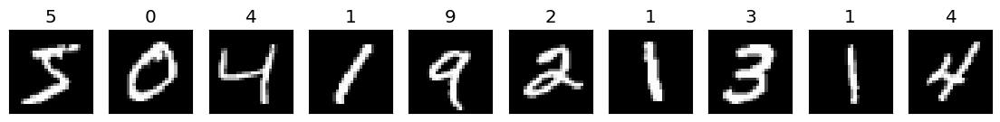

first 10 MNIST-3 data points


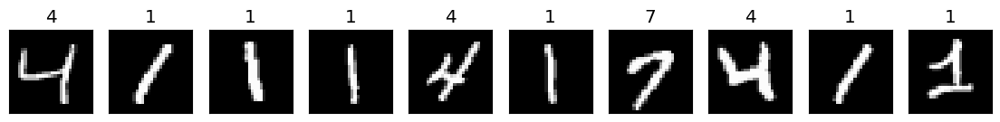

first 10 MNIST-3 data points, binarized


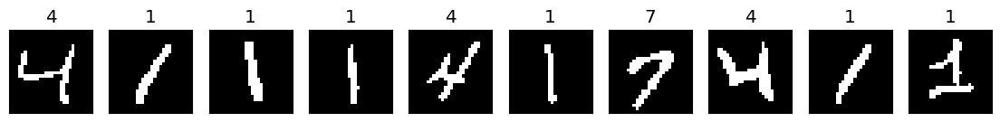

each of Nd=21994 data has D=784 bits


In [18]:
def show_MNIST(x, y=[], z=[], Nex=5, S=1.4, side=0, colors=[]):
    """Show digits"""
    if side==0: side = int(sqrt(x.shape[1]))
    if len(y)<1: y=np.full(Nex,"")
    colors=np.array(colors)
    fig, AX = plt.subplots(1,Nex,figsize=(S*Nex,S))

    for i, img in enumerate(x[:Nex].reshape(Nex, side, side)):
        if len(colors)==0: newcmp = "gray"
        else:
            col= colors[0] + (colors[1]-colors[0])*(i+1)/(Nex+1)
            newcmp = ListedColormap((col,(1,1,1,1)))
        ax=AX[i]
        ax.imshow(img, cmap=newcmp)
        ax.set_xticks([])
        ax.set_yticks([])
        if len(y)>0: ax.set_title(y[i])
        if len(z)>0: ax.set_title(''.join(map(str, z[i])),fontsize=9)
    plt.show()

def MNIST_bit(X,side=28,level=0.5):
    NX=len(X)
    #print(X.shape)
    print(f"dataset with {NX} points, each with {len(X[0])} bits\n")
    if side==14:
        X = np.reshape(X,(NX,28,28))
        # new value = average over 4 values in a 2x2 square
        Xr = 0.25*(X[:,0::2,0::2]+X[:,1::2,0::2]+X[:,0::2,1::2]+X[:,1::2,1::2])
        X  = Xr.reshape(NX,side**2)
    #print(X.shape)
    # binarize data and then convert it to 1/0 or 1/-1
    X = np.where(X/255 > level, 1, x_min)
    return X.astype("int")

list_10_digits = ('0','1','2','3','4','5','6','7','8','9')
list_digits = list_10_digits[1:8:Ndigit]
print(list_digits)
keep=np.isin(Y_original, list_digits)
X_keep,Y=X_original[keep],Y_original[keep]

data,label = MNIST_bit(X_keep),Y
data,label = data.astype("int"),label.astype("int")
print("first 10 MNIST data points")
show_MNIST(X_original, Y_original,Nex=10)
print(f"first 10 MNIST-{Ndigit} data points")
show_MNIST(X_keep, label,Nex=10)
print(f"first 10 MNIST-{Ndigit} data points, binarized")
show_MNIST(data, label,Nex=10)

# number of data points
Nd = len(data)
# number of visible units
D  = len(data[1])

print(f'each of Nd={Nd} data has D={D} bits')

## Plotting data stats

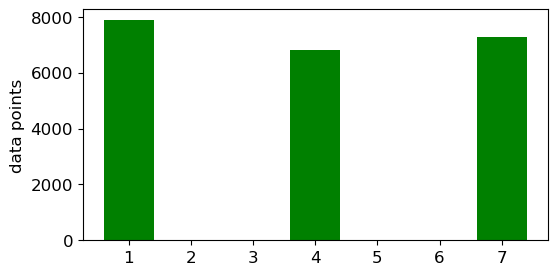

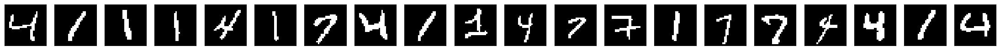

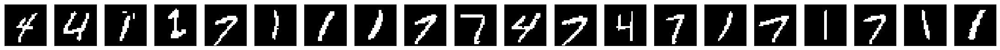

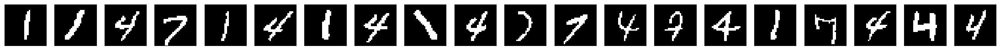

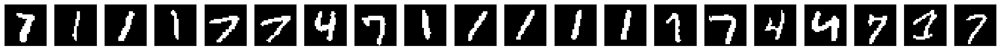

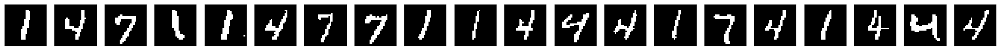

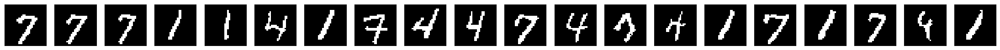

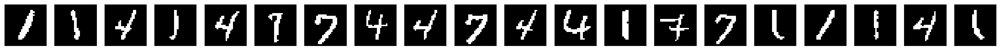

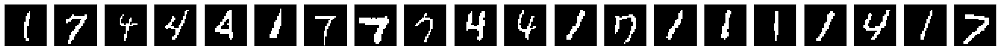

In [19]:
fig, (ax) = plt.subplots(1,1,figsize=(6,3))
ax.hist(np.sort(label),bins=[0.5,1.5,3.5,4.5,6.5,7.5],density=False,rwidth=0.8,color="g")
ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
ax.set_ylabel("data points")
plt.show()
for i in range(8): show_MNIST(data[i*20:],Nex=20)

## Contrastive divergence (CD)


In [20]:
# eq(213) page 97, activation via sigmoid
# taking into account energy gap 2 for "spin" variables (-1,1)
def CD_step(v_in,wei,bias,details=False,POTTS=False):
    """
        Generates the state on the other layer:
        Field "H" ->  activation "a" -> probability "p" -> Spins/bits v_out

        Either (v_in=x, wei=w) or (v_in=z, wei=w.T)

        details = True --> returns also probability (p) and activation (a)

        POTTS means one-hot encoding (used only in hidden space)
    """
    # local "field"
    H = np.clip(np.dot(v_in, wei) + bias, a_min=-300, a_max=300)
    # "activation"
    a = exp(level_gap*H)
    n = np.shape(H)
    v_out = np.full(n, x_min, dtype=int) # initially, just a list on -1's or 0's
    if POTTS: # RBM with a single hidden unit = 1 (that is, "one-hot encoding" with L states)
        # p: state probability, normalized to 1 over all units=states
        p = a/np.sum(a)
        # F: cumulative probability
        F = np.cumsum(p)
        # pick a state "i" randomly with probability p[i]
        r = np.random.rand()
        i = 0
        while r>F[i]: i+=1
        v_out[i] = 1 # activate a single hidden unit
    else: # normal Ising RBM
        # p: local probability, normalized to 1 for each hidden unit
        p = a / (a + 1.)
        # at each position i, activate the 1's with local probability p[i]
        v_out[np.random.random_sample(n) < p] = 1

    if details: return v_out,p,a
    else: return v_out

## Plot weights

In [21]:
def plot_weights_bias(wE, bE, epoch, L,
                      side=0,cols=0,thr=0,s=1.5,
                      title=False, save=True,cmap="bwr"):
    '''
    Plot the weights of the RBM, one plot for each hidden unit.
    '''
    rows = int(np.ceil(L / cols))
    if rows==1: rows=2
    w=wE[epoch]
    b=bE[epoch]
    if side==0: side=int(sqrt(len(w)))
    if thr==0: thr=4
    plt.clf()
    fig, AX = plt.subplots(rows, cols+1, figsize=(s*(1+cols),s*rows))
    if title: fig.suptitle(f"epoch = {epoch}")
    k=1
    for i in range(rows):
        for j in range(cols):
            if rows==1: ax=AX[j+1]
            else: ax=AX[i,j+1]
            if k<=L:
                ax.imshow(w[:,k-1].reshape(side, side), cmap=cmap,vmin=-thr,vmax=thr)
                ax.set_xticks([])
                ax.set_yticks([])
                ax.set_title(f"hidden {k}")
            else: fig.delaxes(ax)
            k+=1
        if i>0:  fig.delaxes(AX[i,0])

    ax=AX[0,0];
    im=ax.imshow(b.reshape(side, side), cmap=cmap,vmin=-thr,vmax=thr)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("bias")
    # colobar
    cbar_ax = fig.add_axes([0.14, 0.15, 0.024, 0.33])
    cbar = fig.colorbar(im, cax=cbar_ax)
    cbar.ax.tick_params(labelsize=12)

    S=0.3
    plt.subplots_adjust(hspace=S)

    if save: plt.savefig(f"./FIG/FRAME/RBM_{epoch}_w-a.png")

    plt.show()
    plt.close()


## Weights initialization

In [22]:
# initial bias of visible units, based on their average value in the dataset
# Hinton, "A Practical Guide to Training Restricted Boltzmann Machines"
def Hinton_bias_init(x):
    xmean=np.array(np.mean(x,axis=0))
    # remove values at extrema, to avoid divergences in the log's
    S = 1e-4
    x1,x2 = x_min+S,1-S
    xmean[xmean<x1] = x1
    xmean[xmean>x2] = x2
    return (1/level_gap)*np.clip(log(xmean-x_min) - log(1-xmean),-300,300)

# range of each initial weight
# Glorot and Bengio, "Understanding the difficulty of training deep feedforward neural networks"
sigma = sqrt(4. / float(L + D))

## Gradient descent method

In [23]:
# Gradient descent options
GRAD_list=["SGD","RMSprop"]
GRAD=GRAD_list[1]
if GRAD=="SGD":
    l_rate_ini,l_rate_fin=1.0,0.25
if GRAD=="RMSprop":
    beta,epsilon=0.9,1e-4
    l_rate_ini,l_rate_fin=0.05,0.05
    print("epsilon=",epsilon)
gamma = 0.001 ######### for regularization

print(f"D={D}\tsample size\nL={L}\tnr. z states")
print("Gradient descent type:",GRAD)
print(f"learning rate        = {l_rate_ini} --> {l_rate_fin}")
if gamma!=0: print(f"gamma={gamma}\tregularization")

epsilon= 0.0001
D=784	sample size
L=3	nr. z states
Gradient descent type: RMSprop
learning rate        = 0.05 --> 0.05
gamma=0.001	regularization


# RBM training


In [24]:
def make_weights_fname(label,dname="WEIGHTS"):
    fname=dname+"/"+label+"_"+str_simul+"_MNIST"+str(Ndigit)+"_L"+str(L)+"_Nt"+str(Nt)
    fname=fname+"_"+GRAD+"-"+"{:.2f}".format(l_rate_ini)+"-"+"{:.2f}".format(l_rate_fin)+"_Ep"+str(Nepoch)
    if gamma>0:  fname=fname+"_reg"+"{:.3g}".format(gamma)
    if POTTS: fname+="_POTTS"
    if SPINS: fname+="_SPINS"
    fname=fname
    return fname+".npy"

def save_epochs(qE,label):
    fname=make_weights_fname(label)
    #print(fname)
    np.save(fname,qE)


In [25]:
# random seed for reproducibility
np.random.seed(12345)

L_v = [3,4,5,6,8,10]
Nt_v= [2,4,6,8,10,15]
gamma_v= [0.0001,0.001,0.01,0.1,0.5]

Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

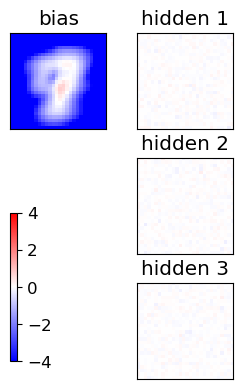

Starting the training
[16053 16112 19222 12024  4937  4793 13844  6809  7045  4699]
[17378 13425  1328  4770 18773  6133 10103  6206 15888  2118]
[18708   199 13590   739 14683 15794 16145  3148  7205 12598]
[15981 18440  2421  3592 19372  6763  6214  8299 11460 20074]
epoch 1 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 2 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 3 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 4 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 5 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 6 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 7 / 150  Nt: 2  N: 10  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 8 / 150  Nt: 2  N: 11  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 9 / 150  Nt: 2  N: 11  L: 3  rate: 0.05  gam: 0.001 

<Figure size 640x480 with 0 Axes>

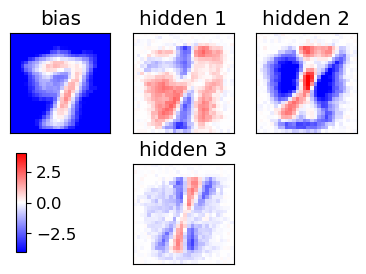

epoch 21 / 150  Nt: 2  N: 18  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 22 / 150  Nt: 2  N: 19  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 23 / 150  Nt: 2  N: 20  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 24 / 150  Nt: 2  N: 21  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 25 / 150  Nt: 2  N: 22  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 26 / 150  Nt: 2  N: 23  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 27 / 150  Nt: 2  N: 24  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 28 / 150  Nt: 2  N: 26  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 29 / 150  Nt: 2  N: 27  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 30 / 150  Nt: 2  N: 28  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 31 / 150  Nt: 2  N: 29  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 32 / 150  Nt: 2  N: 31  L: 3  rate: 0.05  gam: 0.001 SPINS=

<Figure size 640x480 with 0 Axes>

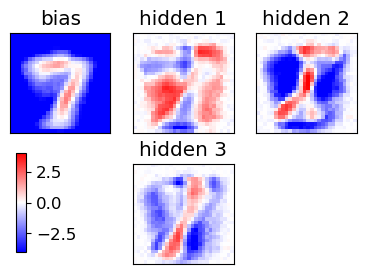

epoch 41 / 150  Nt: 2  N: 45  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 42 / 150  Nt: 2  N: 47  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 43 / 150  Nt: 2  N: 48  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 44 / 150  Nt: 2  N: 50  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 45 / 150  Nt: 2  N: 52  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 46 / 150  Nt: 2  N: 54  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 47 / 150  Nt: 2  N: 56  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 48 / 150  Nt: 2  N: 58  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 49 / 150  Nt: 2  N: 60  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 50 / 150  Nt: 2  N: 62  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 51 / 150  Nt: 2  N: 65  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 52 / 150  Nt: 2  N: 67  L: 3  rate: 0.05  gam: 0.001 SPINS=

<Figure size 640x480 with 0 Axes>

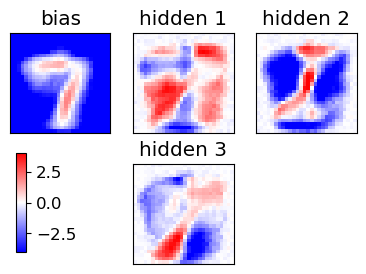

epoch 61 / 150  Nt: 2  N: 89  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 62 / 150  Nt: 2  N: 92  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 63 / 150  Nt: 2  N: 94  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 64 / 150  Nt: 2  N: 97  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 65 / 150  Nt: 2  N: 100  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 66 / 150  Nt: 2  N: 103  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 67 / 150  Nt: 2  N: 106  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 68 / 150  Nt: 2  N: 109  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 69 / 150  Nt: 2  N: 112  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 70 / 150  Nt: 2  N: 115  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 71 / 150  Nt: 2  N: 118  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 72 / 150  Nt: 2  N: 121  L: 3  rate: 0.05  gam: 0.00

<Figure size 640x480 with 0 Axes>

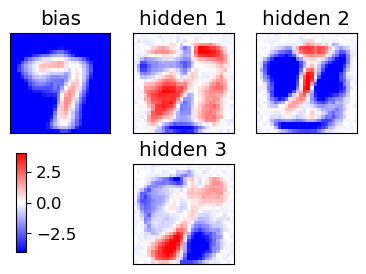

epoch 81 / 150  Nt: 2  N: 151  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 82 / 150  Nt: 2  N: 154  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 83 / 150  Nt: 2  N: 158  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 84 / 150  Nt: 2  N: 162  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 85 / 150  Nt: 2  N: 165  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 86 / 150  Nt: 2  N: 169  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 87 / 150  Nt: 2  N: 173  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 88 / 150  Nt: 2  N: 177  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 89 / 150  Nt: 2  N: 180  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 90 / 150  Nt: 2  N: 184  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 91 / 150  Nt: 2  N: 188  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 92 / 150  Nt: 2  N: 192  L: 3  rate: 0.05  gam: 

<Figure size 640x480 with 0 Axes>

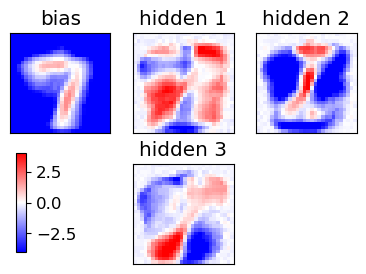

epoch 101 / 150  Nt: 2  N: 230  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 102 / 150  Nt: 2  N: 235  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 103 / 150  Nt: 2  N: 239  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 104 / 150  Nt: 2  N: 244  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 105 / 150  Nt: 2  N: 248  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 106 / 150  Nt: 2  N: 253  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 107 / 150  Nt: 2  N: 257  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 108 / 150  Nt: 2  N: 262  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 109 / 150  Nt: 2  N: 267  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 110 / 150  Nt: 2  N: 272  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 111 / 150  Nt: 2  N: 277  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 112 / 150  Nt: 2  N: 281  L: 3  rate:

<Figure size 640x480 with 0 Axes>

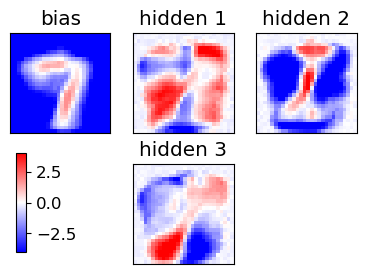

epoch 121 / 150  Nt: 2  N: 327  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 122 / 150  Nt: 2  N: 333  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 123 / 150  Nt: 2  N: 338  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 124 / 150  Nt: 2  N: 343  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 125 / 150  Nt: 2  N: 349  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 126 / 150  Nt: 2  N: 354  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 127 / 150  Nt: 2  N: 360  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 128 / 150  Nt: 2  N: 365  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 129 / 150  Nt: 2  N: 371  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 130 / 150  Nt: 2  N: 377  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 131 / 150  Nt: 2  N: 383  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 132 / 150  Nt: 2  N: 388  L: 3  rate:

<Figure size 640x480 with 0 Axes>

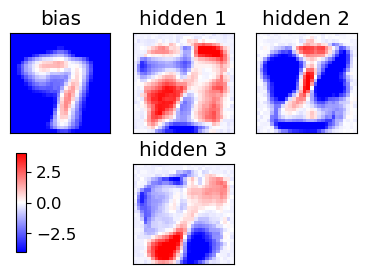

epoch 141 / 150  Nt: 2  N: 442  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 142 / 150  Nt: 2  N: 448  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 143 / 150  Nt: 2  N: 455  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
epoch 144 / 150  Nt: 2  N: 461  L: 3  rate: 0.05  gam: 0.001 SPINS= False POTTS= False


KeyboardInterrupt: 

In [26]:
for L in L_v:
    if L == 3:
        for Nt in Nt_v:

            # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
            w = sigma * np.random.randn(D,L)
            #a = sigma * np.random.randn(D)
            # using Hinton initialization of visible biases
            a = Hinton_bias_init(data)
            # hidden biases initialized to zero
            b = np.zeros(L)
            #print("w=",w);print("a=",a);print("b=",b)

            # nr of epochs
            Nepoch=150
            # minibatches per epoch
            Nmini=20
            # minibatch size at initial epoch and final one
            N_ini,N_fin=10,500
            print(f"Nepoch={Nepoch}\nNmini={Nmini}")


            # recording history of weights ("E" means epoch)
            wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
            wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
            gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
            gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
            gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
            miniE = np.zeros(Nepoch+1)
            pzE=np.zeros((Nepoch+1,Nz))
            if GRAD=="RMSprop":
                gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

            indices=np.arange(Nd).astype("int")
            plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

            # for the plot with panels
            Ncols=min(8,max(2,L//2))

            if POTTS: print("Starting the training, POTTS=True")
            else: print("Starting the training")

            # Note: here an epoch does not analyze the whole dataset
            for epoch in range(1,1+Nepoch):
                # q maps epochs to interval [0,1]
                q = (epoch-1.)/(Nepoch-1.)
                # N, size of the mini batch
                # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
                N = int(N_ini + (N_fin-N_ini)*(q**2))
                #  l_rate interpolates between initial and final value
                l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

                for mini in range(Nmini):
                    # initializitation for averages in minibatch
                    # visible variables "v" --> "x"
                    #  hidden variables "h" --> "z"
                    x_data, x_model = np.zeros(D),np.zeros(D)
                    z_data, z_model = np.zeros(L),np.zeros(L)
                    xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                    pz = np.zeros(L)

                    # Minibatch of size N: points randomply picked (without repetition) from data
                    selected = np.random.choice(indices,N,replace=False)
                    if epoch==1 and mini<=3: print(selected)

                    for k in range(N):
                        ###################################
                        x0 = data[selected[k]]
                        # positive CD phase: generating z from x[k]
                        z = CD_step(x0,w,b,POTTS=POTTS)
                        x_data  += x0
                        z_data  += z
                        xz_data += np.outer(x0,z)
                        # fantasy
                        zf=np.copy(z)
                        # Contrastive divergence with Nt steps
                        for t in range(Nt):
                            # negative CD pzase: generating fantasy xf from fantasy zf
                            xf = CD_step(zf,w.T,a)
                            # positive CD phase: generating fantasy zf from fantasy xf
                            zf = CD_step(xf,w,b,POTTS=POTTS)
                        x_model += xf
                        z_model += zf
                        xz_model+= np.outer(xf,zf)
                        # recording probability of encoding in z-space, if POTTS
                        if POTTS: pz[zf]+=1
                        ###################################

                    # gradient of the likelihood: follow it along its positive direction
                    gw_d,gw_m = xz_data/N, xz_model/N
                    ga_d,ga_m = x_data/N, x_model/N
                    gb_d,gb_m = z_data/N, z_model/N
                    gw=np.copy(gw_d - gw_m)
                    ga=np.copy(ga_d - ga_m)
                    gb=np.copy(gb_d - gb_m)

                    # gradient ascent step
                    if GRAD=="RMSprop":
                        # RMSprop gradient ascent
                        gw2 = beta*gw2+(1-beta)*np.square(gw)
                        ga2 = beta*ga2+(1-beta)*np.square(ga)
                        gb2 = beta*gb2+(1-beta)*np.square(gb)
                        w += l_rate*gw/sqrt(epsilon+gw2)
                        a += l_rate*ga/sqrt(epsilon+ga2)
                        b += l_rate*gb/sqrt(epsilon+gb2)
                    else:
                        # defaulting to the vanilla stochastic gradient ascent (SGD)
                        w += l_rate*gw
                        a += l_rate*ga
                        b += l_rate*gb
                    # regularization (LASSO)
                    if gamma>0.:
                        w -= (gamma*l_rate)*sign(w)
                        a -= (gamma*l_rate)*sign(a)
                        b -= (gamma*l_rate)*sign(b)

                wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
                aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
                bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
                miniE[epoch]=N
                if POTTS: pzE[epoch] = pz/np.sum(pz)
                print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                      " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

                if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
            save_epochs(wE,"w")
            save_epochs(bE,"b")
            save_epochs(aE,"a")

        print("END of learning phase")


    else:
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D,L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)

        # nr of epochs
        Nepoch=150
        # minibatches per epoch
        Nmini=20
        # minibatch size at initial epoch and final one
        N_ini,N_fin=10,500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")
        # number of CD steps
        Nt=2

        # recording history of weights ("E" means epoch)
        wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
        wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
        gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
        gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
        gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
        miniE = np.zeros(Nepoch+1)
        pzE=np.zeros((Nepoch+1,Nz))
        if GRAD=="RMSprop":
            gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

        indices=np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

        # for the plot with panels
        Ncols=min(8,max(2,L//2))

        if POTTS: print("Starting the training, POTTS=True")
        else: print("Starting the training")

        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1,1+Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch-1.)/(Nepoch-1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin-N_ini)*(q**2))
            #  l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                #  hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D),np.zeros(D)
                z_data, z_model = np.zeros(L),np.zeros(L)
                xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                pz = np.zeros(L)

                # Minibatch of size N: points randomply picked (without repetition) from data
                selected = np.random.choice(indices,N,replace=False)
                if epoch==1 and mini<=3: print(selected)

                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0,w,b,POTTS=POTTS)
                    x_data  += x0
                    z_data  += z
                    xz_data += np.outer(x0,z)
                    # fantasy
                    zf=np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD pzase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf,w.T,a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf,w,b,POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model+= np.outer(xf,zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS: pz[zf]+=1
                    ###################################

                # gradient of the likelihood: follow it along its positive direction
                gw_d,gw_m = xz_data/N, xz_model/N
                ga_d,ga_m = x_data/N, x_model/N
                gb_d,gb_m = z_data/N, z_model/N
                gw=np.copy(gw_d - gw_m)
                ga=np.copy(ga_d - ga_m)
                gb=np.copy(gb_d - gb_m)

                # gradient ascent step
                if GRAD=="RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta*gw2+(1-beta)*np.square(gw)
                    ga2 = beta*ga2+(1-beta)*np.square(ga)
                    gb2 = beta*gb2+(1-beta)*np.square(gb)
                    w += l_rate*gw/sqrt(epsilon+gw2)
                    a += l_rate*ga/sqrt(epsilon+ga2)
                    b += l_rate*gb/sqrt(epsilon+gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate*gw
                    a += l_rate*ga
                    b += l_rate*gb
                # regularization (LASSO)
                if gamma>0.:
                    w -= (gamma*l_rate)*sign(w)
                    a -= (gamma*l_rate)*sign(a)
                    b -= (gamma*l_rate)*sign(b)

            wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
            aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
            bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
            miniE[epoch]=N
            if POTTS: pzE[epoch] = pz/np.sum(pz)
            print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                  " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

            if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

            str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")

        save_epochs(wE,"w")
        save_epochs(bE,"b")
        save_epochs(aE,"a")
        print("END of learning phase")


## Test generative power of the trained RBM

In [ ]:
ee=-1
NN=200
traj_x,traj_z = np.zeros((NN+2,D)), np.zeros((NN+2,L))
xf=np.copy(data[np.random.randint(Nd)])
traj_x[0]=np.copy(xf)

# AF: multiply weights and biases by a number >1 to achieve a more deterministic behavior,
# equivalent to lower the temperature in a Boltzmann weight -> select lowest energies
# Note: here, this is done in the negative CD step only
AF=1.

for t in range(NN):
    t1=t+1
    # positive CD phase: generating fantasy zf from fantasy xf
    zf = CD_step(xf,1*wE[ee],1*bE[ee],POTTS=POTTS)
    traj_z[t] = np.copy(zf)
    # negative CD pzase: generating fantasy xf from fantasy zf
    xf = CD_step(zf,AF*wE[ee].T,AF*aE[ee])
    traj_x[t1] = np.copy(xf)


plot_weights_bias(wE, aE, Nepoch, L, cols=Ncols, save=False)

col0,col1,col2,col3,col4=(0.8,0,0,1),(1,0.6,0,1),(0,.7,0,1),(0.2,0.2,1,1),(1,0,1,1)
show_MNIST(traj_x[0:],Nex=10,colors=(col0,col1))
show_MNIST(traj_x[10:],Nex=10,colors=(col1,col2))
show_MNIST(traj_x[20:],Nex=10,colors=(col2,col3))
show_MNIST(traj_x[40:],Nex=10,colors=(col3,col4))
print("L:",L,"    amplification of weights:",AF)

## Plot of the gradient amplitude

In [ ]:
def make_fname(strin):
    fname="FIG/RBM_"+strin+"_MNIST"+str(Ndigit)+"_E"+str(NE)+"_N"+str(N_ini)+"-"+str(N_fin)
    fname=fname+"_"+GRAD+"-"+str(l_rate_ini)+"-"+str(l_rate_fin)+"_CD-"+str(Nt)+"_L"+str(L)
    if gamma>0:  fname=fname+"_reg"+str(gamma)
    return fname+".png"

NE = len(gwE)-1
print("NE=",NE)
mgw,mga,mgb,epo=np.zeros(NE),np.zeros(NE),np.zeros(NE),np.zeros(NE)
DE=1
if NE>30: DE=2
if NE>50: DE=5
if NE>100: DE=10
# compute RMS average of gradients during epochs
for ep in range(1,1+NE):
    epo[ep-1]=ep
    mgw[ep-1] = np.std(gwE[ep])
    mga[ep-1] = np.std(gaE[ep])
    mgb[ep-1] = np.std(gbE[ep])

#############################################################################
# creating grid for subplots
fig, ax = plt.subplots(1, 1, figsize=(8,5.5))
fig.subplots_adjust( left=None, bottom=None,  right=None, top=None, wspace=None, hspace=None)

ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(DE))
ax.plot(epo,mgw,"o-",c="#CC77EC",label="$w$",zorder=10)
ax.plot(epo,mga,"d--",c="#22C040",label="$a$",zorder=5)
ax.plot(epo,mgb,"^:",c="#EEC006",label="$b$",zorder=8)
ax.plot(epo,.35/sqrt(miniE[1:]),"k-.",label="$\sim 1 / \sqrt{N}$",zorder=20,lw=2)
ax.set_xlabel("Epoch")
ax.set_ylabel("gradient RMS")
ax.set_xlim(0.5,NE+0.5)
if 1==2: ax.set_ylim(0,)
else:
    ax.set_xlim(0.8,Nepoch*1.1)
    ax.set_xscale("log")
    ax.set_yscale("log")
ax.legend()

fname=make_fname("grad")
fig.savefig(fname,dpi=200,bbox_inches='tight',pad_inches=0.02, transparent=False)
plt.show()
print(fname)

## Log-likelihood calculation

In [27]:
import numpy as np
from tqdm import tqdm
import itertools as it
from scipy.optimize import curve_fit
from numba import jit

def compute_log_likelihood(w, a, b, data):

    D = w.shape[0]      #  visible units
    L = w.shape[1]    #  hidden units
    M = data.shape[0]      # data
    
    if POTTS:
        all_z = [np.eye(L, dtype=np.float64)[i] for i in range(L)]  # Lista di vettori separati
    else:
        all_z = np.array(list(it.product((0, 1), repeat=L)), dtype=np.float64)  ### il dtype serve per numba
        
    log_likelihoods = []

    sample_size=int(M/4) #### take 1/4 of the data for each epoch
    idx = np.random.choice(M, sample_size, replace=False)
    data_sample = data[idx]
    log_likelihoods = []

    for m in tqdm(range(len(data_sample)), desc='Computing log-likelihood'):
        x = data_sample[m]
        log_likelihoods.append(compute_single_log_likelihood(w, a, b, x, all_z, D, L))


    return np.mean(log_likelihoods)

@jit(nopython=True)
def compute_single_log_likelihood(w, a, b, x, all_z, D, L):
    if POTTS:
        q_samples = []
        for i in range(min(100, D)):  # Sample a few visible units
            for z_idx in range(min(10, L)):  # Sample a few hidden states
                z = all_z[z_idx]
                H_i = a[i] + np.dot(w[i], z)
                q_samples.append(1 + np.exp(H_i))
    else:
        q_samples = []
        for i in range(min(100, D)):  # Sample a few visible units
            for z_idx in range(min(10, 2**L)):  # Sample a few hidden states
                z = all_z[z_idx]
                H_i = a[i] + np.dot(w[i], z)
                q_samples.append(1 + np.exp(H_i))
    q = np.mean(np.array(q_samples))


    first_term = compute_free_energy_term(w, a, b, x, all_z, q, D)
    second_term = -compute_partition_function(w, a, b, all_z, q, D)

    return first_term + second_term




@jit(nopython=True)
def compute_partition_function(w, a, b, all_z, q, D):

    sum_term = 0

    for z in all_z:
        G_z=1.0
        for i in range(L):
            G_z *= np.exp(b[i] * z[i])

        product_term = 1.0
        for i in range(D):
            H_i = a[i] + np.dot(w[i], z)
            product_term *= (1 + np.exp(H_i)) / q

        sum_term += G_z * product_term

    return D * np.log(q) + np.log(sum_term)

@jit(nopython=True)
def compute_free_energy_term(w, a, b, x, all_z, q, D):
    """
    Compute the free energy term using log-space arithmetic for numerical stability.
    This implements the formula: e^(-E(x,z)) = ∏_μ e^(b_μ*z_μ) * ∏_i e^(H_i(z)*x_i)
    """
    # Use log-sum-exp trick for numerical stability
    log_terms = np.zeros(len(all_z))

    for z_idx in range(len(all_z)):
        z = all_z[z_idx]

        # Compute log G(z) = log(∏_μ e^(b_μ*z_μ)) = ∑_μ b_μ*z_μ
        log_G_z = np.sum(b * z)

        # Compute log product term for visible units
        log_product = 0.0
        for i in range(D):
            if x[i] == 1:  # Only consider where x = 1
                H_i = a[i] + np.dot(w[i], z)
                log_product += H_i
            #if x[i] == -1:  # Only consider where x = -1
            #    H_i = a[i] + np.dot(w[i], z)
            #    log_product += (-H_i)
            ### case x=0 we have 0 (log(e^(H_z*x)=0))

        # Total log term for this z
        log_terms[z_idx] = log_G_z + log_product

    # Log-sum-exp trick: log(∑_i e^x_i) = a + log(∑_i e^(x_i - a))
    # where a = max(x_i) to prevent overflow
    if len(log_terms) > 0:
        max_log_term = np.max(log_terms)
        # Avoid -inf if all terms are -inf
        if max_log_term == -np.inf:
            return -np.inf

        sum_exp = np.sum(np.exp(log_terms - max_log_term))
        return max_log_term + np.log(sum_exp)
    else:
        return -np.inf  # If no hidden states, return -inf

## Likelihood evolution during the whole training  

In [ ]:
# Log-likelihood evolution for different L and fixed CD steps = 2
log_like_L=[]
for L in L_v:
    Nt=2
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    num_epo=[]
    Nepoch=150
    n=3  ### take 1/3 of the epoch
    for i in range(Nepoch):
        if i%n==0:
            print(f'Epoch n.{i}')
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            log_like.append(ll)
            num_epo.append(i)
            print('Log-likelihood=',ll)
    log_like_L.append(log_like)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2280.19it/s]


Log-likelihood= -167.46639562353087
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3031.66it/s]


Log-likelihood= -153.30224022268249
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2167.52it/s]


Log-likelihood= -149.29984189944383
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2140.84it/s]


Log-likelihood= -145.3430656562798
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2228.00it/s]


Log-likelihood= -150.69288269856673
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2207.40it/s]


Log-likelihood= -147.58903653630878
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2150.40it/s]


Log-likelihood= -140.05929497579703
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2251.94it/s]


Log-likelihood= -143.16418878267984
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.40it/s]


Log-likelihood= -141.55624860080403
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.57it/s]


Log-likelihood= -141.1333456533539
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2291.30it/s]


Log-likelihood= -141.77690018303306
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2282.77it/s]


Log-likelihood= -141.30056009011076
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2296.67it/s]


Log-likelihood= -137.69138747338388
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2315.90it/s]


Log-likelihood= -141.56208266171464
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3284.75it/s]


Log-likelihood= -137.1427448730522
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2332.22it/s]


Log-likelihood= -136.6715776585117
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2315.67it/s]


Log-likelihood= -135.60655794490071
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.72it/s]


Log-likelihood= -136.97555370675877
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2188.37it/s]


Log-likelihood= -136.72116198230265
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2232.07it/s]


Log-likelihood= -136.72376396073773
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2250.15it/s]


Log-likelihood= -137.59913726517547
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2214.07it/s]


Log-likelihood= -134.23329747002762
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2227.49it/s]


Log-likelihood= -136.91135119613836
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2308.85it/s]


Log-likelihood= -136.4325580927051
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2266.59it/s]


Log-likelihood= -137.56143278022006
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2274.37it/s]


Log-likelihood= -137.93122748254368
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2304.04it/s]


Log-likelihood= -134.52485713619993
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2256.80it/s]


Log-likelihood= -135.90228161247612
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3173.75it/s]


Log-likelihood= -136.1987229107427
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2242.66it/s]


Log-likelihood= -135.8655752782017
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2261.64it/s]


Log-likelihood= -136.20254188139637
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2271.02it/s]


Log-likelihood= -137.36244353253431
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2234.97it/s]


Log-likelihood= -136.2697933295724
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2209.58it/s]


Log-likelihood= -134.67619643569626
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2284.95it/s]


Log-likelihood= -136.39688289020455
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2247.28it/s]


Log-likelihood= -137.24671766643695
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2282.35it/s]


Log-likelihood= -137.6385311930961
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2300.91it/s]


Log-likelihood= -136.50771150303032
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2290.03it/s]


Log-likelihood= -134.9666097243515
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2267.83it/s]


Log-likelihood= -137.65680609790834
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2324.19it/s]


Log-likelihood= -137.83050152876964
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3381.49it/s]


Log-likelihood= -136.80611264490508
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.18it/s]


Log-likelihood= -135.14433081288252
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2207.03it/s]


Log-likelihood= -136.78365084933301
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2292.97it/s]


Log-likelihood= -136.033221252348
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2299.29it/s]


Log-likelihood= -137.88975363858924
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2305.90it/s]


Log-likelihood= -138.22442290638955
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2260.70it/s]


Log-likelihood= -134.07610994198214
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2280.65it/s]


Log-likelihood= -136.4088892031857
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2286.85it/s]


Log-likelihood= -135.02388182467786
a_all L=4, Nt=2
b_all L=4, Nt=2
w_all L=4, Nt=2
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.69it/s]


Log-likelihood= -167.26125039459475
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.18it/s]


Log-likelihood= -148.77345297407734
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1432.00it/s]


Log-likelihood= -147.61714540077304
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1189.97it/s]


Log-likelihood= -143.75963014000584
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.74it/s]


Log-likelihood= -145.5370454305124
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1200.22it/s]


Log-likelihood= -144.96919542433898
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.84it/s]


Log-likelihood= -141.04234989525747
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1189.70it/s]


Log-likelihood= -140.5357499277552
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1184.69it/s]


Log-likelihood= -139.92773109301754
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1412.31it/s]


Log-likelihood= -141.95504743208537
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.35it/s]


Log-likelihood= -139.5026635748997
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1174.03it/s]


Log-likelihood= -136.44388147599682
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.81it/s]


Log-likelihood= -138.83589854796577
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1184.39it/s]


Log-likelihood= -135.7087432673348
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1181.95it/s]


Log-likelihood= -134.73380955122218
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1131.83it/s]


Log-likelihood= -135.58305724904383
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1387.22it/s]


Log-likelihood= -135.03017099736775
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1150.97it/s]


Log-likelihood= -134.6562744112458
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 1077.46it/s]


Log-likelihood= -132.84599022684125
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 1060.63it/s]


Log-likelihood= -134.51691531235366
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1108.46it/s]


Log-likelihood= -133.39991380595978
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1118.54it/s]


Log-likelihood= -133.2852116218248
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1175.80it/s]


Log-likelihood= -133.12045972615263
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1379.67it/s]


Log-likelihood= -135.09635183992629
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1152.33it/s]


Log-likelihood= -129.49054341069063
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1125.83it/s]


Log-likelihood= -130.0545602880187
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1114.32it/s]


Log-likelihood= -127.66314905670576
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1122.44it/s]


Log-likelihood= -126.49595231999798
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.79it/s]


Log-likelihood= -126.06259645661025
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1369.52it/s]


Log-likelihood= -124.3657674628067
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.26it/s]


Log-likelihood= -126.86064155614153
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1185.44it/s]


Log-likelihood= -125.45877064842979
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1180.45it/s]


Log-likelihood= -128.0072845909842
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1182.41it/s]


Log-likelihood= -125.78873955730435
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1148.32it/s]


Log-likelihood= -126.91742723121247
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1160.25it/s]


Log-likelihood= -126.00329361906314
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1356.74it/s]


Log-likelihood= -126.64954811875906
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1151.46it/s]


Log-likelihood= -129.0202605155102
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1172.66it/s]


Log-likelihood= -126.58428108969552
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.97it/s]


Log-likelihood= -128.6863052766173
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.64it/s]


Log-likelihood= -126.13036819979084
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1124.60it/s]


Log-likelihood= -125.22974573596422
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1207.37it/s]


Log-likelihood= -125.37308332774235
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1441.02it/s]


Log-likelihood= -126.21824197434125
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.27it/s]


Log-likelihood= -126.10343220627901
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1181.40it/s]


Log-likelihood= -127.99399667538816
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.43it/s]


Log-likelihood= -128.41999321157178
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1164.82it/s]


Log-likelihood= -127.53934006948327
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1168.32it/s]


Log-likelihood= -128.02000937694777
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1166.47it/s]


Log-likelihood= -129.33495177433497
a_all L=5, Nt=2
b_all L=5, Nt=2
w_all L=5, Nt=2
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.59it/s]


Log-likelihood= -167.9604557873782
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 586.55it/s]


Log-likelihood= -143.5042434936922
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 574.88it/s]


Log-likelihood= -136.77885881200825
Epoch n.9


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 645.41it/s]


Log-likelihood= -132.49927277964917
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 590.51it/s]


Log-likelihood= -128.61238634453
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 565.80it/s]


Log-likelihood= -130.62356924898205
Epoch n.18


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 496.62it/s]


Log-likelihood= -131.19865517214126
Epoch n.21


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 541.49it/s]


Log-likelihood= -131.11616339519205
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 557.63it/s]


Log-likelihood= -128.49605809907396
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 569.94it/s]


Log-likelihood= -129.5130036082506
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.45it/s]


Log-likelihood= -128.43256711944255
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 596.41it/s]


Log-likelihood= -125.50002278744955
Epoch n.36


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 573.86it/s]


Log-likelihood= -128.910749525361
Epoch n.39


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 603.61it/s]


Log-likelihood= -126.53231120632095
Epoch n.42


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 577.28it/s]


Log-likelihood= -124.67885994690177
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 584.58it/s]


Log-likelihood= -125.02436451796235
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.68it/s]


Log-likelihood= -125.6665963522175
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 574.92it/s]


Log-likelihood= -123.47014892566231
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 571.20it/s]


Log-likelihood= -126.03663121646501
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 561.37it/s]


Log-likelihood= -127.10812293689811
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.88it/s]


Log-likelihood= -128.47155501728233
Epoch n.63


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 592.78it/s]


Log-likelihood= -126.95461203569256
Epoch n.66


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 571.65it/s]


Log-likelihood= -125.64471865575088
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.60it/s]


Log-likelihood= -126.66414488330328
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 589.28it/s]


Log-likelihood= -124.55211452247848
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 591.06it/s]


Log-likelihood= -126.32281053476883
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 595.79it/s]


Log-likelihood= -127.85108433738776
Epoch n.81


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 644.83it/s]


Log-likelihood= -124.87571501674472
Epoch n.84


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 598.83it/s]


Log-likelihood= -124.74612735076407
Epoch n.87


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 603.76it/s]


Log-likelihood= -126.15168095391516
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 658.52it/s]


Log-likelihood= -125.69035484521923
Epoch n.93


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 599.35it/s]


Log-likelihood= -126.14069030107638
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 602.24it/s]


Log-likelihood= -124.98345671464735
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 602.85it/s]


Log-likelihood= -125.70115001417682
Epoch n.102


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 645.11it/s]


Log-likelihood= -124.9216315247487
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 542.38it/s]


Log-likelihood= -125.38063556297514
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 559.03it/s]


Log-likelihood= -124.04439094010988
Epoch n.111


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 636.08it/s]


Log-likelihood= -123.85892306720173
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 570.04it/s]


Log-likelihood= -125.25141806112585
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 582.36it/s]


Log-likelihood= -127.23410167913582
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 635.96it/s]


Log-likelihood= -125.7484513479046
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 592.36it/s]


Log-likelihood= -125.42903242262395
Epoch n.126


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 591.35it/s]


Log-likelihood= -124.25994691569801
Epoch n.129


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 590.52it/s]


Log-likelihood= -126.7666258569637
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 651.90it/s]


Log-likelihood= -124.51464281149165
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 577.32it/s]


Log-likelihood= -126.07712993983777
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 569.21it/s]


Log-likelihood= -126.0503506054616
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 648.56it/s]


Log-likelihood= -124.46543897791452
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 562.36it/s]


Log-likelihood= -124.34722579993863
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 523.01it/s]


Log-likelihood= -124.68819871754732
a_all L=6, Nt=2
b_all L=6, Nt=2
w_all L=6, Nt=2
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 322.78it/s]


Log-likelihood= -167.82839428146056
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 303.20it/s]


Log-likelihood= -140.02720427633028
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 320.24it/s]


Log-likelihood= -139.66024198229758
Epoch n.9


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.12it/s]


Log-likelihood= -133.99796869952323
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.58it/s]


Log-likelihood= -134.85249625199745
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.19it/s]


Log-likelihood= -137.81450787649985
Epoch n.18


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 287.92it/s]


Log-likelihood= -134.4462238555384
Epoch n.21


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 288.60it/s]


Log-likelihood= -139.15994837219736
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 285.18it/s]


Log-likelihood= -138.55250615237324
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.61it/s]


Log-likelihood= -135.35959551490959
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 300.52it/s]


Log-likelihood= -134.93654412212754
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 286.25it/s]


Log-likelihood= -131.7890678374308
Epoch n.36


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 305.07it/s]


Log-likelihood= -134.26209234113696
Epoch n.39


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.58it/s]


Log-likelihood= -134.81862858782102
Epoch n.42


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 302.06it/s]


Log-likelihood= -132.4071999881581
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.68it/s]


Log-likelihood= -133.0928308193174
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.90it/s]


Log-likelihood= -136.71855341501146
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.46it/s]


Log-likelihood= -135.83997309166426
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.29it/s]


Log-likelihood= -135.58276440216045
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 306.78it/s]


Log-likelihood= -134.7011766685891
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.35it/s]


Log-likelihood= -132.37018226431397
Epoch n.63


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.38it/s]


Log-likelihood= -132.8623054511501
Epoch n.66


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.66it/s]


Log-likelihood= -133.73405974673514
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.48it/s]


Log-likelihood= -137.70880844162517
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.89it/s]


Log-likelihood= -133.76906177904385
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.28it/s]


Log-likelihood= -135.82329007814937
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.90it/s]


Log-likelihood= -140.06562351979912
Epoch n.81


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.91it/s]


Log-likelihood= -136.7601991257981
Epoch n.84


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.84it/s]


Log-likelihood= -141.72971189372228
Epoch n.87


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.68it/s]


Log-likelihood= -135.3718838464157
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.76it/s]


Log-likelihood= -133.20323607427235
Epoch n.93


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.32it/s]


Log-likelihood= -130.68581203146934
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.24it/s]


Log-likelihood= -136.00155483357682
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 311.95it/s]


Log-likelihood= -131.85581557846106
Epoch n.102


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.76it/s]


Log-likelihood= -129.7339999000464
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 304.72it/s]


Log-likelihood= -126.35954185361607
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 297.11it/s]


Log-likelihood= -128.4595016307388
Epoch n.111


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.95it/s]


Log-likelihood= -126.88807938696806
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 309.86it/s]


Log-likelihood= -125.6899529317442
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.28it/s]


Log-likelihood= -125.33446792789417
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.47it/s]


Log-likelihood= -126.5738726445217
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.63it/s]


Log-likelihood= -123.80593995360576
Epoch n.126


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 303.49it/s]


Log-likelihood= -123.88324928984012
Epoch n.129


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 300.28it/s]


Log-likelihood= -125.04275814144907
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 309.60it/s]


Log-likelihood= -127.71518491849886
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.98it/s]


Log-likelihood= -128.5612008303615
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.72it/s]


Log-likelihood= -125.00912256109461
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.75it/s]


Log-likelihood= -127.23541300316028
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 306.18it/s]


Log-likelihood= -125.47838408069725
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 320.70it/s]


Log-likelihood= -124.6727540876417
a_all L=8, Nt=2
b_all L=8, Nt=2
w_all L=8, Nt=2
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.98it/s]


Log-likelihood= -167.56168703669934
Epoch n.3


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.28it/s]


Log-likelihood= -142.83786419910177
Epoch n.6


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.15it/s]


Log-likelihood= -134.7137184134017
Epoch n.9


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:07<00:00, 81.02it/s]


Log-likelihood= -126.24903892914352
Epoch n.12


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.19it/s]


Log-likelihood= -128.88253273724231
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.60it/s]


Log-likelihood= -128.1742339970567
Epoch n.18


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.69it/s]


Log-likelihood= -128.95560229909577
Epoch n.21


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.86it/s]


Log-likelihood= -128.8181546339894
Epoch n.24


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.97it/s]


Log-likelihood= -128.4414534003503
Epoch n.27


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.28it/s]


Log-likelihood= -130.52554058391286
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.90it/s]


Log-likelihood= -128.2534474542727
Epoch n.33


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.48it/s]


Log-likelihood= -130.48209457945973
Epoch n.36


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.80it/s]


Log-likelihood= -125.76439216651129
Epoch n.39


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.29it/s]


Log-likelihood= -126.71267336416649
Epoch n.42


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.27it/s]


Log-likelihood= -128.1705110812231
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.83it/s]


Log-likelihood= -126.45442284978765
Epoch n.48


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.08it/s]


Log-likelihood= -128.3739525610633
Epoch n.51


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.37it/s]


Log-likelihood= -128.664186336212
Epoch n.54


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.18it/s]


Log-likelihood= -131.55238834556386
Epoch n.57


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -127.50814445454051
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.27it/s]


Log-likelihood= -129.170238548205
Epoch n.63


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.55it/s]


Log-likelihood= -131.6875389651791
Epoch n.66


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.14it/s]


Log-likelihood= -129.65844807103835
Epoch n.69


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.48it/s]


Log-likelihood= -125.78235323946345
Epoch n.72


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.91it/s]


Log-likelihood= -130.29459529188648
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.49it/s]


Log-likelihood= -131.34455808758614
Epoch n.78


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.65it/s]


Log-likelihood= -126.9536172816826
Epoch n.81


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.48it/s]


Log-likelihood= -129.07105531107402
Epoch n.84


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.25it/s]


Log-likelihood= -128.17530346076106
Epoch n.87


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.20it/s]


Log-likelihood= -126.02669720337981
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.79it/s]


Log-likelihood= -131.33470877085202
Epoch n.93


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.27it/s]


Log-likelihood= -128.11064690394153
Epoch n.96


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.20it/s]


Log-likelihood= -130.0169910334589
Epoch n.99


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -131.84500780429315
Epoch n.102


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.18it/s]


Log-likelihood= -128.82380969991922
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.09it/s]


Log-likelihood= -132.14912456756852
Epoch n.108


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.53it/s]


Log-likelihood= -133.26551384704422
Epoch n.111


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.36it/s]


Log-likelihood= -133.2026034645289
Epoch n.114


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.15it/s]


Log-likelihood= -133.92757163398437
Epoch n.117


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.35it/s]


Log-likelihood= -133.39419064156726
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.25it/s]


Log-likelihood= -136.0273791310948
Epoch n.123


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.58it/s]


Log-likelihood= -135.303745555103
Epoch n.126


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.13it/s]


Log-likelihood= -135.6643037995829
Epoch n.129


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.06it/s]


Log-likelihood= -135.8692238818429
Epoch n.132


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.54it/s]


Log-likelihood= -138.0868459747056
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.15it/s]


Log-likelihood= -140.62545217619865
Epoch n.138


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.29it/s]


Log-likelihood= -143.24514671460466
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.79it/s]


Log-likelihood= -138.7612876385819
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -139.71833383593813
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.42it/s]


Log-likelihood= -143.29595281618663
a_all L=10, Nt=2
b_all L=10, Nt=2
w_all L=10, Nt=2
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.29it/s]


Log-likelihood= -168.02160816075647
Epoch n.3


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.54it/s]


Log-likelihood= -136.49303448120102
Epoch n.6


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:44<00:00, 19.33it/s]


Log-likelihood= -124.54118527537752
Epoch n.9


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.16it/s]


Log-likelihood= -123.2101202445941
Epoch n.12


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.14it/s]


Log-likelihood= -126.51225332670599
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -125.12327950438193
Epoch n.18


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.26it/s]


Log-likelihood= -124.40559293652244
Epoch n.21


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.23it/s]


Log-likelihood= -127.38053124263723
Epoch n.24


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -125.1567271303564
Epoch n.27


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.16it/s]


Log-likelihood= -121.98535241443783
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -123.60695775429551
Epoch n.33


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:48<00:00, 19.05it/s]


Log-likelihood= -129.92706931389054
Epoch n.36


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:48<00:00, 19.04it/s]


Log-likelihood= -130.94066255096385
Epoch n.39


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.10it/s]


Log-likelihood= -132.80274194612247
Epoch n.42


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:49<00:00, 18.97it/s]


Log-likelihood= -131.06788914719718
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.76it/s]


Log-likelihood= -130.34176869750894
Epoch n.48


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:55<00:00, 18.63it/s]


Log-likelihood= -126.19269970250967
Epoch n.51


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:50<00:00, 18.94it/s]


Log-likelihood= -128.69649993706233
Epoch n.54


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:52<00:00, 18.77it/s]


Log-likelihood= -130.84296852633315
Epoch n.57


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.14it/s]


Log-likelihood= -124.85462726189246
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.72it/s]


Log-likelihood= -126.11755522589188
Epoch n.63


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:58<00:00, 18.44it/s]


Log-likelihood= -125.34316467014854
Epoch n.66


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.19it/s]


Log-likelihood= -121.38894789975254
Epoch n.69


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:42<00:00, 19.47it/s]


Log-likelihood= -123.22057435781281
Epoch n.72


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -125.12626840611875
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.99it/s]


Log-likelihood= -125.49042897052719
Epoch n.78


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -123.69047746321647
Epoch n.81


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:36<00:00, 19.92it/s]


Log-likelihood= -124.52384664143102
Epoch n.84


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -123.84783020367134
Epoch n.87


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -121.14757321357567
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -121.07578731147076
Epoch n.93


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -118.55811729408404
Epoch n.96


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.03it/s]


Log-likelihood= -116.78297451371358
Epoch n.99


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -119.48616377020674
Epoch n.102


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.92it/s]


Log-likelihood= -114.13198262910228
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.05it/s]


Log-likelihood= -116.30035041097378
Epoch n.108


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -116.30145241891645
Epoch n.111


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.00it/s]


Log-likelihood= -119.42028825152487
Epoch n.114


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.03it/s]


Log-likelihood= -116.14413511129851
Epoch n.117


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -118.27649553258439
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -116.78625212743452
Epoch n.123


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -116.23294539232789
Epoch n.126


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -120.18589175574884
Epoch n.129


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -119.71331765630502
Epoch n.132


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -121.27313234672091
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -117.06862339922307
Epoch n.138


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:33<00:00, 20.08it/s]


Log-likelihood= -116.79509888869605
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -118.99634972903671
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:36<00:00, 19.91it/s]


Log-likelihood= -114.57554406077575
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.95it/s]

Log-likelihood= -119.01322526073503


In [ ]:
log_like_cd=[]

# Log-likelihood evolution for fixed L=3 and different CD steps

for L in L_v:
    if L==3:
        for Nt in Nt_v:
            a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
            b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
            w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

            log_like=[]
            num_epo=[]
            Nepoch=150
            n=3  ### take 1/3 of the epoch
            for i in range(Nepoch):
                if i%n==0:
                    print(f'Epoch n.{i}')
                    ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
                    log_like.append(ll)
                    num_epo.append(i)
                    print('Log-likelihood=',ll)
            log_like_cd.append(log_like)

a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.0


Computing log-likelihood:   0%|                                                                | 0/5498 [00:00<?, ?it/s]/tmp/ipykernel_681/779657587.py:41: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (Array(float64, 1, 'C', False, aligned=True), Array(float64, 1, 'A', False, aligned=True))
  second_term = -compute_partition_function(w, a, b, all_z, q, D)
Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:07<00:00, 770.57it/s]


Log-likelihood= -167.0619582470125
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.37it/s]


Log-likelihood= -153.91380773196778
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 910.76it/s]


Log-likelihood= -150.79911203045867
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.20it/s]


Log-likelihood= -146.18286317167184
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1263.60it/s]


Log-likelihood= -150.7975139446413
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.64it/s]


Log-likelihood= -145.83368565576026
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.14it/s]


Log-likelihood= -141.8379678125805
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.99it/s]


Log-likelihood= -143.07079172851942
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.20it/s]


Log-likelihood= -140.99871912316317
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 949.04it/s]


Log-likelihood= -142.12682516332038
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.82it/s]


Log-likelihood= -142.22555042710545
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.07it/s]


Log-likelihood= -140.4195790171541
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.18it/s]


Log-likelihood= -136.61794028844332
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1203.60it/s]


Log-likelihood= -140.7232094456506
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.89it/s]


Log-likelihood= -137.02533088838942
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.04it/s]


Log-likelihood= -137.24895116667676
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 906.42it/s]


Log-likelihood= -135.54764095984305
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.00it/s]


Log-likelihood= -137.10179325629935
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.42it/s]


Log-likelihood= -136.4280190549347
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.77it/s]


Log-likelihood= -136.0602139530983
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.36it/s]


Log-likelihood= -136.78500666781412
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1191.30it/s]


Log-likelihood= -134.84579821080163
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.08it/s]


Log-likelihood= -137.9025134591677
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 907.00it/s]


Log-likelihood= -136.38151146505055
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.63it/s]


Log-likelihood= -135.99726567713552
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1283.27it/s]


Log-likelihood= -137.06047926507108
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1280.33it/s]


Log-likelihood= -135.30578629736476
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.05it/s]


Log-likelihood= -137.31241494184835
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.18it/s]


Log-likelihood= -136.47912744683077
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.31it/s]


Log-likelihood= -136.41121429688255
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 952.78it/s]


Log-likelihood= -136.17395894916874
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1277.62it/s]


Log-likelihood= -138.0128243180918
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.26it/s]


Log-likelihood= -136.45627614196752
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.80it/s]


Log-likelihood= -135.18712117774922
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1290.66it/s]


Log-likelihood= -135.66665644578342
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.38it/s]


Log-likelihood= -136.1487433065035
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.72it/s]


Log-likelihood= -137.32125230815697
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.89it/s]


Log-likelihood= -136.39701093756725
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 937.73it/s]


Log-likelihood= -136.0396811463683
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.36it/s]


Log-likelihood= -137.0263635392604
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.57it/s]


Log-likelihood= -137.27674244462864
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.63it/s]


Log-likelihood= -136.3430194145506
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.73it/s]


Log-likelihood= -134.91024641798245
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.12it/s]


Log-likelihood= -136.45110741263926
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.69it/s]


Log-likelihood= -135.25465109010926
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 970.00it/s]


Log-likelihood= -138.50978350410554
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1204.74it/s]


Log-likelihood= -137.53445534268457
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1315.34it/s]


Log-likelihood= -135.25248446687726
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1293.21it/s]


Log-likelihood= -134.7393113270953
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1349.08it/s]


Log-likelihood= -135.50172222870538
a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1283.75it/s]


Log-likelihood= -167.36940146232564
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.07it/s]


Log-likelihood= -151.43773272715717
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 896.82it/s]


Log-likelihood= -144.3845672898909
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1198.08it/s]


Log-likelihood= -143.56116545836343
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1269.06it/s]


Log-likelihood= -143.3527488061263
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1300.68it/s]


Log-likelihood= -144.96469604835798
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.40it/s]


Log-likelihood= -142.3012742833728
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.85it/s]


Log-likelihood= -144.398954662032
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.93it/s]


Log-likelihood= -141.7963459418535
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.79it/s]


Log-likelihood= -136.9520382794936
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 891.64it/s]


Log-likelihood= -135.63967127927643
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.67it/s]


Log-likelihood= -136.30290107990388
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1333.90it/s]


Log-likelihood= -133.89693107867691
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.42it/s]


Log-likelihood= -134.99542196672812
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.53it/s]


Log-likelihood= -133.84014328659825
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.52it/s]


Log-likelihood= -133.29639517749263
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.71it/s]


Log-likelihood= -136.0565559487416
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 898.17it/s]


Log-likelihood= -134.6582134468092
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.51it/s]


Log-likelihood= -135.177865176888
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.43it/s]


Log-likelihood= -132.00759638737156
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.68it/s]


Log-likelihood= -133.59414596591458
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1313.61it/s]


Log-likelihood= -131.81053497207705
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1284.74it/s]


Log-likelihood= -133.43774761751385
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.19it/s]


Log-likelihood= -131.84274459764572
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 867.37it/s]


Log-likelihood= -134.4900621721476
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.81it/s]


Log-likelihood= -132.17387960725944
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.63it/s]


Log-likelihood= -130.82083706899934
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.74it/s]


Log-likelihood= -132.4570817997721
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1270.64it/s]


Log-likelihood= -132.46815091715993
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.71it/s]


Log-likelihood= -131.7122546405801
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.46it/s]


Log-likelihood= -132.73711857846368
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.65it/s]


Log-likelihood= -136.3271404346707
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 839.53it/s]


Log-likelihood= -131.37788768183972
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.22it/s]


Log-likelihood= -131.6937956044197
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.28it/s]


Log-likelihood= -132.68132608309315
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.24it/s]


Log-likelihood= -133.2517339791439
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.40it/s]


Log-likelihood= -131.1810143942101
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.16it/s]


Log-likelihood= -132.44167619085445
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.44it/s]


Log-likelihood= -132.66020855132223
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 956.63it/s]


Log-likelihood= -132.3814993435518
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.37it/s]


Log-likelihood= -132.50923720927764
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.09it/s]


Log-likelihood= -131.42889961780284
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.71it/s]


Log-likelihood= -132.5620227199188
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.10it/s]


Log-likelihood= -132.43300186401777
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.91it/s]


Log-likelihood= -133.42060307796527
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.80it/s]


Log-likelihood= -132.09346580783387
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 901.65it/s]


Log-likelihood= -131.87058058883463
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.32it/s]


Log-likelihood= -134.57359530666105
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1274.77it/s]


Log-likelihood= -130.6430868309253
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.11it/s]


Log-likelihood= -131.71583986828782
a_all L=3, Nt=6
b_all L=3, Nt=6
w_all L=3, Nt=6
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.86it/s]


Log-likelihood= -166.7634028764675
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.69it/s]


Log-likelihood= -151.15352518686646
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1266.06it/s]


Log-likelihood= -146.27894989351333
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.21it/s]


Log-likelihood= -142.690763221806
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 897.87it/s]


Log-likelihood= -147.71445502255128
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1278.30it/s]


Log-likelihood= -141.4454504162074
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.10it/s]


Log-likelihood= -142.45002446620478
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.77it/s]


Log-likelihood= -144.102879912941
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.02it/s]


Log-likelihood= -141.17957245293158
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.81it/s]


Log-likelihood= -140.6371147404727
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.23it/s]


Log-likelihood= -140.62353996101098
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 917.21it/s]


Log-likelihood= -139.85141189192692
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.81it/s]


Log-likelihood= -139.5033773228586
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.90it/s]


Log-likelihood= -140.37725486133374
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.09it/s]


Log-likelihood= -137.50988469891493
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.98it/s]


Log-likelihood= -135.0570553043074
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.95it/s]


Log-likelihood= -136.99723130659953
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.13it/s]


Log-likelihood= -136.55809345366367
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 916.64it/s]


Log-likelihood= -136.42198081143192
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.09it/s]


Log-likelihood= -137.28494160963143
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1229.15it/s]


Log-likelihood= -140.75155583266866
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.45it/s]


Log-likelihood= -139.42824707760516
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.01it/s]


Log-likelihood= -137.13251909571457
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.73it/s]


Log-likelihood= -136.08375759162547
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.79it/s]


Log-likelihood= -136.37213302683818
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.42it/s]


Log-likelihood= -136.59410698361526
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 879.84it/s]


Log-likelihood= -136.00938083701752
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.33it/s]


Log-likelihood= -137.5678988128239
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.84it/s]


Log-likelihood= -136.10471054977847
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.47it/s]


Log-likelihood= -137.29371668635915
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.31it/s]


Log-likelihood= -137.8961458059041
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.05it/s]


Log-likelihood= -138.4513244625272
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.29it/s]


Log-likelihood= -135.87242493666943
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.95it/s]


Log-likelihood= -136.44733559063818
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.26it/s]


Log-likelihood= -137.00195069618383
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.31it/s]


Log-likelihood= -136.86439670673303
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 815.37it/s]


Log-likelihood= -134.7454175841513
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.92it/s]


Log-likelihood= -137.75032469458253
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.32it/s]


Log-likelihood= -137.78079650353163
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.60it/s]


Log-likelihood= -136.9083287967815
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.70it/s]


Log-likelihood= -139.2609880056879
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1264.45it/s]


Log-likelihood= -137.4908654551755
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.15it/s]


Log-likelihood= -137.67328807466222
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1264.60it/s]


Log-likelihood= -138.69091278034927
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 898.12it/s]


Log-likelihood= -136.66958834478174
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.51it/s]


Log-likelihood= -138.29734077361582
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.19it/s]


Log-likelihood= -138.16385850538117
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.26it/s]


Log-likelihood= -138.38227959002984
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.34it/s]


Log-likelihood= -137.01459933025427
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.15it/s]


Log-likelihood= -138.7525759228951
a_all L=3, Nt=8
b_all L=3, Nt=8
w_all L=3, Nt=8
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.13it/s]


Log-likelihood= -167.31564281850328
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 913.72it/s]


Log-likelihood= -150.35861217693633
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.55it/s]


Log-likelihood= -144.29489631159421
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.61it/s]


Log-likelihood= -142.13831512765285
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.30it/s]


Log-likelihood= -147.16972180838596
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.34it/s]


Log-likelihood= -141.0404683278056
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.99it/s]


Log-likelihood= -139.74240721315616
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1227.65it/s]


Log-likelihood= -142.73999370693215
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 916.81it/s]


Log-likelihood= -140.16049708519932
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.83it/s]


Log-likelihood= -143.15510121602594
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.91it/s]


Log-likelihood= -140.90457871997285
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.65it/s]


Log-likelihood= -139.22911230905567
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.38it/s]


Log-likelihood= -141.2804208852259
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.31it/s]


Log-likelihood= -138.64478475085116
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.33it/s]


Log-likelihood= -143.0623838945089
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1273.84it/s]


Log-likelihood= -137.07448907598345
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 926.71it/s]


Log-likelihood= -140.5984547727017
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.29it/s]


Log-likelihood= -140.9587831158454
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.93it/s]


Log-likelihood= -138.50455965817602
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.14it/s]


Log-likelihood= -136.50814773019974
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.97it/s]


Log-likelihood= -134.39514179476876
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.80it/s]


Log-likelihood= -132.50361026174025
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.07it/s]


Log-likelihood= -131.3766467997649
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 883.92it/s]


Log-likelihood= -132.33407555424958
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.80it/s]


Log-likelihood= -130.9411932820327
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.62it/s]


Log-likelihood= -131.71599215293935
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.58it/s]


Log-likelihood= -130.72131673472666
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.64it/s]


Log-likelihood= -131.5507384529515
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.57it/s]


Log-likelihood= -131.6547504762219
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.51it/s]


Log-likelihood= -132.20397535514192
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 852.84it/s]


Log-likelihood= -132.3993321016373
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.41it/s]


Log-likelihood= -133.73495199250806
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.18it/s]


Log-likelihood= -132.18985968909453
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.49it/s]


Log-likelihood= -131.22713267169217
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.38it/s]


Log-likelihood= -132.23505959142645
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.68it/s]


Log-likelihood= -132.81279748245015
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.40it/s]


Log-likelihood= -132.2461470620024
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.35it/s]


Log-likelihood= -132.4716930709083
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 910.99it/s]


Log-likelihood= -131.40155804987614
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.19it/s]


Log-likelihood= -132.09725856214712
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.10it/s]


Log-likelihood= -131.6298966380341
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.07it/s]


Log-likelihood= -132.1806173753379
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.37it/s]


Log-likelihood= -132.13322236118844
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1266.51it/s]


Log-likelihood= -132.06134592628803
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1273.08it/s]


Log-likelihood= -132.48208518200497
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 884.69it/s]


Log-likelihood= -132.0035838441319
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.09it/s]


Log-likelihood= -130.78705168973687
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.89it/s]


Log-likelihood= -131.87597167461564
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.15it/s]


Log-likelihood= -131.43193712314883
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.09it/s]


Log-likelihood= -130.04848288318848
a_all L=3, Nt=10
b_all L=3, Nt=10
w_all L=3, Nt=10
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.67it/s]


Log-likelihood= -167.47056590756083
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.55it/s]


Log-likelihood= -152.78426780693434
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 938.12it/s]


Log-likelihood= -148.5082170896151
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.49it/s]


Log-likelihood= -149.18253967706548
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1213.26it/s]


Log-likelihood= -145.98741749321914
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.67it/s]


Log-likelihood= -139.4214199220991
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.58it/s]


Log-likelihood= -139.24265310905963
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.49it/s]


Log-likelihood= -138.7342858108394
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.03it/s]


Log-likelihood= -135.40335746895434
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.83it/s]


Log-likelihood= -139.47881685966775
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 891.35it/s]


Log-likelihood= -138.65822662770162
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.02it/s]


Log-likelihood= -135.30143410885884
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.58it/s]


Log-likelihood= -135.17698744360462
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.56it/s]


Log-likelihood= -139.56140381506125
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.57it/s]


Log-likelihood= -133.9219437081514
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.16it/s]


Log-likelihood= -135.93916219844047
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.36it/s]


Log-likelihood= -136.43983222328924
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 874.04it/s]


Log-likelihood= -136.8590577664586
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.21it/s]


Log-likelihood= -138.47885274867622
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.54it/s]


Log-likelihood= -137.53233337674422
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.27it/s]


Log-likelihood= -139.25807740849527
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.50it/s]


Log-likelihood= -138.09750044385825
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.94it/s]


Log-likelihood= -138.88606529130746
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.08it/s]


Log-likelihood= -138.20988583942773
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 888.36it/s]


Log-likelihood= -140.86382655618718
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.13it/s]


Log-likelihood= -136.72671812396788
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1212.05it/s]


Log-likelihood= -139.1053296960345
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1323.28it/s]


Log-likelihood= -138.0744965854004
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.30it/s]


Log-likelihood= -139.40683765388803
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.49it/s]


Log-likelihood= -138.48899084780825
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.78it/s]


Log-likelihood= -137.93185797478017
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.77it/s]


Log-likelihood= -138.01088857944683
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 867.62it/s]


Log-likelihood= -138.90194016356588
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.11it/s]


Log-likelihood= -139.34268786990438
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.97it/s]


Log-likelihood= -138.23128831900493
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.89it/s]


Log-likelihood= -138.65132015277578
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1321.52it/s]


Log-likelihood= -138.26414390146837
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.47it/s]


Log-likelihood= -139.74424879531273
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.26it/s]


Log-likelihood= -137.91656112923917
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 896.23it/s]


Log-likelihood= -138.5140110170626
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.94it/s]


Log-likelihood= -139.44086498166567
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1282.22it/s]


Log-likelihood= -139.77781710663538
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1329.14it/s]


Log-likelihood= -140.43495970528335
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1284.53it/s]


Log-likelihood= -139.17682656849638
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.04it/s]


Log-likelihood= -138.8048585606388
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.05it/s]


Log-likelihood= -140.13499742601536
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.99it/s]


Log-likelihood= -139.00813222817635
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 829.76it/s]


Log-likelihood= -138.00225444937234
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.58it/s]


Log-likelihood= -139.9386178315608
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.62it/s]


Log-likelihood= -137.73756883377519
a_all L=3, Nt=15
b_all L=3, Nt=15
w_all L=3, Nt=15
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.31it/s]


Log-likelihood= -167.56688305548167
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1326.03it/s]


Log-likelihood= -149.57459003697164
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1306.80it/s]


Log-likelihood= -148.92201576745612
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.40it/s]


Log-likelihood= -144.49699483912954
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 888.95it/s]


Log-likelihood= -142.65000422223918
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.77it/s]


Log-likelihood= -140.4280441424735
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.11it/s]


Log-likelihood= -141.7448350819875
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.48it/s]


Log-likelihood= -137.7395302170032
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1313.94it/s]


Log-likelihood= -139.69429142694176
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.21it/s]


Log-likelihood= -139.14603038264303
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.13it/s]


Log-likelihood= -137.47472515699013
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 864.12it/s]


Log-likelihood= -136.56899743627926
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.07it/s]


Log-likelihood= -135.74029496060325
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.21it/s]


Log-likelihood= -134.7535182435389
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1312.98it/s]


Log-likelihood= -134.72844823472388
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1297.33it/s]


Log-likelihood= -133.1559386275543
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.03it/s]


Log-likelihood= -130.79011379950413
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.33it/s]


Log-likelihood= -132.93062435337276
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.01it/s]


Log-likelihood= -132.32729123124594
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 842.44it/s]


Log-likelihood= -132.41780205522238
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.63it/s]


Log-likelihood= -132.41892985284332
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.70it/s]


Log-likelihood= -130.78128991619275
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.34it/s]


Log-likelihood= -134.29778060803926
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.72it/s]


Log-likelihood= -131.76417546286368
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.82it/s]


Log-likelihood= -134.36682334482597
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.78it/s]


Log-likelihood= -133.78541633013467
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 835.17it/s]


Log-likelihood= -132.22659407271274
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.03it/s]


Log-likelihood= -132.87452002843142
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1328.76it/s]


Log-likelihood= -133.4962397486291
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1285.67it/s]


Log-likelihood= -132.5756679147564
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.27it/s]


Log-likelihood= -133.15314231772024
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.68it/s]


Log-likelihood= -132.49289832972585
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.88it/s]


Log-likelihood= -132.94989403257628
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 879.64it/s]


Log-likelihood= -133.0811427254383
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.20it/s]


Log-likelihood= -133.8124582305792
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.08it/s]


Log-likelihood= -131.95613970263906
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1278.35it/s]


Log-likelihood= -132.75947195120915
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1297.47it/s]


Log-likelihood= -135.04058371731935
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1277.63it/s]


Log-likelihood= -133.29644008628742
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.68it/s]


Log-likelihood= -135.2445799408096
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.79it/s]


Log-likelihood= -132.32634395848908
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 862.72it/s]


Log-likelihood= -133.11409381249797
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.75it/s]


Log-likelihood= -132.77708319663932
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1291.86it/s]


Log-likelihood= -132.51737443109675
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.30it/s]


Log-likelihood= -134.48169441349756
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.64it/s]


Log-likelihood= -136.69788209698285
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.09it/s]


Log-likelihood= -134.37401879695435
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.45it/s]


Log-likelihood= -134.83789470261087
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 829.85it/s]


Log-likelihood= -134.21187632877076
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.72it/s]

Log-likelihood= -133.59259213577883


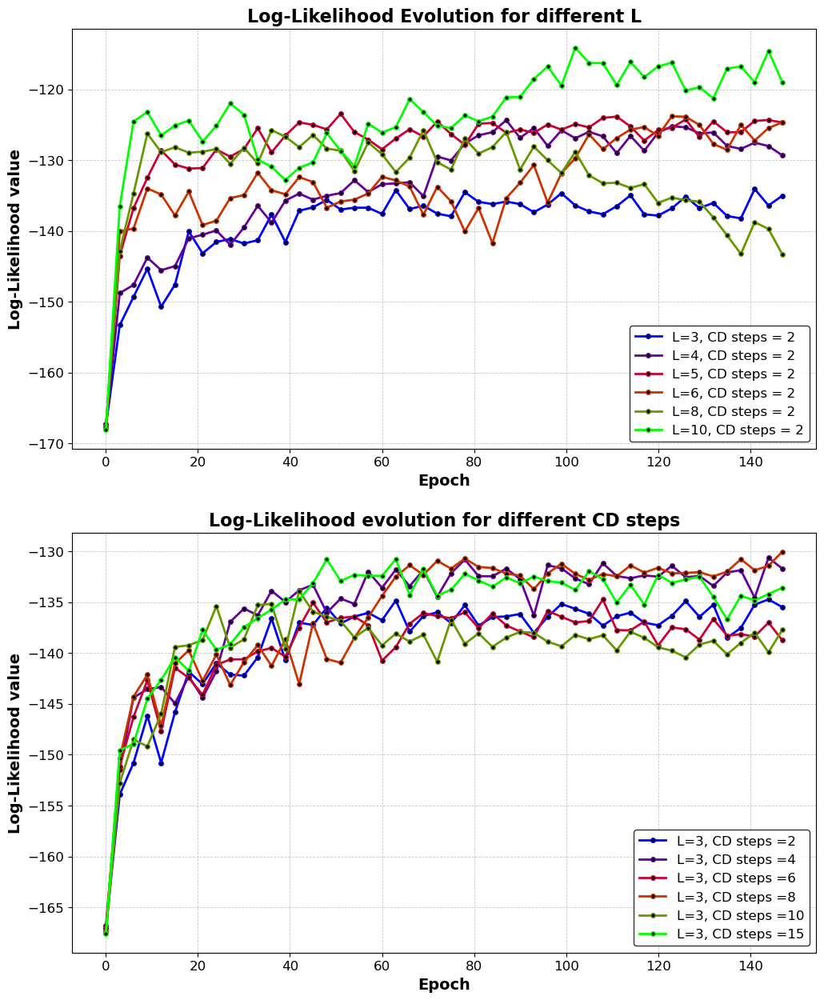

In [18]:
# drawing graphs
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
log_like_L=  [[-167.46639562, -153.30224022, -149.2998419, -145.34306566, -150.6928827,  
  -147.58903654, -140.05929498, -143.16418878, -141.5562486, -141.13334565,  
  -141.77690018, -141.30056009, -137.69138747, -141.56208266, -137.14274487,  
  -136.67157766, -135.60655794, -136.97555371, -136.72116198, -136.72376396,  
  -137.59913727, -134.23329747, -136.9113512, -136.43255809, -137.56143278,  
  -137.93122748, -134.52485714, -135.90228161, -136.19872291, -135.86557528,  
  -136.20254188, -137.36244353, -136.26979333, -134.67619644, -136.39688289,  
  -137.24671767, -137.63853119, -136.5077115, -134.96660972, -137.6568061,  
  -137.83050153, -136.80611264, -135.14433081, -136.78365085, -136.03322125,  
  -137.88975364, -138.22442291, -134.07610994, -136.4088892, -135.02388182],  

 [-167.26125039, -148.77345297, -147.6171454, -143.75963014, -145.53704543,  
  -144.96919542, -141.0423499, -140.53574993, -139.92773109, -141.95504743,  
  -139.50266357, -136.44388148, -138.83589855, -135.70874327, -134.73380955,  
  -135.58305725, -135.030171, -134.65627441, -132.84599023, -134.51691531,  
  -133.39991381, -133.28521162, -133.12045973, -135.09635184, -129.49054341,  
  -130.05456029, -127.66314906, -126.49595232, -126.06259646, -124.36576746,  
  -126.86064156, -125.45877065, -128.00728459, -125.78873956, -126.91742723,  
  -126.00329362, -126.64954812, -129.02026052, -126.58428109, -128.68630528,  
  -126.1303682, -125.22974574, -125.37308333, -126.21824197, -126.10343221,  
  -127.99399668, -128.41999321, -127.53934007, -128.02000938, -129.33495177],  

 [-167.96045579, -143.50424349, -136.77885881, -132.49927278, -128.61238634,  
  -130.62356925, -131.19865517, -131.1161634, -128.4960581, -129.51300361,  
  -128.43256712, -125.50002279, -128.91074953, -126.53231121, -124.67885995,  
  -125.02436452, -125.66659635, -123.47014893, -126.03663122, -127.10812294,  
  -128.47155502, -126.95461204, -125.64471866, -126.66414488, -124.55211452,  
  -126.32281053, -127.85108434, -124.87571502, -124.74612735, -126.15168095,  
  -125.69035485, -126.1406903, -124.98345671, -125.70115001, -124.92163152,  
  -125.38063556, -124.04439094, -123.85892307, -125.25141806, -127.23410168,  
  -125.74845135, -125.42903242, -124.25994692, -126.76662586, -124.51464281,  
  -126.07712994, -126.05035061, -124.46543898, -124.3472258, -124.68819872],  

 [-167.82839428, -140.02720428, -139.66024198, -133.9979687, -134.85249625,  
  -137.81450788, -134.44622386, -139.15994837, -138.55250615, -135.35959551,  
  -134.93654412, -131.78906784, -134.26209234, -134.81862859, -132.40719999,  
  -133.09283082, -136.71855342, -135.83997309, -135.5827644, -134.70117667,  
  -132.37018226, -132.86230545, -133.73405975, -137.70880844, -133.76906178,  
  -135.82329008, -140.06562352, -136.76019913, -141.72971189, -135.37188385,  
  -133.20323607, -130.68581203, -136.00155483, -131.85581558, -129.7339999,  
  -126.35954185, -128.45950163, -126.88807939, -125.68995293, -125.33446793,  
  -126.57387264, -123.80593995, -123.88324929, -125.04275814, -127.71518492,  
  -128.56120083, -125.00912256, -127.235413, -125.47838408, -124.67275409],  

 [-167.56168704, -142.8378642, -134.71371841, -126.24903893, -128.88253274,  
  -128.174234, -128.9556023, -128.81815463, -128.4414534, -130.52554058,  
  -128.25344745, -130.48209458, -125.76439217, -126.71267336, -128.17051108,  
  -126.45442285, -128.37395256, -128.66418634, -131.55238835, -127.50814445,  
  -129.17023855, -131.68753897, -129.65844807, -125.78235324, -130.29459529,  
  -131.34455809, -126.95361728, -129.07105531, -128.17530346, -126.0266972,  
  -131.33470877, -128.1106469, -130.01699103, -131.8450078, -128.8238097,  
  -132.14912457, -133.26551385, -133.20260346, -133.92757163, -133.39419064,  
  -136.02737913, -135.30374556, -135.6643038, -135.86922388, -138.08684597,  
  -140.62545218, -143.24514671, -138.76128764, -139.71833384, -143.29595282],  

 [-168.02160816, -136.49303448, -124.54118528, -123.21012024, -126.51225333,  
  -125.1232795, -124.40559294, -127.38053124, -125.15672713, -121.98535241,  
  -123.60695775, -129.92706931, -130.94066255, -132.80274195, -131.06788915,  
  -130.3417687, -126.1926997, -128.69649994, -130.84296853, -124.85462726,  
  -126.11755523, -125.34316467, -121.3889479, -123.22057436, -125.12626841,  
  -125.49042897, -123.69047746, -124.52384664, -123.8478302, -121.14757321,  
  -121.07578731, -118.55811729, -116.78297451, -119.48616377, -114.13198263,  
  -116.30035041, -116.30145242, -119.42028825, -116.14413511, -118.27649553,  
  -116.78625213, -116.23294539, -120.18589176, -119.71331766, -121.27313235,  
  -117.0686234, -116.79509889, -118.99634973, -114.57554406, -119.01322526]]  
log_like_cd=[[-167.06195825, -153.91380773, -150.79911203, -146.18286317, -150.79751394, -145.83368566, -141.83796781, -143.07079173, -140.99871912, -142.12682516, -142.22555043, -140.41957902, -136.61794029, -140.72320945, -137.02533089, -137.24895117, -135.54764096, -137.10179326, -136.42801905, -136.06021395, -136.78500667, -134.84579821, -137.90251346, -136.38151147, -135.99726568, -137.06047927, -135.3057863, -137.31241494, -136.47912745, -136.4112143, -136.17395895, -138.01282432, -136.45627614, -135.18712118, -135.66665645, -136.14874331, -137.32125231, -136.39701094, -136.03968115, -137.02636354, -137.27674244, -136.34301941, -134.91024642, -136.45110741, -135.25465109, -138.5097835, -137.53445534, -135.25248447, -134.73931133, -135.50172223],  
[-167.36940146, -151.43773273, -144.38456729, -143.56116546, -143.35274881, -144.96469605, -142.30127428, -144.39895466, -141.79634594, -136.95203828, -135.63967128, -136.30290108, -133.89693108, -134.99542197, -133.84014329, -133.29639518, -136.05655595, -134.65821345, -135.17786518, -132.00759639, -133.59414597, -131.81053497, -133.43774762, -131.8427446, -134.49006217, -132.17387961, -130.82083707, -132.4570818, -132.46815092, -131.71225464, -132.73711858, -136.32714043, -131.37788768, -131.6937956, -132.68132608, -133.25173398, -131.18101439, -132.44167619, -132.66020855, -132.38149934, -132.50923721, -131.42889962, -132.56202272, -132.43300186, -133.42060308, -132.09346581, -131.87058059, -134.57359531, -130.64308683, -131.71583987],  
[-166.76340288, -151.15352519, -146.27894989, -142.69076322, -147.71445502, -141.44545042, -142.45002447, -144.10287991, -141.17957245, -140.63711474, -140.62353996, -139.85141189, -139.50337732, -140.37725486, -137.5098847, -135.0570553, -136.99723131, -136.55809345, -136.42198081, -137.28494161, -140.75155583, -139.42824708, -137.1325191, -136.08375759, -136.37213303, -136.59410698, -136.00938084, -137.56789881, -136.10471055, -137.29371669, -137.89614581, -138.45132446, -135.87242494, -136.44733559, -137.0019507, -136.86439671, -134.74541758, -137.75032469, -137.7807965, -136.9083288, -139.26098801, -137.49086546, -137.67328807, -138.69091278, -136.66958834, -138.29734077, -138.16385851, -138.38227959, -137.01459933, -138.75257592],  
[-167.31564282, -150.35861218, -144.29489631, -142.13831513, -147.16972181, -141.04046833, -139.74240721, -142.73999371, -140.16049709, -143.15510122, -140.90457872, -139.22911231, -141.28042089, -138.64478475, -143.06238389, -137.07448908, -140.59845477, -140.95878312, -138.50455966, -136.50814773, -134.39514179, -132.50361026, -131.3766468, -132.33407555, -130.94119328, -131.71599215, -130.72131673, -131.55073845, -131.65475048, -132.20397536, -132.3993321, -133.73495199, -132.18985969, -131.22713267, -132.23505959, -132.81279748, -132.24614706, -132.47169307, -131.40155805, -132.09725856, -131.62989664, -132.18061738, -132.13322236, -132.06134593, -132.48208518, -132.00358384, -130.78705169, -131.87597167, -131.43193712, -130.04848288],  
[-167.47056591, -152.78426781, -148.50821709, -149.18253968, -145.98741749, -139.42141992, -139.24265311, -138.73428581, -135.40335747, -139.47881686, -138.65822663, -135.30143411, -135.17698744, -139.56140382, -133.92194371, -135.9391622, -136.43983222, -136.85905777, -138.47885275, -137.53233338, -139.25807741, -138.09750044, -138.88606529, -138.20988584, -140.86382656, -136.72671812, -139.1053297, -138.07449659, -139.40683765, -138.48899085, -137.93185797, -138.01088858, -138.90194016, -139.34268787, -138.23128832, -138.65132015, -138.2641439, -139.7442488, -137.91656113, -138.51401102, -139.44086498, -139.77781711, -140.43495971, -139.17682657, -138.80485856, -140.13499743, -139.00813223, -138.00225445, -139.93861783, -137.73756883],  
[-167.56688306, -149.57459004, -148.92201577, -144.49699484, -142.65000422, -140.42804414, -141.74483508, -137.73953022, -139.69429143, -139.14603038, -137.47472516, -136.56899744, -135.74029496, -134.75351824, -134.72844823, -133.15593863, -130.7901138, -132.93062435, -132.32729123, -132.41780206, -132.41892985, -130.78128992, -134.29778061, -131.76417546, -134.36682334, -133.78541633, -132.22659407, -132.87452003, -133.49623975, -132.57566791, -133.15314232, -132.49289833, -132.94989403, -133.08114273, -133.81245823, -131.9561397, -132.75947195, -135.04058372, -133.29644009, -135.24457994, -132.32634396, -133.11409381, -132.7770832, -132.51737443, -134.48169441, -136.6978821, -134.3740188, -134.8378947, -134.21187633, -133.59259214]]  
num_epo=[0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48, 51, 54, 57, 60,  
63, 66, 69, 72, 75, 78, 81, 84, 87, 90, 93, 96, 99, 102, 105, 108, 111, 114, 117, 120,  
123, 126, 129, 132, 135, 138, 141, 144, 147] 
L_v=[3,4,5,6,8,10]
Nt_v=[2,4,6,8,10,15]

colors = plt.cm.brg(np.linspace(0, 1, len(log_like_L)))
for i,log_like in enumerate(log_like_L): # fixed CD steps=2
    ax1.plot(num_epo, log_like, label=f'L={L_v[i]}, CD steps = 2',linewidth=2, color=colors[i], marker='o',markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax1.set_title('Log-Likelihood Evolution for different L', fontsize=16, fontweight='bold')
    ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    #ax1.set_xticks(num_epo)
    ax1.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

for i,log_like in enumerate(log_like_cd): # fixed L=3
    ax2.plot(num_epo, log_like, label=f'L=3, CD steps ={Nt_v[i]}',color=colors[i],marker='o',linewidth=2, markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax2.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax2.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax2.set_title('Log-Likelihood evolution for different CD steps', fontsize=16, fontweight='bold')
    #ax2.set_xticks(num_epo)
    ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    ax2.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

plt.show()


## Likelihood dependance on number of visible variables and CD steps  

Now we want to compare the likelihood values after the transient, in the last epochs of training, varying the parameters L and Nt. We previously observed that the likelihood appers to be quite stable after a certain number of epochs, but this needs to be verified more rigorously considering more iterations for each likelihhod estimation (10 for computational feasability), and taking their average and standard deviation. We focus on the last 10 epochs and, after verifying the stability of the likelihood, we compare their average values for the different number of visible variables and CD steps considered.       

In [ ]:
# Log-likelyhood after transient for different L and fixed CD steps = 2: stability check and mean; mean comparison for different L

log_like_L=[]
log_like_L_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

for L in L_v:
    Nt=2
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    log_like_std=[]
    for i in range(Nepoch-10,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter= []
        for iter in range(10): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like.append(ll_mean)
        log_like_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_L.append(log_like)
    log_like_L_std.append(log_like_std)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1259.76it/s]


Log-likelihood= -135.33417648347438 +- 0.4948436913465755
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1140.92it/s]


Log-likelihood= -134.8111327991385 +- 0.7519264151407518
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1185.13it/s]


Log-likelihood= -135.55996648476102 +- 0.4509732611999631
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.98it/s]


Log-likelihood= -135.3511763225206 +- 0.547801735890055
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.27it/s]


Log-likelihood= -135.90257631379617 +- 0.728230882196492
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.41it/s]


Log-likelihood= -136.76855143709196 +- 0.47586230560254345
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1279.10it/s]


Log-likelihood= -135.16244862200264 +- 0.5562445680022283
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.01it/s]


Log-likelihood= -135.29951070916115 +- 0.6054118397588848
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1167.63it/s]


Log-likelihood= -137.856631852215 +- 0.3441585016734641
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.59it/s]


Log-likelihood= -136.16619959293686 +- 0.25801107424517805
a_all L=4, Nt=2
b_all L=4, Nt=2
w_all L=4, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 513.36it/s]


Log-likelihood= -127.23964660500101 +- 0.6780543748242523
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 664.22it/s]


Log-likelihood= -127.51342276154364 +- 0.6509824597578027
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 660.13it/s]


Log-likelihood= -127.10669977917291 +- 0.5055897364897357
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 664.17it/s]


Log-likelihood= -127.87576526185676 +- 0.4787348963725224
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 668.49it/s]


Log-likelihood= -128.63018612941715 +- 0.519124372826951
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 658.09it/s]


Log-likelihood= -126.13121638301577 +- 0.32314326017105055
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 630.02it/s]


Log-likelihood= -128.37572819065633 +- 0.5815404561838426
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 630.22it/s]


Log-likelihood= -127.59672423564625 +- 0.3357670414481326
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.76it/s]


Log-likelihood= -127.85731339124989 +- 0.60759003302781
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 522.57it/s]


Log-likelihood= -127.24332584476846 +- 0.3837833880827182
a_all L=5, Nt=2
b_all L=5, Nt=2
w_all L=5, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 286.59it/s]


Log-likelihood= -124.89476238745674 +- 0.9758199745947126
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 324.57it/s]


Log-likelihood= -124.32258789311607 +- 0.600548972734193
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.41it/s]


Log-likelihood= -125.20089106503936 +- 0.6650164555437056
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 496.01it/s]


Log-likelihood= -124.39628785756847 +- 0.5295998619426238
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 633.18it/s]


Log-likelihood= -124.21529083572823 +- 0.6846724798821712
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 640.20it/s]


Log-likelihood= -124.71925130957898 +- 0.6167279671393802
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 521.09it/s]


Log-likelihood= -124.59398138047318 +- 0.5755982318103808
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 637.73it/s]


Log-likelihood= -124.75019284466148 +- 0.501963749973891
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 642.09it/s]


Log-likelihood= -124.58670012040932 +- 0.6344227892486787
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 522.32it/s]


Log-likelihood= -126.353581685533 +- 0.6850705981884185
a_all L=6, Nt=2
b_all L=6, Nt=2
w_all L=6, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 283.45it/s]


Log-likelihood= -124.39803732334796 +- 0.5754579471967136
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.32it/s]


Log-likelihood= -128.07955933051826 +- 0.3888809271906497
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 322.19it/s]


Log-likelihood= -126.26470575733603 +- 0.5187534766411706
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 292.17it/s]


Log-likelihood= -125.09584782778013 +- 0.5254182921438733
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 321.92it/s]


Log-likelihood= -125.1264102145808 +- 0.5315586332479377
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 326.19it/s]


Log-likelihood= -122.57487770281391 +- 0.904060831077091
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 290.48it/s]


Log-likelihood= -125.33736516050458 +- 0.5439818076971923
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.44it/s]


Log-likelihood= -124.25358464764872 +- 0.5476136563096112
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 336.04it/s]


Log-likelihood= -123.90844003512714 +- 0.4056092130889154
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 327.66it/s]


Log-likelihood= -125.34595677910254 +- 0.7057755641162581
a_all L=8, Nt=2
b_all L=8, Nt=2
w_all L=8, Nt=2
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.15it/s]


Log-likelihood= -138.8940384882829 +- 0.6695564998307214
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.37it/s]


Log-likelihood= -138.8846233625182 +- 0.5734429837321443
Epoch n.142


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.96it/s]


Log-likelihood= -141.19081979456698 +- 0.40445018925136705
Epoch n.143


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.43it/s]


Log-likelihood= -142.0026786300512 +- 0.7902159243919353
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.88it/s]


Log-likelihood= -139.93224318546316 +- 0.5682470997883244
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.38it/s]


Log-likelihood= -143.31943112793687 +- 0.39284761572730864
Epoch n.146


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.90it/s]


Log-likelihood= -142.93490990751363 +- 0.6556731291415835
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.81it/s]


Log-likelihood= -142.83249761388294 +- 0.4144386309838914
Epoch n.148


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.91it/s]


Log-likelihood= -144.50049937518668 +- 0.4488331629640661
Epoch n.149


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:13<00:00, 74.72it/s]


Log-likelihood= -143.95647410022974 +- 0.6227667792952782
a_all L=10, Nt=2
b_all L=10, Nt=2
w_all L=10, Nt=2
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:44<00:00, 19.29it/s]


Log-likelihood= -120.98272949543063 +- 0.1880402209943159
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:59<00:00, 18.34it/s]


Log-likelihood= -119.06022603199169 +- 0.3886766717074701
Epoch n.142


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.52it/s]


Log-likelihood= -118.15374164821438 +- 0.44014342644319515
Epoch n.143


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:33<00:00, 20.10it/s]


Log-likelihood= -120.63752887443452 +- 0.37117820128720863
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -115.27407393736273 +- 0.5426310855937532
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.72it/s]


Log-likelihood= -118.33354007929377 +- 0.2893632765113282
Epoch n.146


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.56it/s]


Log-likelihood= -118.2082683436015 +- 0.5958565634503485
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:51<00:00, 18.88it/s]


Log-likelihood= -119.16769683870943 +- 0.4292029640536674
Epoch n.148


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:50<00:00, 18.92it/s]


Log-likelihood= -115.77222552770385 +- 0.2773327479113979
Epoch n.149


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:55<00:00, 18.58it/s]

Log-likelihood= -114.99729793520255 +- 0.7080737294347231


In [68]:
#import dill
#dill.dump_session('save_ll_1.7.db')
#import dill
#dill.load_session('save_ll.db_1.7')
#

In [ ]:
# Log-likelyhood after transient for different CD steps and fixed L = 3: stability check and mean; mean comparison for different CD steps

log_like_cd=[]
log_like_cd_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

for L in L_v:
    if L==3:
        for Nt in Nt_v:
            a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
            b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
            w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

            log_like=[]
            log_like_std=[]
            Nepoch=150
            for i in range(Nepoch-10,Nepoch,1):
                print(f'Epoch n.{i}')
                ll_iter=[]
                mean=[]
                for iter in range(10): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
                    ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
                    ll_iter.append(ll)
                ll_mean= np.array(ll_iter).mean()
                ll_std= np.array(ll_iter).std()
                log_like.append(ll_mean)
                log_like_std.append(ll_std)
                print('Log-likelihood=',ll_mean,"+-",ll_std)
            log_like_cd.append(log_like)
            log_like_cd_std.append(log_like_std)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2303.36it/s]


Log-likelihood= -135.40244199882693 +- 0.4064576716831954
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2281.73it/s]


Log-likelihood= -134.80174518824106 +- 0.6544495331297595
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2255.27it/s]


Log-likelihood= -135.4733447721828 +- 0.4727529126773889
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2281.40it/s]


Log-likelihood= -134.85709953691213 +- 0.5561732850054889
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2287.75it/s]


Log-likelihood= -135.60779506409935 +- 0.38213269719854126
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.47it/s]


Log-likelihood= -136.66377353849435 +- 0.7581315063921562
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2318.56it/s]


Log-likelihood= -135.32058149727166 +- 0.2423803120777691
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2088.95it/s]


Log-likelihood= -135.46887302374594 +- 0.5678899520697064
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2185.31it/s]


Log-likelihood= -137.95932993407374 +- 0.4370521579879841
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2264.38it/s]


Log-likelihood= -136.34938393386227 +- 0.3984022302331581
a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2145.98it/s]


Log-likelihood= -131.78400472104974 +- 0.6156035629335075
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2046.90it/s]


Log-likelihood= -133.4510570424571 +- 0.7007948806647603
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2128.24it/s]


Log-likelihood= -131.65811079246814 +- 0.5635793653271923
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2194.06it/s]


Log-likelihood= -132.15154309424784 +- 0.560565735000031
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2213.10it/s]


Log-likelihood= -132.04595727772278 +- 0.6755670677629372
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2287.43it/s]


Log-likelihood= -132.60066211388505 +- 0.6671162489332465
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2236.96it/s]


Log-likelihood= -131.97316505605727 +- 0.6878004506596289
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2116.09it/s]


Log-likelihood= -131.5429920280286 +- 0.5377688847156716
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2195.19it/s]


Log-likelihood= -131.48110043235027 +- 0.6864442451894349
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2124.71it/s]


Log-likelihood= -131.6920525186129 +- 0.7851726696602334
a_all L=3, Nt=6
b_all L=3, Nt=6
w_all L=3, Nt=6
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2303.93it/s]


Log-likelihood= -138.5189379465333 +- 0.588272834139861
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2231.17it/s]


Log-likelihood= -138.0830687221584 +- 0.533357643559949
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2112.52it/s]


Log-likelihood= -136.69706982423364 +- 0.4469185615013901
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2181.67it/s]


Log-likelihood= -139.25442254791417 +- 0.43331996389215605
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2297.09it/s]


Log-likelihood= -137.522518426016 +- 0.41561270607493656
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3205.86it/s]


Log-likelihood= -139.0266563235406 +- 0.560888616334427
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2300.66it/s]


Log-likelihood= -137.09725928832418 +- 0.5871874193054396
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2192.89it/s]


Log-likelihood= -138.87441175683392 +- 0.556122196952543
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2216.75it/s]


Log-likelihood= -137.2204115241542 +- 0.3870065509106904
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2222.09it/s]


Log-likelihood= -137.1386697223408 +- 0.41515645049600175
a_all L=3, Nt=8
b_all L=3, Nt=8
w_all L=3, Nt=8
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2211.36it/s]


Log-likelihood= -131.93444690763366 +- 0.5992888370884695
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2238.25it/s]


Log-likelihood= -131.26384222353695 +- 0.633165671183006
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2215.65it/s]


Log-likelihood= -131.83929376012918 +- 0.6172394313356687
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2121.61it/s]


Log-likelihood= -132.75838543082148 +- 0.6102940064162099
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 2961.52it/s]


Log-likelihood= -131.50124926168507 +- 0.5949768092231003
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2166.11it/s]


Log-likelihood= -131.70532187613148 +- 0.4150116301992774
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2237.69it/s]


Log-likelihood= -131.39400500651692 +- 0.5506826404248658
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2271.43it/s]


Log-likelihood= -131.9267508834783 +- 0.6128364020183464
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2297.70it/s]


Log-likelihood= -132.07714446105746 +- 0.6500349131992584
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2209.74it/s]


Log-likelihood= -132.65609932041366 +- 0.555598822602165
a_all L=3, Nt=10
b_all L=3, Nt=10
w_all L=3, Nt=10
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2269.61it/s]


Log-likelihood= -139.22652463607128 +- 0.4957176355423664
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2283.60it/s]


Log-likelihood= -138.2416056269301 +- 0.4765155792163485
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3365.60it/s]


Log-likelihood= -138.19518722014908 +- 0.6447341640592643
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2322.81it/s]


Log-likelihood= -138.79636511472617 +- 0.47976882421021505
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2242.59it/s]


Log-likelihood= -138.86111333115795 +- 0.4910005354421933
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2210.69it/s]


Log-likelihood= -139.37913916431813 +- 0.6591393618671353
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2244.12it/s]


Log-likelihood= -137.25599268025408 +- 0.48488594644730243
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2181.36it/s]


Log-likelihood= -137.32012826392247 +- 0.5331333744545672
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2192.51it/s]


Log-likelihood= -138.8454413367235 +- 0.24931820809070573
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2104.26it/s]


Log-likelihood= -139.7254582172481 +- 0.45059376677110324
a_all L=3, Nt=15
b_all L=3, Nt=15
w_all L=3, Nt=15
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2290.55it/s]


Log-likelihood= -134.95994553501606 +- 0.4446400687830309
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2248.70it/s]


Log-likelihood= -134.5258668775715 +- 0.8428762802819025
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2252.34it/s]


Log-likelihood= -134.39313539889125 +- 0.6601746132077289
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.19it/s]


Log-likelihood= -134.80374006767016 +- 0.7263023012433573
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2352.10it/s]


Log-likelihood= -134.62408650413028 +- 0.71548688680001
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3120.23it/s]


Log-likelihood= -135.23556137915062 +- 0.5754182086565504
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2221.82it/s]


Log-likelihood= -135.3570455709304 +- 0.5345471318252437
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2256.19it/s]


Log-likelihood= -133.8319397373477 +- 0.5191095584380684
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2213.68it/s]


Log-likelihood= -134.81752609460844 +- 0.6343818886318692
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2298.82it/s]

Log-likelihood= -134.50114583157932 +- 0.6634738584173402


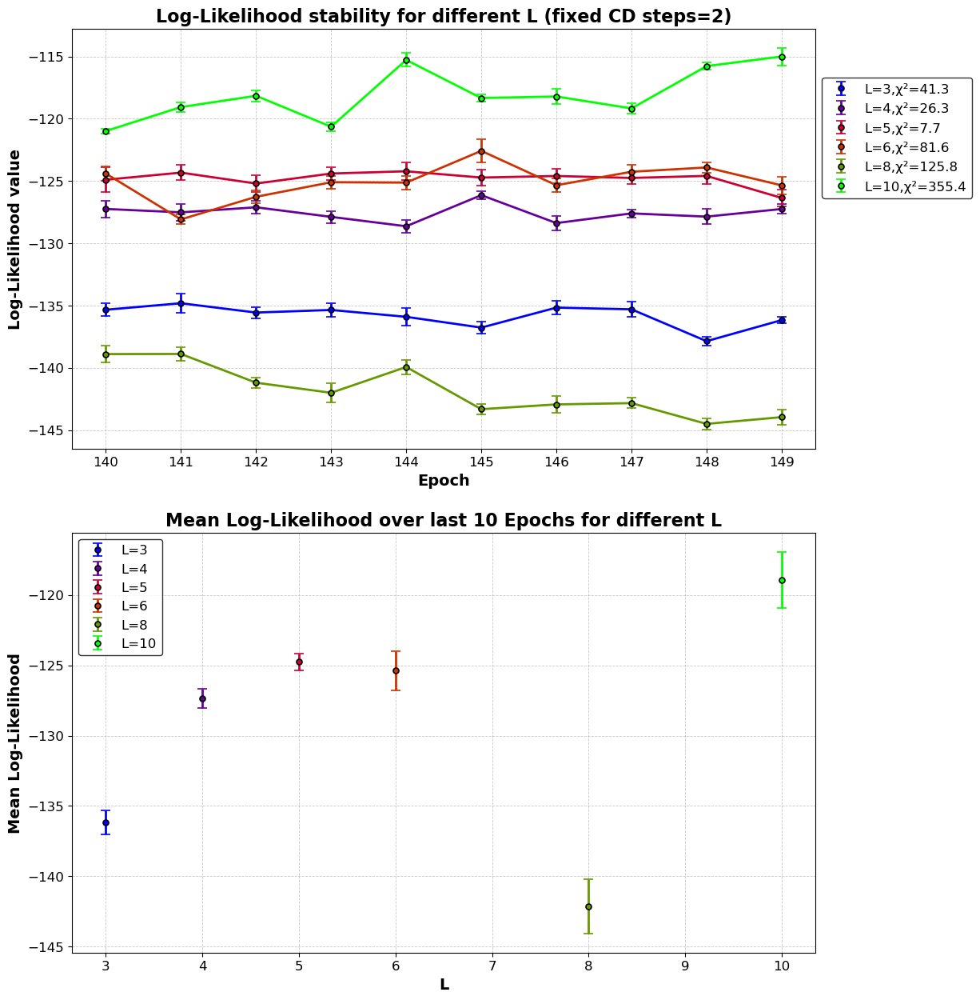

In [13]:
# plots of log-likelihood of last 10 epochs and their mean
log_like_L=[[-135.33417648, -134.8111328, -135.55996648, -135.35117632, -135.90257631,
  -136.76855144, -135.16244862, -135.29951071, -137.85663185, -136.16619959],
 [-127.23964661, -127.51342276, -127.10669978, -127.87576526, -128.63018613,
  -126.13121638, -128.37572819, -127.59672424, -127.85731339, -127.24332584],
 [-124.89476239, -124.32258789, -125.20089107, -124.39628786, -124.21529084,
  -124.71925131, -124.59398138, -124.75019284, -124.58670012, -126.35358169],
 [-124.39803732, -128.07955933, -126.26470576, -125.09584783, -125.12641021,
  -122.5748777, -125.33736516, -124.25358465, -123.90844004, -125.34595678],
 [-138.89403849, -138.88462336, -141.19081979, -142.00267863, -139.93224319,
  -143.31943113, -142.93490991, -142.83249761, -144.50049938, -143.9564741],
 [-120.9827295, -119.06022603, -118.15374165, -120.63752887, -115.27407394,
  -118.33354008, -118.20826834, -119.16769684, -115.77222553, -114.99729794]]
log_like_L_std=[[0.49484369, 0.75192642, 0.45097326, 0.54780174, 0.72823088, 0.47586231,
  0.55624457, 0.60541184, 0.3441585, 0.25801107],
 [0.67805437, 0.65098246, 0.50558974, 0.4787349, 0.51912437, 0.32314326,
  0.58154046, 0.33576704, 0.60759003, 0.38378339],
 [0.97581997, 0.60054897, 0.66501646, 0.52959986, 0.68467248, 0.61672797,
  0.57559823, 0.50196375, 0.63442279, 0.6850706],
 [0.57545795, 0.38888093, 0.51875348, 0.52541829, 0.53155863, 0.90406083,
  0.54398181, 0.54761366, 0.40560921, 0.70577556],
 [0.6695565, 0.57344298, 0.40445019, 0.79021592, 0.5682471, 0.39284762,
  0.65567313, 0.41443863, 0.44883316, 0.62276678],
 [0.18804022, 0.38867667, 0.44014343, 0.3711782, 0.54263109, 0.28936328,
  0.59585656, 0.42920296, 0.27733275, 0.70807373]]

Nepoch=150
# variable L, fixed CD steps
colors = plt.cm.brg(np.linspace(0, 1, len(log_like_L)))
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
num_epo=np.arange(Nepoch-10,Nepoch,1)

for i, log_like in enumerate(log_like_L):
    weights = 1 / np.array(log_like_L_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_L_std[i])** 2)

    ax1.errorbar(num_epo,log_like,yerr=log_like_L_std[i],fmt='o',color=colors[i],label=f'L={L_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(L_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'L={L_v[i]}',linewidth=2,markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    #ax1.plot(num_epo,np.ones(10)*weighted_avg,linestyle='--',color=colors[i])

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different L (fixed CD steps=2)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True,bbox_to_anchor=(1, 0.9), edgecolor='black')

ax2.set_xlabel('L', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different L', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

plt.show()

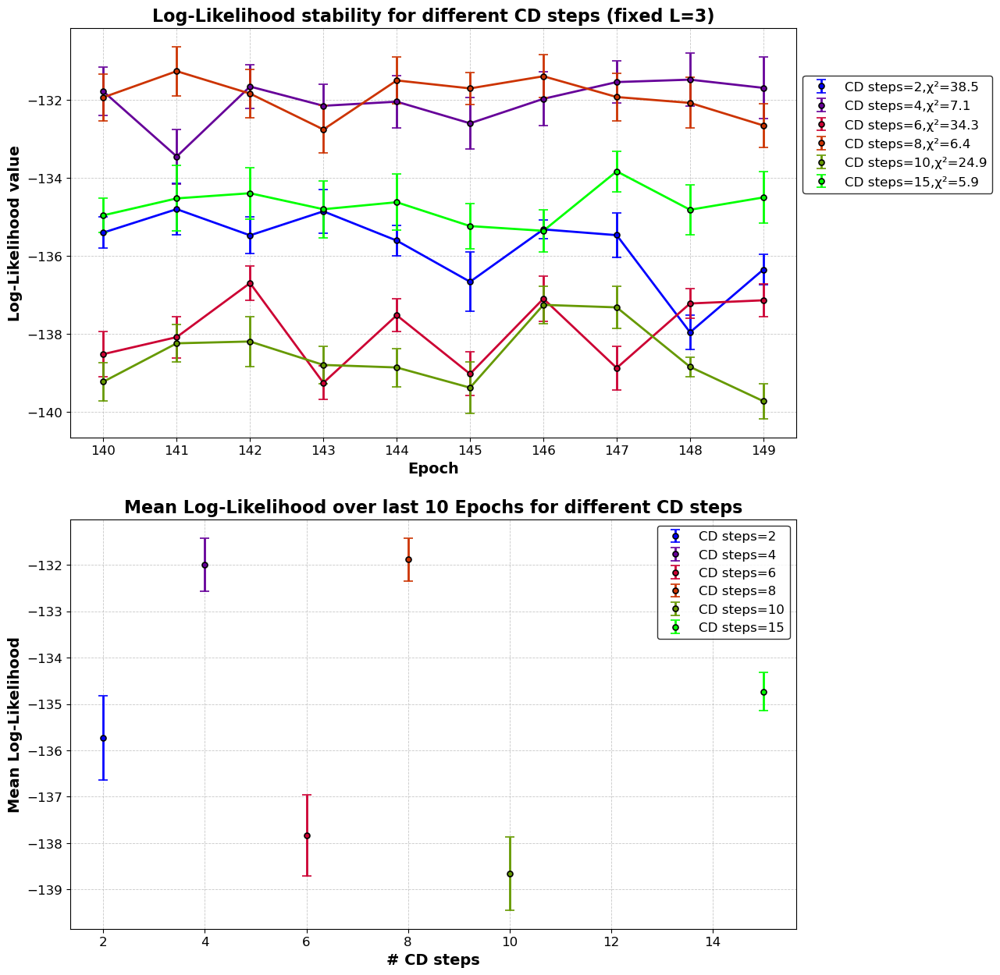

In [15]:
# variable CD steps, fixed L
colors = plt.cm.brg(np.linspace(0, 1, len(log_like_cd)))
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
log_like_cd = [[-135.402442, -134.80174519, -135.47334477, -134.85709954, -135.60779506, -136.66377354, -135.3205815, -135.46887302, -137.95932993, -136.34938393],
        [-131.78400472, -133.45105704, -131.65811079, -132.15154309, -132.04595728, -132.60066211, -131.97316506, -131.54299203, -131.48110043, -131.69205252],
        [-138.51893795, -138.08306872, -136.69706982, -139.25442255, -137.52251843, -139.02665632, -137.09725929, -138.87441176, -137.22041152, -137.13866972],
        [-131.93444691, -131.26384222, -131.83929376, -132.75838543, -131.50124926, -131.70532188, -131.39400501, -131.92675088, -132.07714446, -132.65609932],
        [-139.22652464, -138.24160563, -138.19518722, -138.79636511, -138.86111333, -139.37913916, -137.25599268, -137.32012826, -138.84544134, -139.72545822],
        [-134.95994554, -134.52586688, -134.3931354, -134.80374007, -134.6240865, -135.23556138, -135.35704557, -133.83193974, -134.81752609, -134.50114583]]

log_like_cd_std = [[0.40645767, 0.65444953, 0.47275291, 0.55617329, 0.3821327, 0.75813151, 0.24238031, 0.56788995, 0.43705216, 0.39840223],
       [0.61560356, 0.70079488, 0.56357937, 0.56056574, 0.67556707, 0.66711625, 0.68780045, 0.53776888, 0.68644425, 0.78517267],
       [0.58827283, 0.53335764, 0.44691856, 0.43331996, 0.41561271, 0.56088862, 0.58718742, 0.5561222, 0.38700655, 0.41515645],
       [0.59928884, 0.63316567, 0.61723943, 0.61029401, 0.59497681, 0.41501163, 0.55068264, 0.6128364, 0.65003491, 0.55559882],
       [0.49571764, 0.47651558, 0.64473416, 0.47976882, 0.49100054, 0.65913936, 0.48488595, 0.53313337, 0.24931821, 0.45059377],
       [0.44464007, 0.84287628, 0.66017461, 0.7263023, 0.71548689, 0.57541821, 0.53454713, 0.51910956, 0.63438189, 0.66347386]]


for i, log_like in enumerate(log_like_cd):
    weights = 1 / np.array(log_like_cd_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_cd_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_cd_std[i],fmt='o',color=colors[i],label=f'CD steps={Nt_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(Nt_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'CD steps={Nt_v[i]}',linewidth=2,markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    #ax1.plot(num_epo,np.ones(10)*weighted_avg,linestyle='--',color=colors[i])

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different CD steps (fixed L=3)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')
ax1.legend(fontsize=12, loc='best', frameon=True,bbox_to_anchor=(1, 0.9), edgecolor='black')


ax2.set_xlabel('# CD steps', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different CD steps', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

plt.show()

## Training for different regularization factors

Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

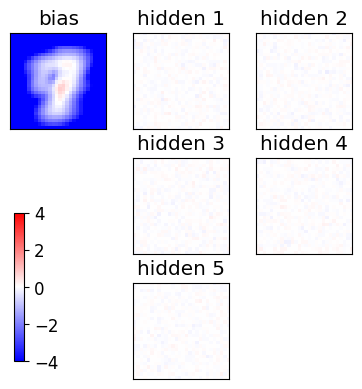

Starting the training
[13762  5407  5139 18824  3022 13556 13880  9621 19603  6252]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[ 4363 15877  8648  4167   493  6217  5094 15224 19288 20763]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[11572  1208 17461   539   701 16259 20623 17001  1746 17256]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[ 6398   708 12122 13365 13334  3311  9083   301 13458  3831]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

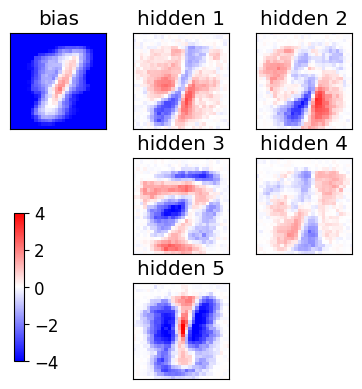

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

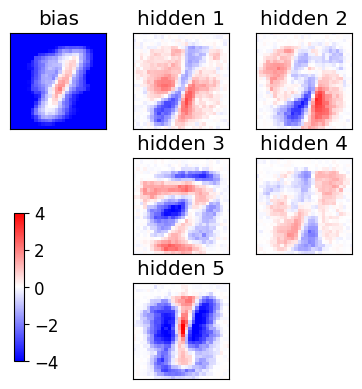

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

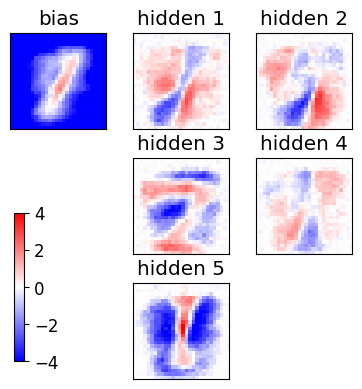

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

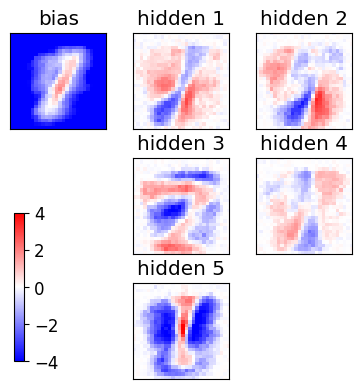

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

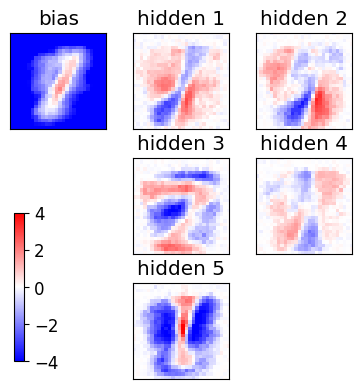

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

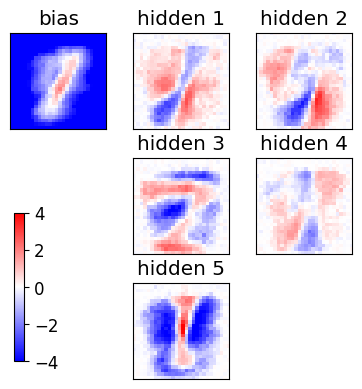

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

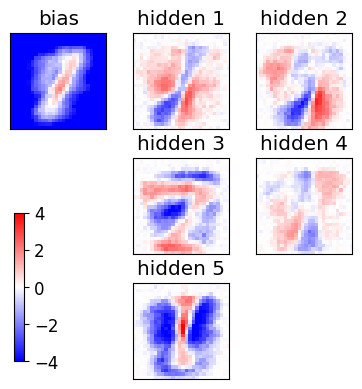

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

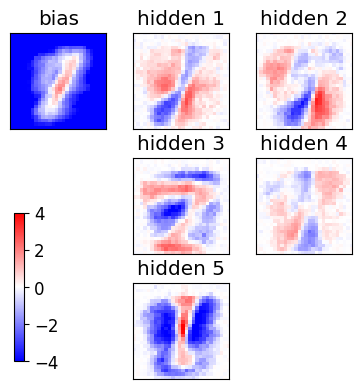

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

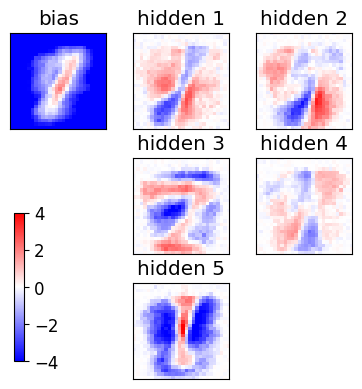

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

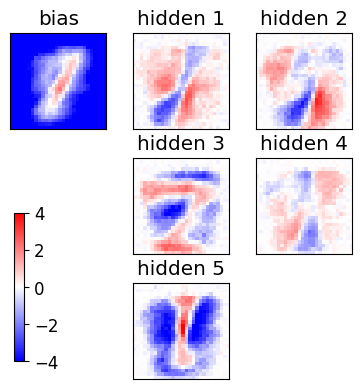

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

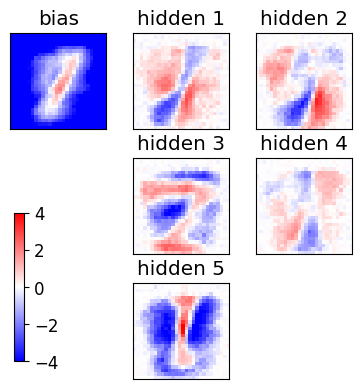

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

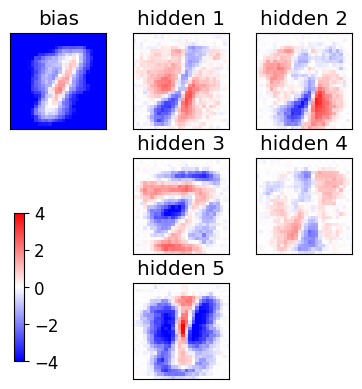

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

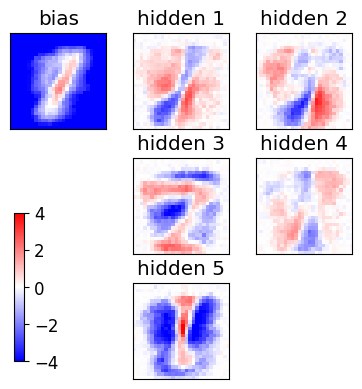

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

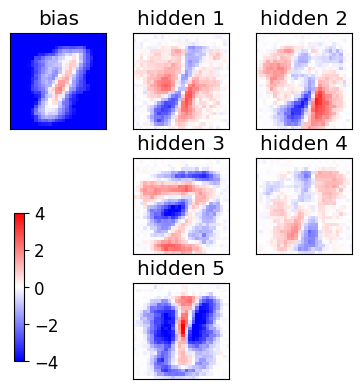

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

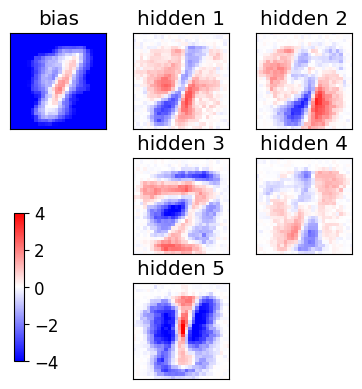

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

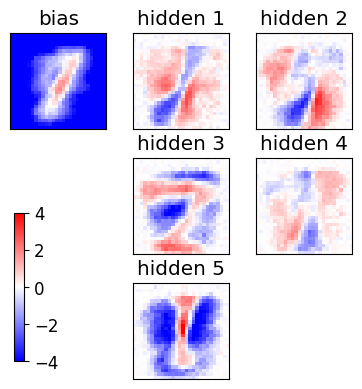

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

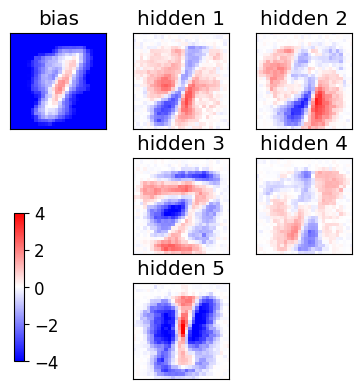

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

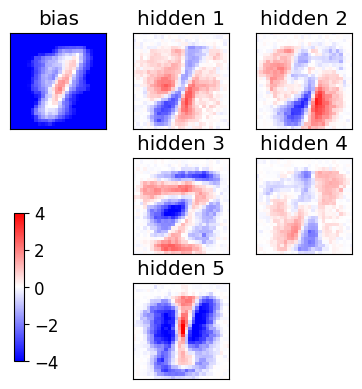

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

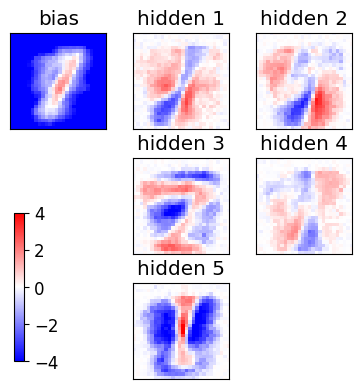

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

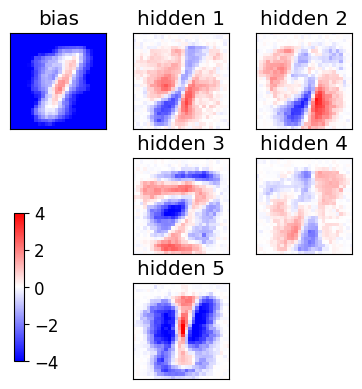

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

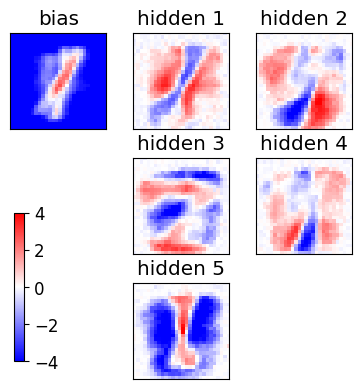

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

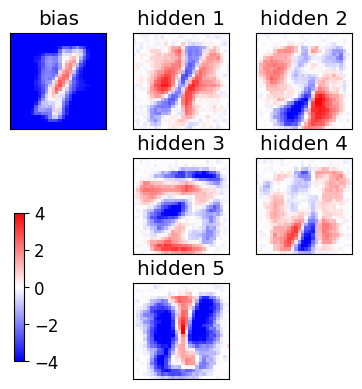

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

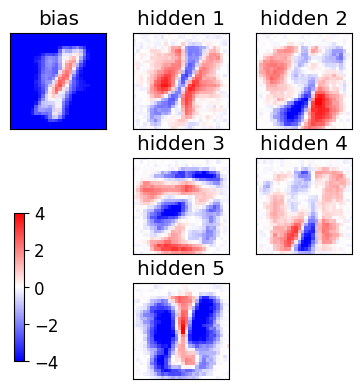

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

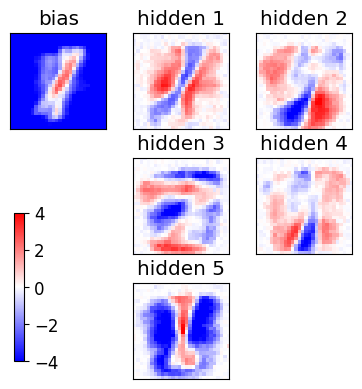

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

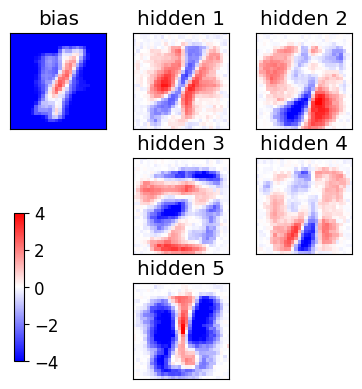

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

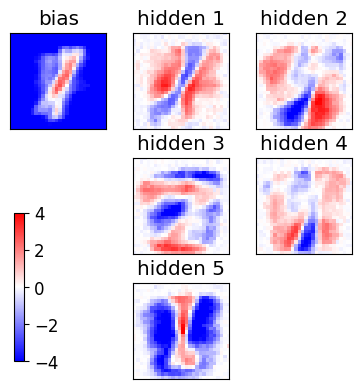

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

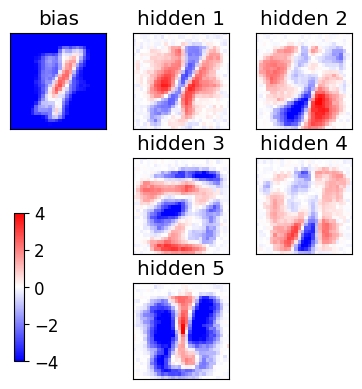

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

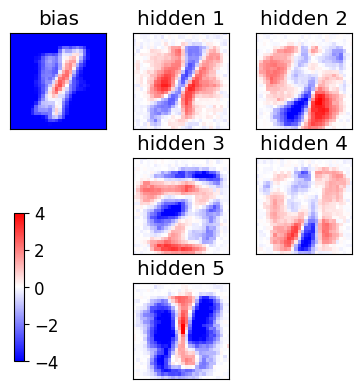

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

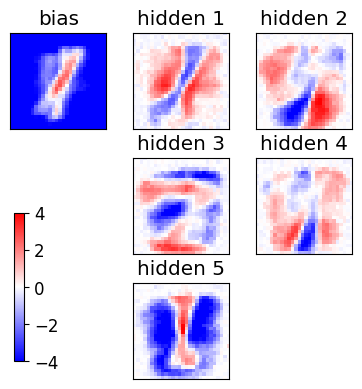

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

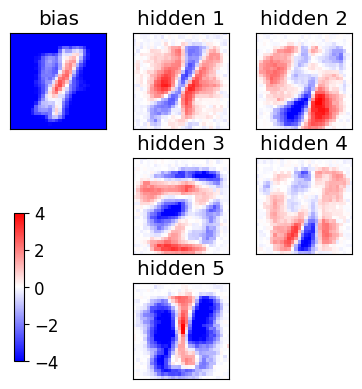

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

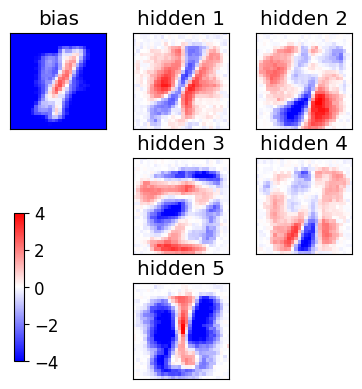

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

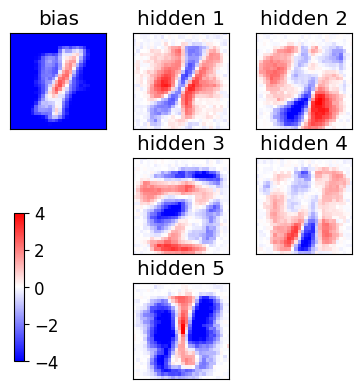

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

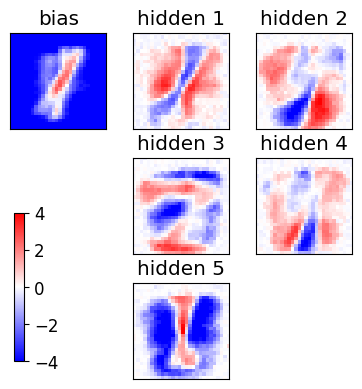

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

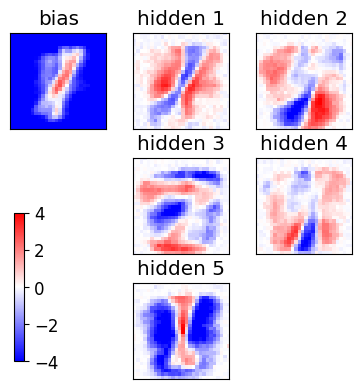

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

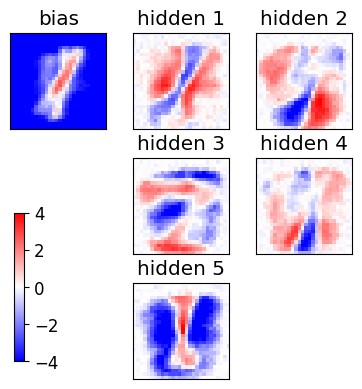

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

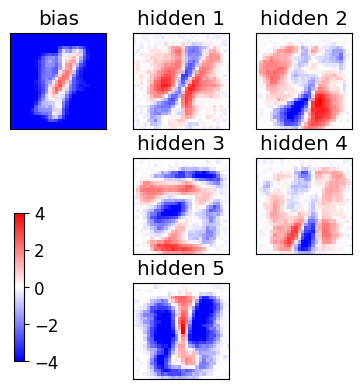

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

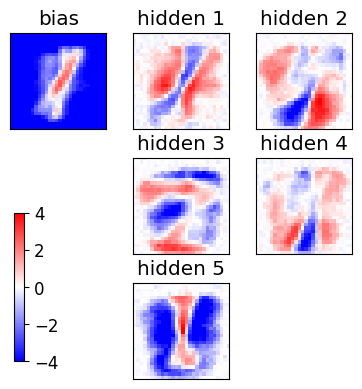

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

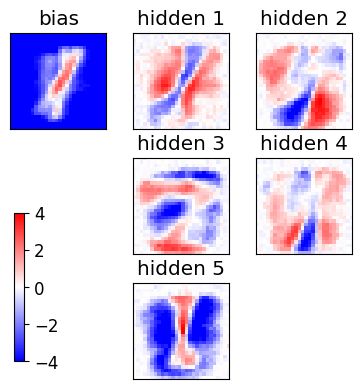

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

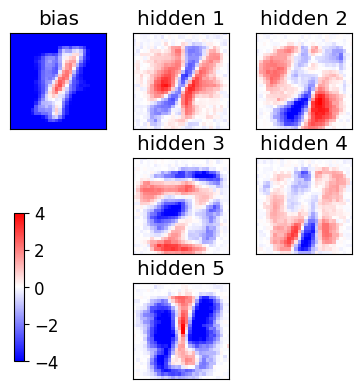

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

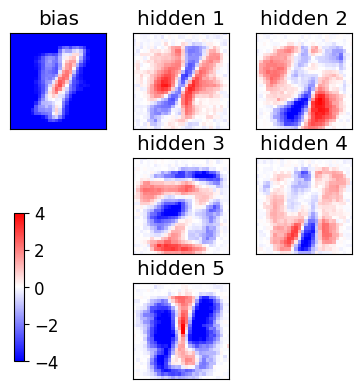

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

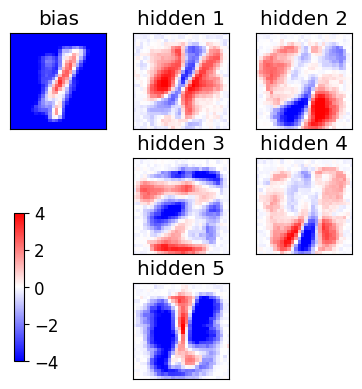

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

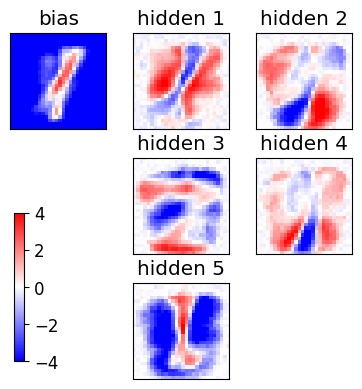

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

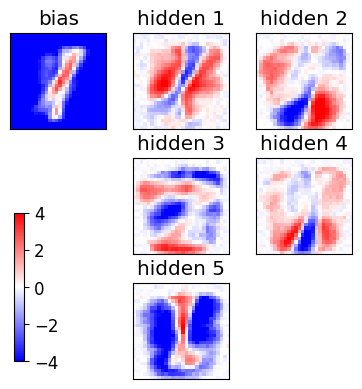

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

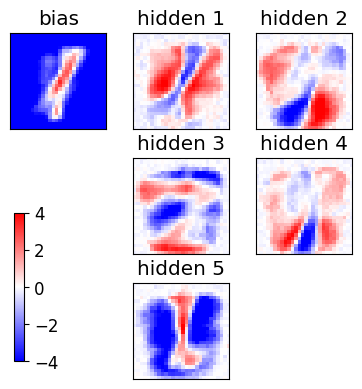

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

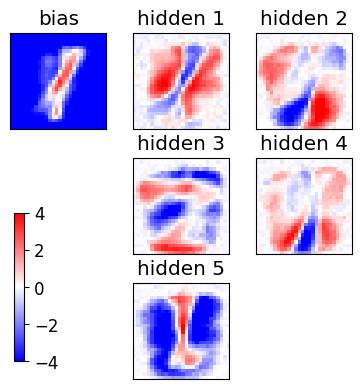

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

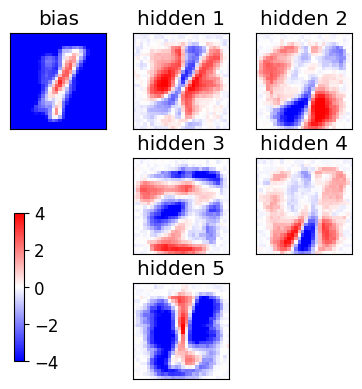

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

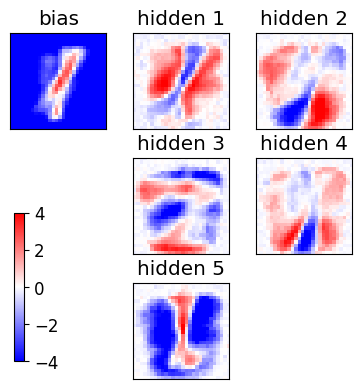

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

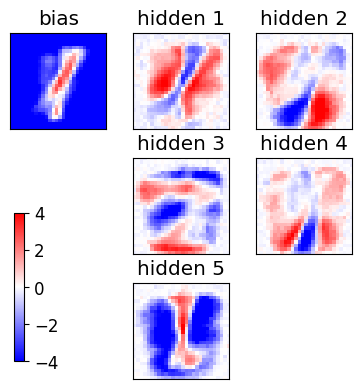

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

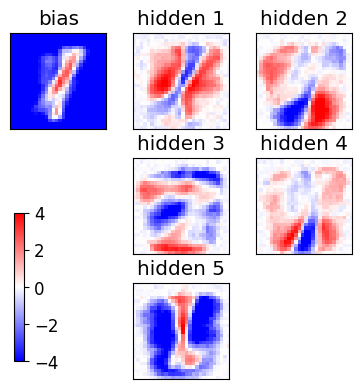

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

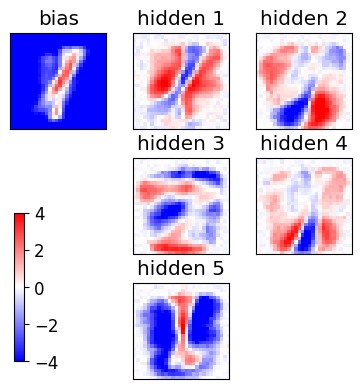

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

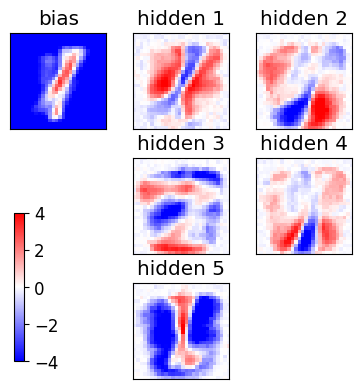

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

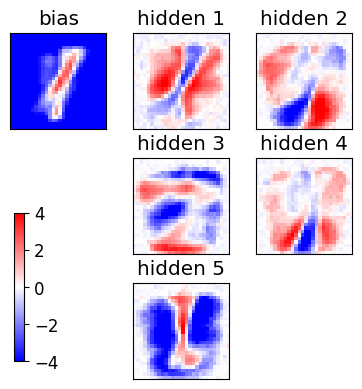

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

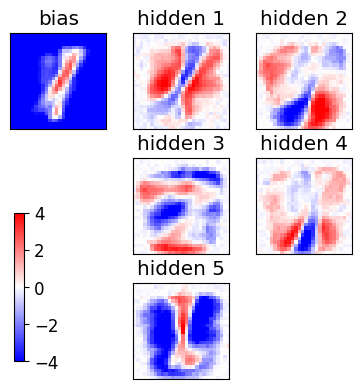

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

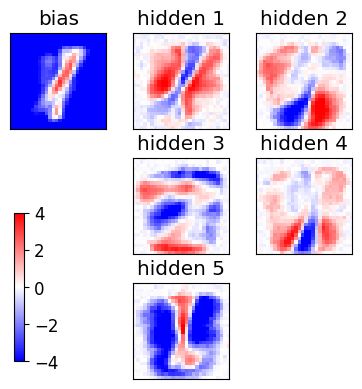

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

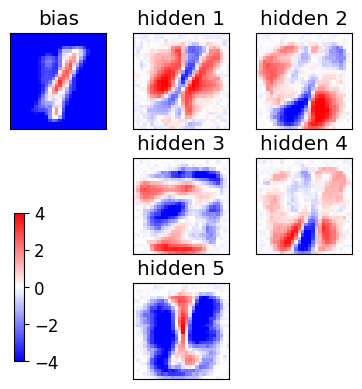

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

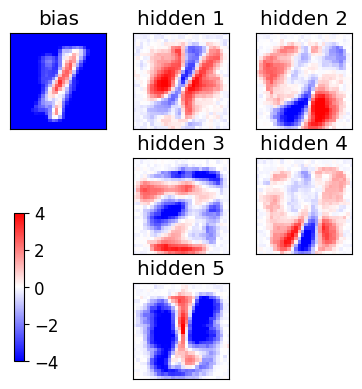

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

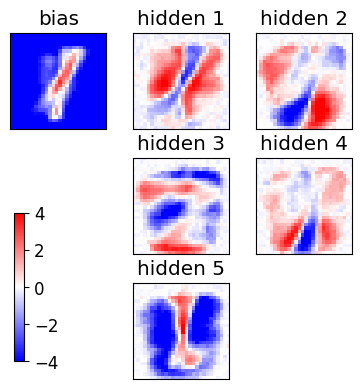

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

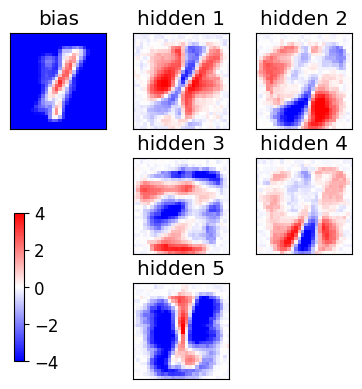

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

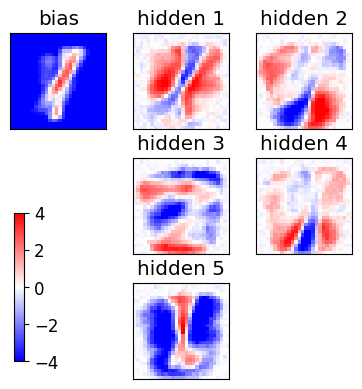

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

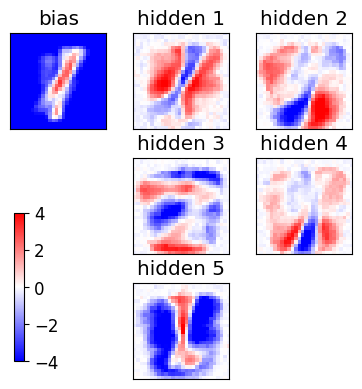

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

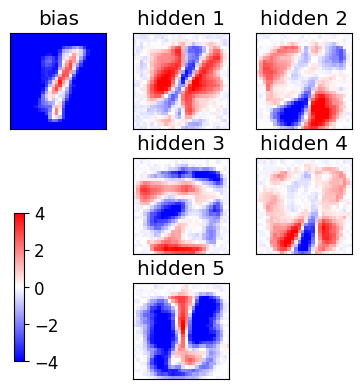

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

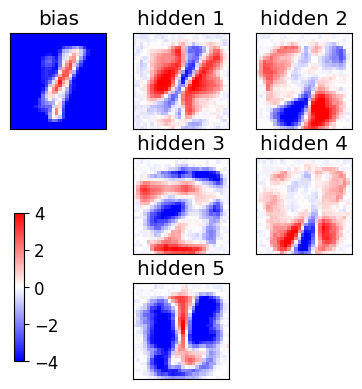

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

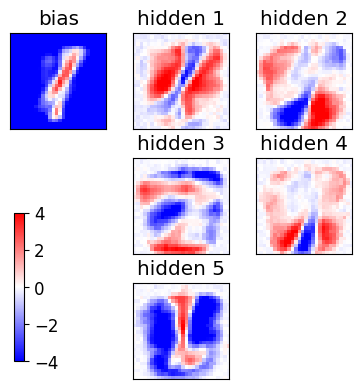

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

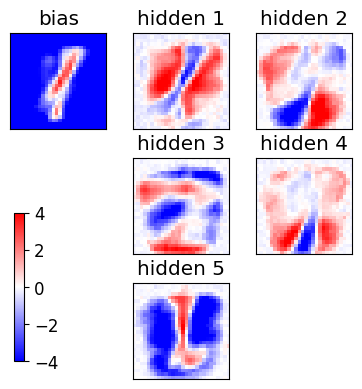

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

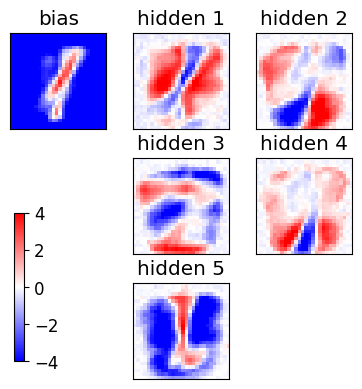

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

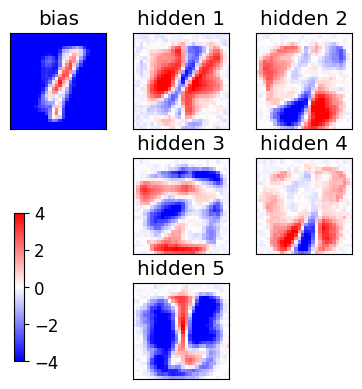

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

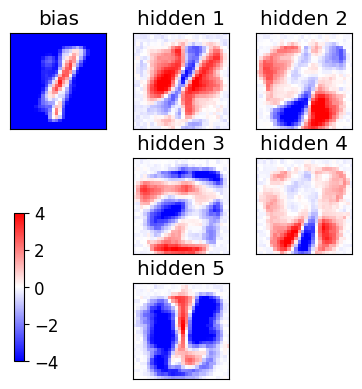

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

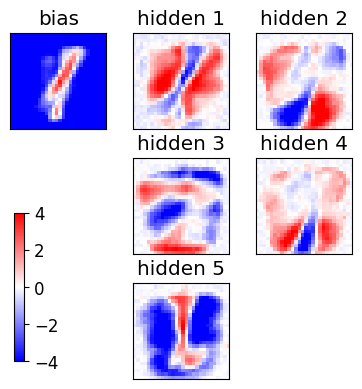

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

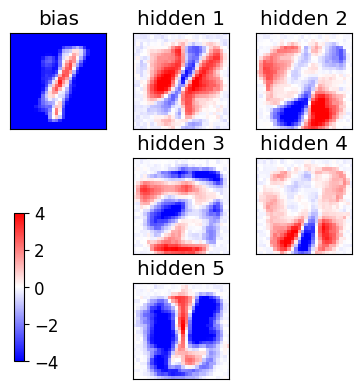

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

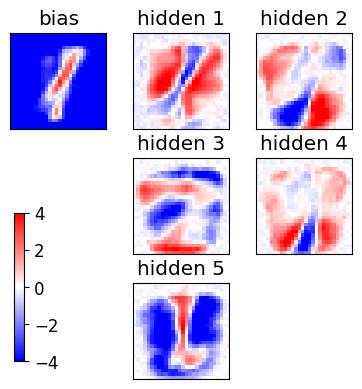

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

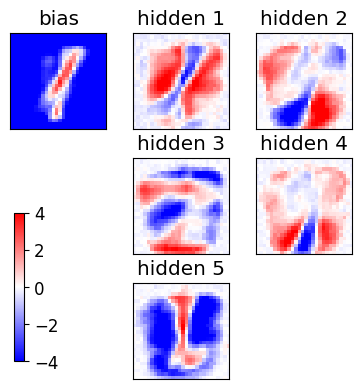

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

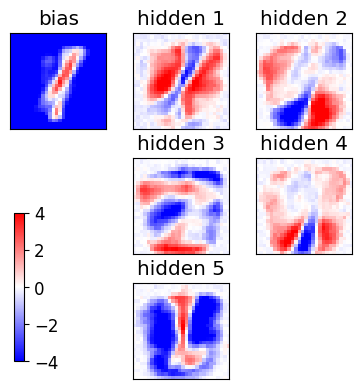

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

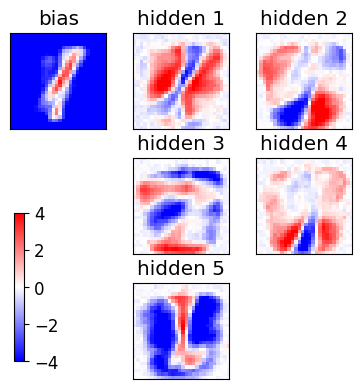

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

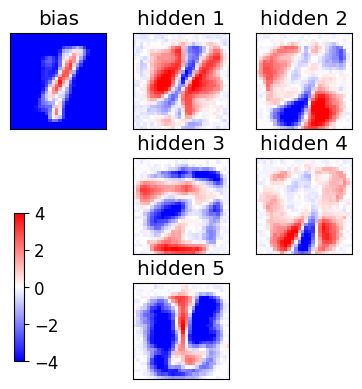

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

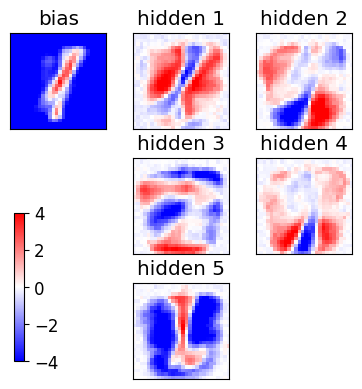

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

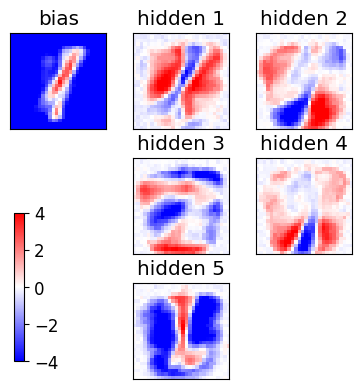

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

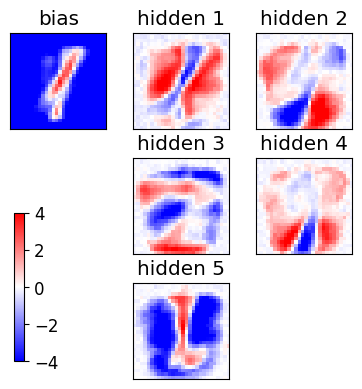

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

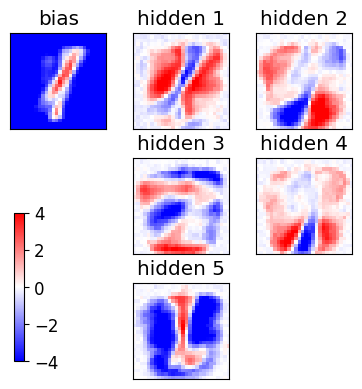

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

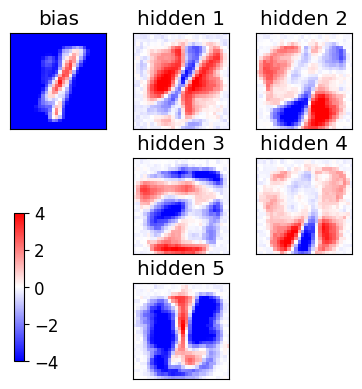

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

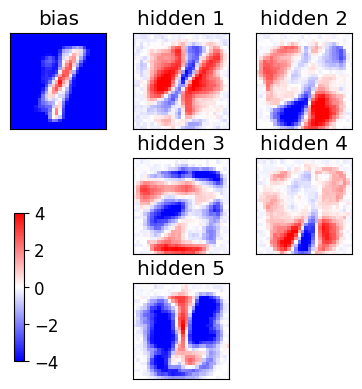

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 

<Figure size 640x480 with 0 Axes>

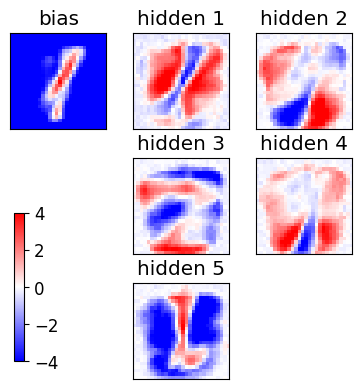

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

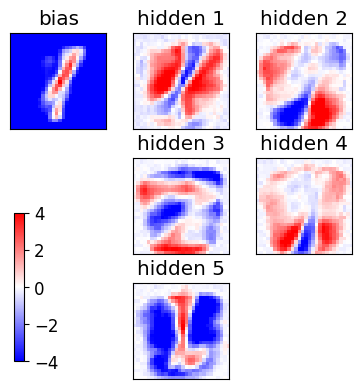

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

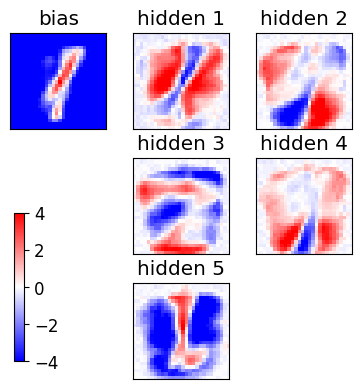

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

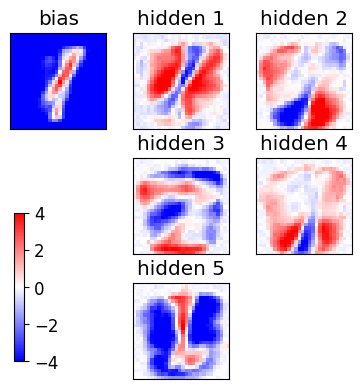

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

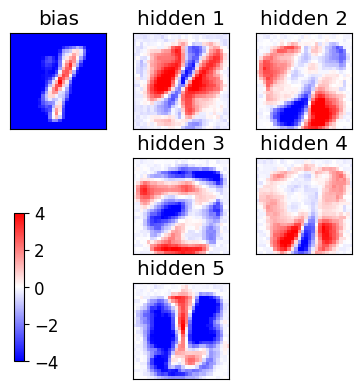

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

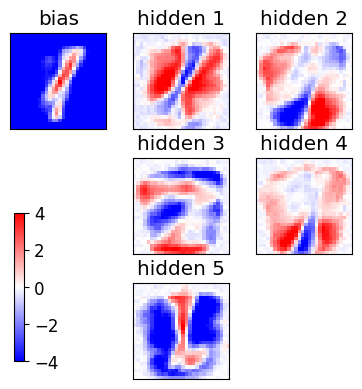

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

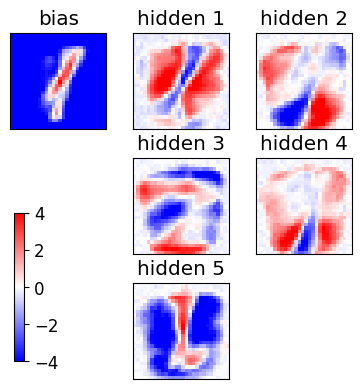

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

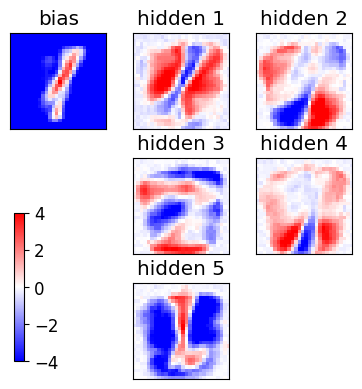

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

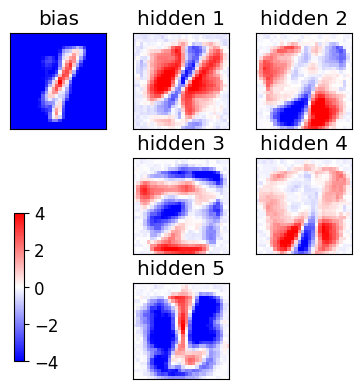

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

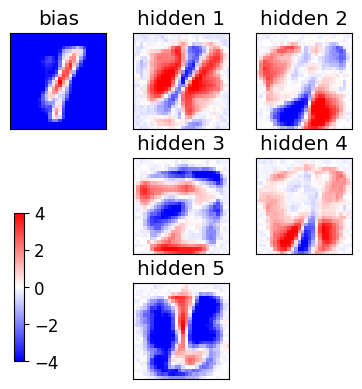

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

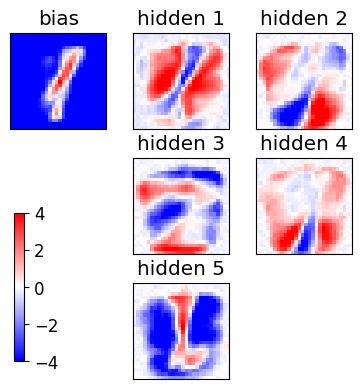

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

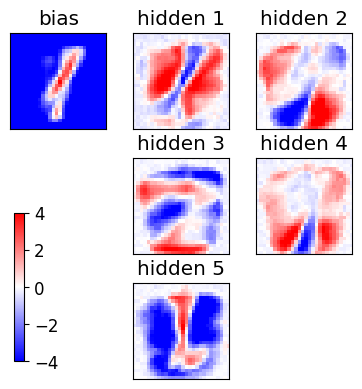

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

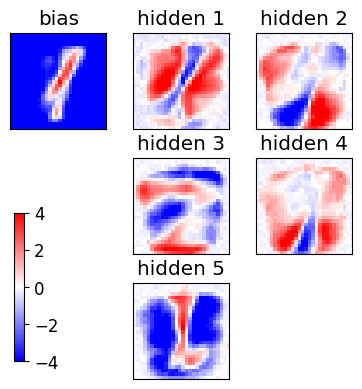

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

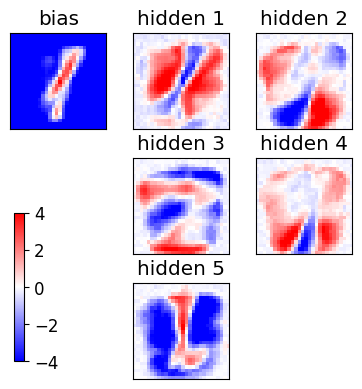

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

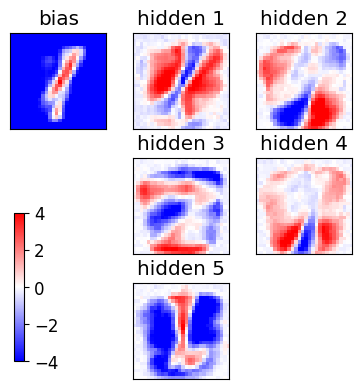

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

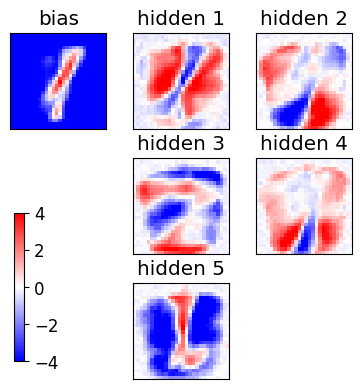

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

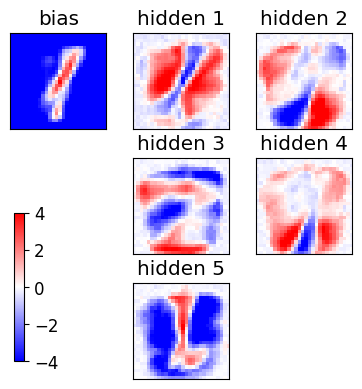

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

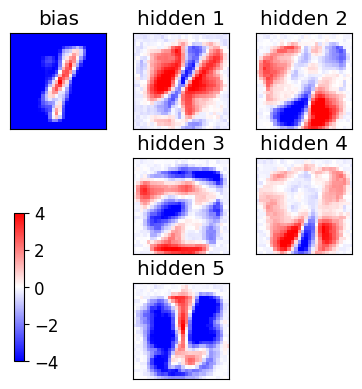

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

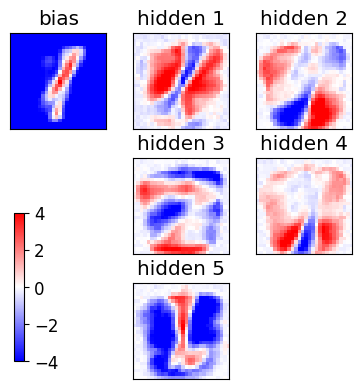

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

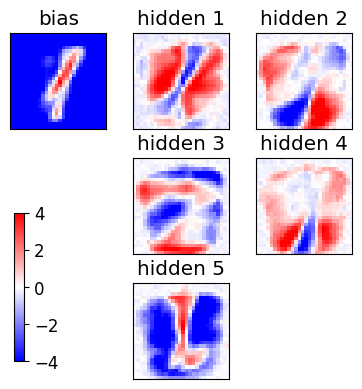

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  

<Figure size 640x480 with 0 Axes>

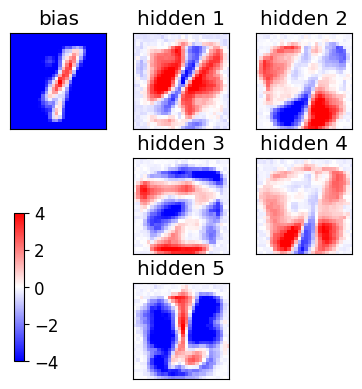

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

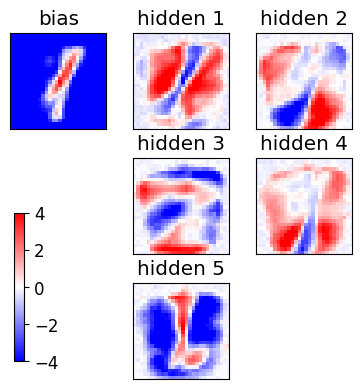

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

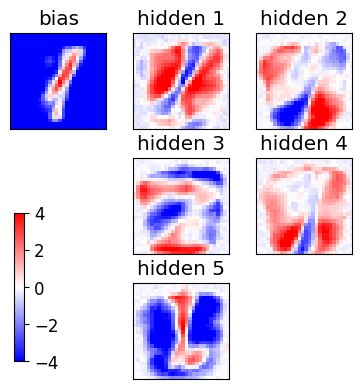

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

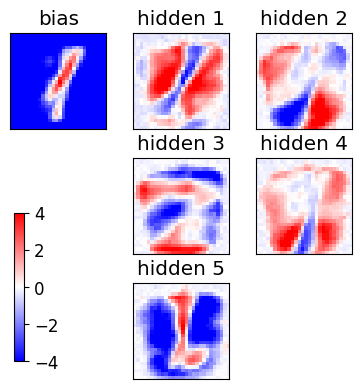

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

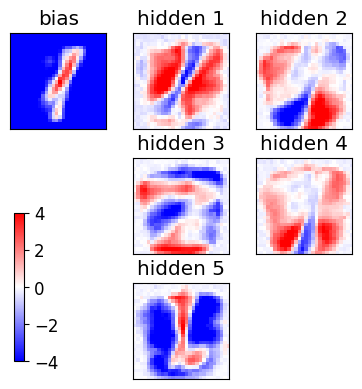

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

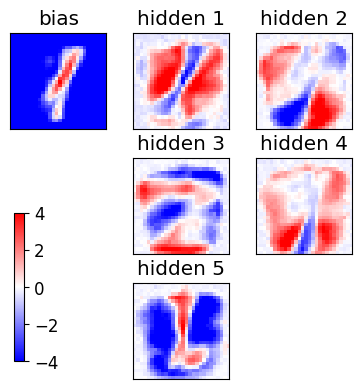

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

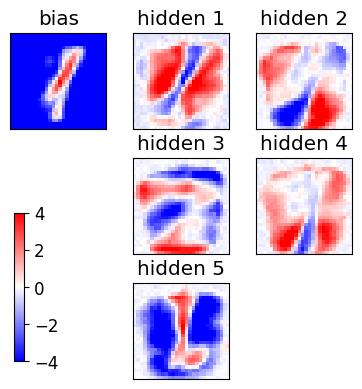

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

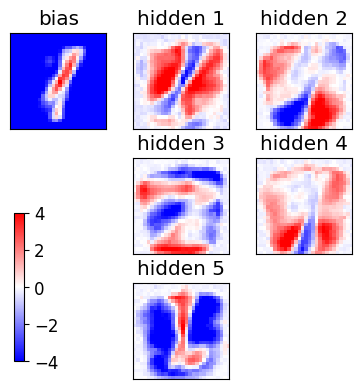

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

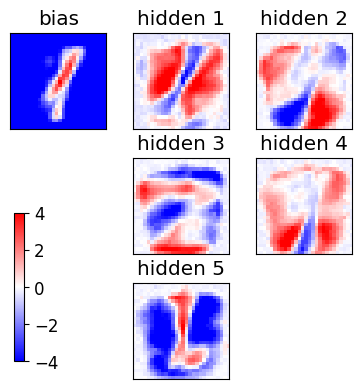

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

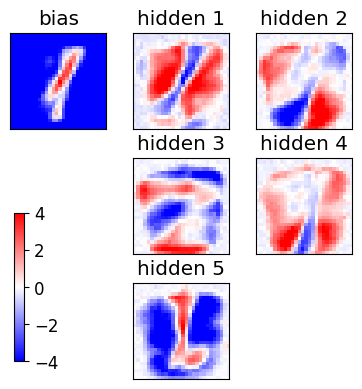

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

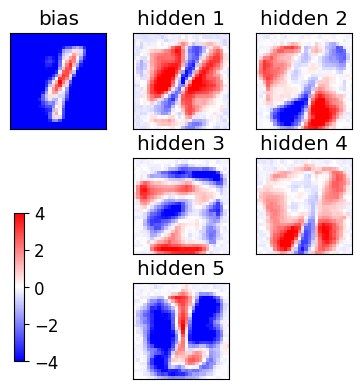

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

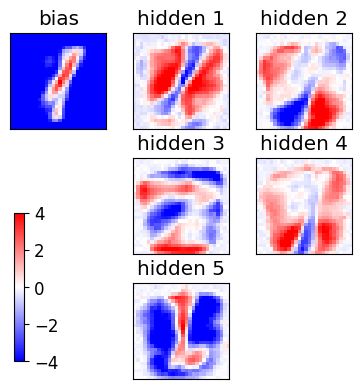

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

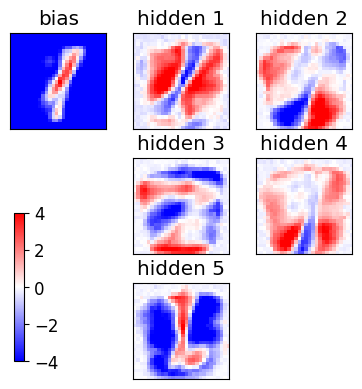

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

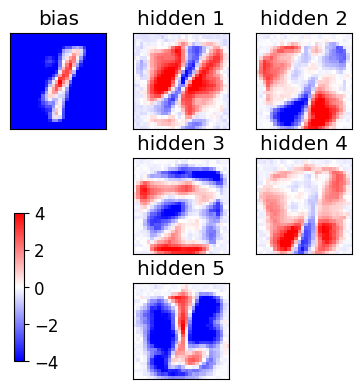

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

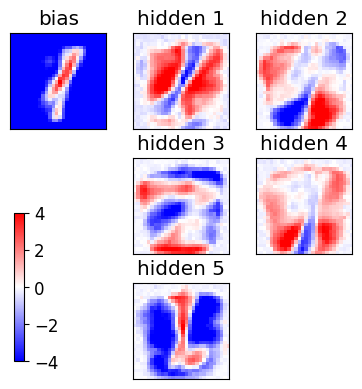

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

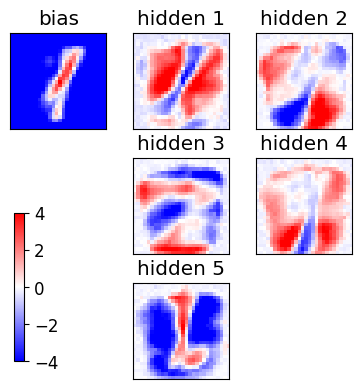

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

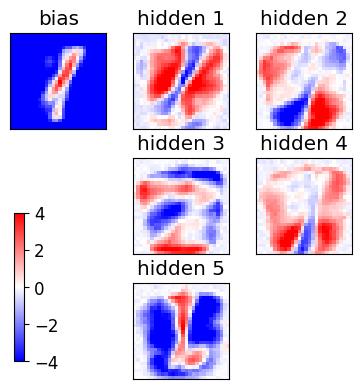

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

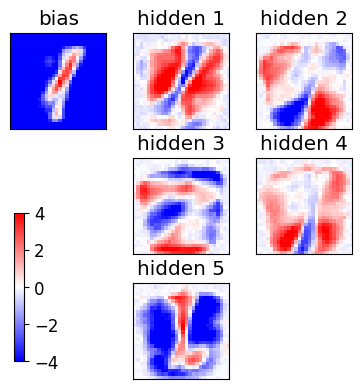

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

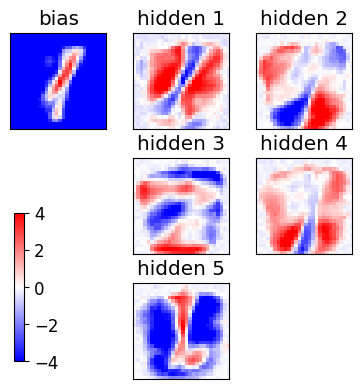

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

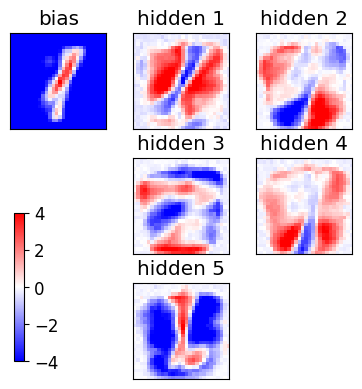

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  

<Figure size 640x480 with 0 Axes>

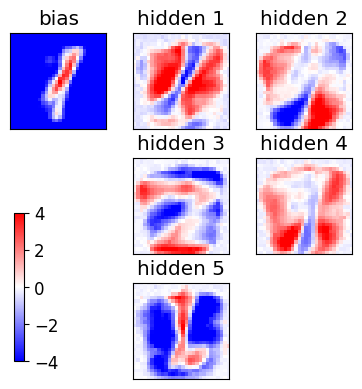

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

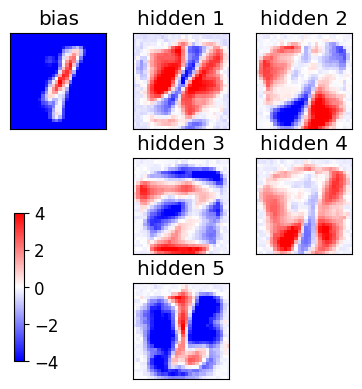

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

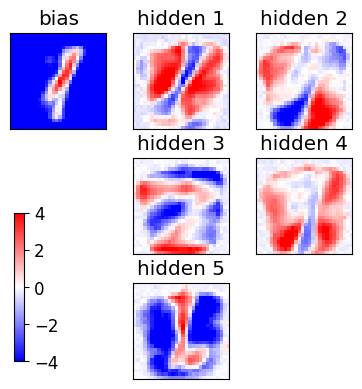

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

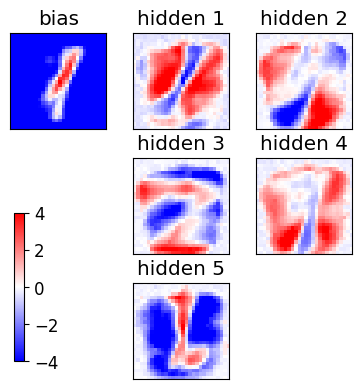

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

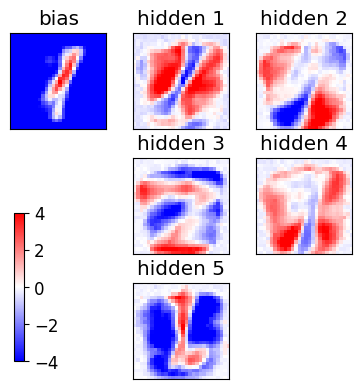

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

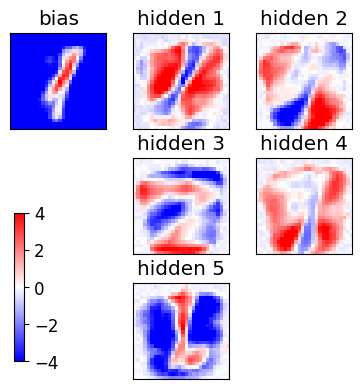

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

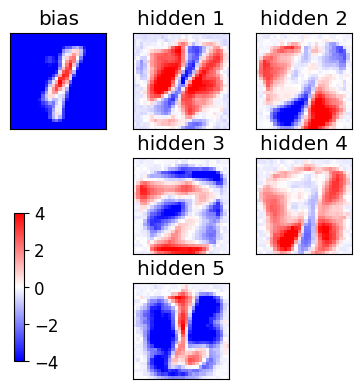

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

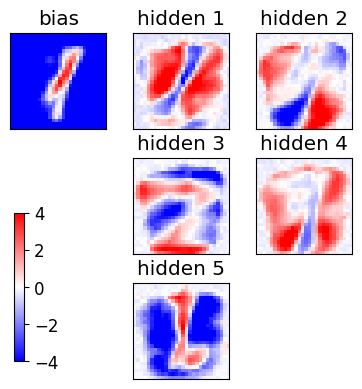

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

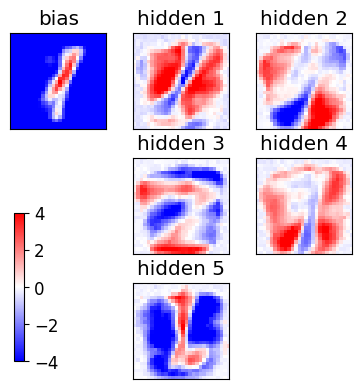

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

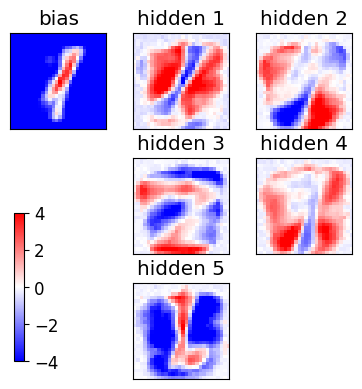

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

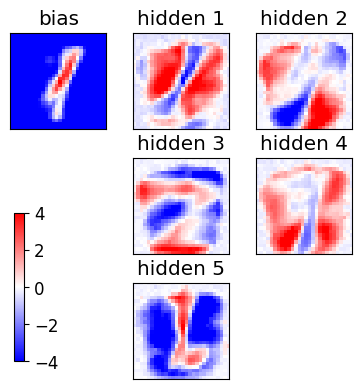

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

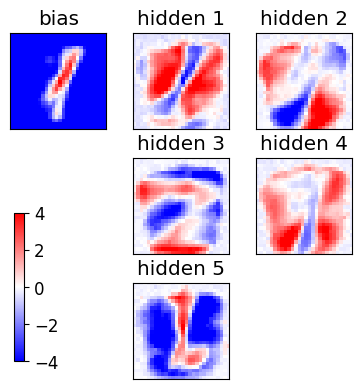

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

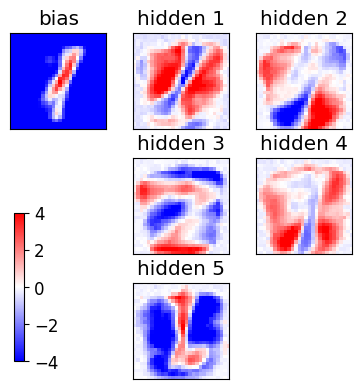

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

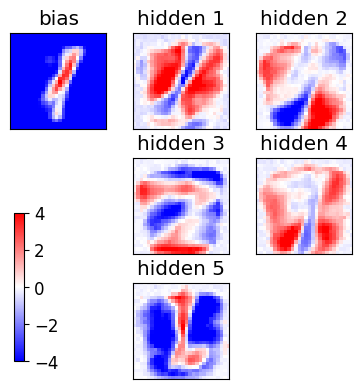

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

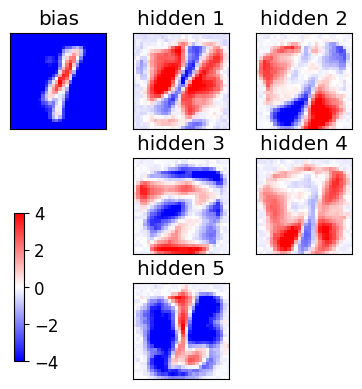

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

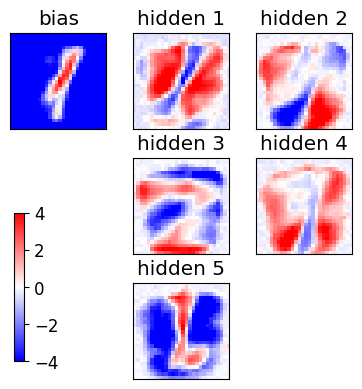

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

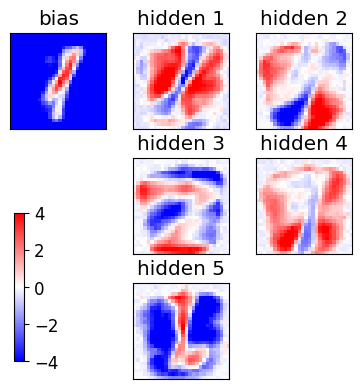

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

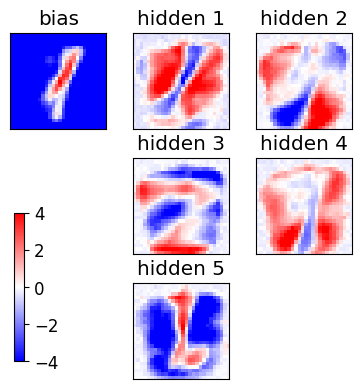

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

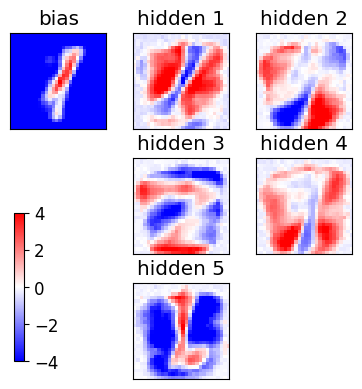

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

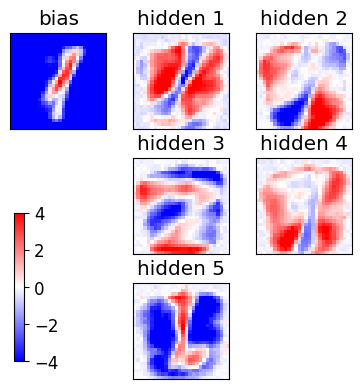

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  

<Figure size 640x480 with 0 Axes>

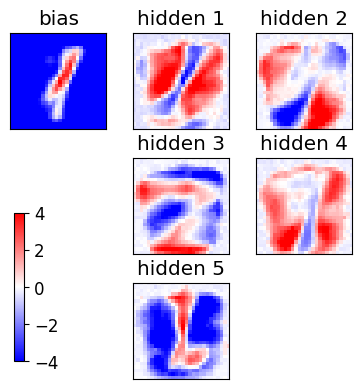

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

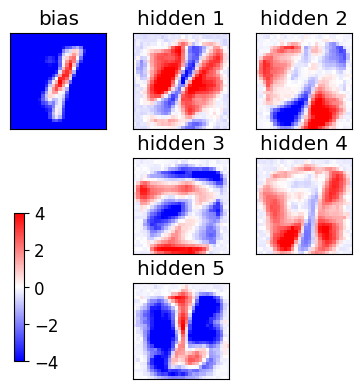

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

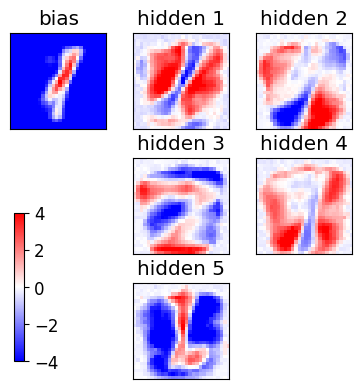

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

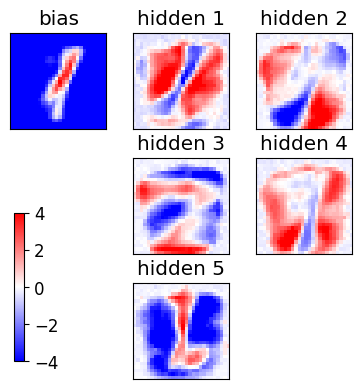

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

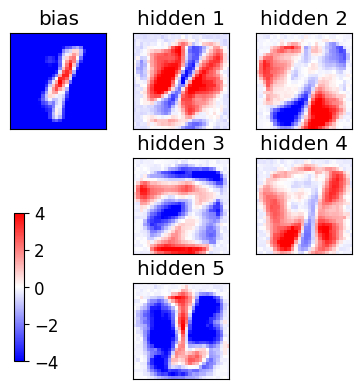

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

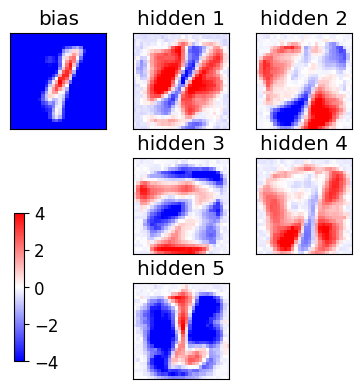

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

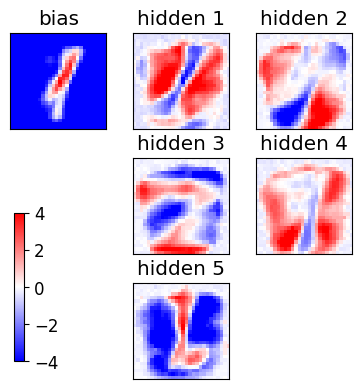

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

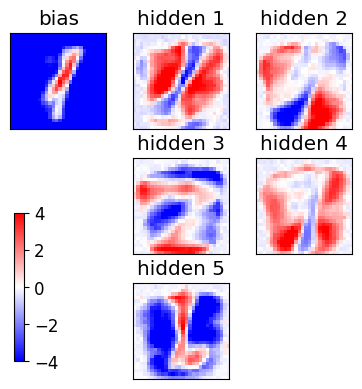

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

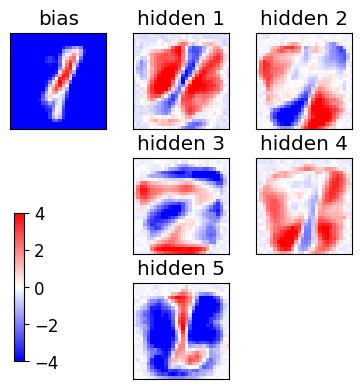

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

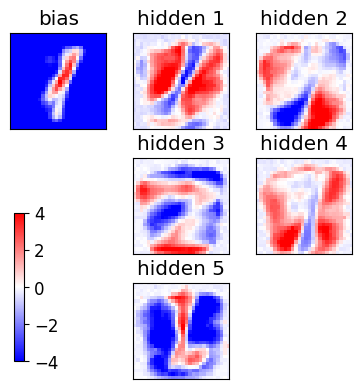

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

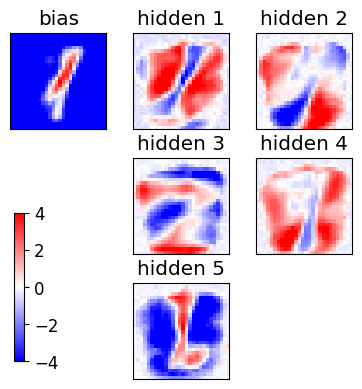

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

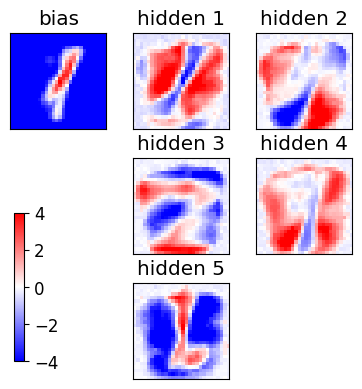

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

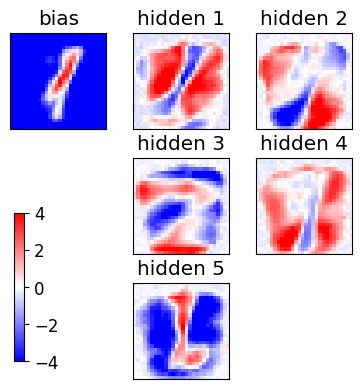

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

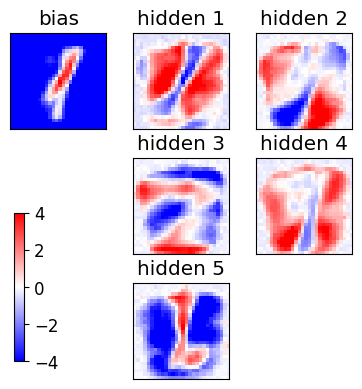

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

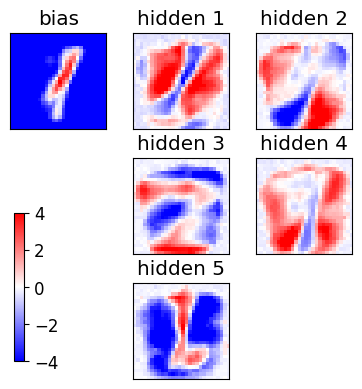

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

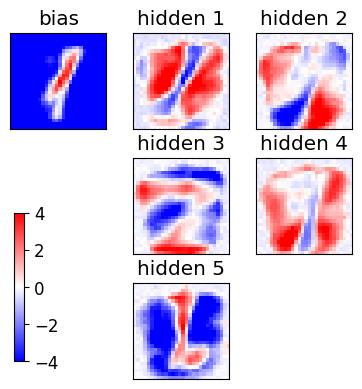

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

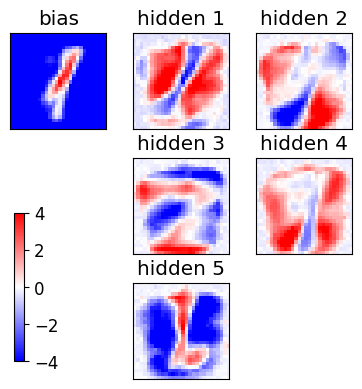

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

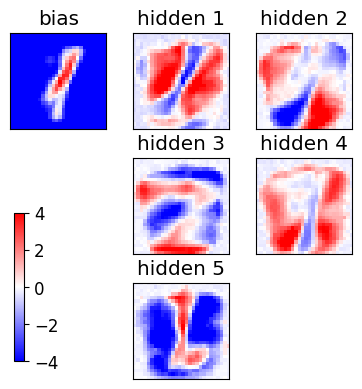

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

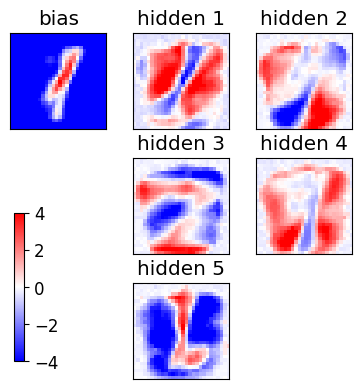

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

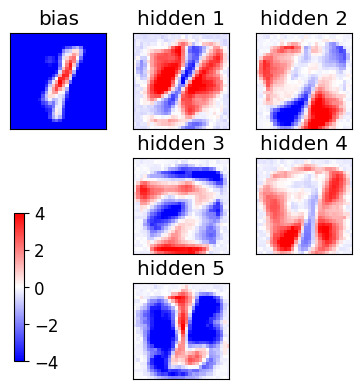

END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

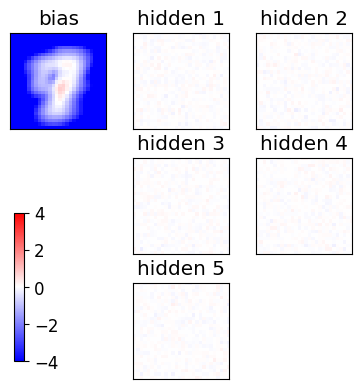

Starting the training
[20914 21166 12757  7459  1948  3950 15501 10401  3826 19217]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[19248  1389 12409 21545  7653   734  2184 17421  7675 16079]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[ 3633  4982 17509  3615  6681 21048 21865  7204  8197 18383]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[18149  1111  1326   641   611  7318  9996 17939 15816 16573]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= Fa

<Figure size 640x480 with 0 Axes>

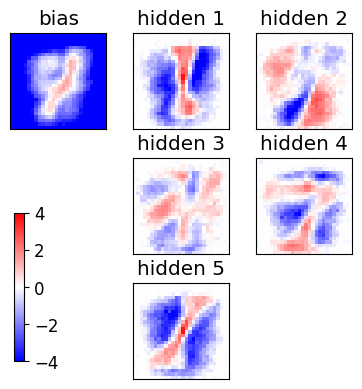

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

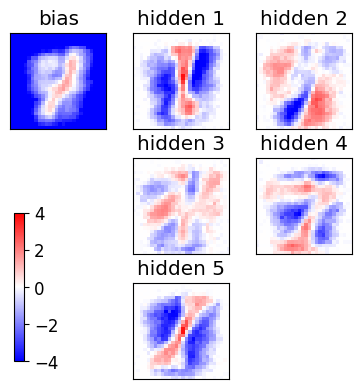

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

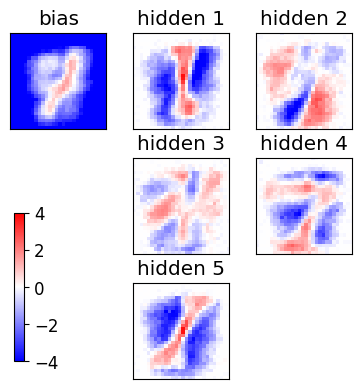

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

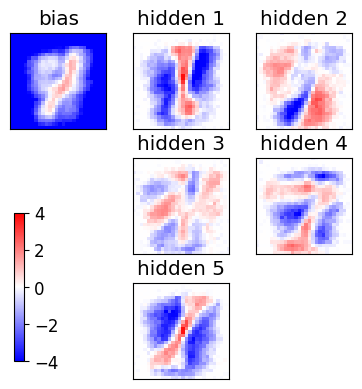

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

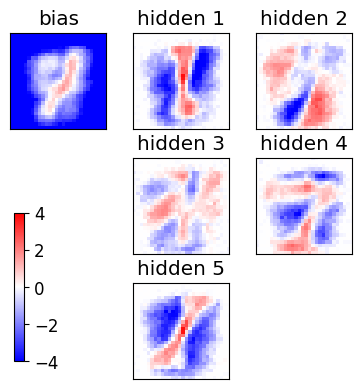

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

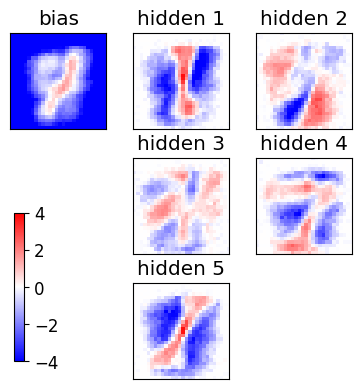

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

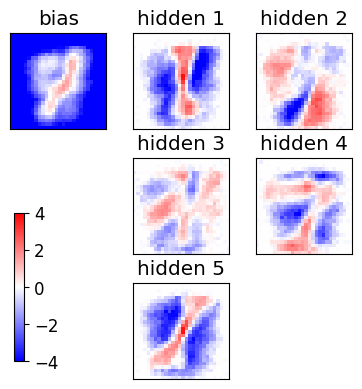

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

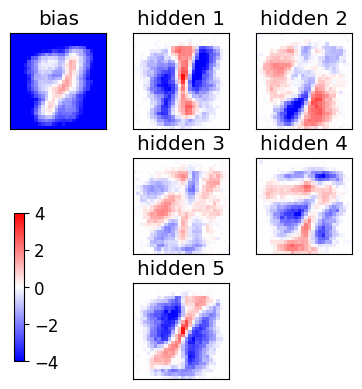

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

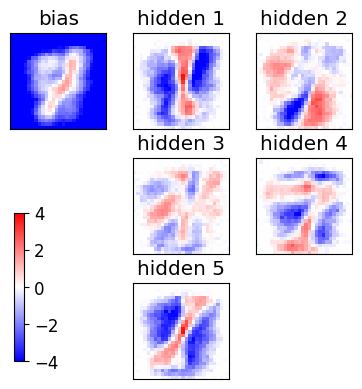

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

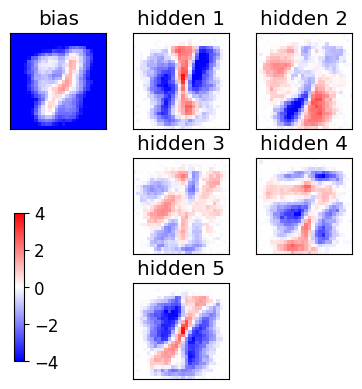

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

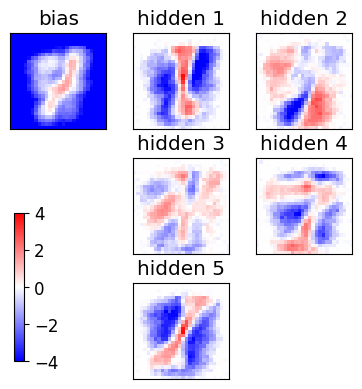

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

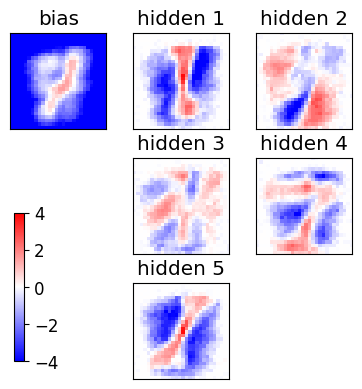

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

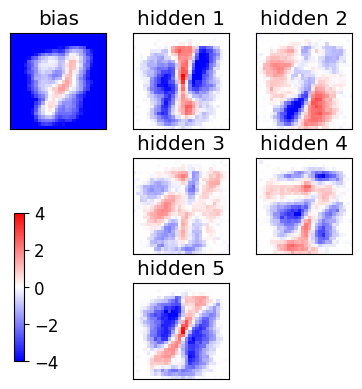

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

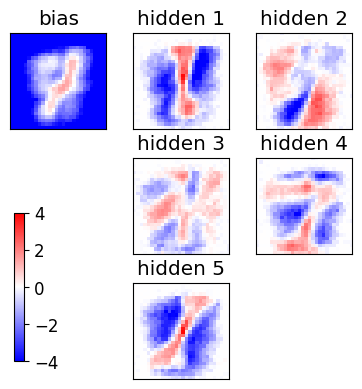

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

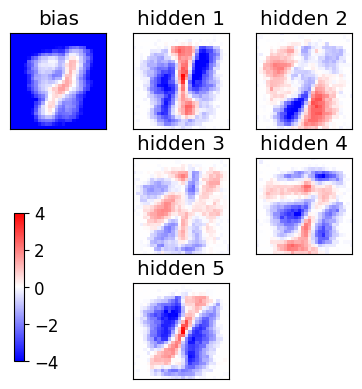

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

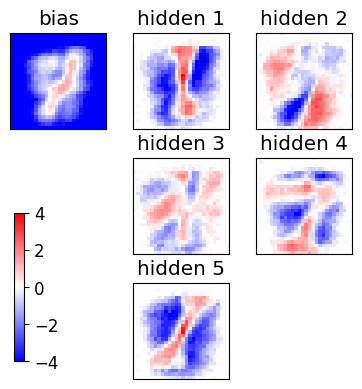

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

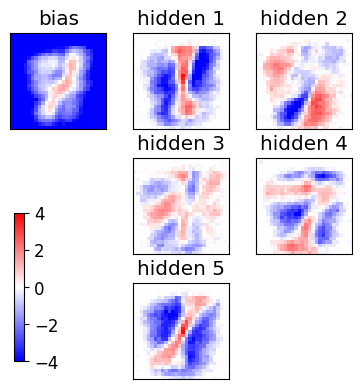

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

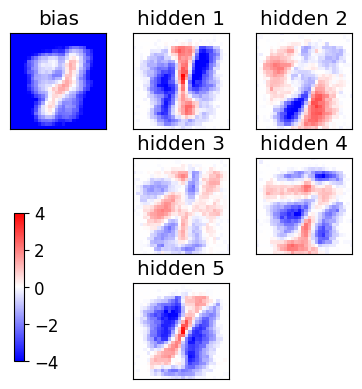

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

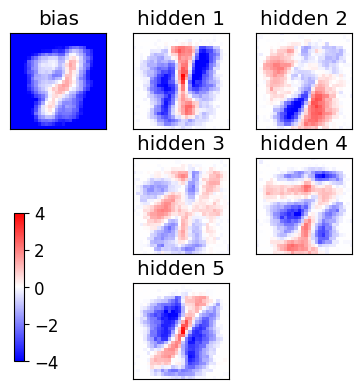

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

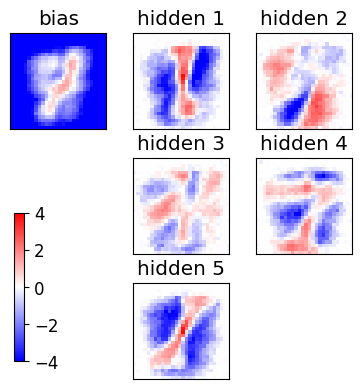

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

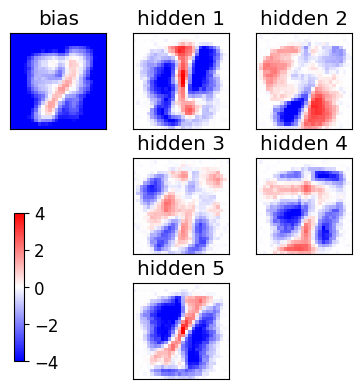

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

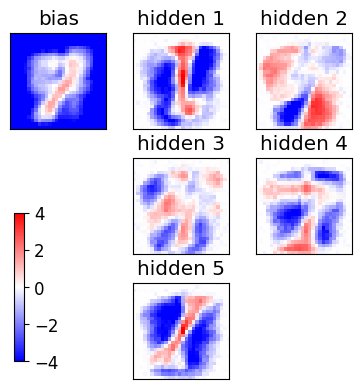

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

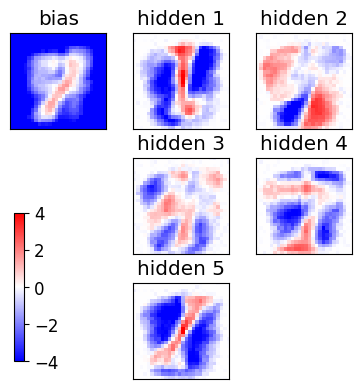

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

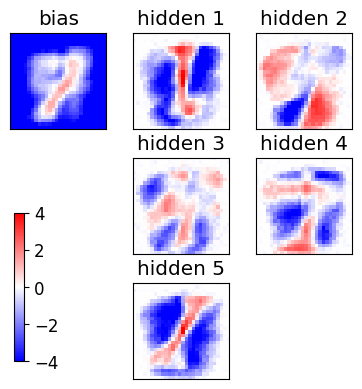

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

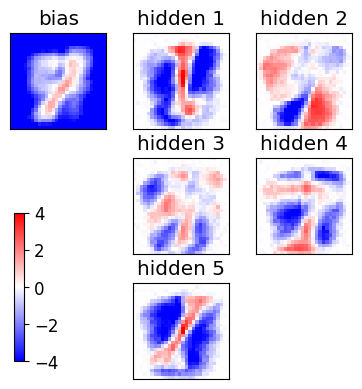

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

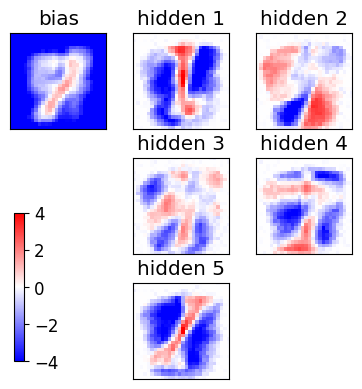

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

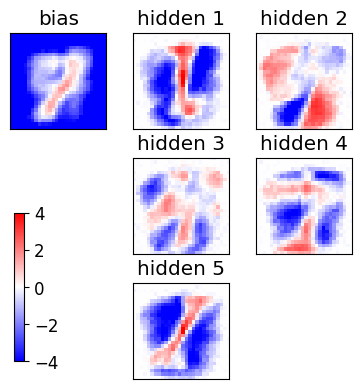

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

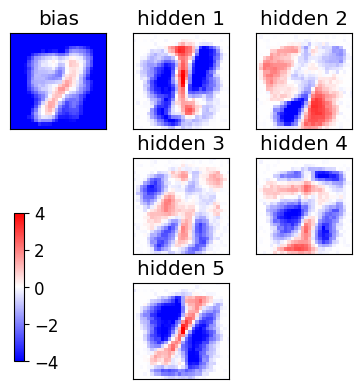

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

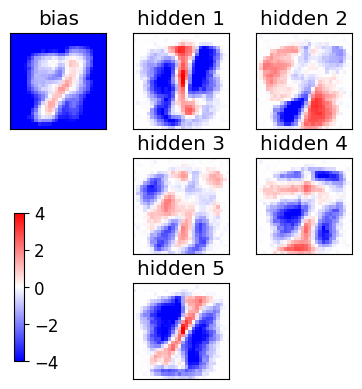

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

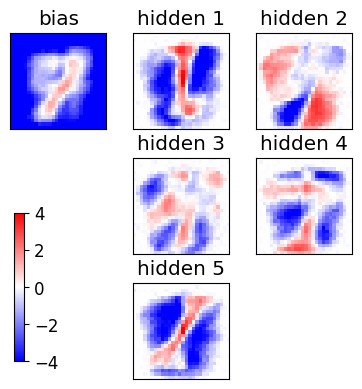

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

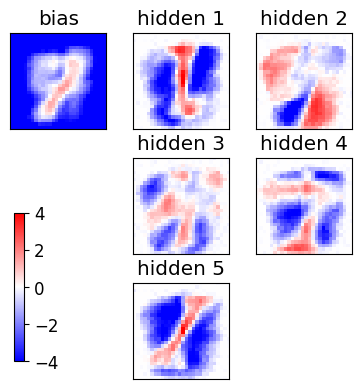

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

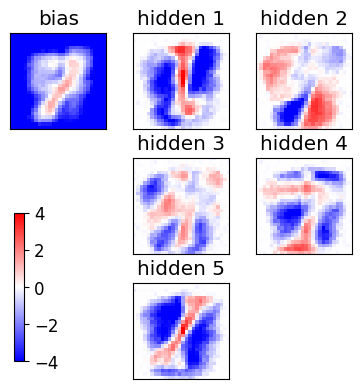

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

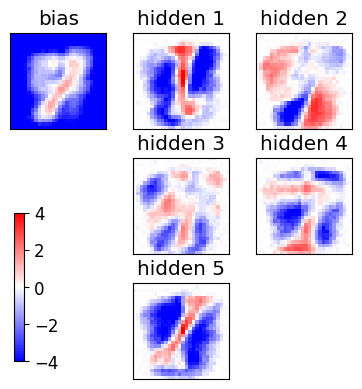

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

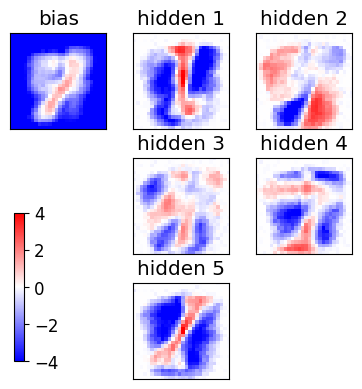

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

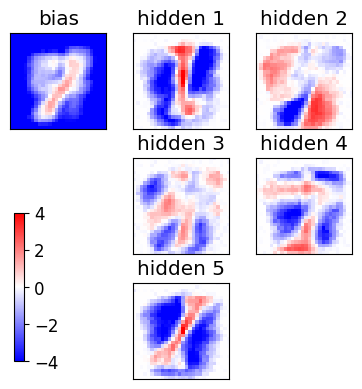

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

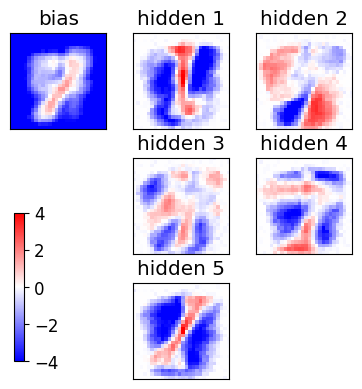

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

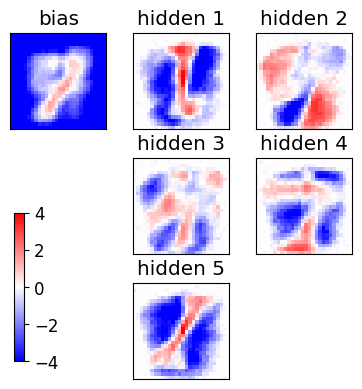

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

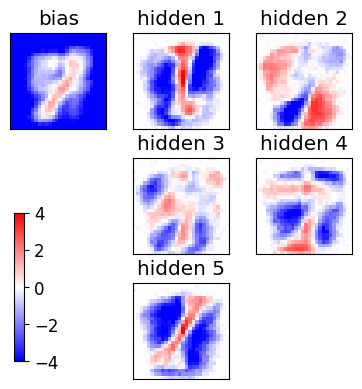

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

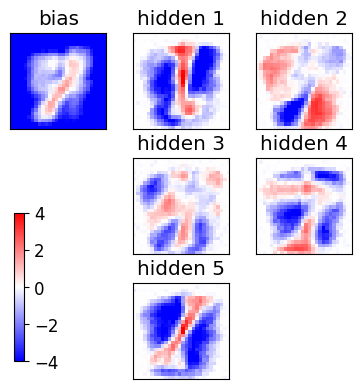

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

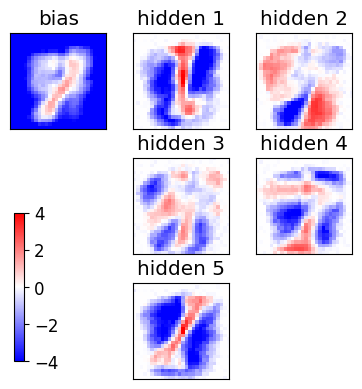

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

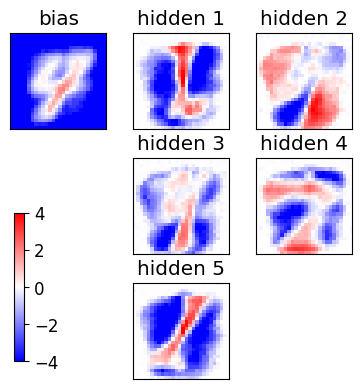

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

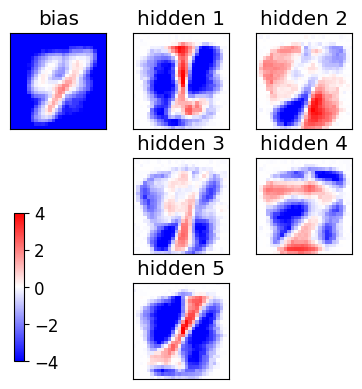

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

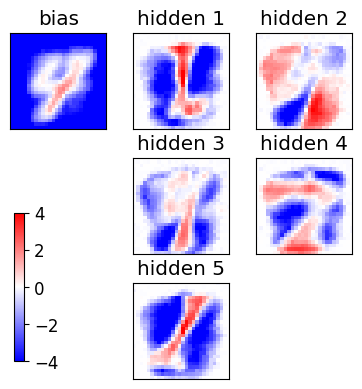

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

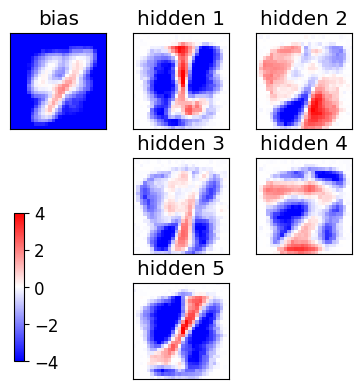

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

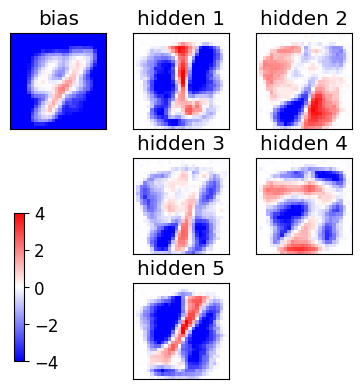

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

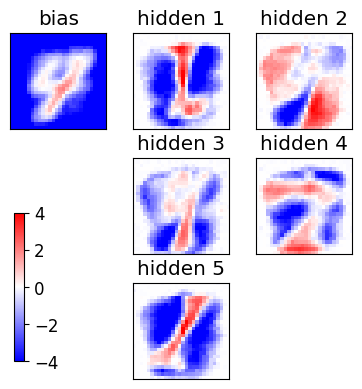

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

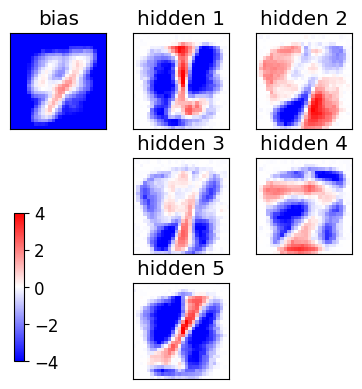

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

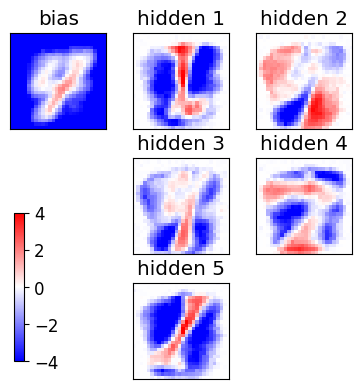

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

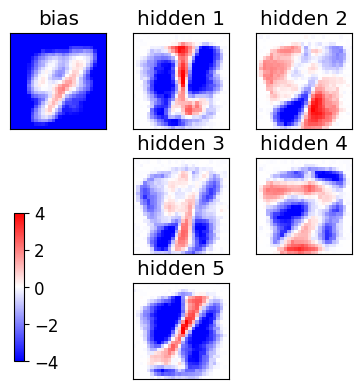

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

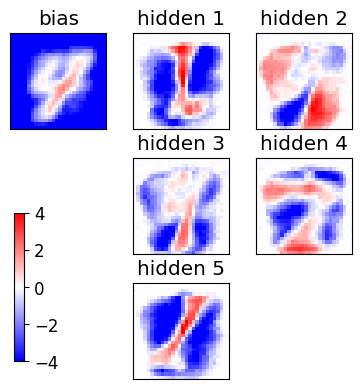

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

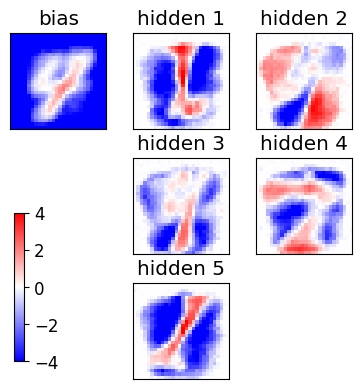

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

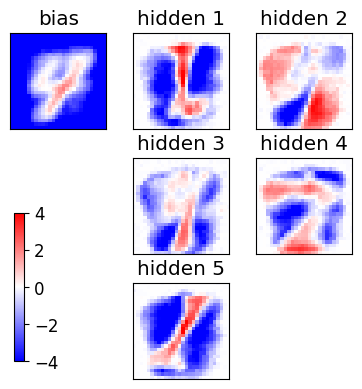

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

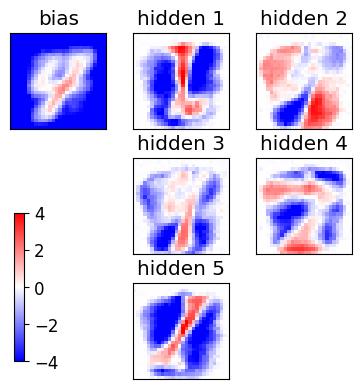

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

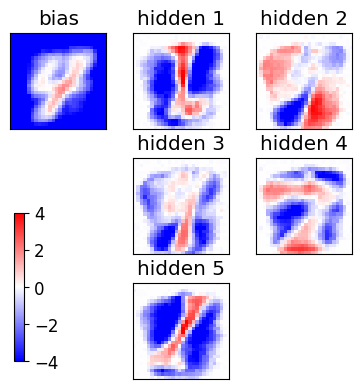

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

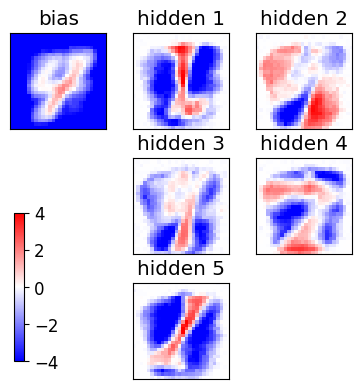

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

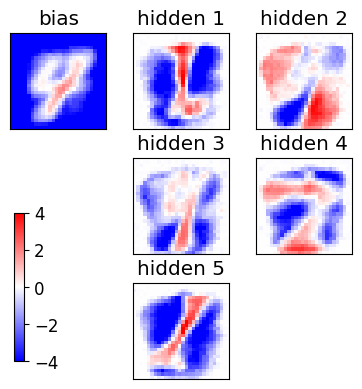

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

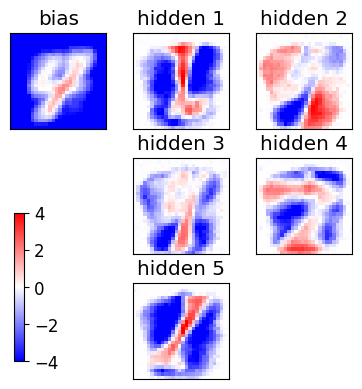

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

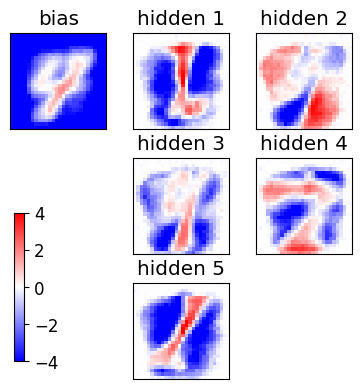

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

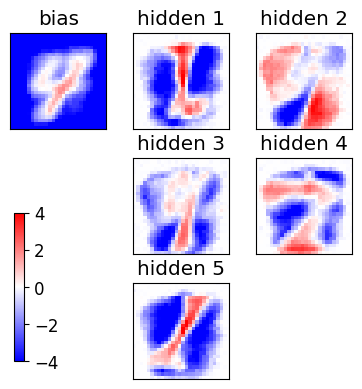

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

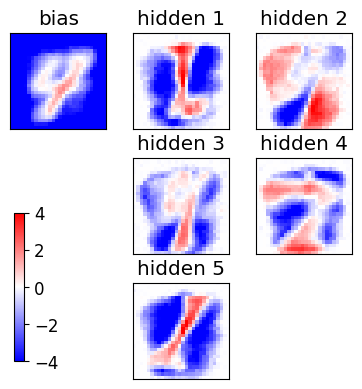

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

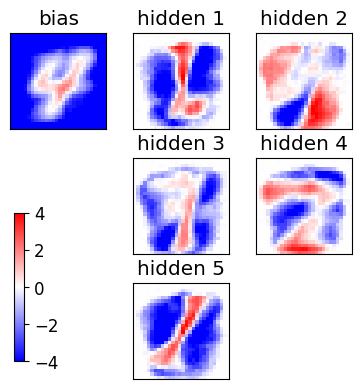

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

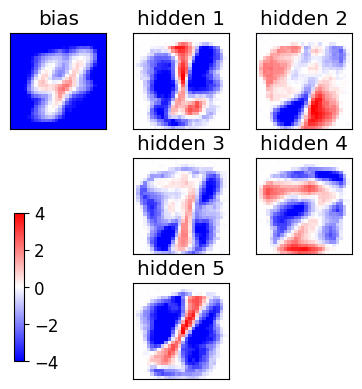

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

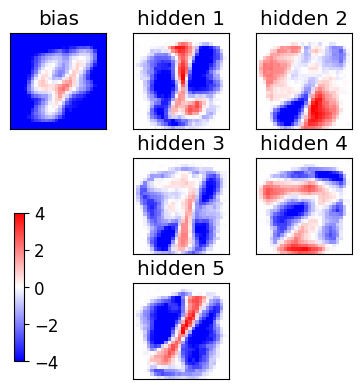

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

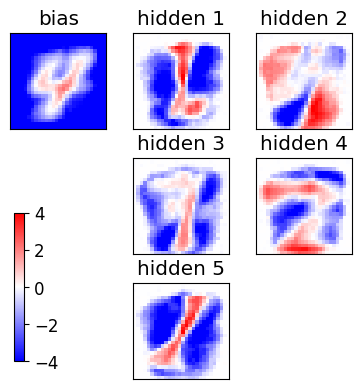

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

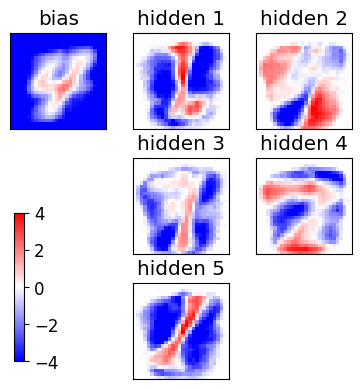

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

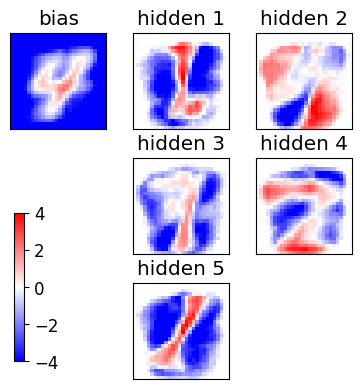

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

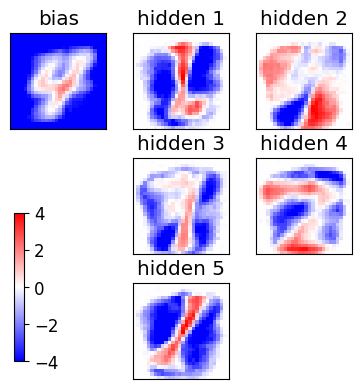

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

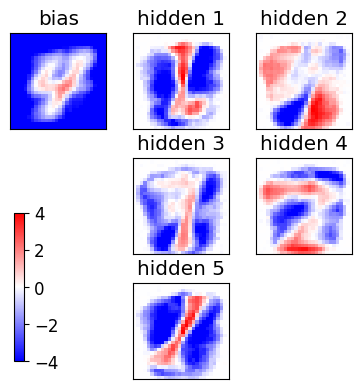

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

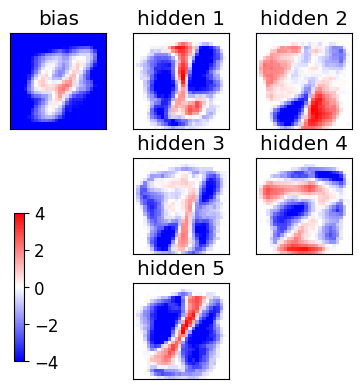

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

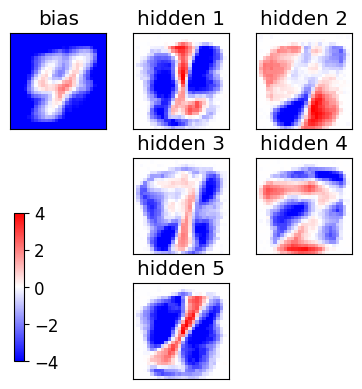

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

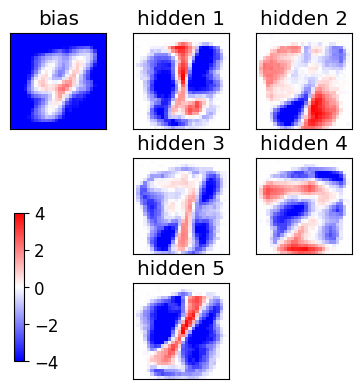

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

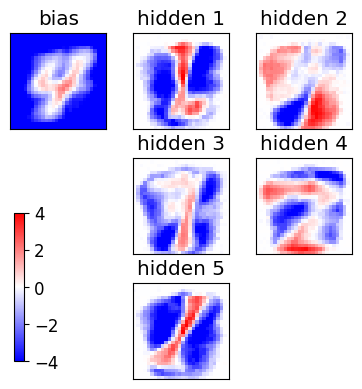

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

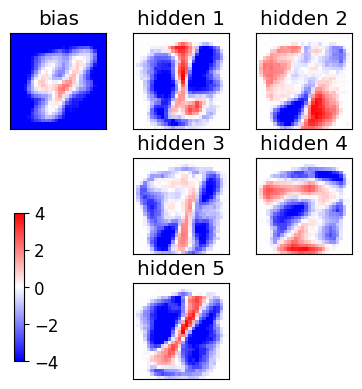

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

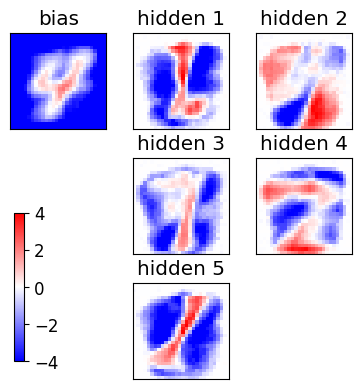

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

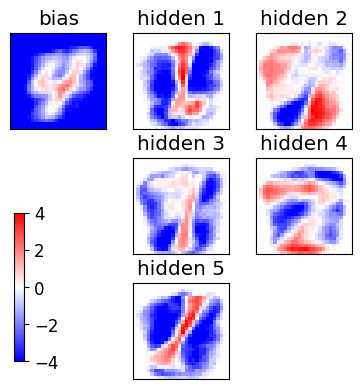

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

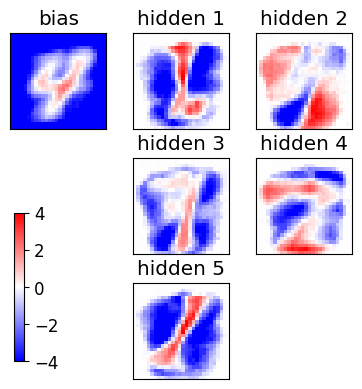

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

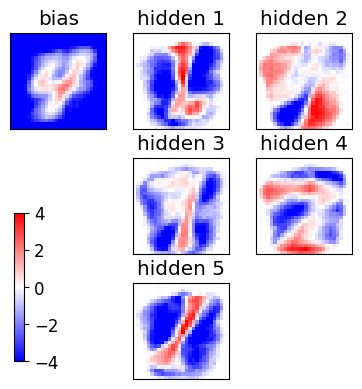

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

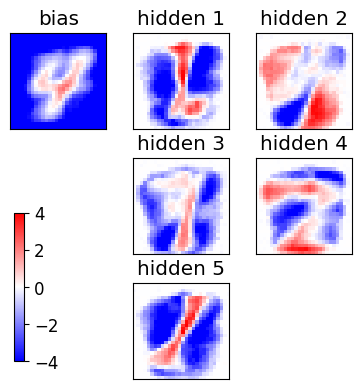

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

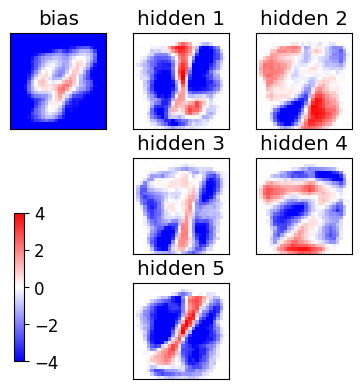

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

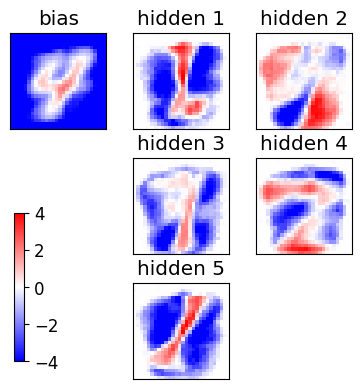

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS=

<Figure size 640x480 with 0 Axes>

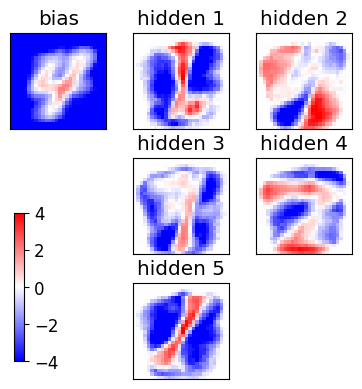

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

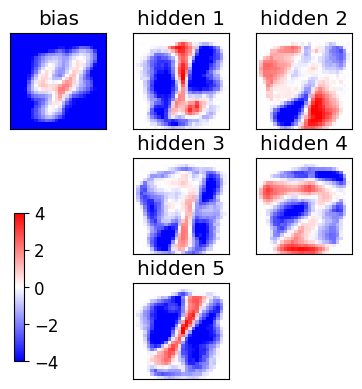

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

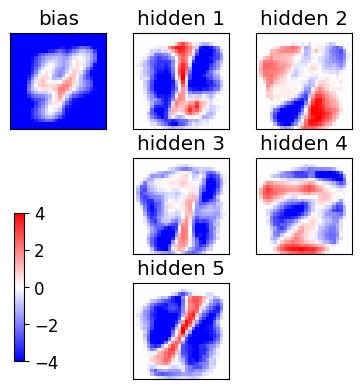

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

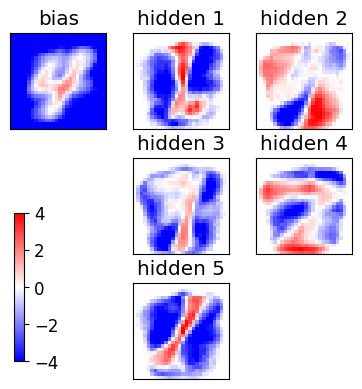

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

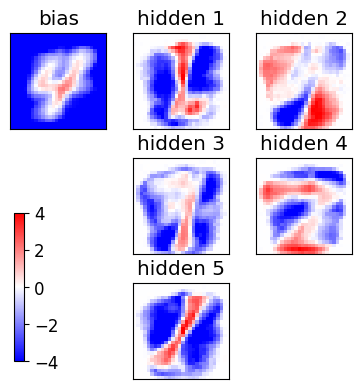

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

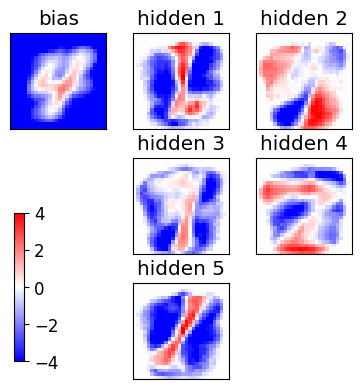

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

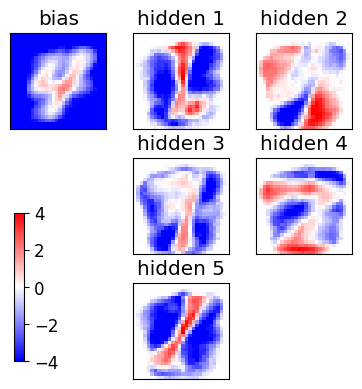

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

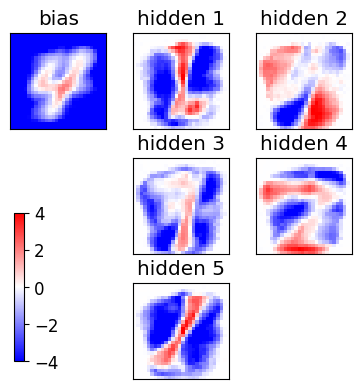

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

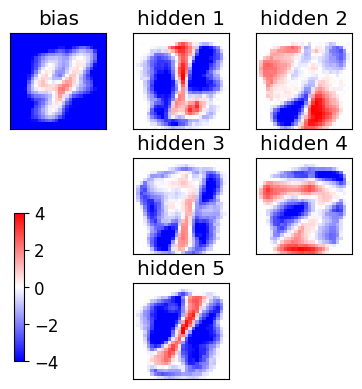

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

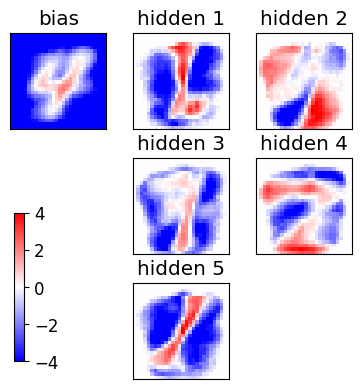

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

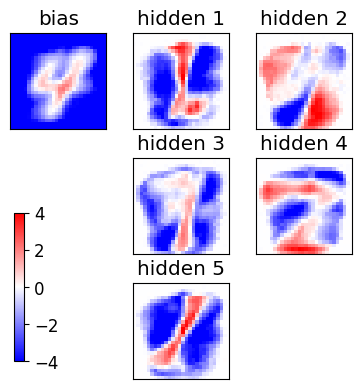

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

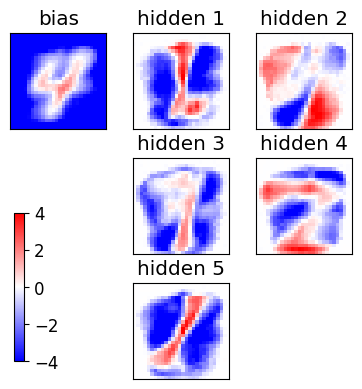

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

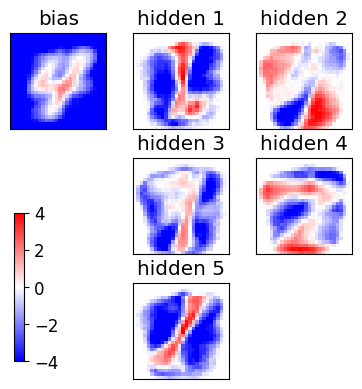

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

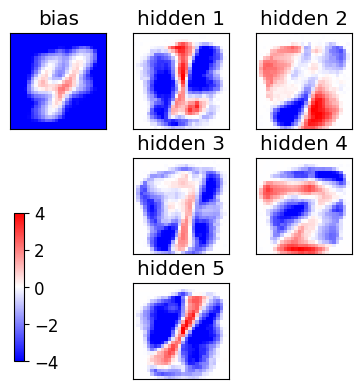

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

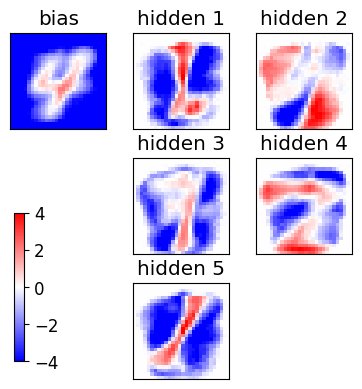

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

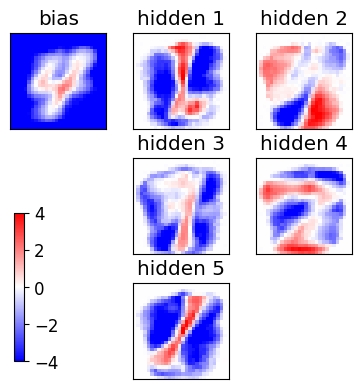

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

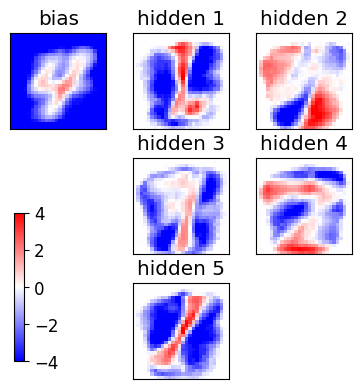

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

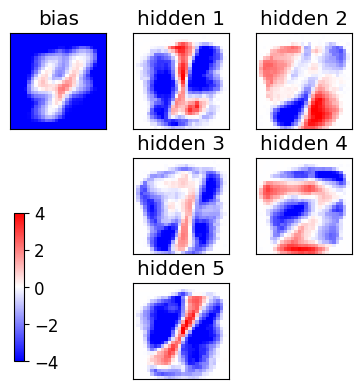

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

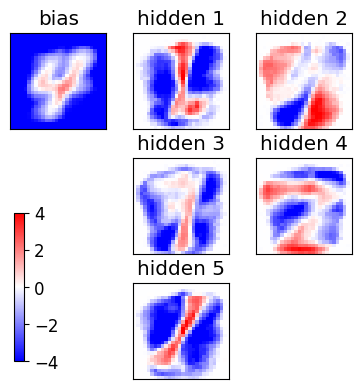

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

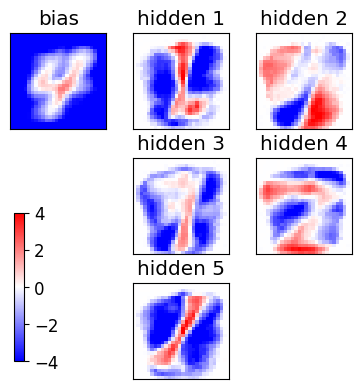

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

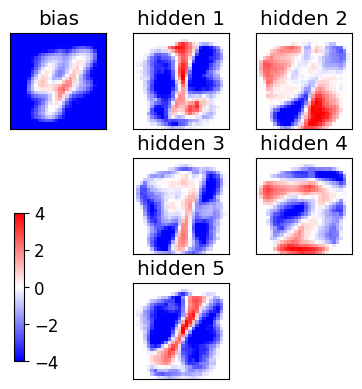

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

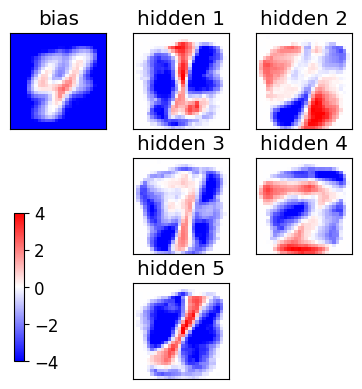

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

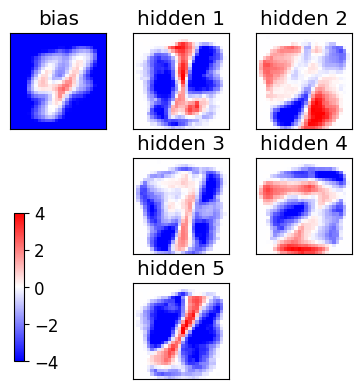

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

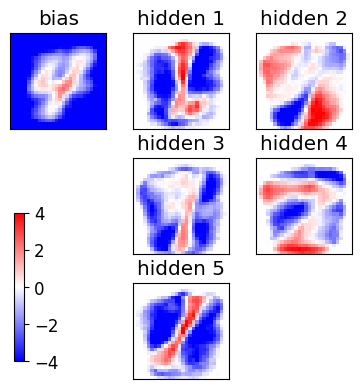

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

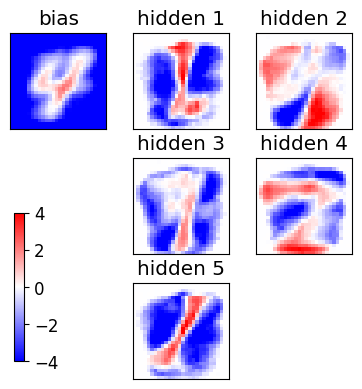

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

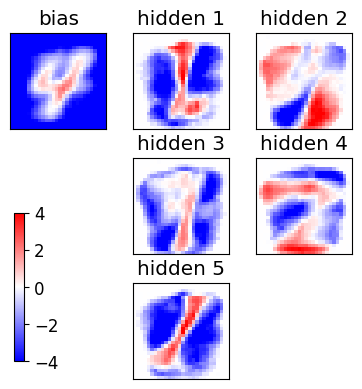

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

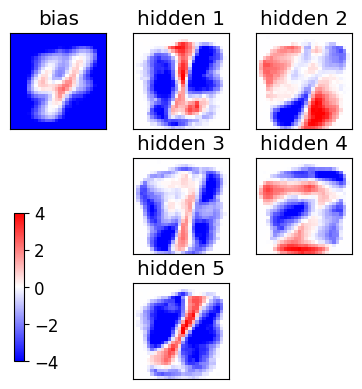

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

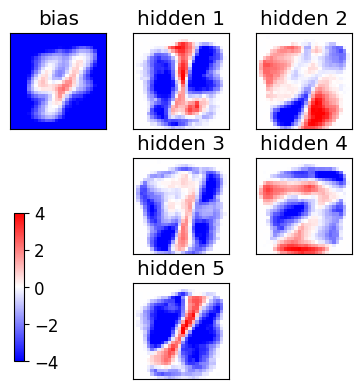

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

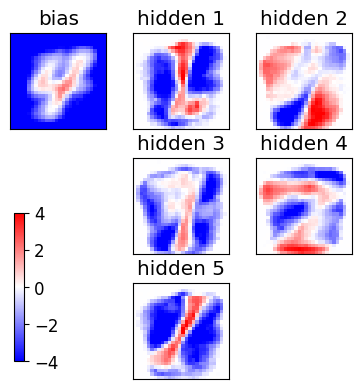

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

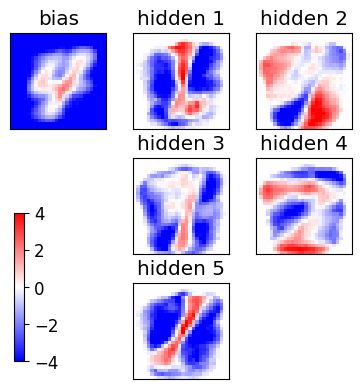

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

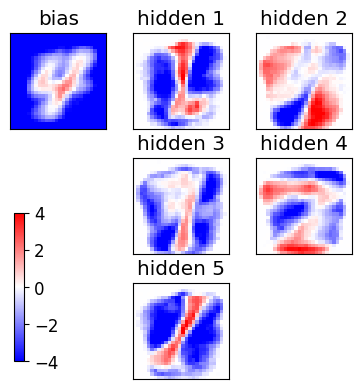

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

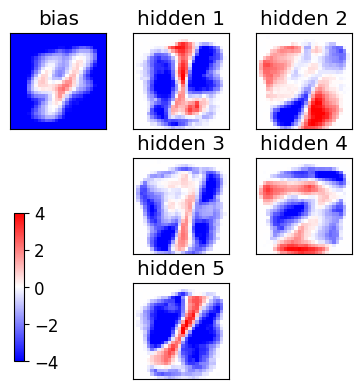

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

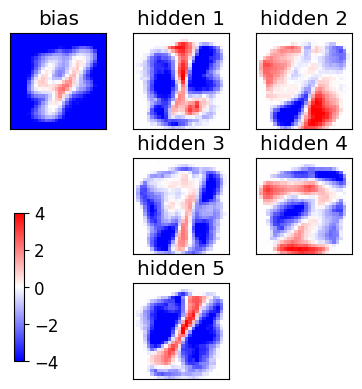

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

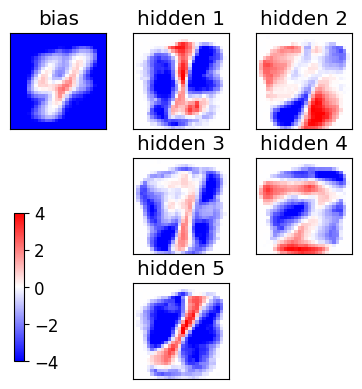

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

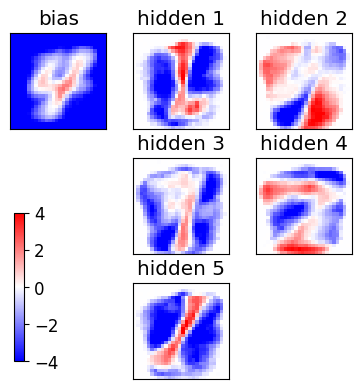

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

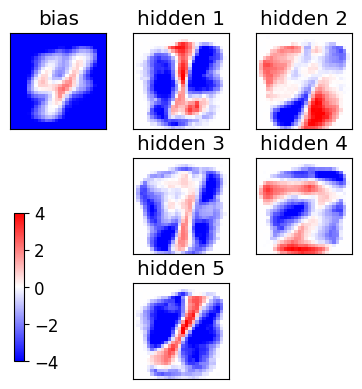

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

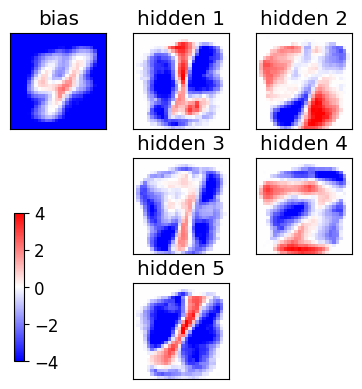

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

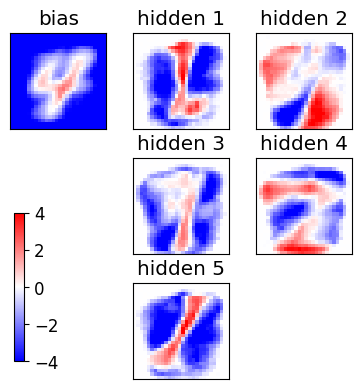

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

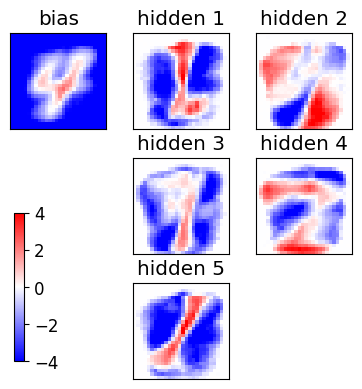

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

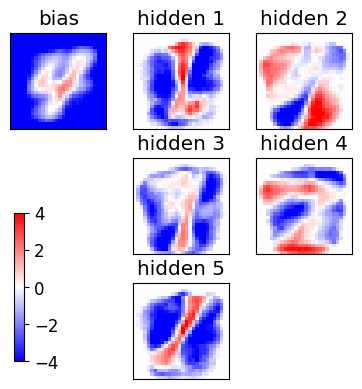

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

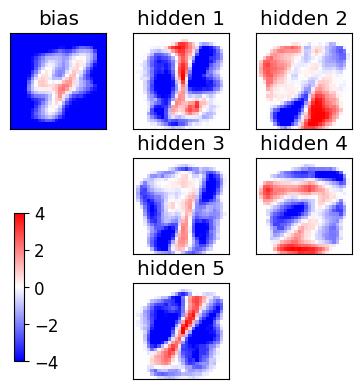

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

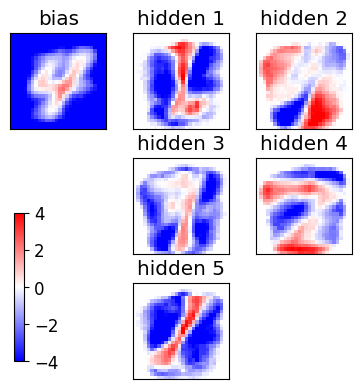

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

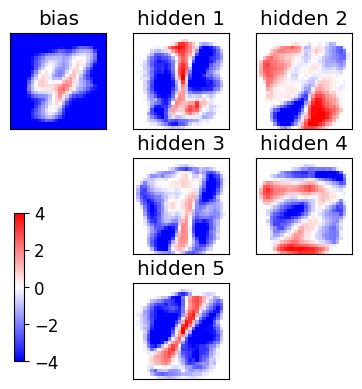

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

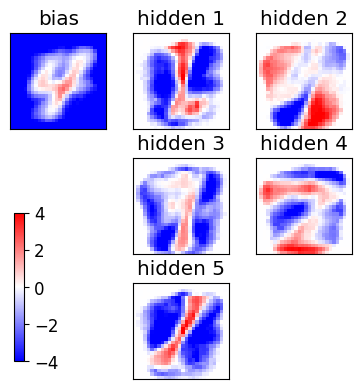

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

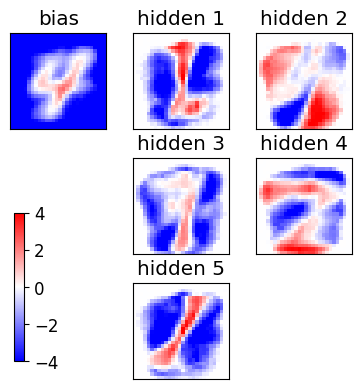

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

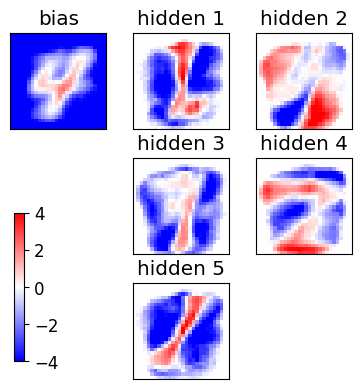

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

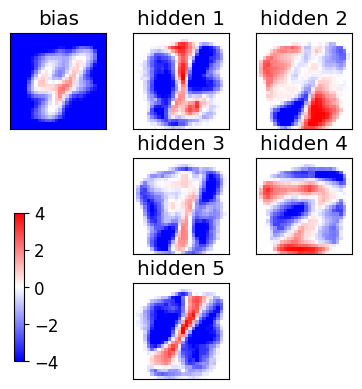

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

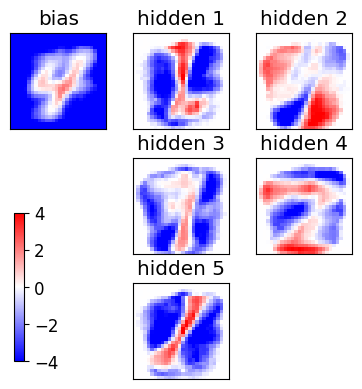

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

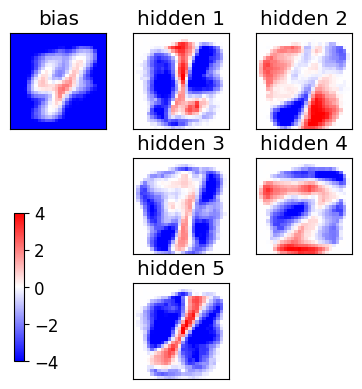

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

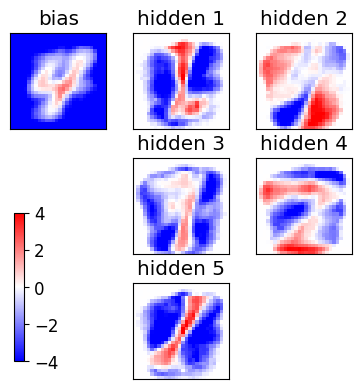

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

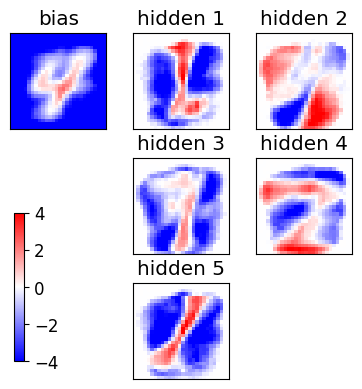

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

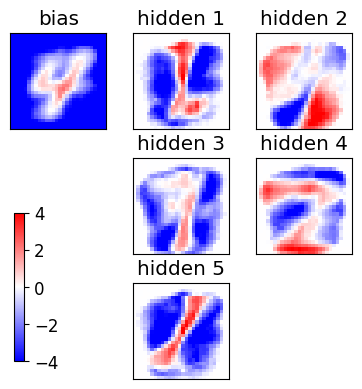

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

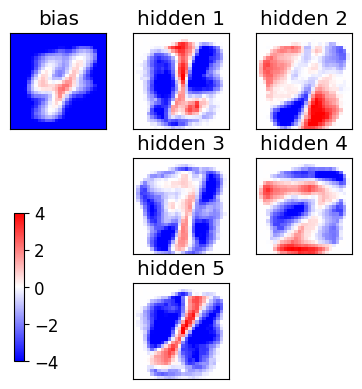

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

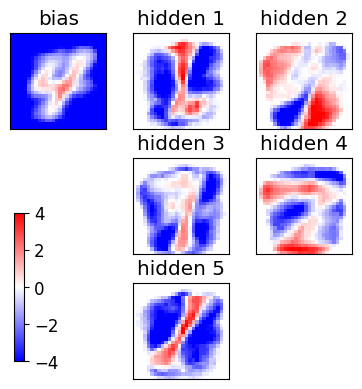

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

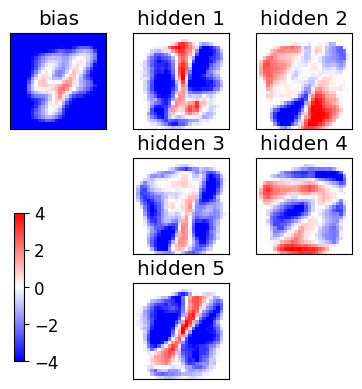

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

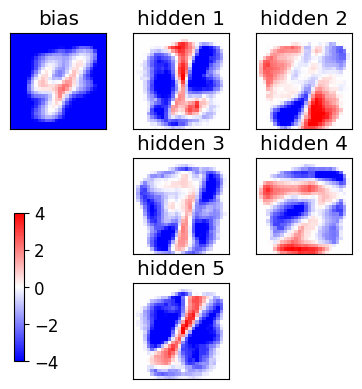

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

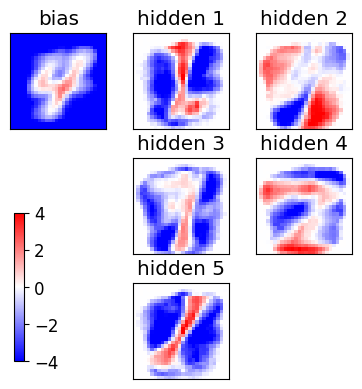

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

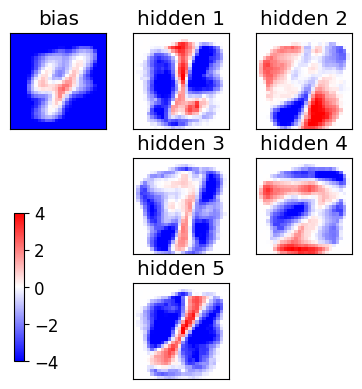

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

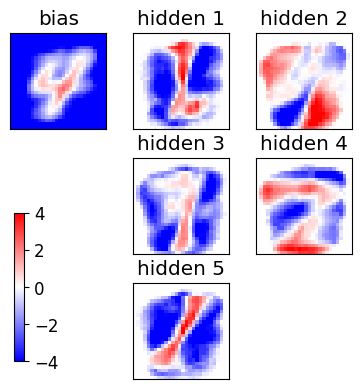

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

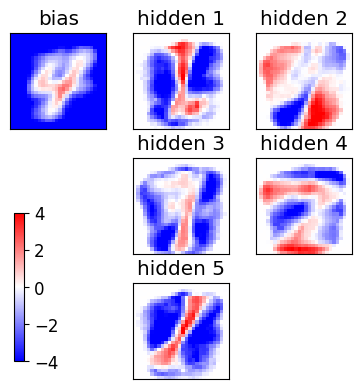

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

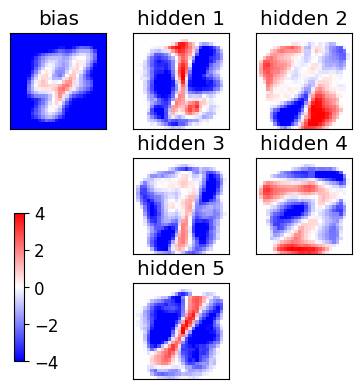

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

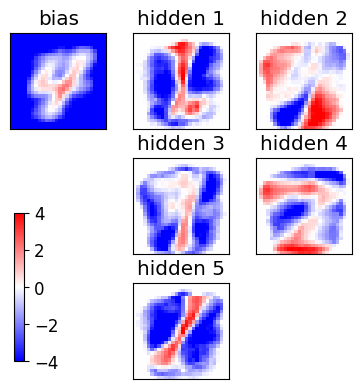

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

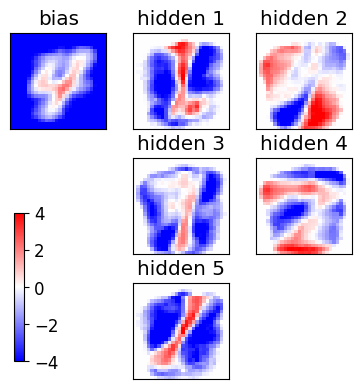

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

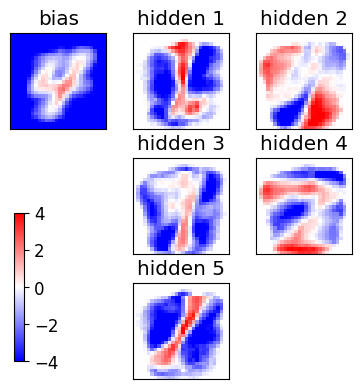

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

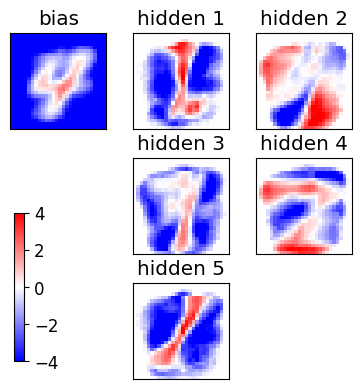

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

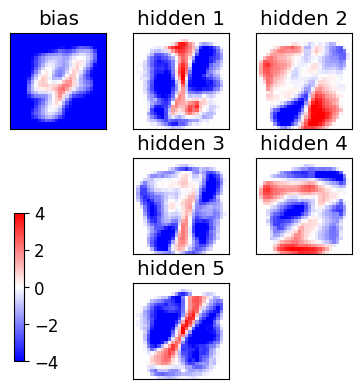

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

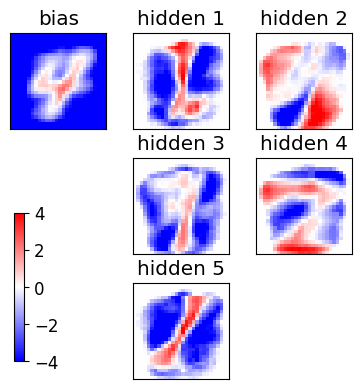

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

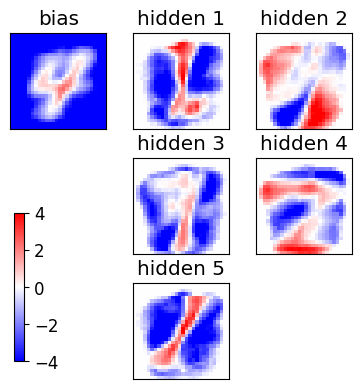

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

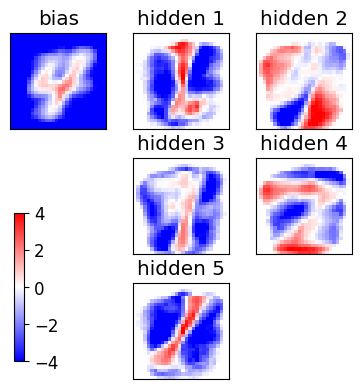

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

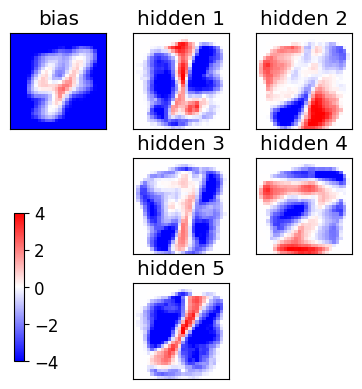

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

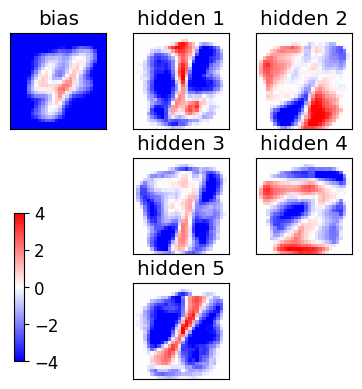

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

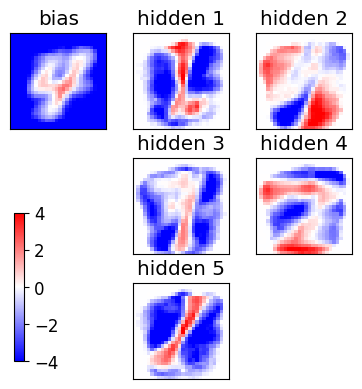

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

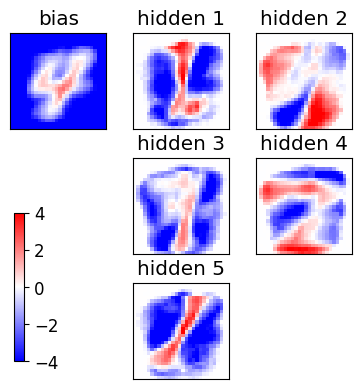

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

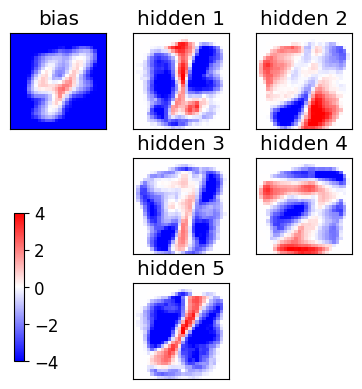

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

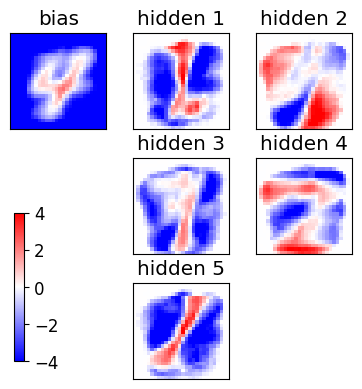

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

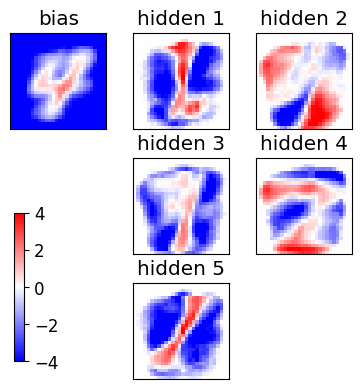

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

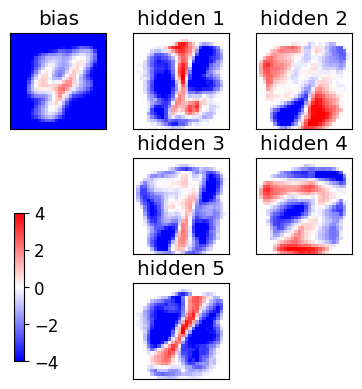

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

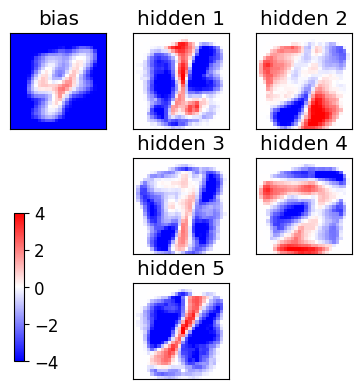

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

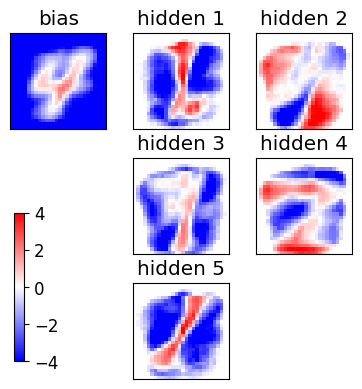

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

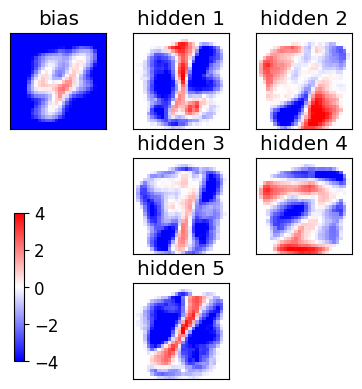

END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

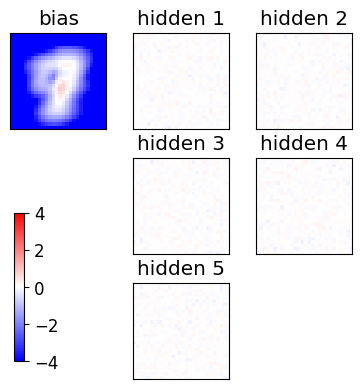

Starting the training
[10161  7791 15918 19634 21735 20477  9798  4611 20222 14461]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[19882  3864 20832  9534 10944 13062  1167  5272  4228  2228]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[ 7415  1109  6379 12680  1364  8453 15188  5952 12623 14858]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[19237  4203 11276  9762 14483 17045   310 15518 15471  6644]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

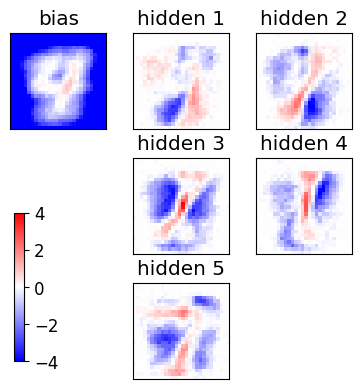

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

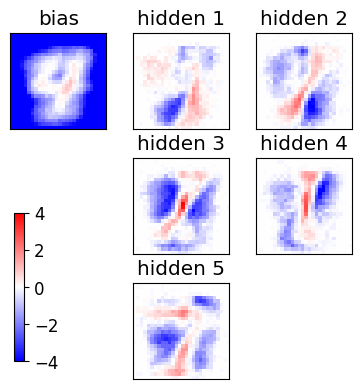

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

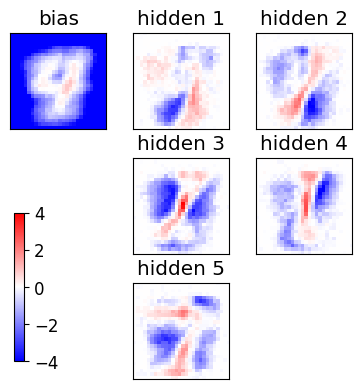

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

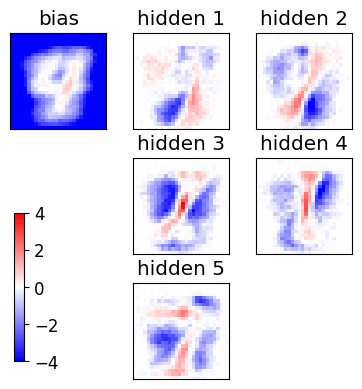

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

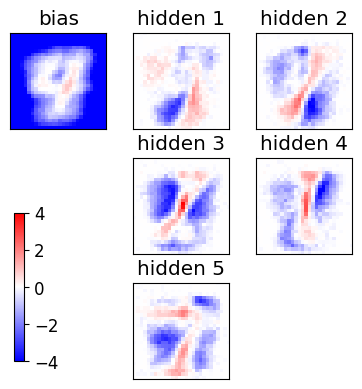

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

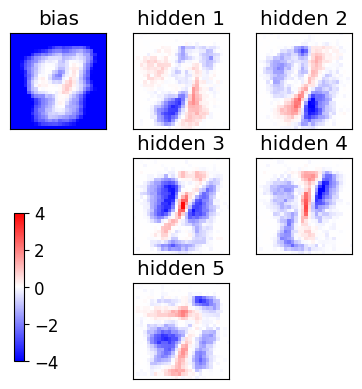

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

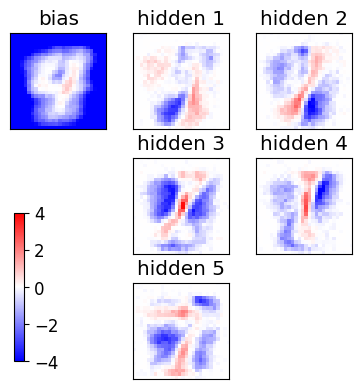

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

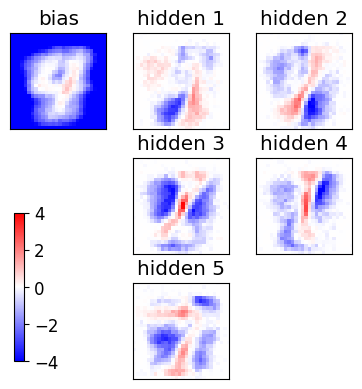

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

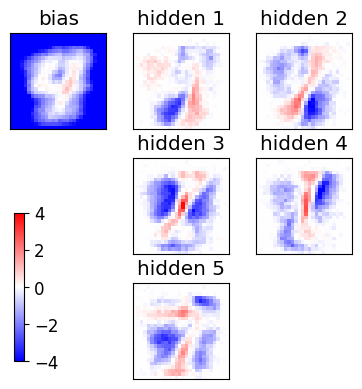

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

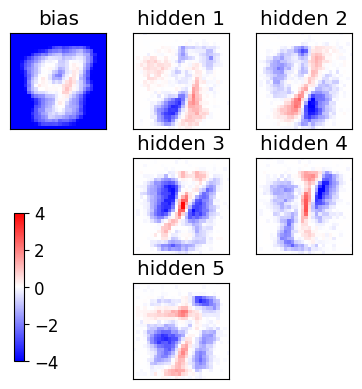

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

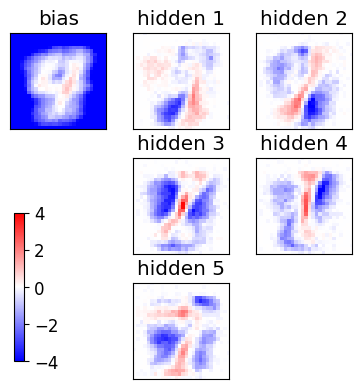

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

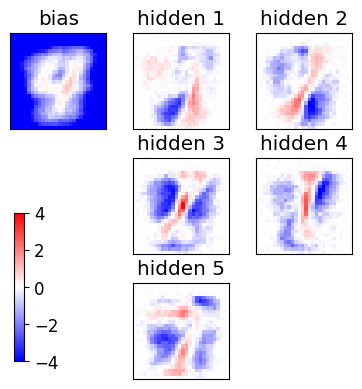

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

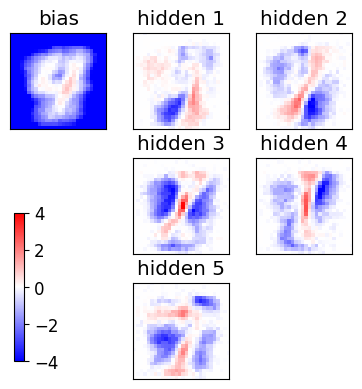

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

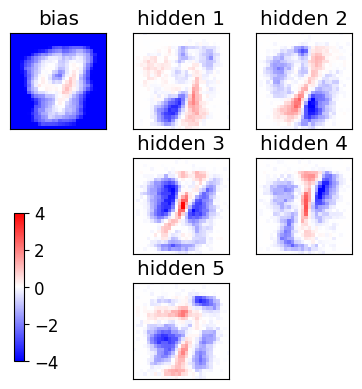

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

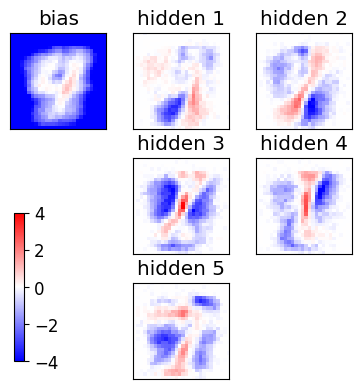

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

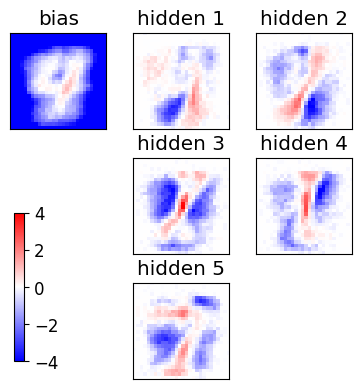

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

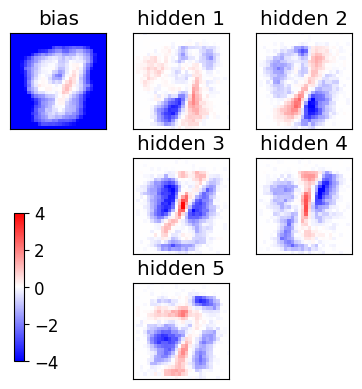

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

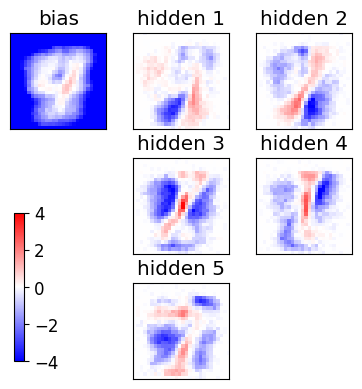

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

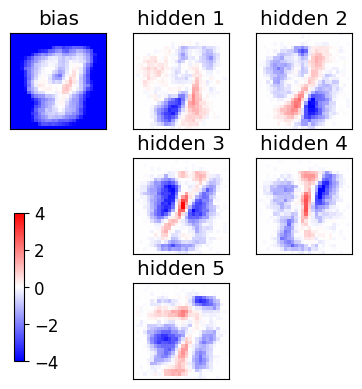

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

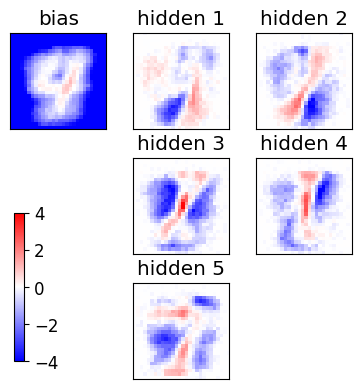

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

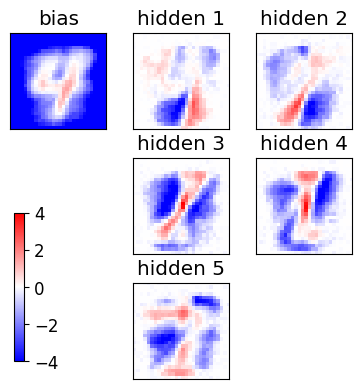

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

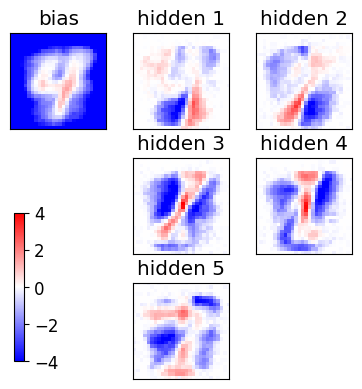

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

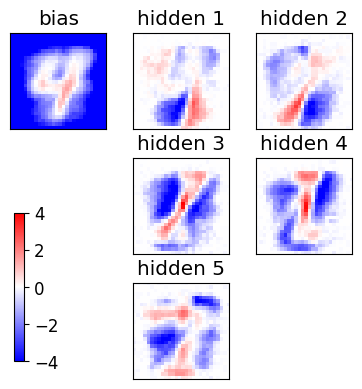

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

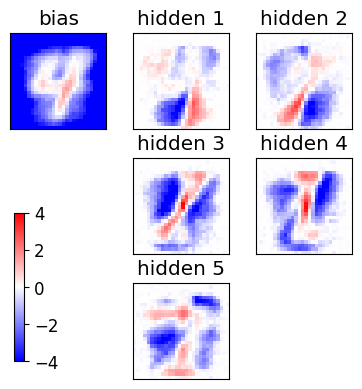

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

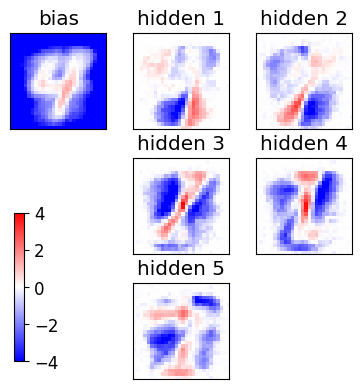

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

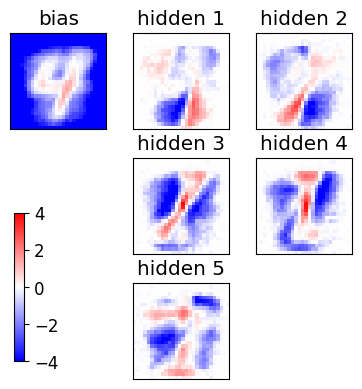

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

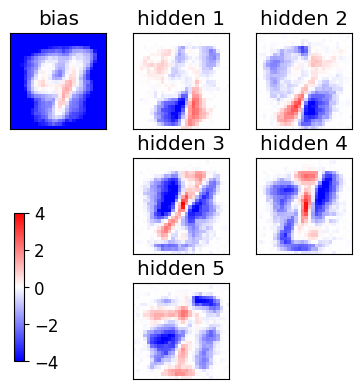

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

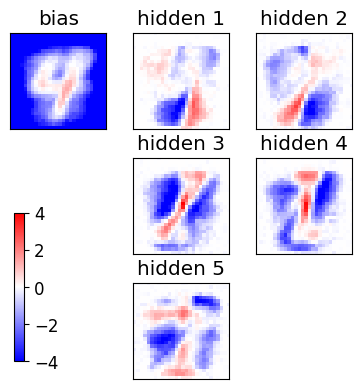

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

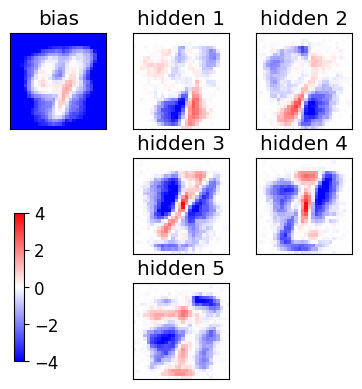

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

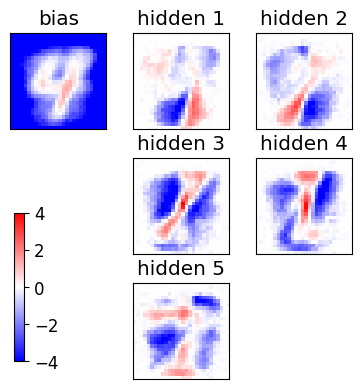

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

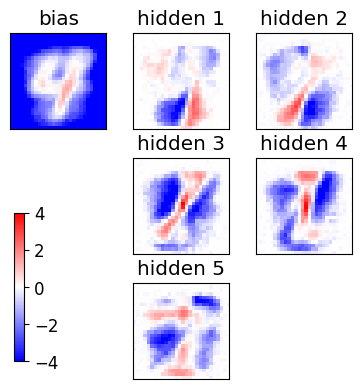

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

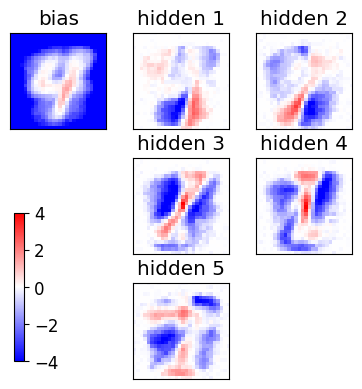

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

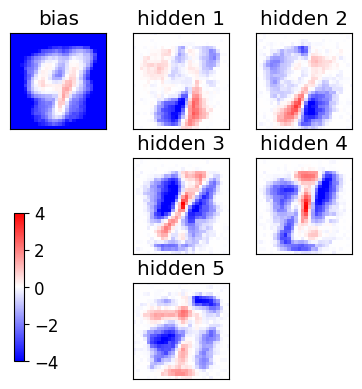

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

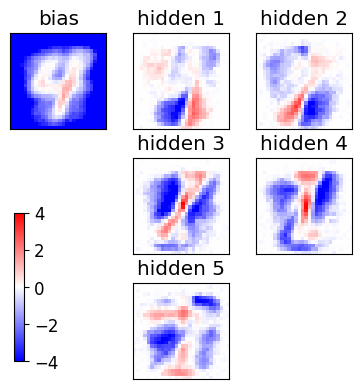

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

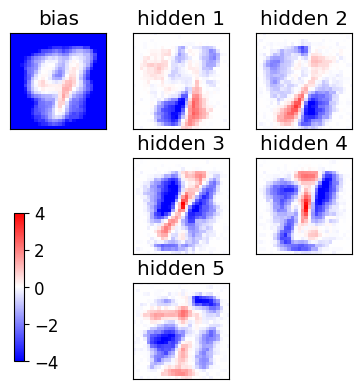

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

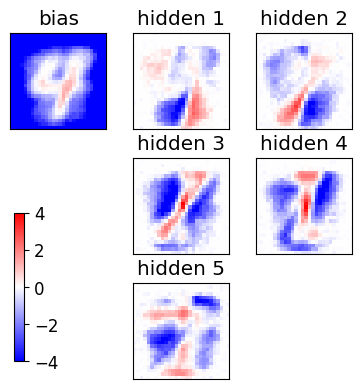

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

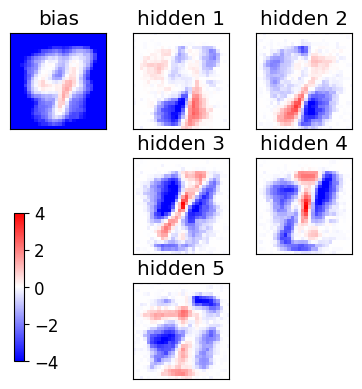

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

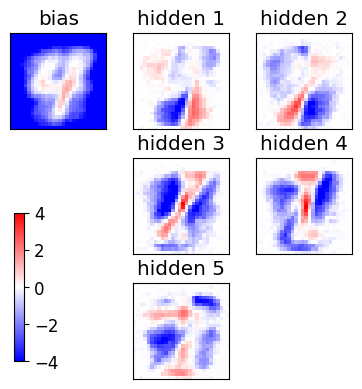

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

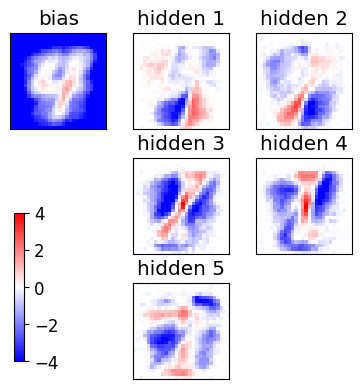

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

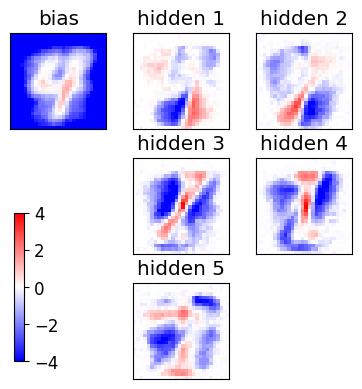

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

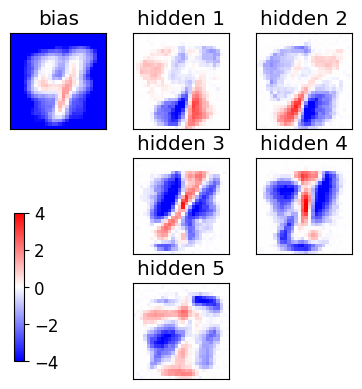

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

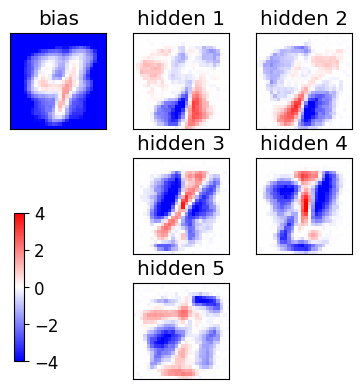

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

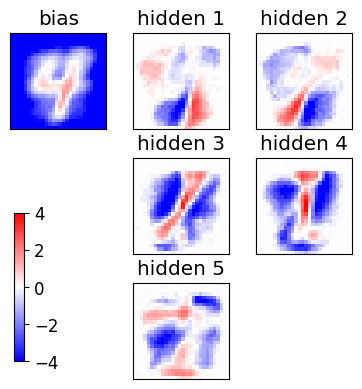

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

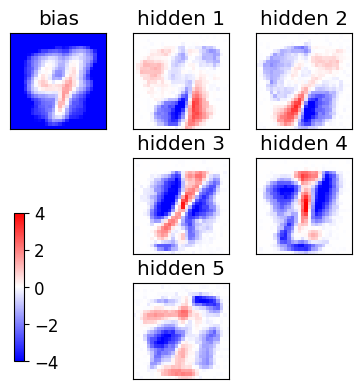

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

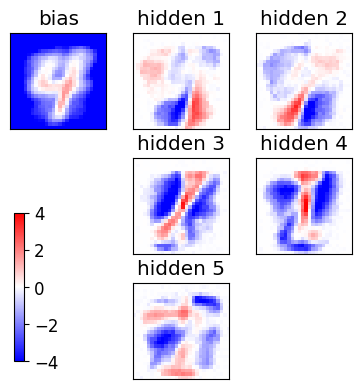

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

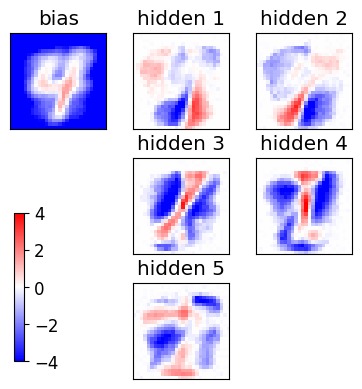

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

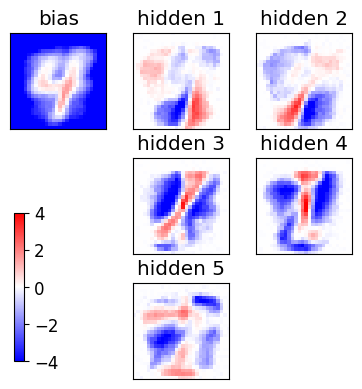

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

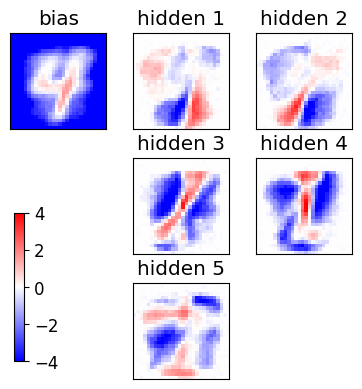

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

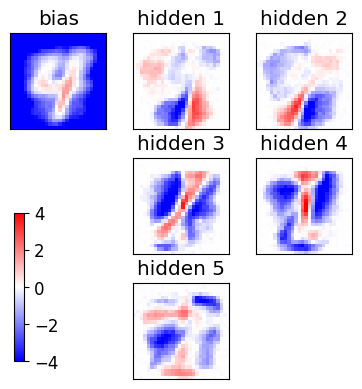

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

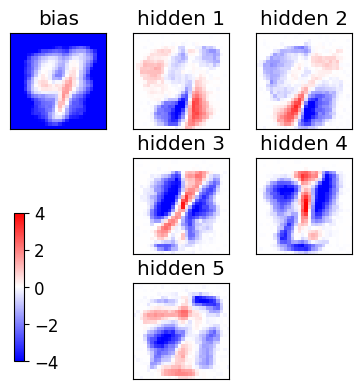

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

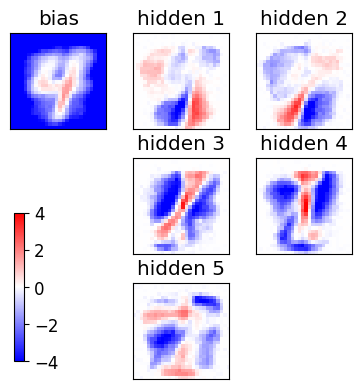

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

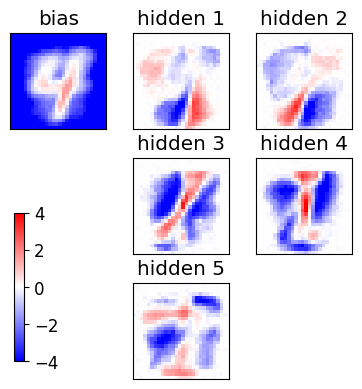

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

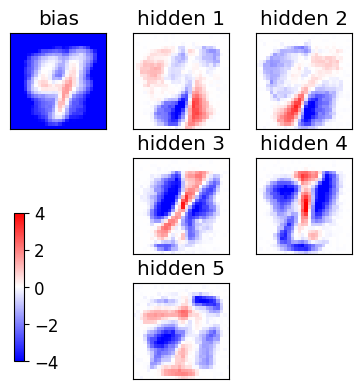

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

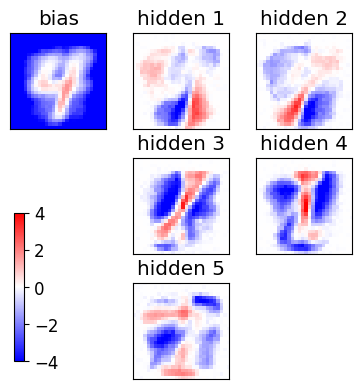

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

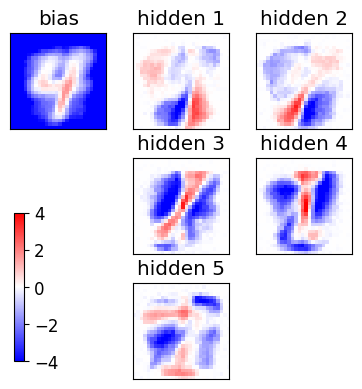

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

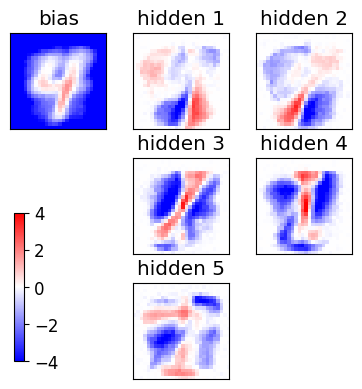

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

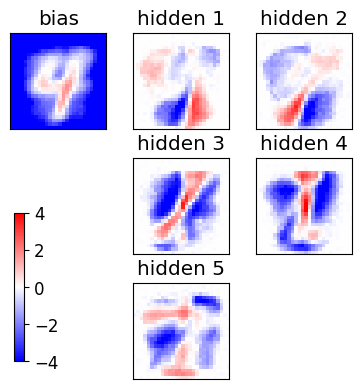

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

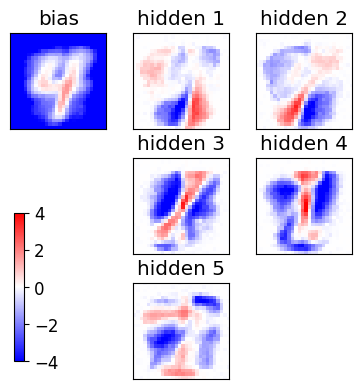

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

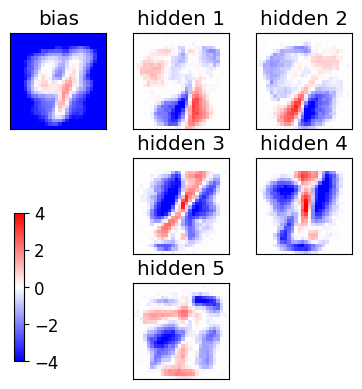

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

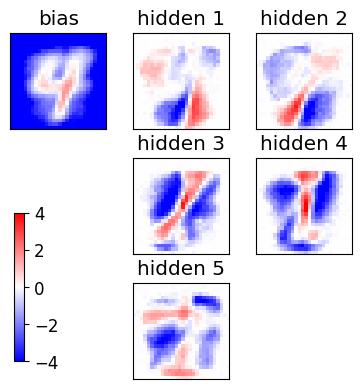

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

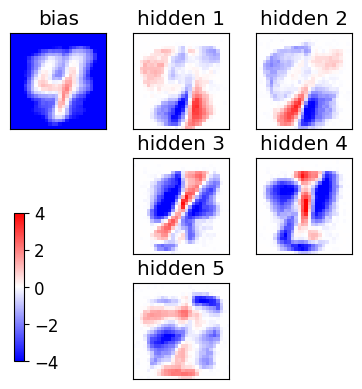

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

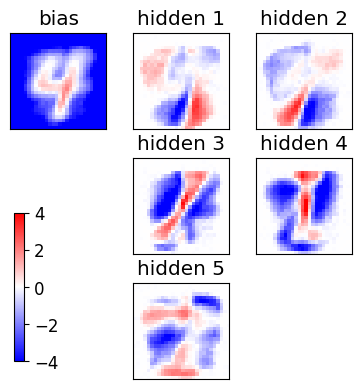

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

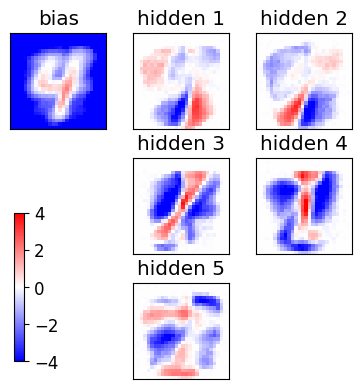

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

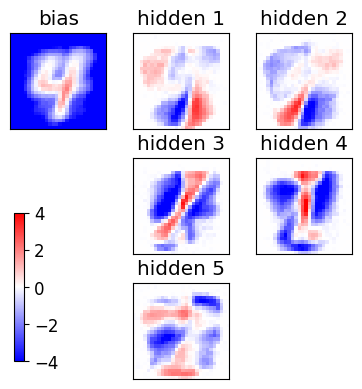

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

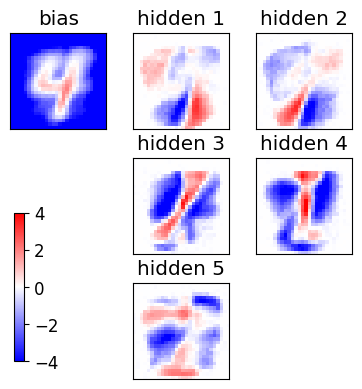

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

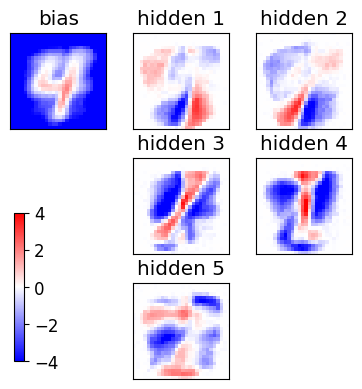

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

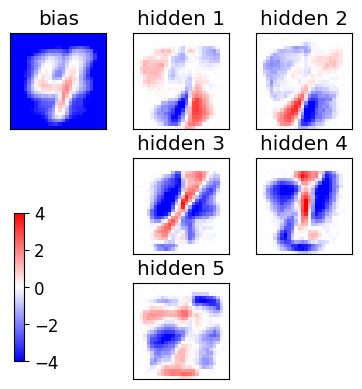

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

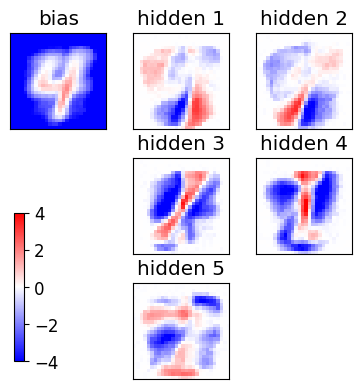

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

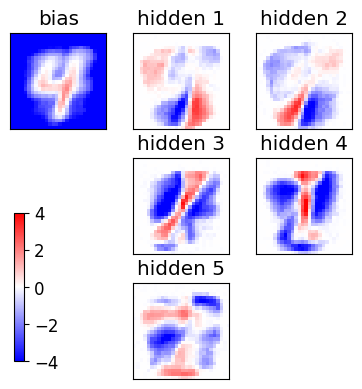

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

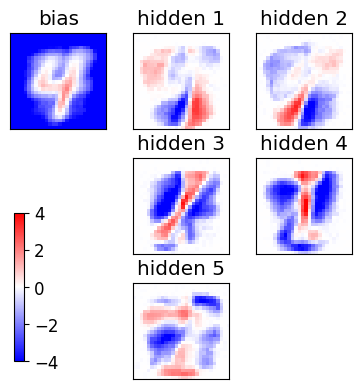

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

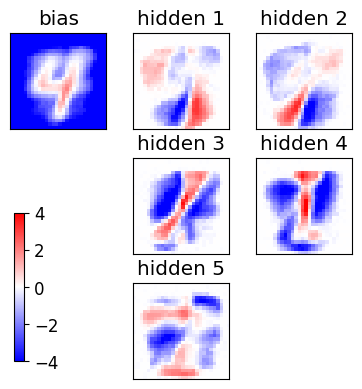

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

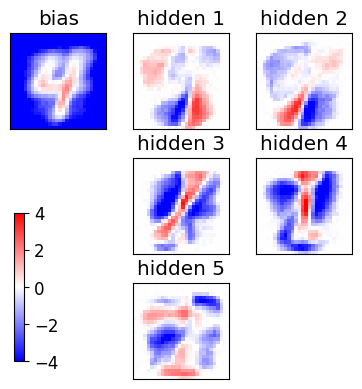

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

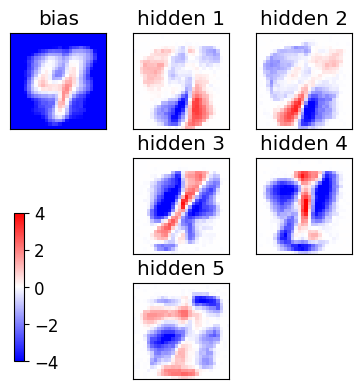

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

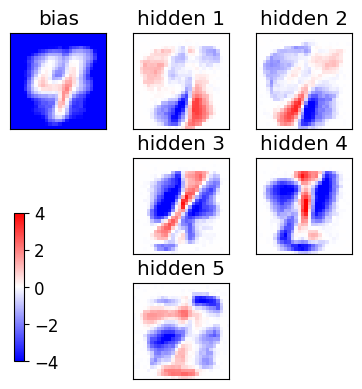

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

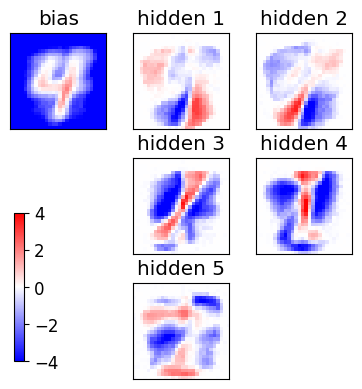

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

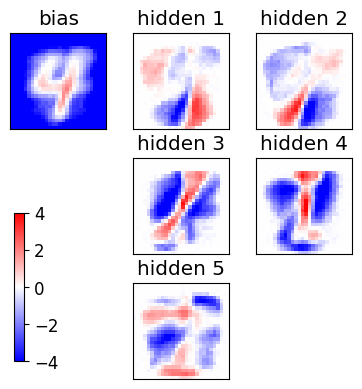

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

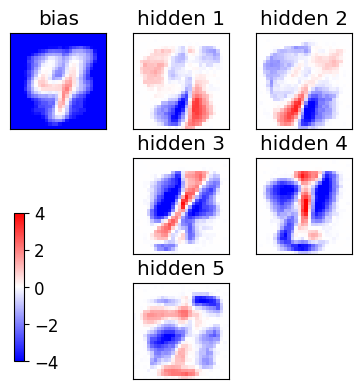

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

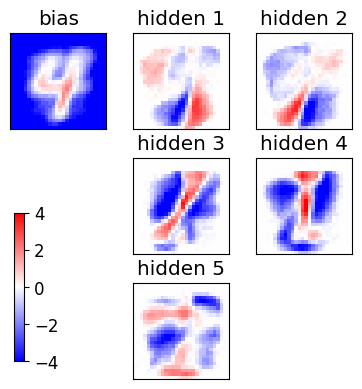

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

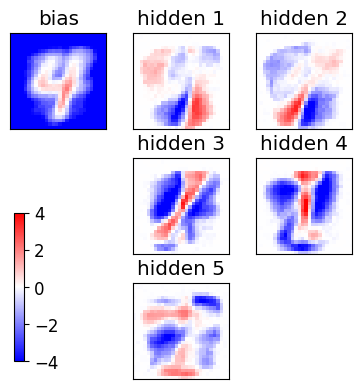

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

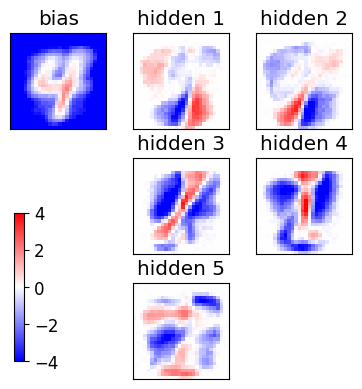

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

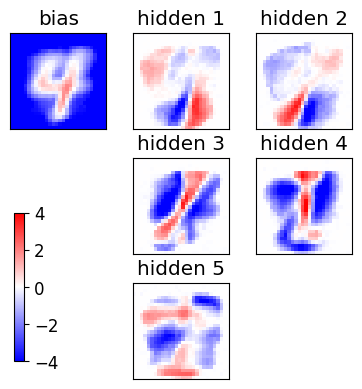

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

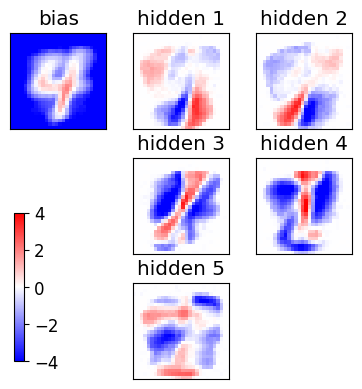

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

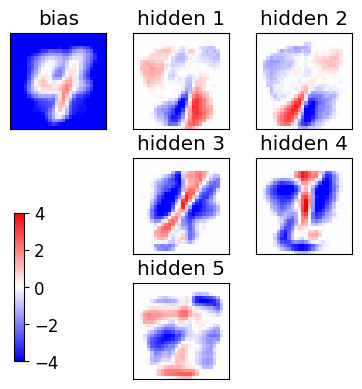

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

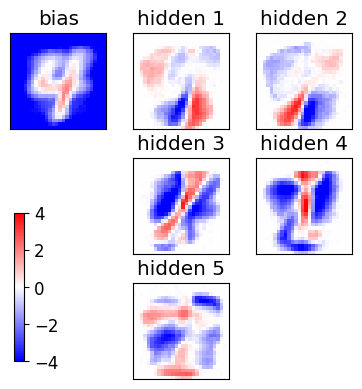

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

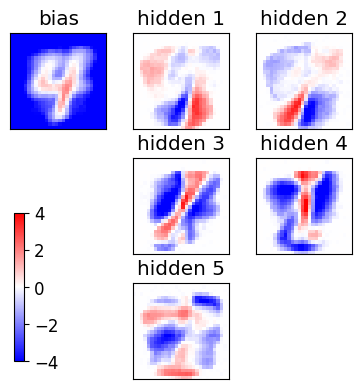

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

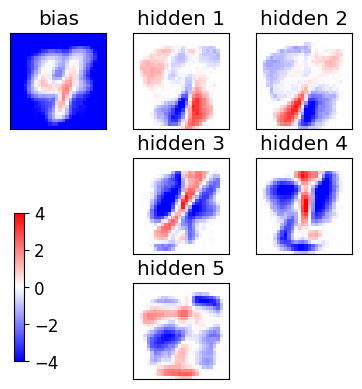

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

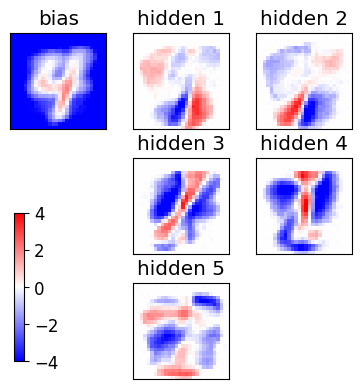

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

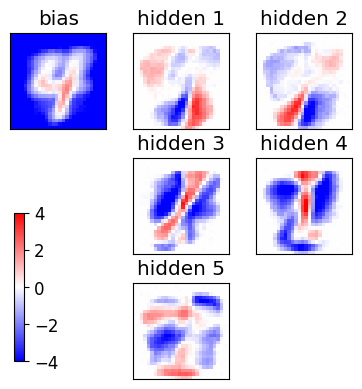

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

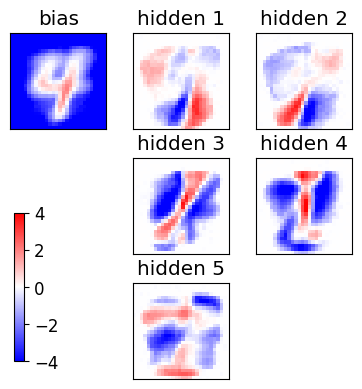

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

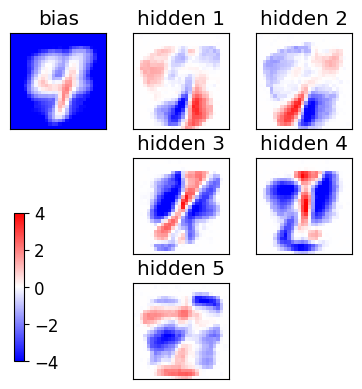

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

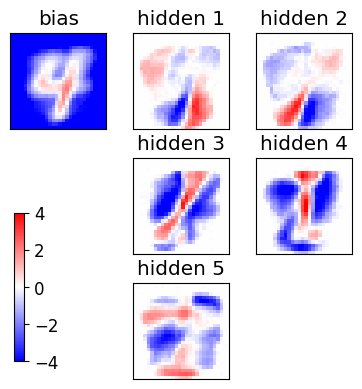

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

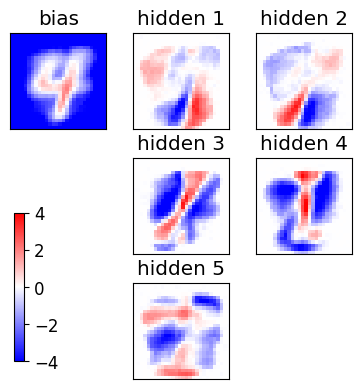

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

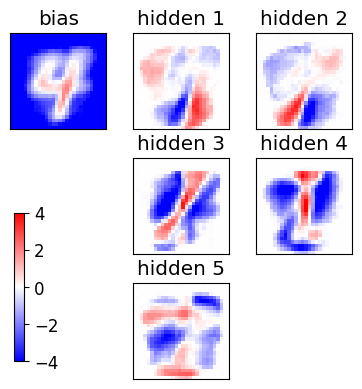

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

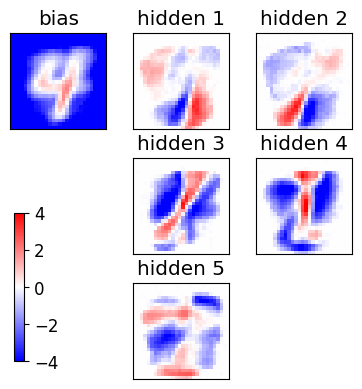

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

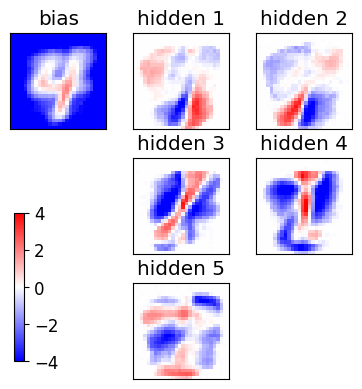

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

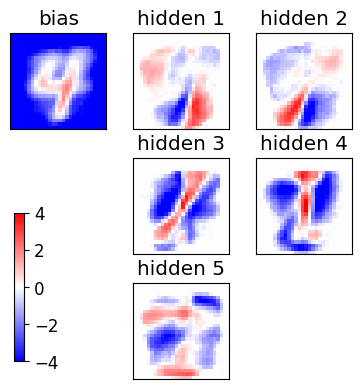

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

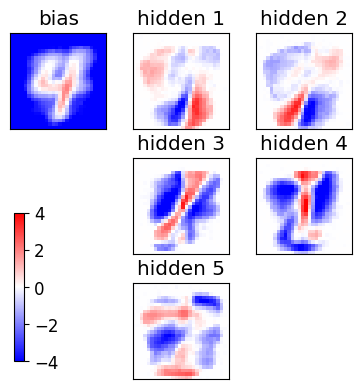

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

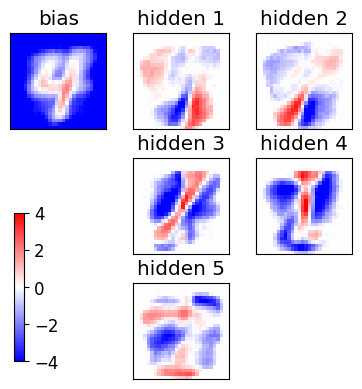

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

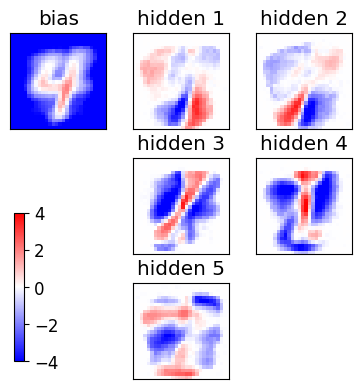

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

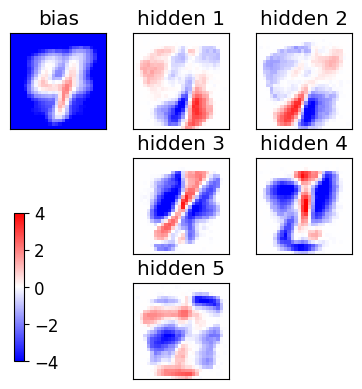

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

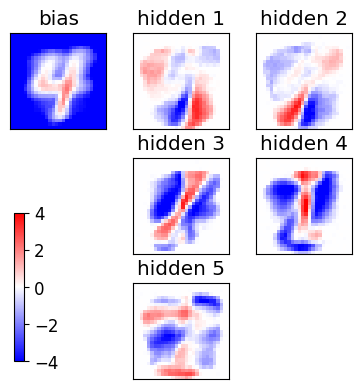

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

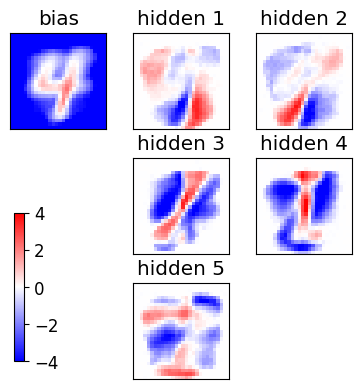

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

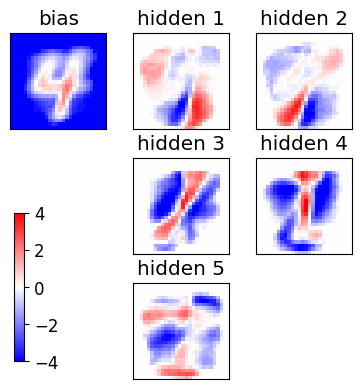

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

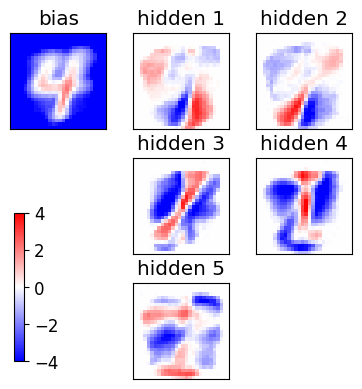

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

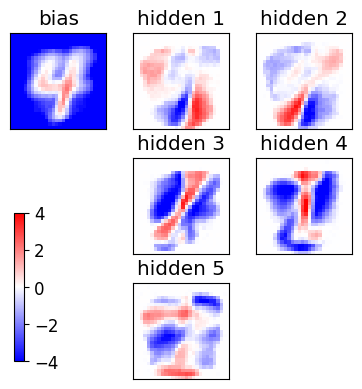

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

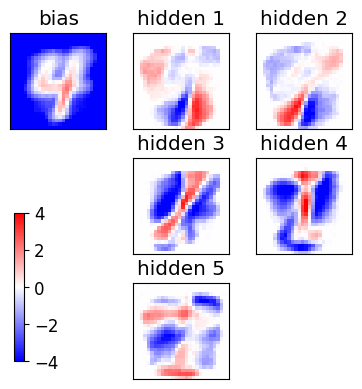

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

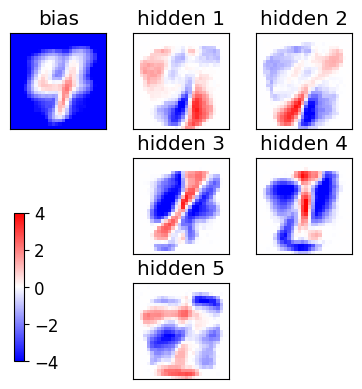

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

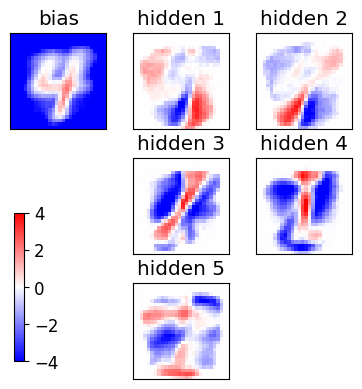

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

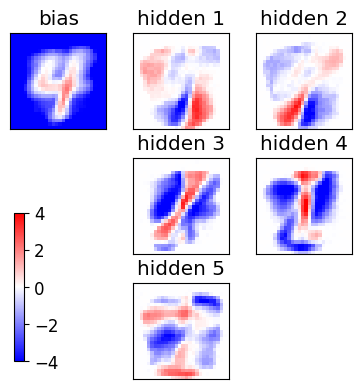

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

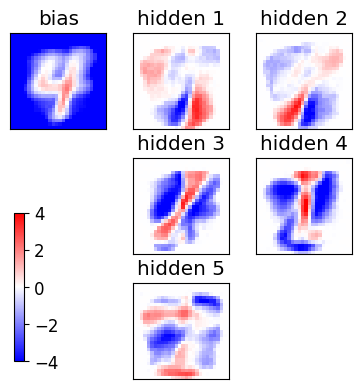

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

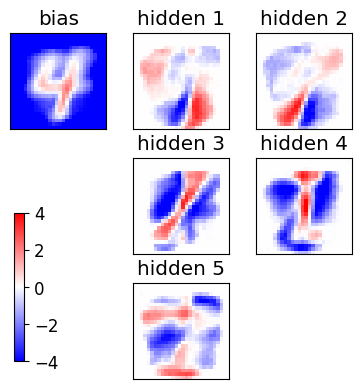

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

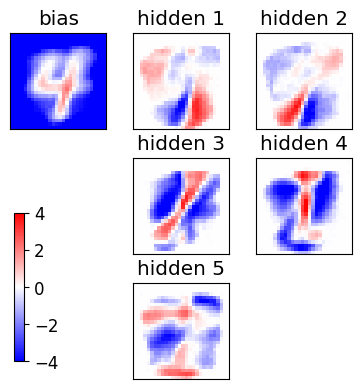

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

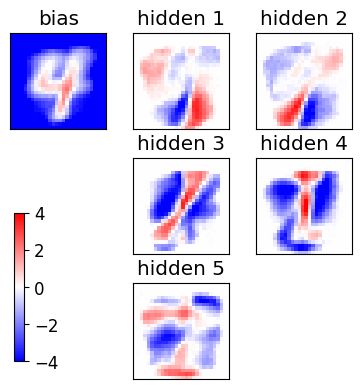

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

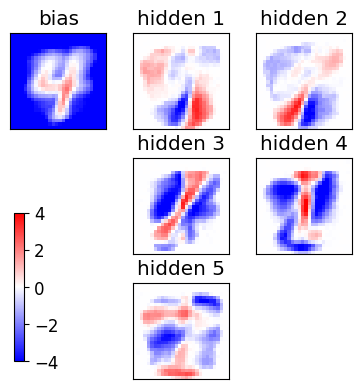

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

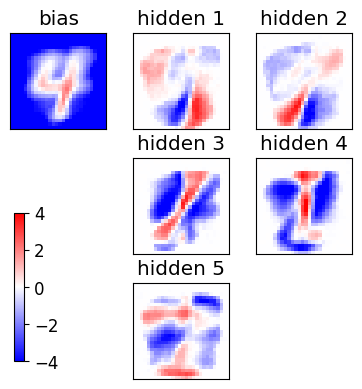

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

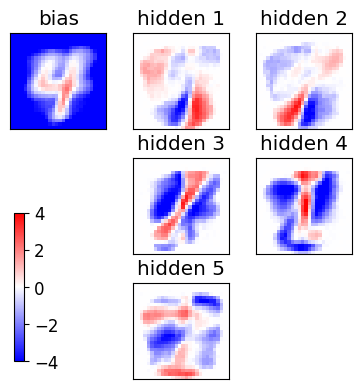

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

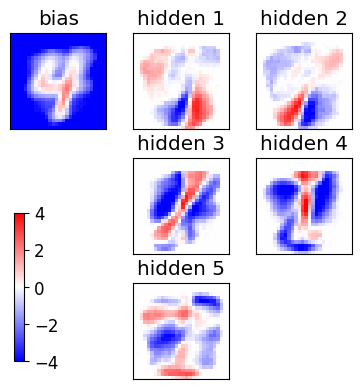

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

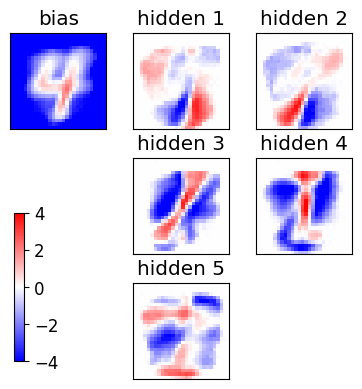

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

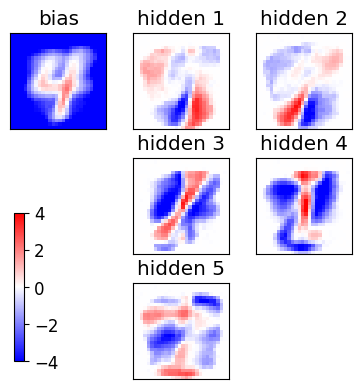

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

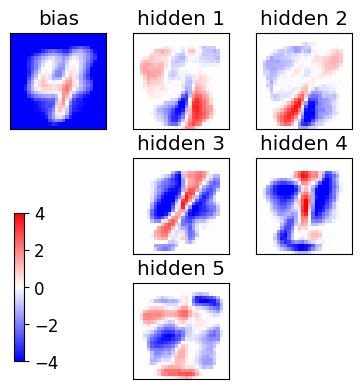

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

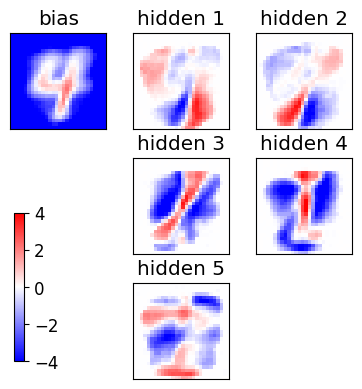

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

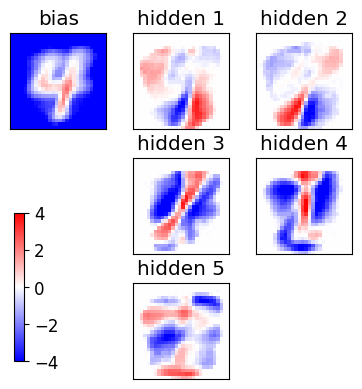

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

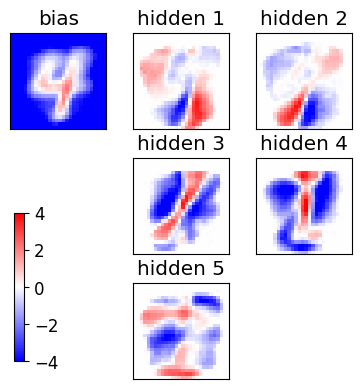

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

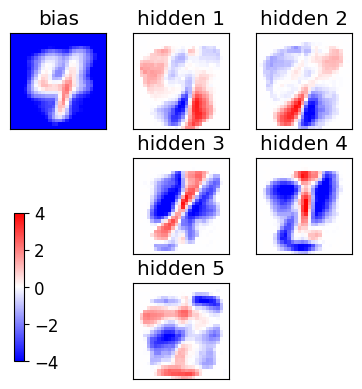

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

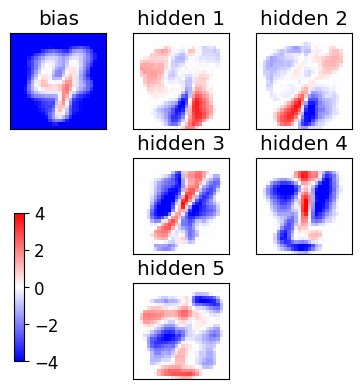

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

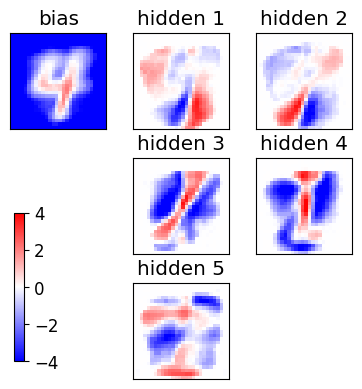

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

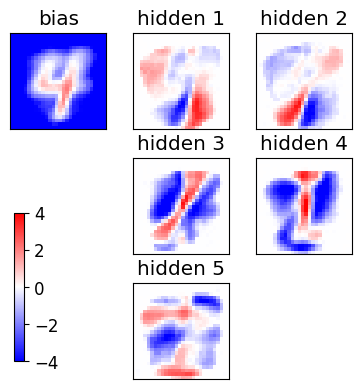

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

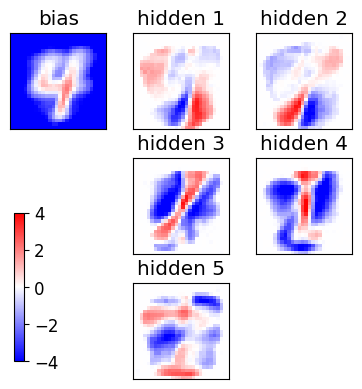

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

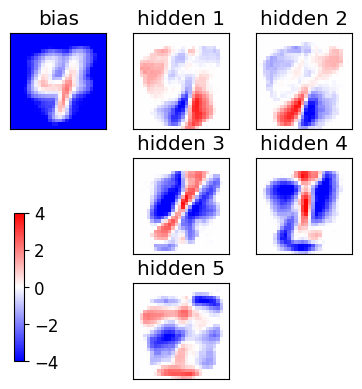

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

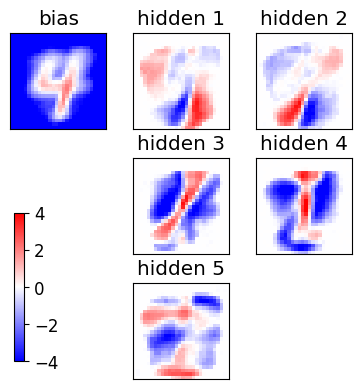

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

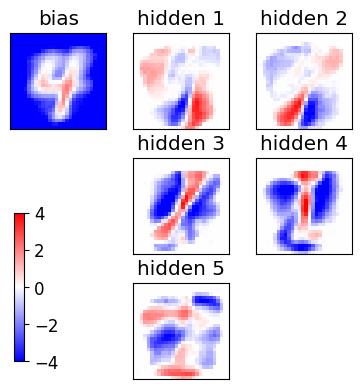

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

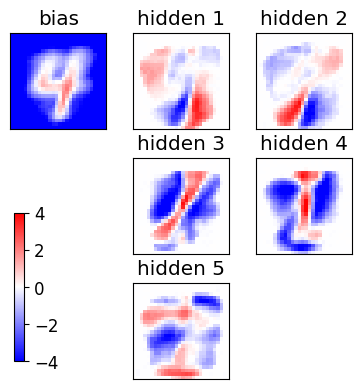

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

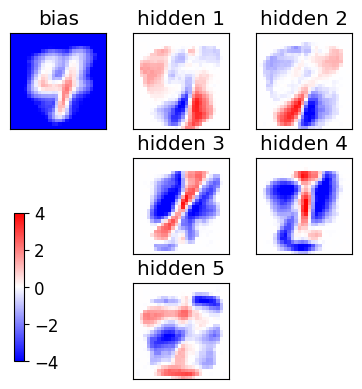

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

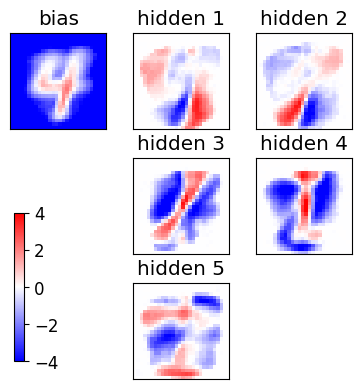

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

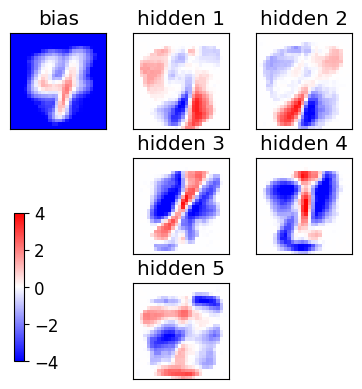

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

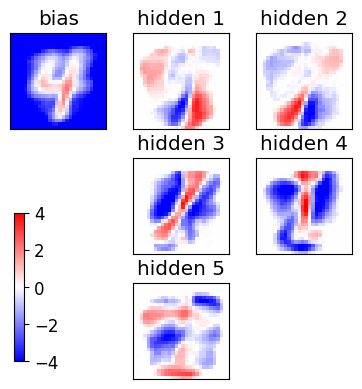

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

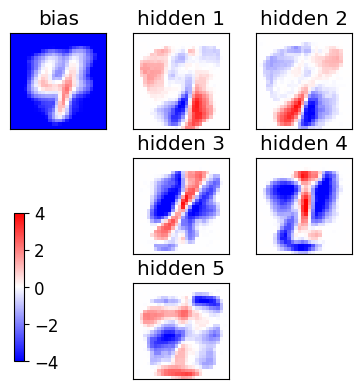

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

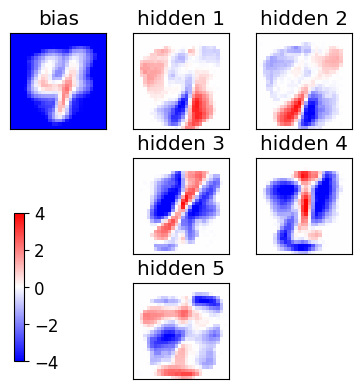

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

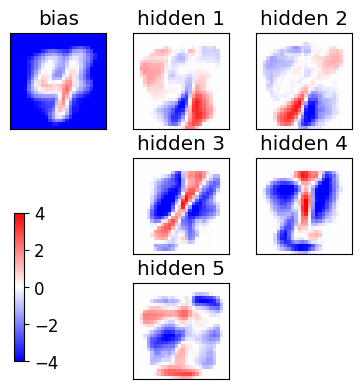

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

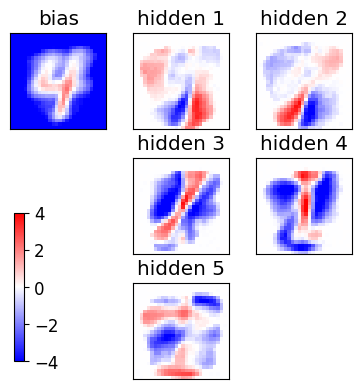

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

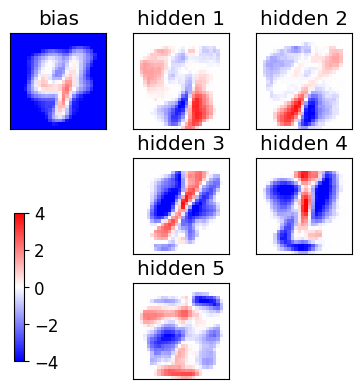

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

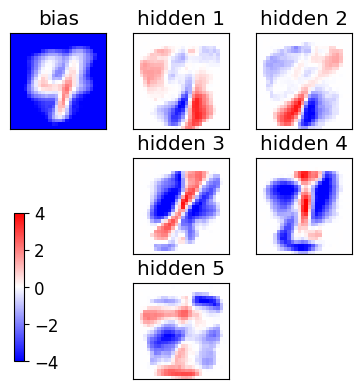

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

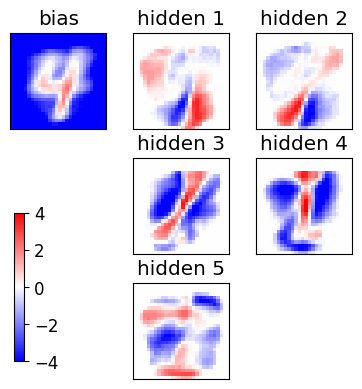

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

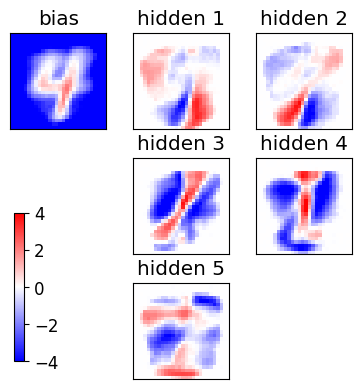

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

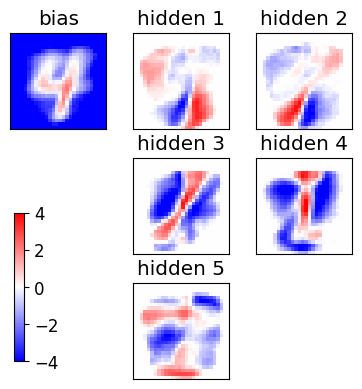

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

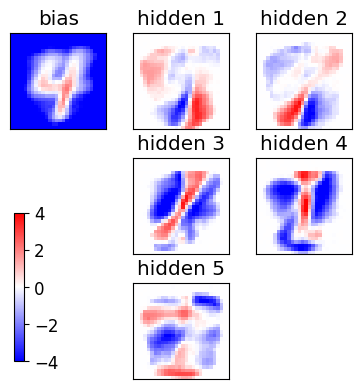

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

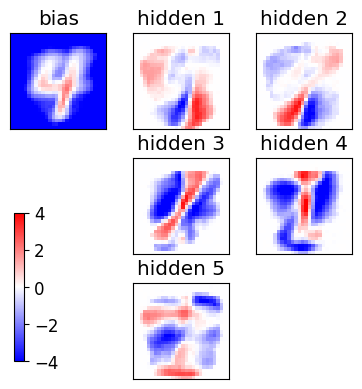

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

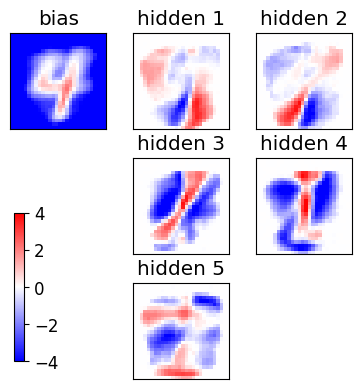

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

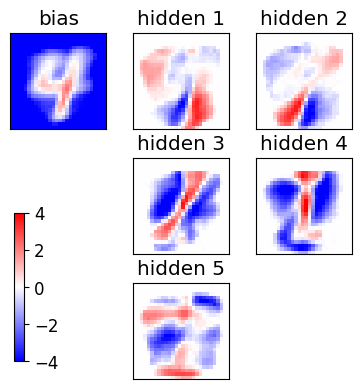

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

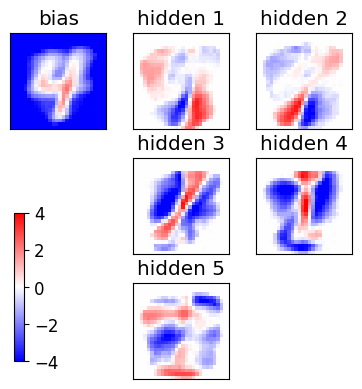

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

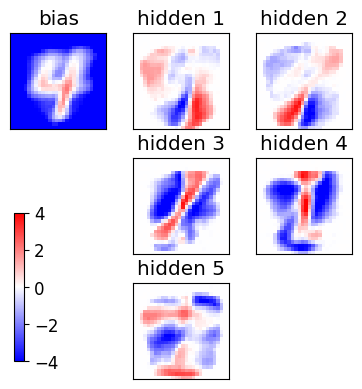

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

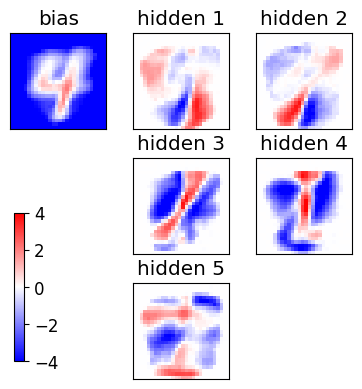

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

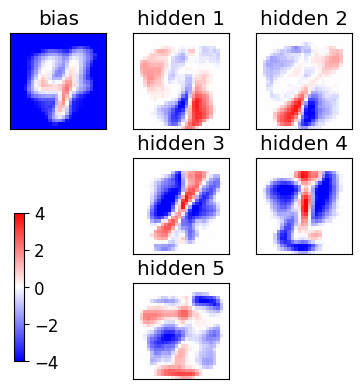

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

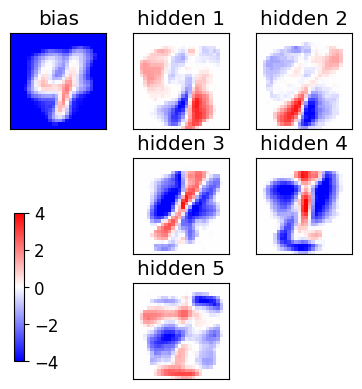

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

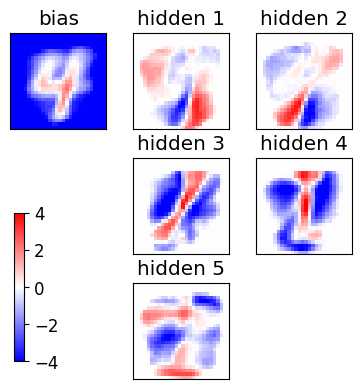

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

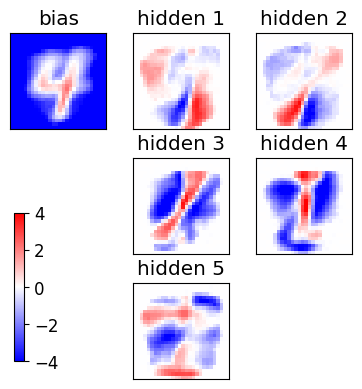

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

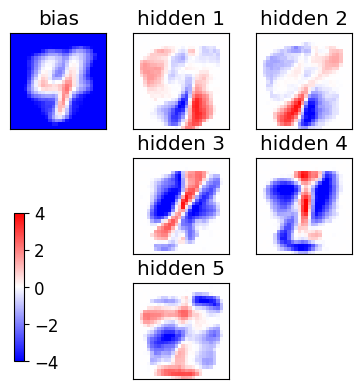

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

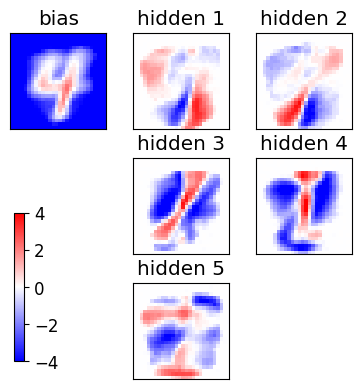

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

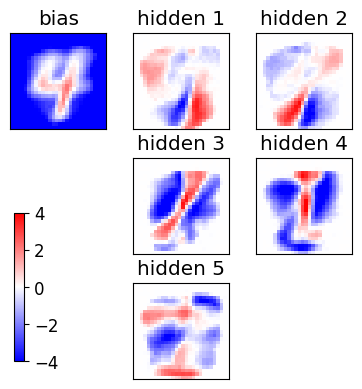

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

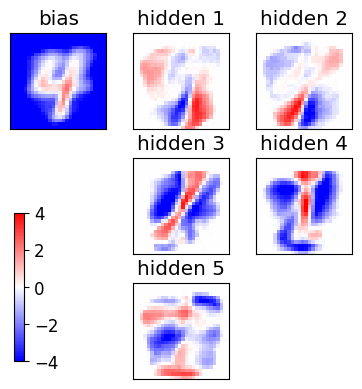

END of learning phase


In [38]:
#training for different regularization gamma, Nt

for gamma in gamma_v:
    if gamma>0:
        L = 5
        Nt = 4
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D, L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)

        # nr of epochs
        Nepoch = 150
        # minibatches per epoch
        Nmini = 20
        # minibatch size at initial epoch and final one
        N_ini, N_fin = 10, 500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")

        # recording history of weights ("E" means epoch)
        wE, aE, bE = np.zeros((Nepoch + 1, D, L)), np.zeros((Nepoch + 1, D)), np.zeros((Nepoch + 1, L))
        wE[0], aE[0], bE[0] = np.copy(w), np.copy(a), np.copy(b)
        gwE, gw2E, gwE_d, gwE_m = np.zeros_like(wE), np.zeros_like(wE), np.zeros_like(wE), np.zeros_like(wE)
        gaE, ga2E, gaE_d, gaE_m = np.zeros_like(aE), np.zeros_like(aE), np.zeros_like(aE), np.zeros_like(aE)
        gbE, gb2E, gbE_d, gbE_m = np.zeros_like(bE), np.zeros_like(bE), np.zeros_like(bE), np.zeros_like(bE)
        miniE = np.zeros(Nepoch + 1)
        pzE = np.zeros((Nepoch + 1, Nz))
        if GRAD == "RMSprop":
            gw2, ga2, gb2 = np.zeros_like(w), np.zeros_like(a), np.zeros_like(b)

        indices = np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L // 2, save=False)

        # for the plot with panels
        Ncols = min(8, max(2, L // 2))

        if POTTS:
            print("Starting the training, POTTS=True")
        else:
            print("Starting the training")

        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1, 1 + Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch - 1.) / (Nepoch - 1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin - N_ini) * (q ** 2))
            # l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin - l_rate_ini) * q

            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                # hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D), np.zeros(D)
                z_data, z_model = np.zeros(L), np.zeros(L)
                xz_data, xz_model = np.zeros((D, L)), np.zeros((D, L))
                pz = np.zeros(L)

                # Minibatch of size N: points randomly picked (without repetition) from data
                selected = np.random.choice(indices, N, replace=False)
                if epoch == 1 and mini <= 3:
                    print(selected)

                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0, w, b, POTTS=POTTS)
                    x_data += x0
                    z_data += z
                    xz_data += np.outer(x0, z)
                    # fantasy
                    zf = np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD phase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf, w.T, a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf, w, b, POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model += np.outer(xf, zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS:
                        pz[zf] += 1
                    ###################################

                # gradient of the likelihood: follow it along its positive direction
                gw_d, gw_m = xz_data / N, xz_model / N
                ga_d, ga_m = x_data / N, x_model / N
                gb_d, gb_m = z_data / N, z_model / N
                gw = np.copy(gw_d - gw_m)
                ga = np.copy(ga_d - ga_m)
                gb = np.copy(gb_d - gb_m)

                # gradient ascent step
                if GRAD == "RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta * gw2 + (1 - beta) * np.square(gw)
                    ga2 = beta * ga2 + (1 - beta) * np.square(ga)
                    gb2 = beta * gb2 + (1 - beta) * np.square(gb)
                    w += l_rate * gw / sqrt(epsilon + gw2)
                    a += l_rate * ga / sqrt(epsilon + ga2)
                    b += l_rate * gb / sqrt(epsilon + gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate * gw
                    a += l_rate * ga
                    b += l_rate * gb
                # regularization (LASSO)
                if gamma > 0.:
                    w -= (gamma * l_rate) * sign(w)
                    a -= (gamma * l_rate) * sign(a)
                    b -= (gamma * l_rate) * sign(b)

                wE[epoch], gwE[epoch], gwE_d[epoch], gwE_m[epoch] = np.copy(w), np.copy(gw), np.copy(gw_d), np.copy(gw_m)
                aE[epoch], gaE[epoch], gaE_d[epoch], gaE_m[epoch] = np.copy(a), np.copy(ga), np.copy(ga_d), np.copy(ga_m)
                bE[epoch], gbE[epoch], gbE_d[epoch], gbE_m[epoch] = np.copy(b), np.copy(gb), np.copy(gb_d), np.copy(gb_m)
                miniE[epoch] = N
                if POTTS:
                    pzE[epoch] = pz / np.sum(pz)
                print("epoch", epoch, "/", Nepoch, " Nt:", Nt, " N:", N, " L:", L,
                    " rate:", l_rate, " gam:", gamma, "SPINS=", SPINS, "POTTS=", POTTS)

                if Nepoch <= 100 or epoch % 20 == 0 or epoch == Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
                save_epochs(wE, "w")
                save_epochs(bE, "b")
                save_epochs(aE, "a")

        print("END of learning phase")

In [45]:
log_like_gamma=[]
log_like_gamma_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-5,Nepoch,1) # consider trend over the last 5 iterations

for gamma in gamma_v:
  if gamma>0.:
    L=5
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'a_all gamma={gamma}, L={L}, Nt={Nt}')
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'b_all gamma={gamma}, L={L}, Nt={Nt}')
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'w_all gamma={gamma}, L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like_g=[]
    log_like_g_std=[]
    Nepoch=150
    for i in range(Nepoch-5,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter=[]
        mean=[]
        for iter in range(5): # to determine the loglike at each epoch we run the calculation 5 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like_g.append(ll_mean)
        log_like_g_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_gamma.append(log_like_g)
    log_like_gamma_std.append(log_like_g_std)


a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:20<00:00, 274.30it/s]


Log-likelihood= -127.24936264327123 +- 0.09868374070078725
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 289.84it/s]


Log-likelihood= -125.48560986222321 +- 0.39617839366682694
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 285.79it/s]


Log-likelihood= -125.56843316209658 +- 0.6485767332868067
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 274.95it/s]


Log-likelihood= -126.39556656076766 +- 0.33898509978117325
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 275.02it/s]


Log-likelihood= -123.94252645370557 +- 0.2938311468828203
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.13it/s]


Log-likelihood= -126.72476994924375 +- 0.3505401132270048
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 286.81it/s]


Log-likelihood= -124.40563102266633 +- 0.5328862241434911
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 279.15it/s]


Log-likelihood= -123.72866452859 +- 0.2972349430252236
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.05it/s]


Log-likelihood= -125.87915395843947 +- 0.653735542159499
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.78it/s]


Log-likelihood= -125.22376629258126 +- 0.44020738848745683
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.66it/s]


Log-likelihood= -124.01324762304156 +- 0.6988188686443131
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.09it/s]


Log-likelihood= -122.89829156322526 +- 0.39900742915502585
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.81it/s]


Log-likelihood= -123.82261531115947 +- 0.5694427577354926
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.20it/s]


Log-likelihood= -124.02969839974651 +- 0.7031704100238827
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 277.88it/s]


Log-likelihood= -123.67887959517209 +- 0.3788611044094232
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 279.04it/s]


Log-likelihood= -127.33794499632832 +- 0.43345310910550594
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 280.92it/s]


Log-likelihood= -127.02620649819498 +- 0.44587762480186455
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.57it/s]


Log-likelihood= -126.82888105086695 +- 0.11149532781481647
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.78it/s]


Log-likelihood= -129.48453970010192 +- 0.4457653442159149
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 281.74it/s]

Log-likelihood= -127.12897024309113 +- 0.4447652683135306


In [19]:

log_like_gamma = [
    [-127.24936264327123, -125.48560986222321, -125.56843316209658, -126.39556656076766, -123.94252645370557],  # Case 1
    [-126.72476994924375, -124.40563102266633, -123.72866452859, -125.87915395843947, -125.22376629258126],  # Case 2
    [-124.01324762304156, -122.89829156322526, -123.82261531115947, -124.02969839974651, -123.67887959517209],  # Case 3
    [-127.33794499632832, -127.02620649819498, -126.82888105086695, -129.48453970010192, -127.12897024309113],  # Case 4
    [-138.47331831474386, -138.1203701712743, -137.71334920388665, -138.20494530508435, -138.7838087707658]  # Case 5 (aggiunto)
]

log_like_gamma_std = [
    [0.09868374070078725, 0.39617839366682694, 0.6485767332868067, 0.33898509978117325, 0.2938311468828203],  # Case 1
    [0.3505401132270048, 0.5328862241434911, 0.2972349430252236, 0.653735542159499, 0.44020738848745683],  # Case 2
    [0.6988188686443131, 0.39900742915502585, 0.5694427577354926, 0.7031704100238827, 0.3788611044094232],  # Case 3
    [0.43345310910550594, 0.44587762480186455, 0.11149532781481647, 0.4457653442159149, 0.4447652683135306],  # Case 4
    [0.4011070862112876, 0.561959628581091, 0.5458788509620577, 0.676651791500994, 0.549637774447985]  # Case 5 (aggiunto)
]

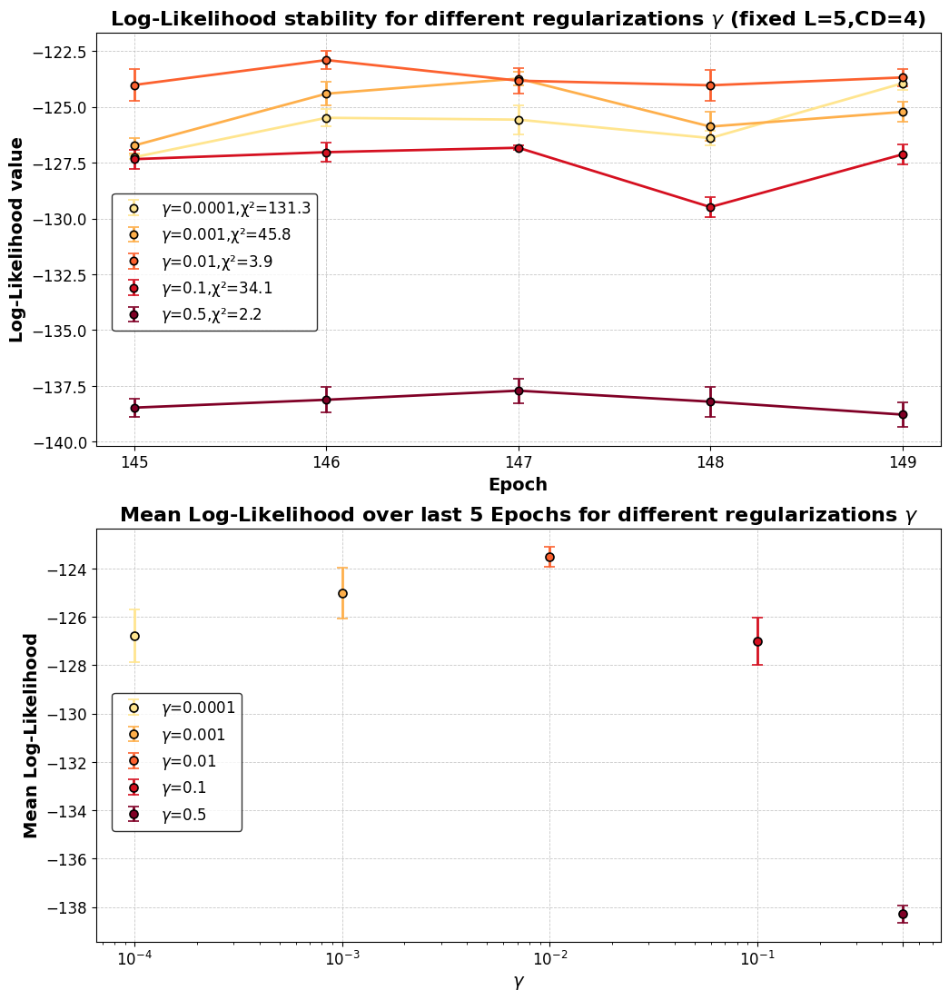

In [74]:
# variable gamma steps, fixed L=5 and CD steps=4
colors = plt.cm.YlOrRd(np.linspace(0.178, 1, len(log_like_gamma)))
Nepoch=150
num_epo=np.arange(Nepoch-5,Nepoch,1)

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,13))

for i, log_like in enumerate(log_like_gamma):
    weights = 1 / np.array(log_like_gamma_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(5))/log_like_gamma_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_gamma_std[i],fmt='o',color=colors[i],label=f'$\gamma$={gamma_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(gamma_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'$\gamma$={gamma_v[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    ax2.set_xscale('log')
   

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different regularizations $\gamma$ (fixed L=5,CD=4)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='center left', frameon=True, bbox_to_anchor=(0.01, 0.444), edgecolor='black')

ax2.set_xlabel('$\gamma$', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 5 Epochs for different regularizations $\gamma$', fontsize=16, fontweight='bold')
ax2.set_xticks(gamma_v)
#ax2.set_xticklabels([f'{tick:.1e}' for tick in gamma_v])
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='lower left', frameon=True, bbox_to_anchor=(0.01, 0.25), edgecolor='black')

file_path = 'GRAPHS/log_like_gammas_plot.png'  # Path where you want to save the figure
fig.savefig(file_path, dpi=300, bbox_inches='tight')  # Save the figure as a .png file with high resolution


plt.show()

## training with POTTS

In [30]:
###%autosave 0

Autosave disabled


Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

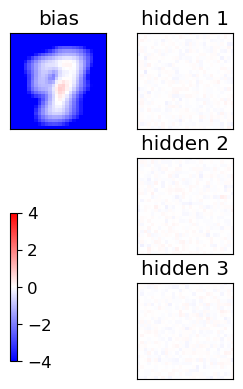

Starting the training, POTTS=True
[ 8326 12451  1601  9335 10142  8594   336  1931 13976  3031]
[ 9295  6178   313 14370  9612 15153 18435 15613 18013  1100]
[ 6670  8429 11483 12169  9907 10932  1787  1441   897 13853]
[ 9273  4402  5629 19051  5225 13262 21306  4494   931  6490]
epoch 1 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

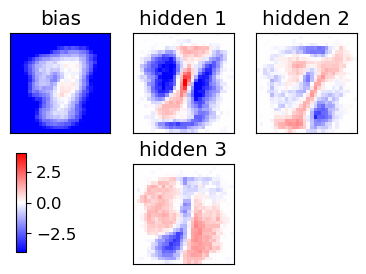

epoch 21 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

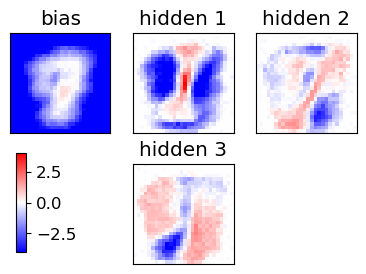

epoch 41 / 450  Nt: 4  N: 13  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

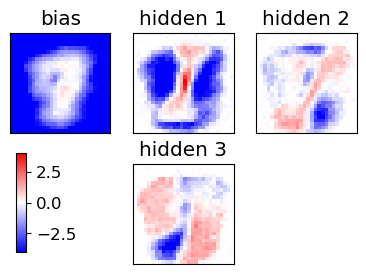

epoch 61 / 450  Nt: 4  N: 18  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

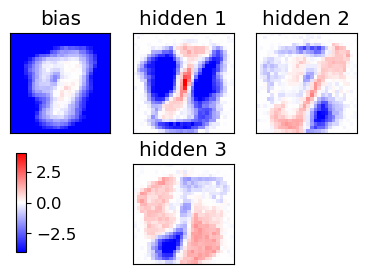

epoch 81 / 450  Nt: 4  N: 25  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

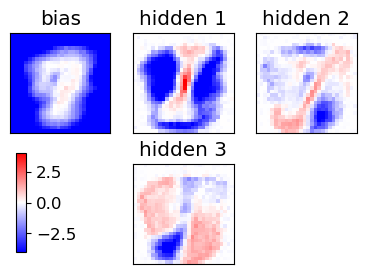

epoch 101 / 450  Nt: 4  N: 34  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

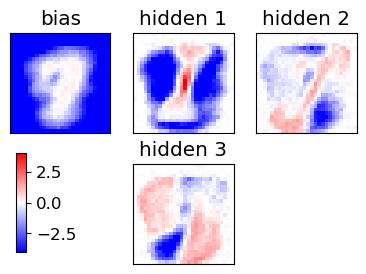

epoch 121 / 450  Nt: 4  N: 44  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

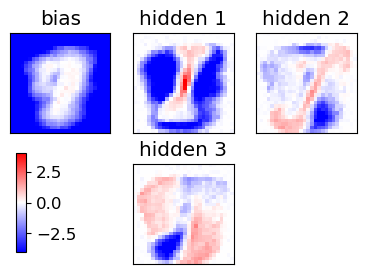

epoch 141 / 450  Nt: 4  N: 57  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

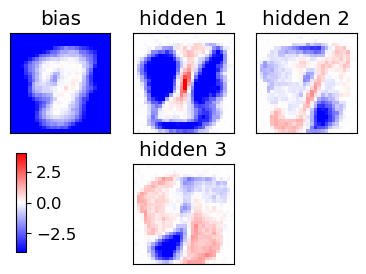

epoch 161 / 450  Nt: 4  N: 72  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

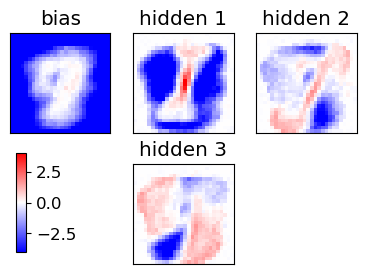

epoch 181 / 450  Nt: 4  N: 88  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

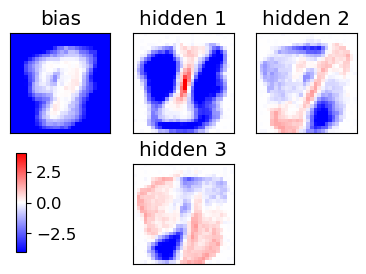

epoch 201 / 450  Nt: 4  N: 107  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

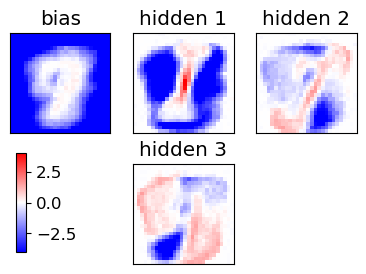

epoch 221 / 450  Nt: 4  N: 127  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

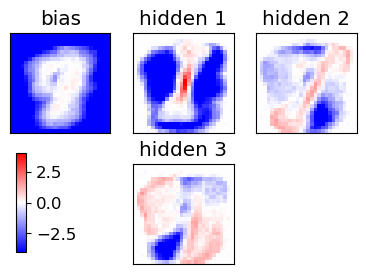

epoch 241 / 450  Nt: 4  N: 149  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

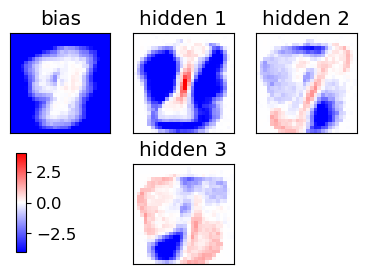

epoch 261 / 450  Nt: 4  N: 174  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

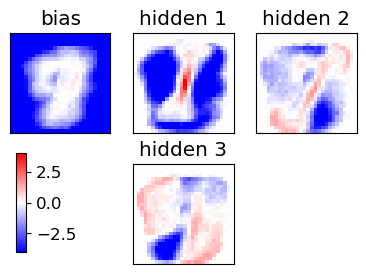

epoch 281 / 450  Nt: 4  N: 200  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

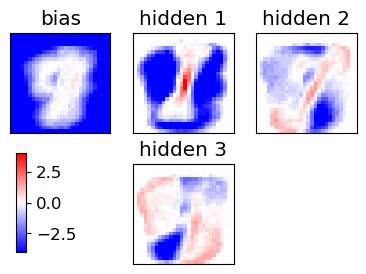

epoch 301 / 450  Nt: 4  N: 228  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

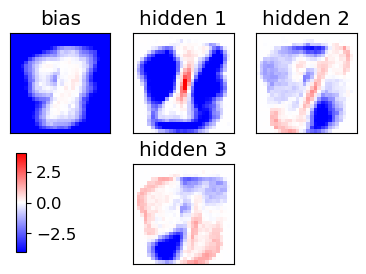

epoch 321 / 450  Nt: 4  N: 258  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

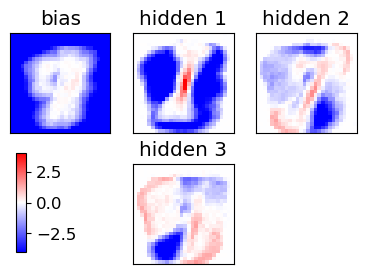

epoch 341 / 450  Nt: 4  N: 290  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

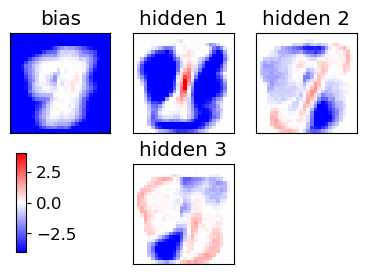

epoch 361 / 450  Nt: 4  N: 324  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

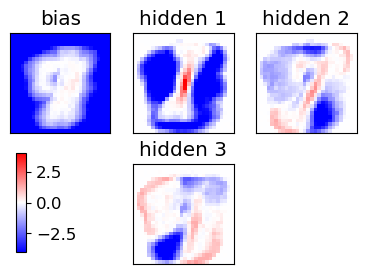

epoch 381 / 450  Nt: 4  N: 360  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

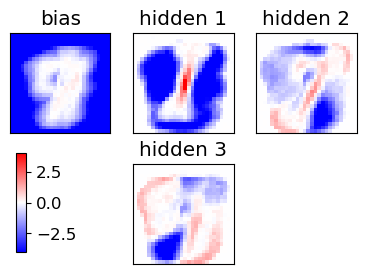

epoch 401 / 450  Nt: 4  N: 398  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

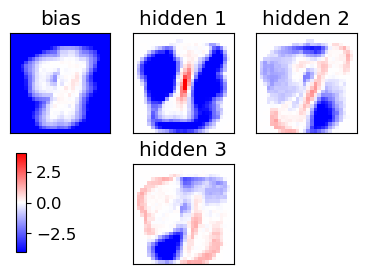

epoch 421 / 450  Nt: 4  N: 438  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

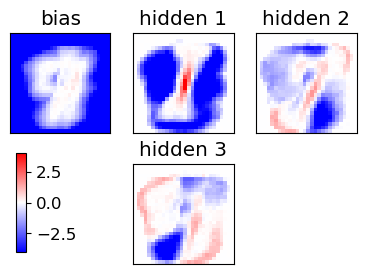

epoch 441 / 450  Nt: 4  N: 480  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

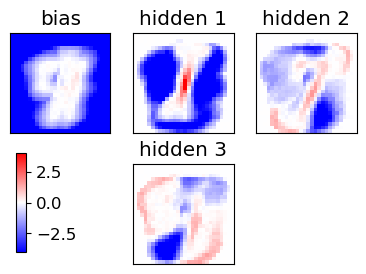

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

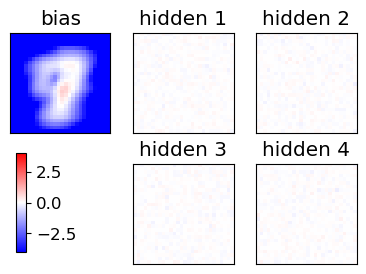

Starting the training, POTTS=True
[ 5514  6738 15824 17247 20892 17897  6931 12774  5732  3839]
[  274  6208 19299 11882  2498 13507 18102 14741  3245   295]
[19916 12972 14266  7980  2419   947  7655 18557  4260  7751]
[10758 16031  2542 21883  7131 20816  8061 12316 20819  6456]
epoch 1 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

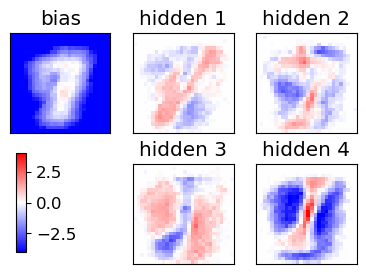

epoch 21 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

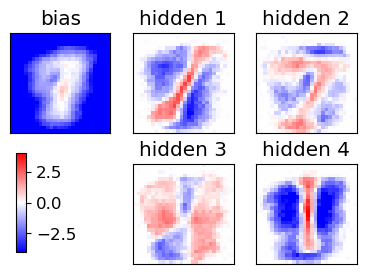

epoch 41 / 450  Nt: 4  N: 13  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

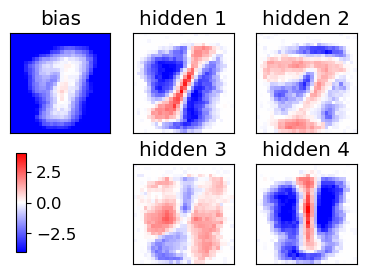

epoch 61 / 450  Nt: 4  N: 18  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

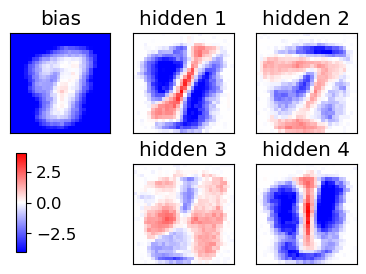

epoch 81 / 450  Nt: 4  N: 25  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

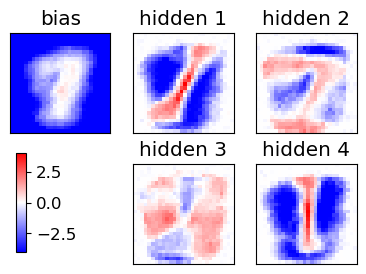

epoch 101 / 450  Nt: 4  N: 34  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

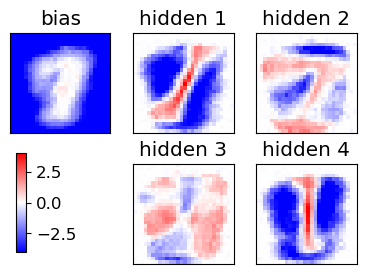

epoch 121 / 450  Nt: 4  N: 44  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

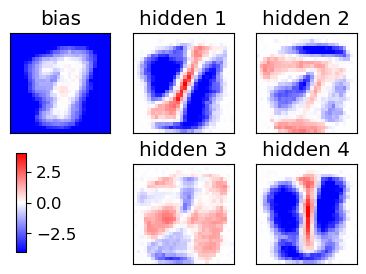

epoch 141 / 450  Nt: 4  N: 57  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

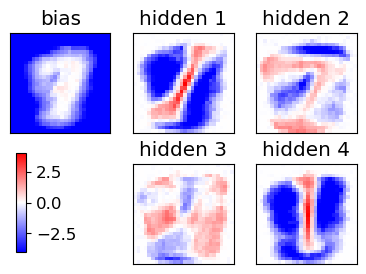

epoch 161 / 450  Nt: 4  N: 72  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

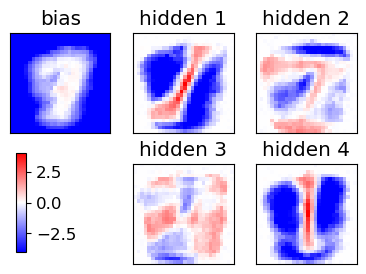

epoch 181 / 450  Nt: 4  N: 88  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

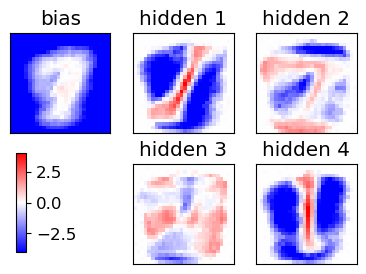

epoch 201 / 450  Nt: 4  N: 107  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

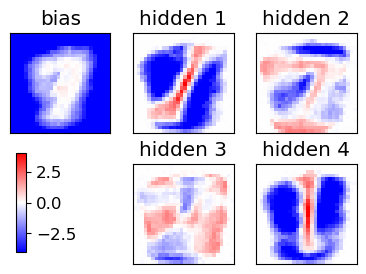

epoch 221 / 450  Nt: 4  N: 127  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

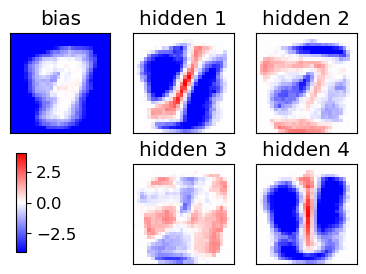

epoch 241 / 450  Nt: 4  N: 149  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

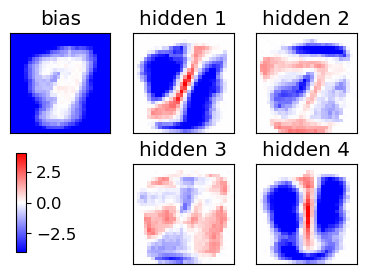

epoch 261 / 450  Nt: 4  N: 174  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

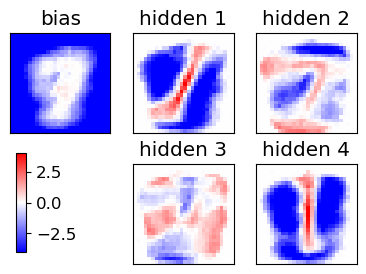

epoch 281 / 450  Nt: 4  N: 200  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

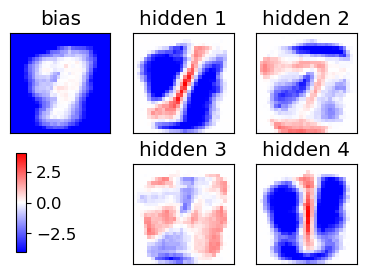

epoch 301 / 450  Nt: 4  N: 228  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

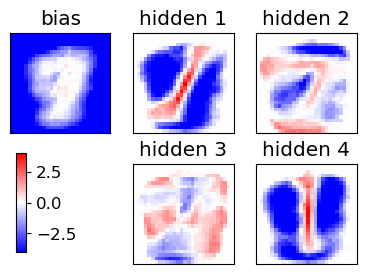

epoch 321 / 450  Nt: 4  N: 258  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

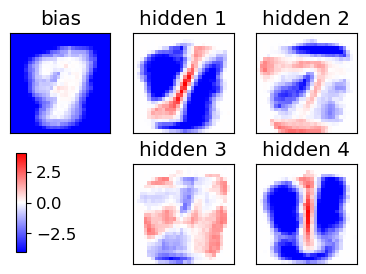

epoch 341 / 450  Nt: 4  N: 290  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

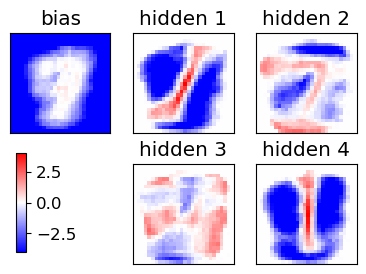

epoch 361 / 450  Nt: 4  N: 324  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

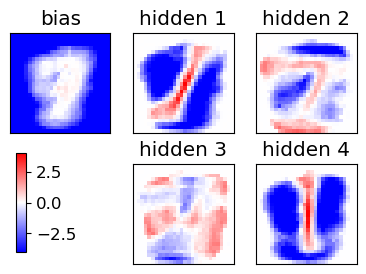

epoch 381 / 450  Nt: 4  N: 360  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

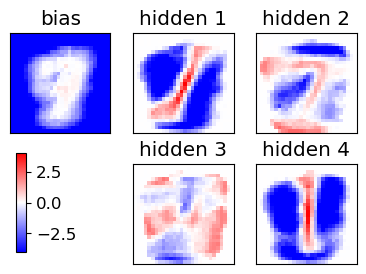

epoch 401 / 450  Nt: 4  N: 398  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

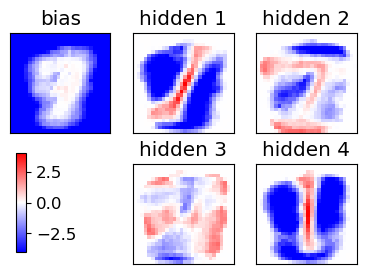

epoch 421 / 450  Nt: 4  N: 438  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

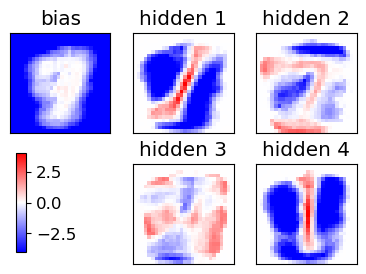

epoch 441 / 450  Nt: 4  N: 480  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

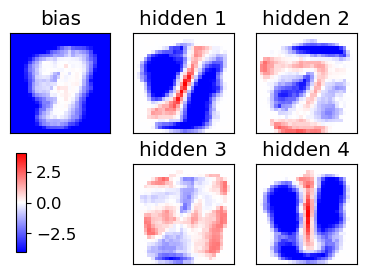

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

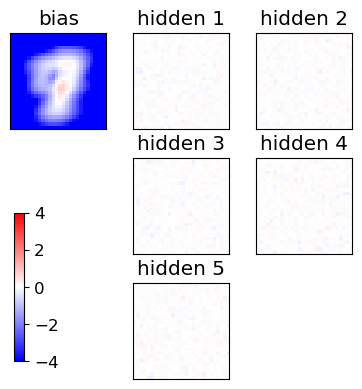

Starting the training, POTTS=True
[ 6428 12340  6676 12742  6730 20636 13320 14633 12204 10711]
[ 1499  7770  9336 10677 20735 18265  4369 21659  9371 15554]
[ 3983 18801  6283 10300 10350 14634  9950 17929 21234 17434]
[19914 13136 20188 14551 18756 17538 16922 13086  4999 16234]
epoch 1 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

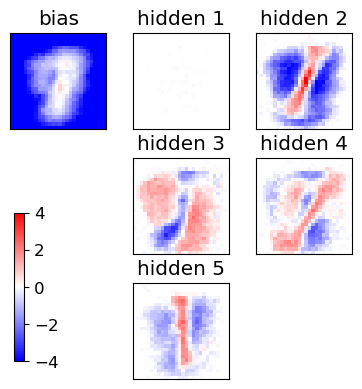

epoch 21 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

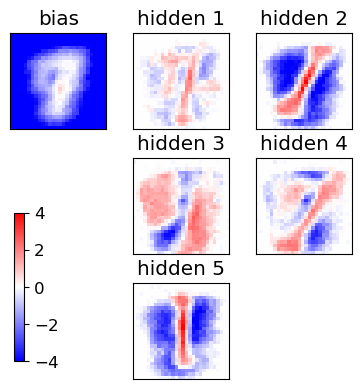

epoch 41 / 450  Nt: 4  N: 13  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

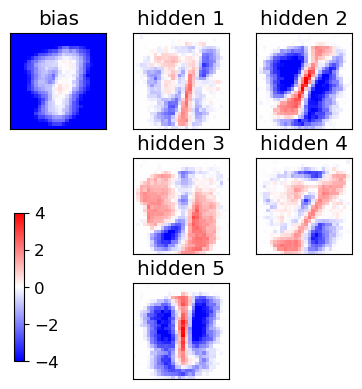

epoch 61 / 450  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

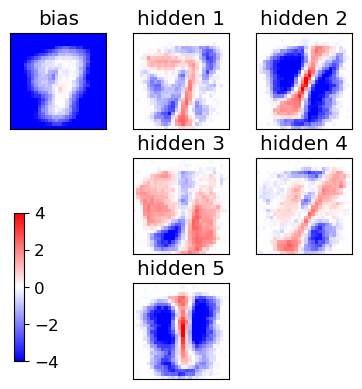

epoch 81 / 450  Nt: 4  N: 25  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

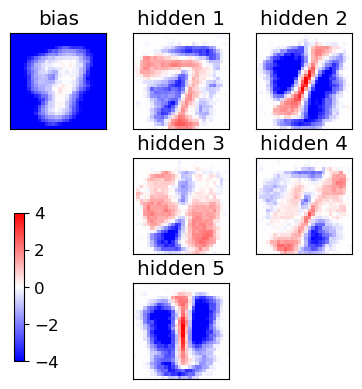

epoch 101 / 450  Nt: 4  N: 34  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

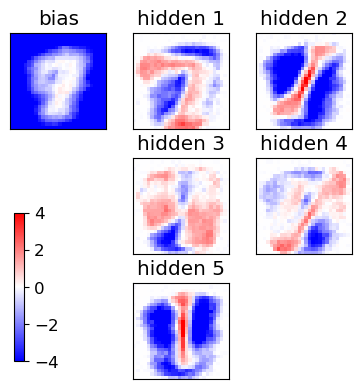

epoch 121 / 450  Nt: 4  N: 44  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

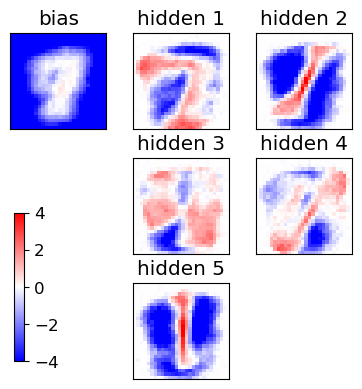

epoch 141 / 450  Nt: 4  N: 57  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

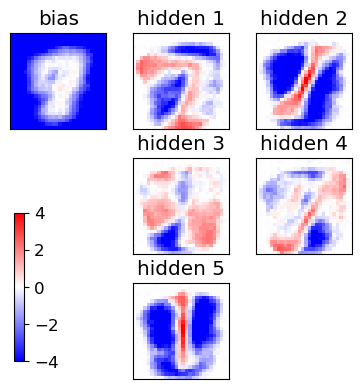

epoch 161 / 450  Nt: 4  N: 72  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

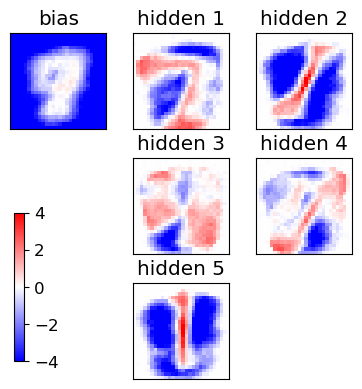

epoch 181 / 450  Nt: 4  N: 88  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

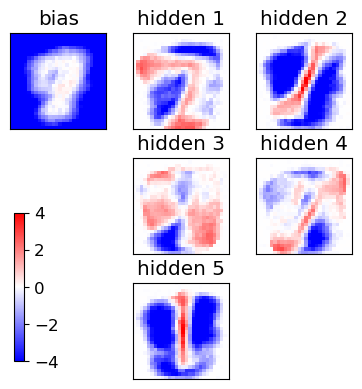

epoch 201 / 450  Nt: 4  N: 107  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

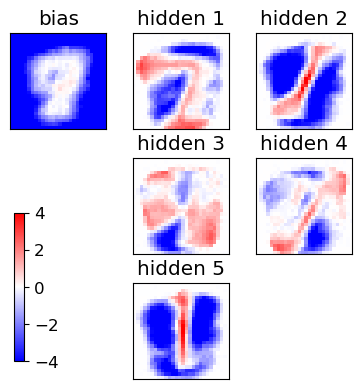

epoch 221 / 450  Nt: 4  N: 127  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

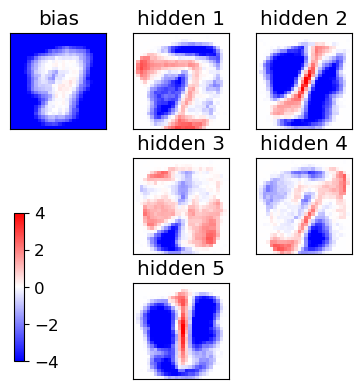

epoch 241 / 450  Nt: 4  N: 149  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

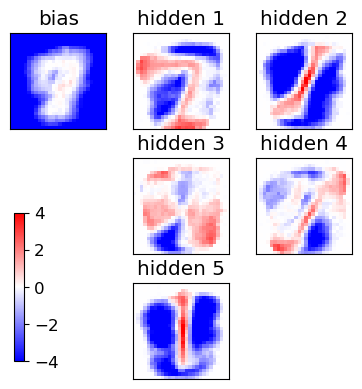

epoch 261 / 450  Nt: 4  N: 174  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

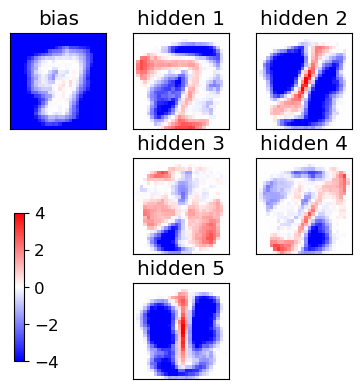

epoch 281 / 450  Nt: 4  N: 200  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

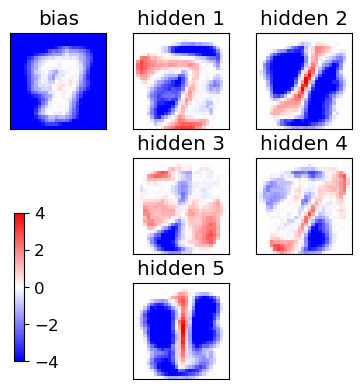

epoch 301 / 450  Nt: 4  N: 228  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

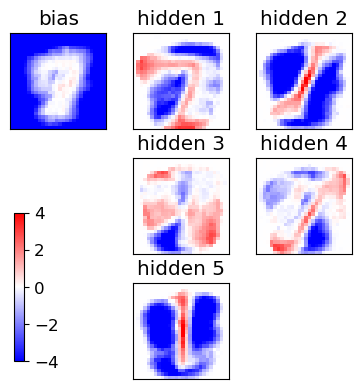

epoch 321 / 450  Nt: 4  N: 258  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

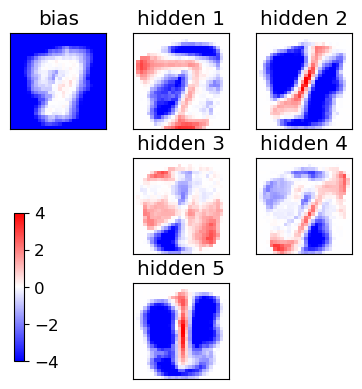

epoch 341 / 450  Nt: 4  N: 290  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

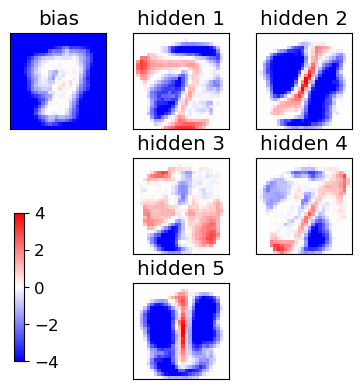

epoch 361 / 450  Nt: 4  N: 324  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

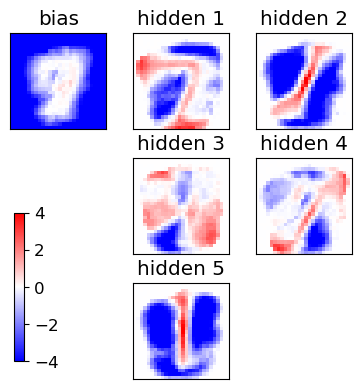

epoch 381 / 450  Nt: 4  N: 360  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

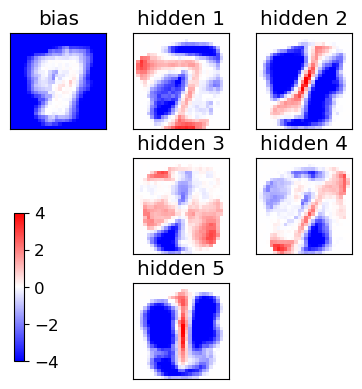

epoch 401 / 450  Nt: 4  N: 398  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

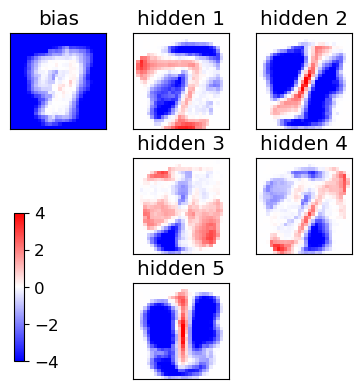

epoch 421 / 450  Nt: 4  N: 438  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

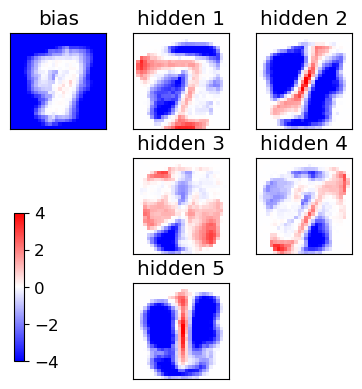

epoch 441 / 450  Nt: 4  N: 480  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

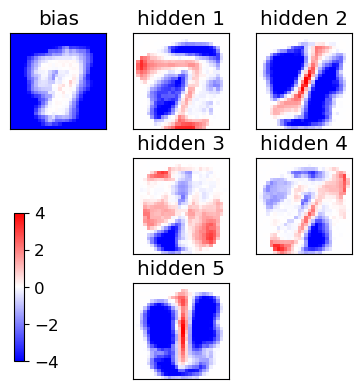

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

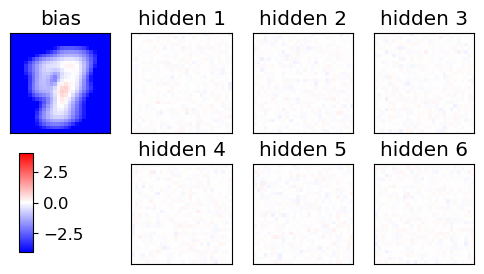

Starting the training, POTTS=True
[ 4581  7677  7655 11451  9261 18602 17191 16154  1883 11746]
[ 9110  3096  6820 11265 16615  2999  4315  4597 20355  7839]
[ 5722  7547  7157  1527   346 12486  4428 14594 19353 11247]
[ 5224 16739 12277 21874 11832  6583 13634  8801  9742  2885]
epoch 1 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

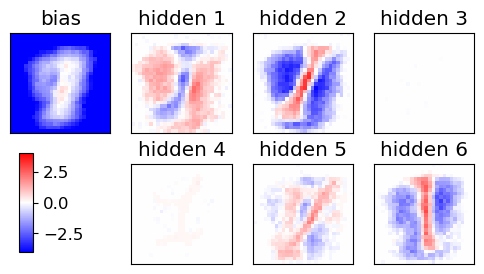

epoch 21 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

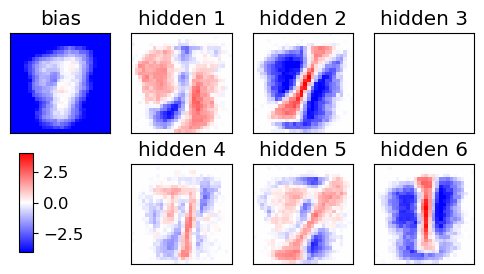

epoch 41 / 450  Nt: 4  N: 13  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

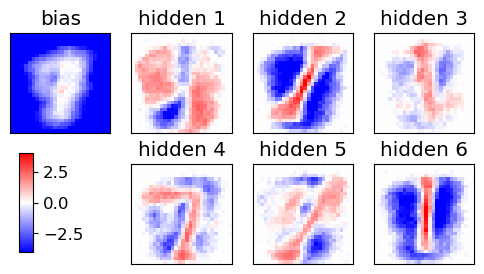

epoch 61 / 450  Nt: 4  N: 18  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

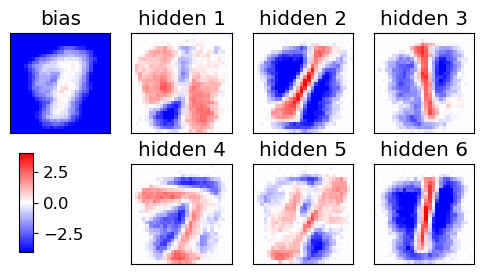

epoch 81 / 450  Nt: 4  N: 25  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

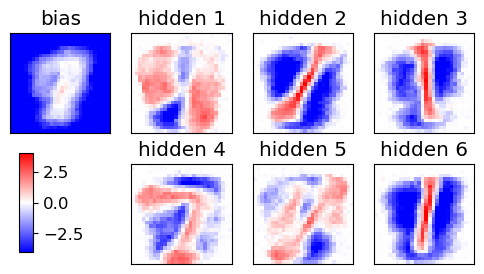

epoch 101 / 450  Nt: 4  N: 34  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

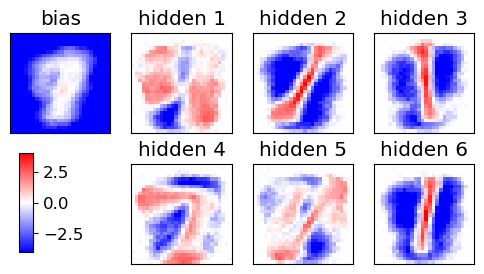

epoch 121 / 450  Nt: 4  N: 44  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

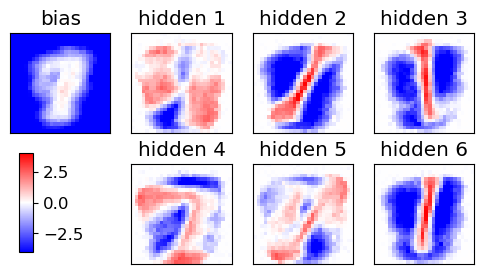

epoch 141 / 450  Nt: 4  N: 57  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

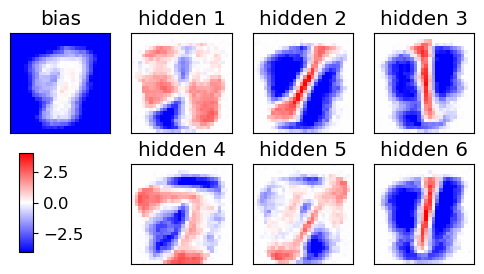

epoch 161 / 450  Nt: 4  N: 72  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

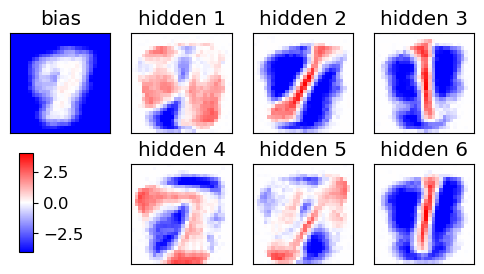

epoch 181 / 450  Nt: 4  N: 88  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

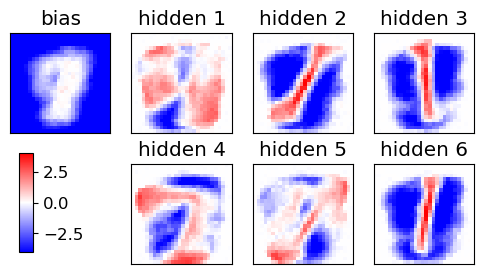

epoch 201 / 450  Nt: 4  N: 107  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

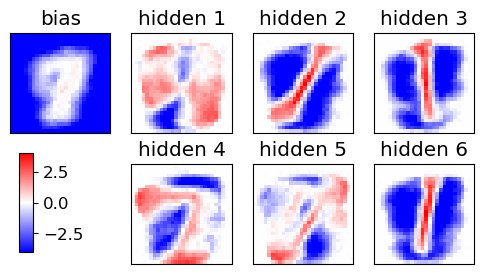

epoch 221 / 450  Nt: 4  N: 127  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

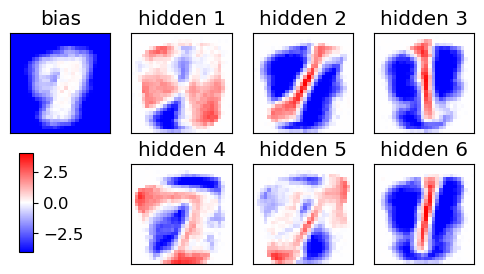

epoch 241 / 450  Nt: 4  N: 149  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

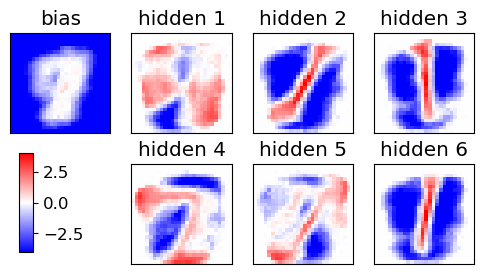

epoch 261 / 450  Nt: 4  N: 174  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

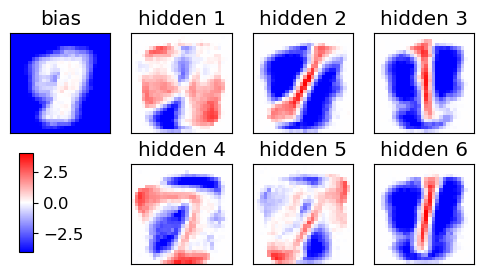

epoch 281 / 450  Nt: 4  N: 200  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

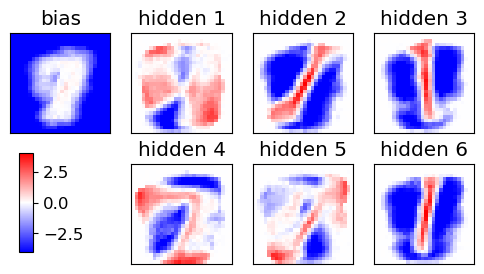

epoch 301 / 450  Nt: 4  N: 228  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

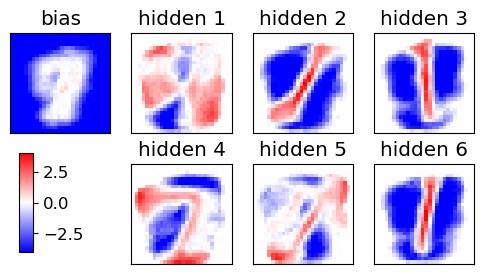

epoch 321 / 450  Nt: 4  N: 258  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

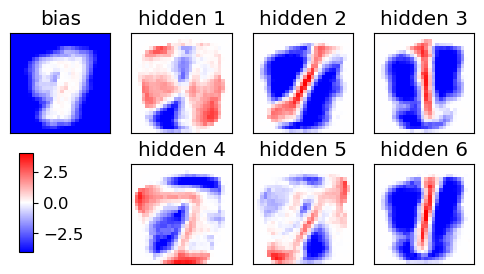

epoch 341 / 450  Nt: 4  N: 290  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

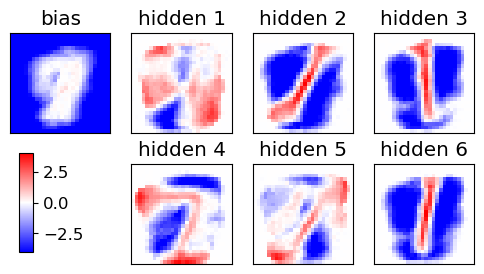

epoch 361 / 450  Nt: 4  N: 324  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

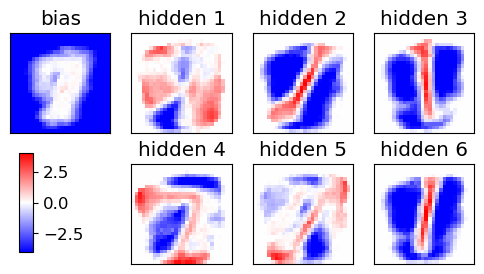

epoch 381 / 450  Nt: 4  N: 360  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

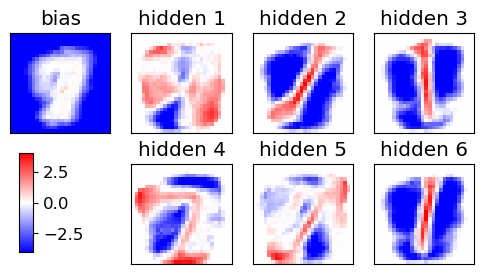

epoch 401 / 450  Nt: 4  N: 398  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

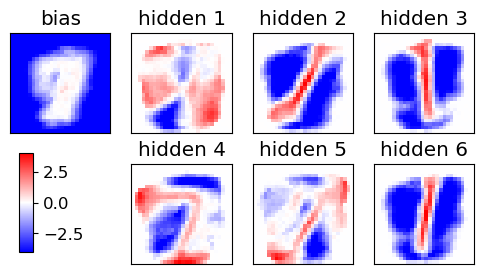

epoch 421 / 450  Nt: 4  N: 438  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

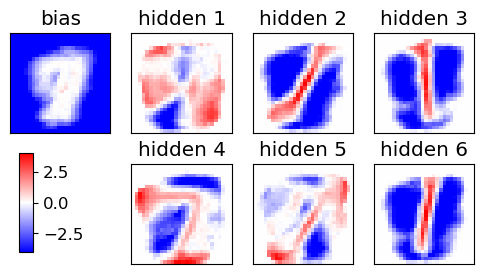

epoch 441 / 450  Nt: 4  N: 480  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

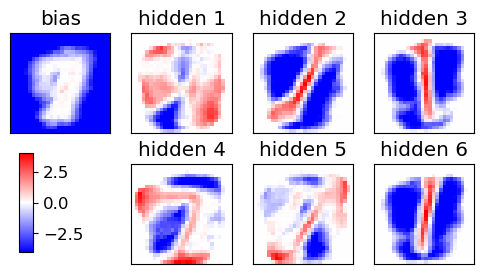

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

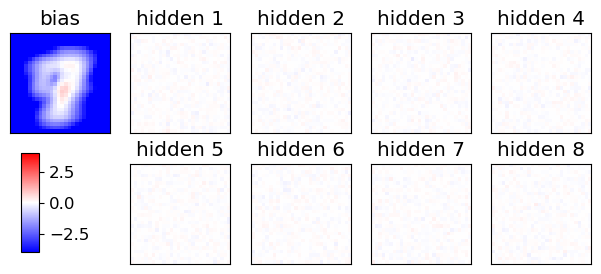

Starting the training, POTTS=True
[11846 19255   670 14978 13771 19322  6080 21876 20102  1334]
[  115 21656 17753  4770  9761 11435 15045 13373 15351  1341]
[11097 12326 20981  9282  4501 18917 16942 21952 13648 15396]
[  774  4146  8013 17979  6406 19162 16411 10355 15939  9116]
epoch 1 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

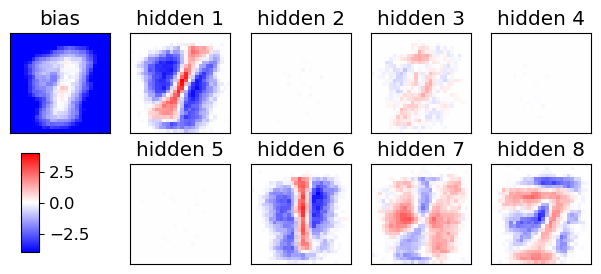

epoch 21 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

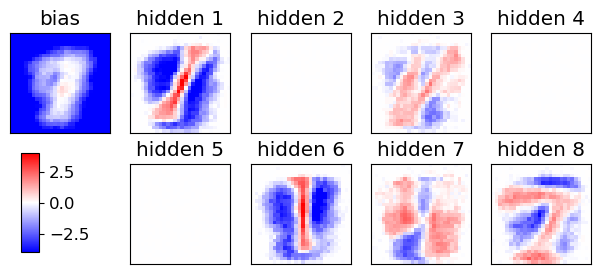

epoch 41 / 450  Nt: 4  N: 13  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

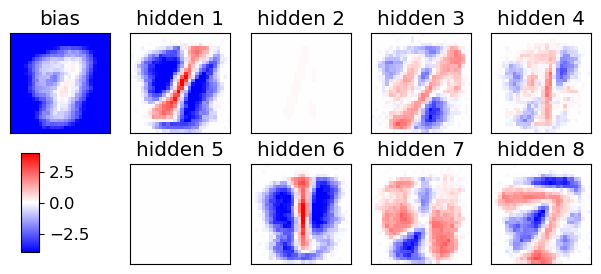

epoch 61 / 450  Nt: 4  N: 18  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

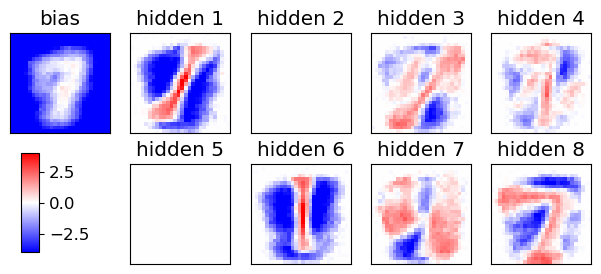

epoch 81 / 450  Nt: 4  N: 25  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

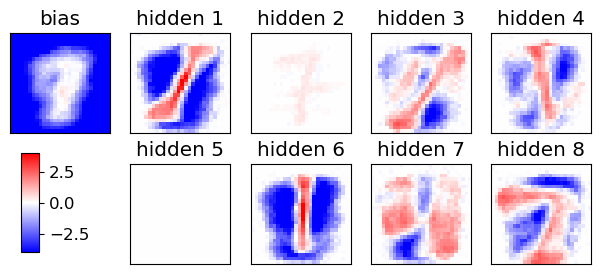

epoch 101 / 450  Nt: 4  N: 34  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

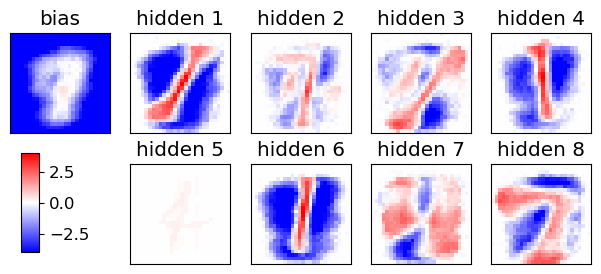

epoch 121 / 450  Nt: 4  N: 44  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

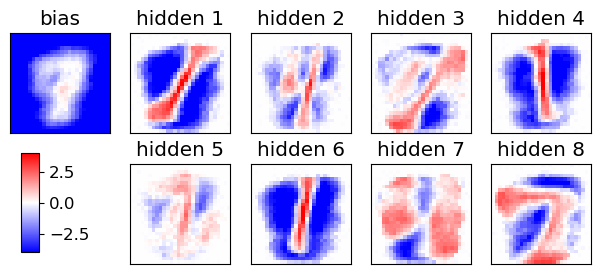

epoch 141 / 450  Nt: 4  N: 57  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

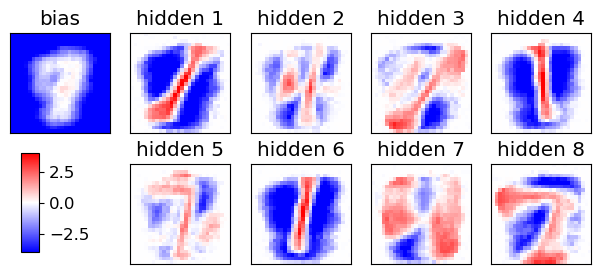

epoch 161 / 450  Nt: 4  N: 72  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

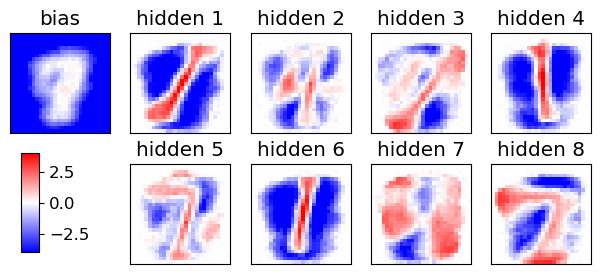

epoch 181 / 450  Nt: 4  N: 88  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

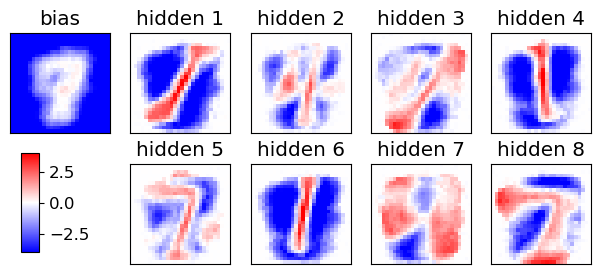

epoch 201 / 450  Nt: 4  N: 107  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

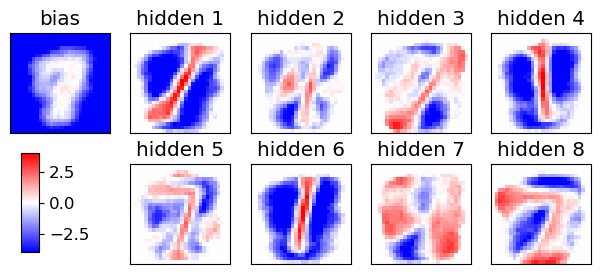

epoch 221 / 450  Nt: 4  N: 127  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

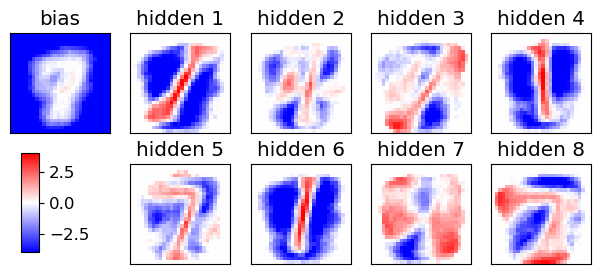

epoch 241 / 450  Nt: 4  N: 149  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

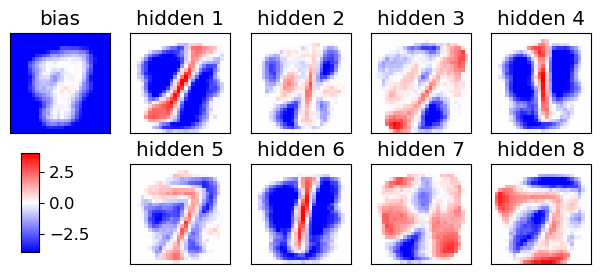

epoch 261 / 450  Nt: 4  N: 174  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

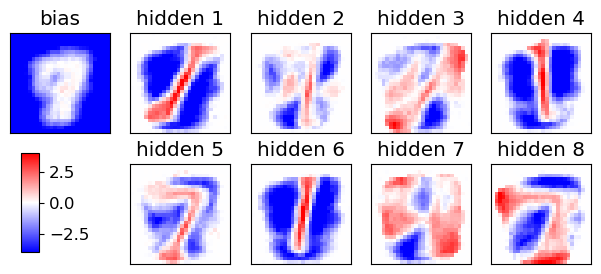

epoch 281 / 450  Nt: 4  N: 200  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

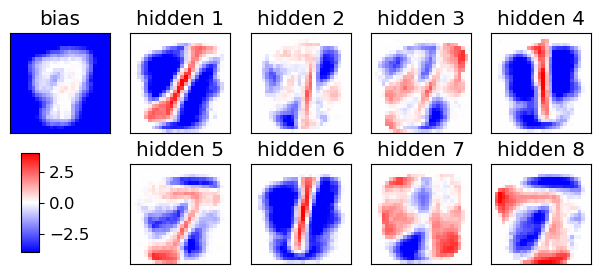

epoch 301 / 450  Nt: 4  N: 228  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

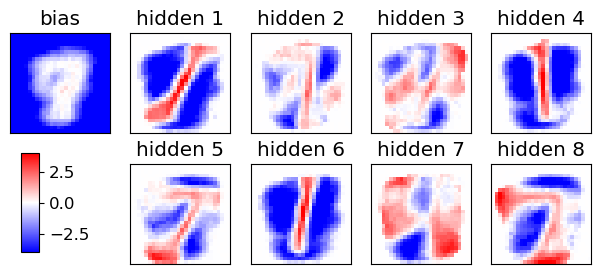

epoch 321 / 450  Nt: 4  N: 258  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

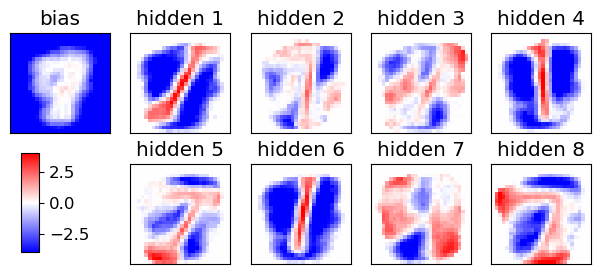

epoch 341 / 450  Nt: 4  N: 290  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

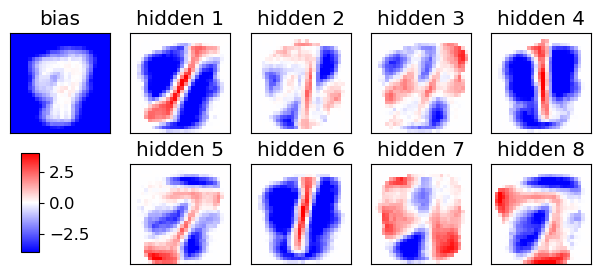

epoch 361 / 450  Nt: 4  N: 324  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

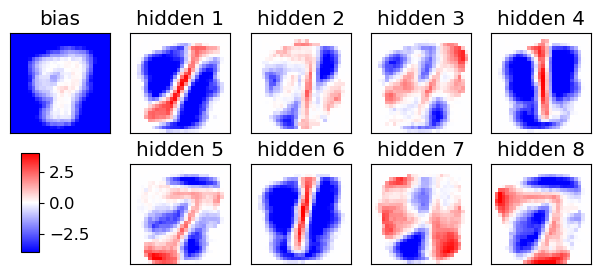

epoch 381 / 450  Nt: 4  N: 360  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

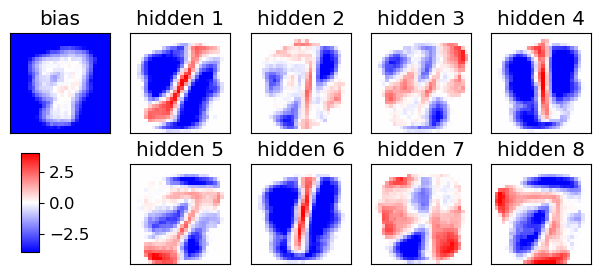

epoch 401 / 450  Nt: 4  N: 398  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

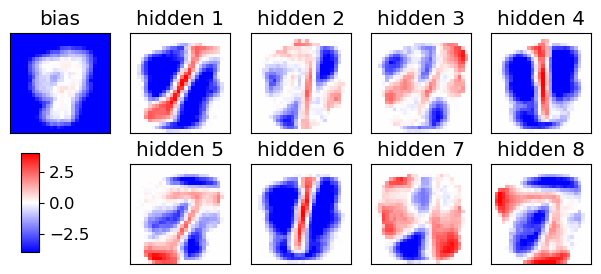

epoch 421 / 450  Nt: 4  N: 438  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

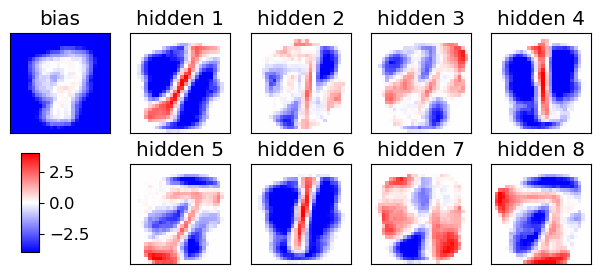

epoch 441 / 450  Nt: 4  N: 480  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

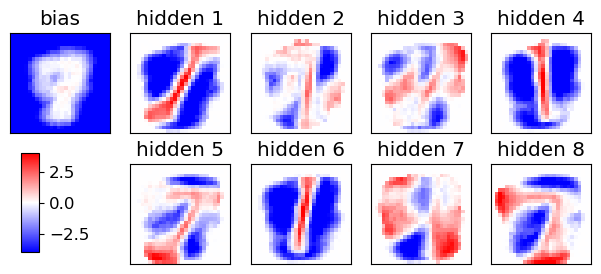

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

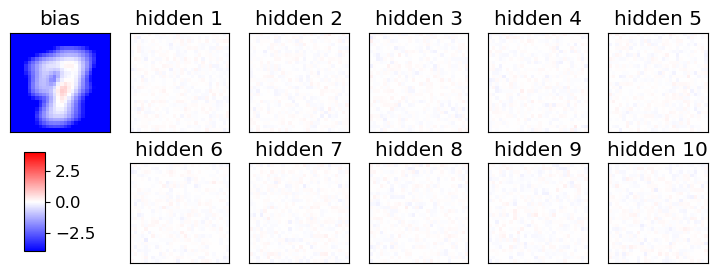

Starting the training, POTTS=True
[ 5134  4137 10674 17701 18937 20823 17763 15946 13635  8566]
[17152  8805 12479 20164 19970  3670 17454  1874 18919 10925]
[19116 20397 20822 10510  5081  4239 16952  5969  8742  1692]
[10881  6824 18691  5144 20497  3428  8915  6987 10769   149]
epoch 1 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

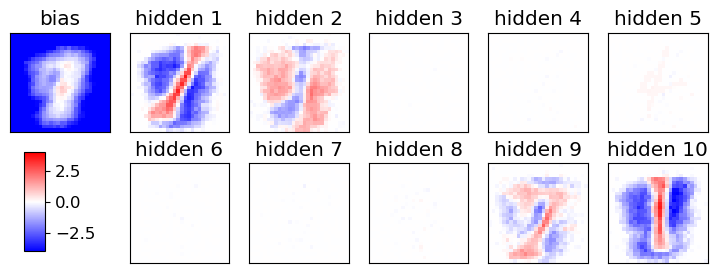

epoch 21 / 450  Nt: 4  N: 10  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

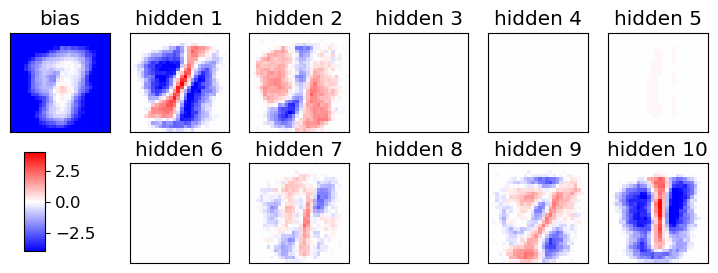

epoch 41 / 450  Nt: 4  N: 13  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

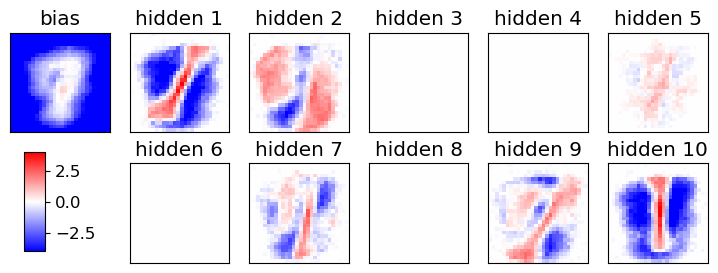

epoch 61 / 450  Nt: 4  N: 18  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

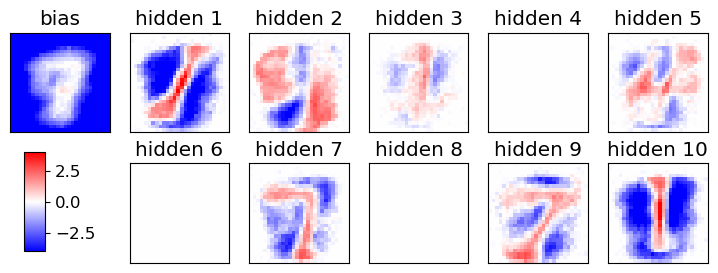

epoch 81 / 450  Nt: 4  N: 25  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

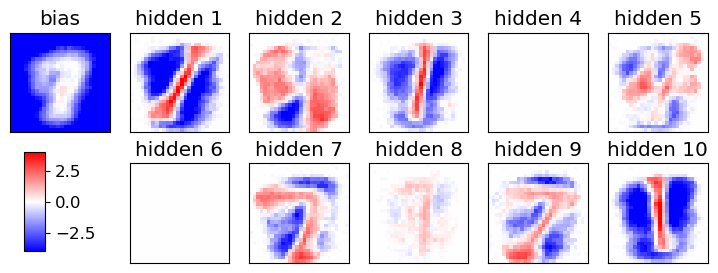

epoch 101 / 450  Nt: 4  N: 34  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 10  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

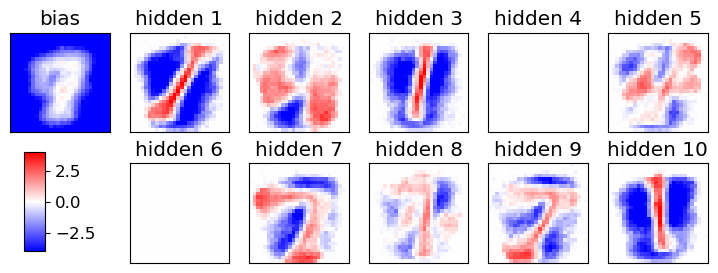

epoch 121 / 450  Nt: 4  N: 44  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 10  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

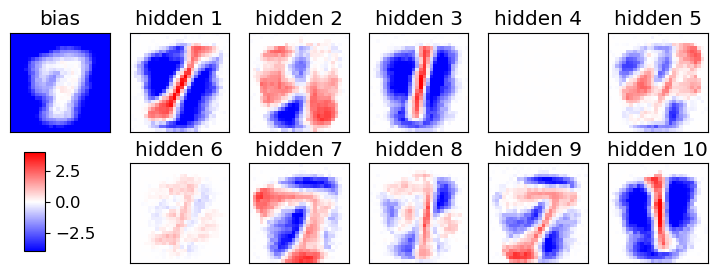

epoch 141 / 450  Nt: 4  N: 57  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 10  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

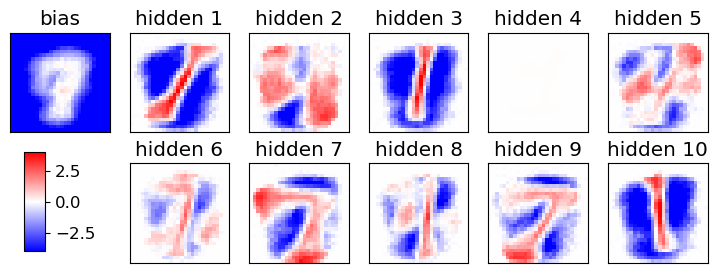

epoch 161 / 450  Nt: 4  N: 72  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 10  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

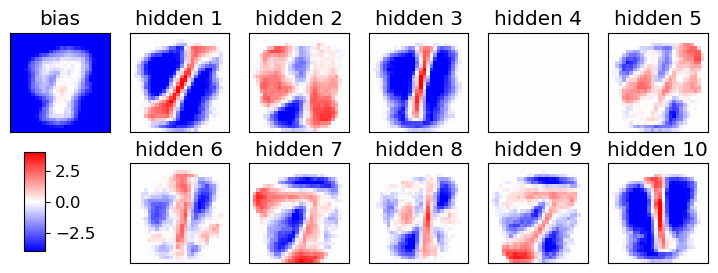

epoch 181 / 450  Nt: 4  N: 88  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 10  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

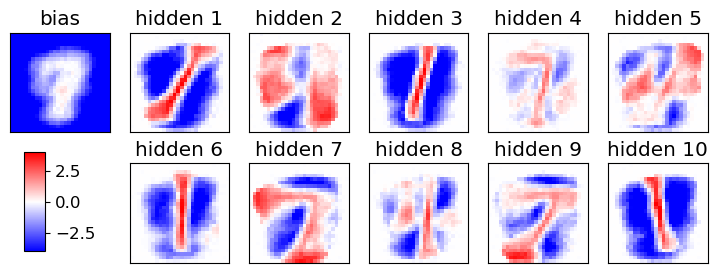

epoch 201 / 450  Nt: 4  N: 107  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

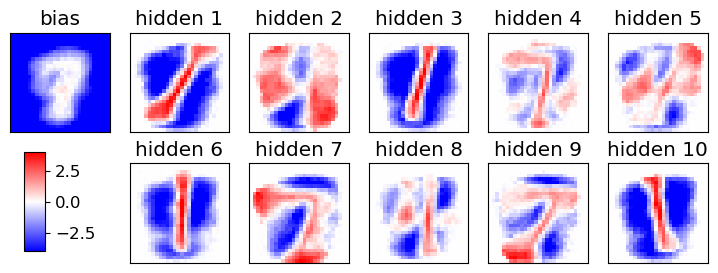

epoch 221 / 450  Nt: 4  N: 127  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

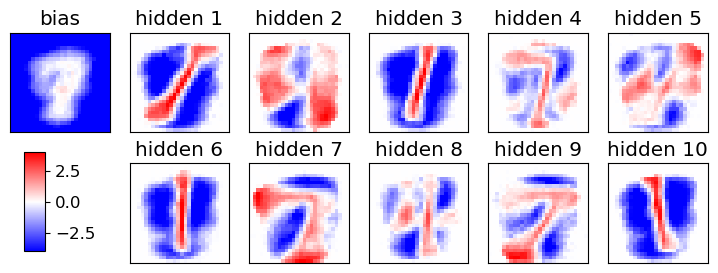

epoch 241 / 450  Nt: 4  N: 149  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

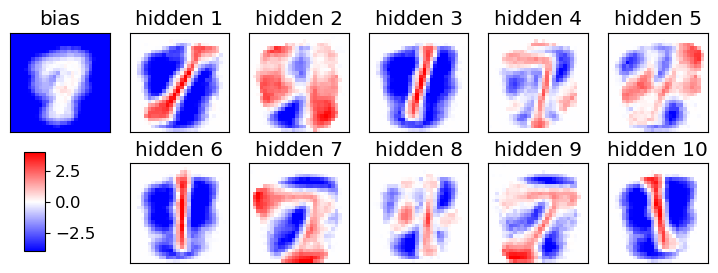

epoch 261 / 450  Nt: 4  N: 174  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

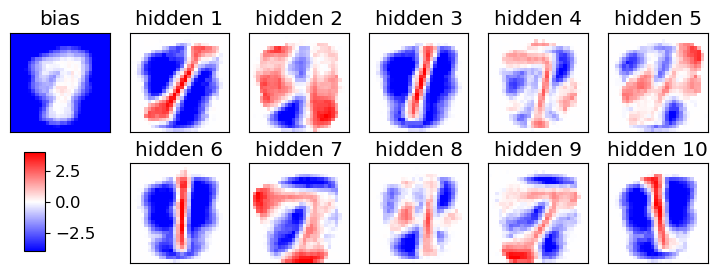

epoch 281 / 450  Nt: 4  N: 200  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

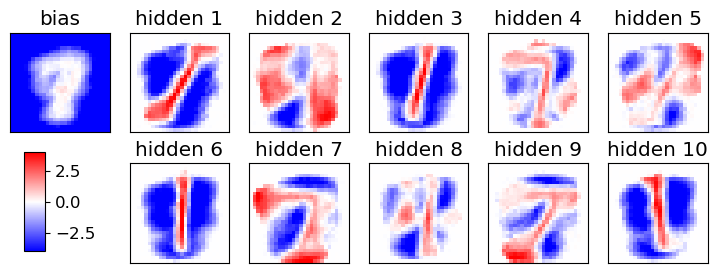

epoch 301 / 450  Nt: 4  N: 228  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

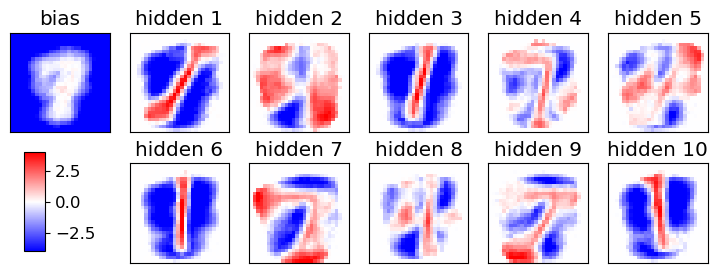

epoch 321 / 450  Nt: 4  N: 258  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

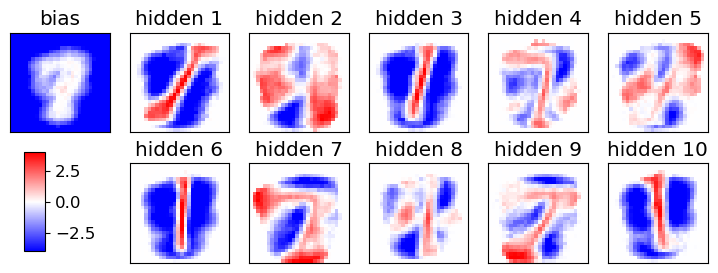

epoch 341 / 450  Nt: 4  N: 290  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

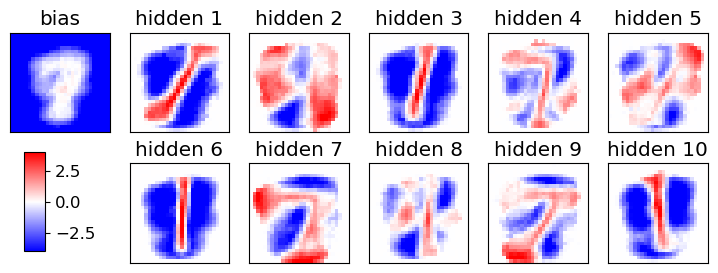

epoch 361 / 450  Nt: 4  N: 324  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

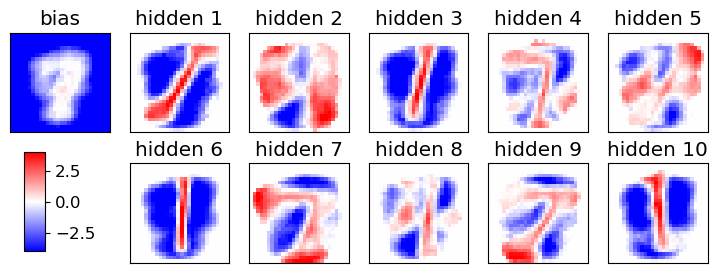

epoch 381 / 450  Nt: 4  N: 360  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

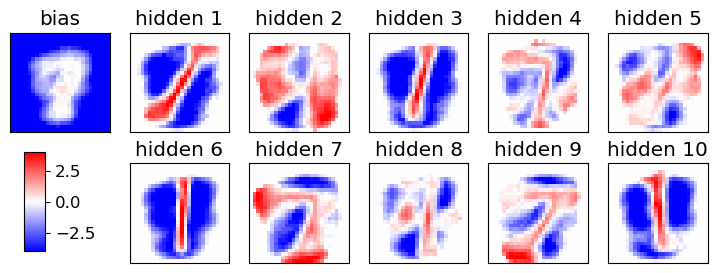

epoch 401 / 450  Nt: 4  N: 398  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

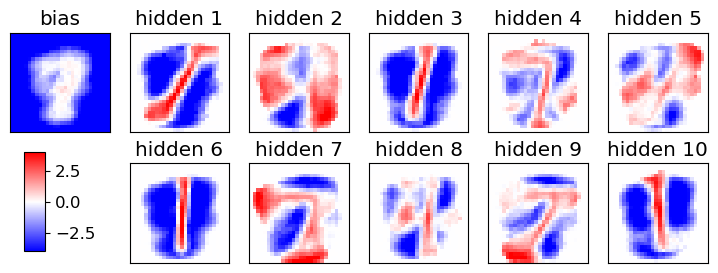

epoch 421 / 450  Nt: 4  N: 438  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 10  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

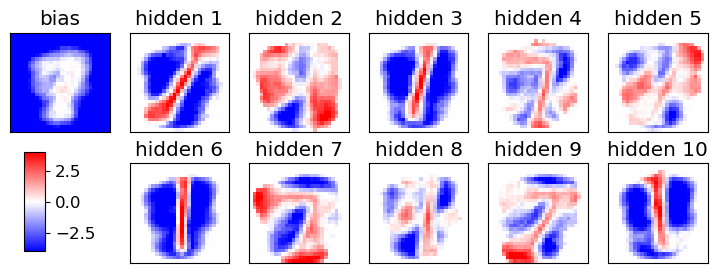

epoch 441 / 450  Nt: 4  N: 480  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 10  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

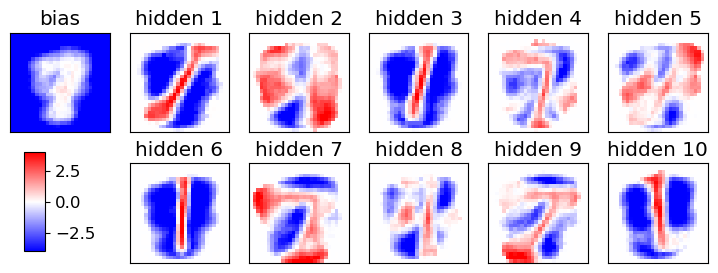

END of learning phase


In [31]:
L_v=[3,4,5,6,8,10] ##Nt=4,
gamma=0.01
POTTS=True

for L in L_v:
    if POTTS:
        str_simul="RBM_Potts"
        # in one-hot encoding, number of possible hidden states matches L
        Nz=L
    else:
        str_simul="RBM"
        # number of possible hidden states: 2**L
        Nz=2**L
    
    # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
    w = sigma * np.random.randn(D,L)
    #a = sigma * np.random.randn(D)
    # using Hinton initialization of visible biases
    a = Hinton_bias_init(data)
    # hidden biases initialized to zero
    b = np.zeros(L)
    #print("w=",w);print("a=",a);print("b=",b)
    # nr of epochs
    Nepoch=450
    # minibatches per epoch
    Nmini=20
    # minibatch size at initial epoch and final one
    N_ini,N_fin=10,500
    print(f"Nepoch={Nepoch}\nNmini={Nmini}")
    # number of CD steps
    Nt=4
    # recording history of weights ("E" means epoch)
    wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
    wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
    gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
    gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
    gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
    miniE = np.zeros(Nepoch+1)
    pzE=np.zeros((Nepoch+1,Nz))
    if GRAD=="RMSprop":
        gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)
    indices=np.arange(Nd).astype("int")
    plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)
    # for the plot with panels
    Ncols=min(8,max(2,L//2))
    if POTTS: print("Starting the training, POTTS=True")
    else: print("Starting the training")
    # Note: here an epoch does not analyze the whole dataset
    for epoch in range(1,1+Nepoch):
        # q maps epochs to interval [0,1]
        q = (epoch-1.)/(Nepoch-1.)
        # N, size of the mini batch
        # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
        N = int(N_ini + (N_fin-N_ini)*(q**2))
        #  l_rate interpolates between initial and final value
        l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q
        for mini in range(Nmini):
            # initializitation for averages in minibatch
            # visible variables "v" --> "x"
            #  hidden variables "h" --> "z"
            x_data, x_model = np.zeros(D),np.zeros(D)
            z_data, z_model = np.zeros(L),np.zeros(L)
            xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
            pz = np.zeros(L)
            # Minibatch of size N: points randomply picked (without repetition) from data
            selected = np.random.choice(indices,N,replace=False)
            if epoch==1 and mini<=3: print(selected)
            for k in range(N):
                ###################################
                x0 = data[selected[k]]
                # positive CD phase: generating z from x[k]
                z = CD_step(x0,w,b,POTTS=POTTS)
                x_data  += x0
                z_data  += z
                xz_data += np.outer(x0,z)
                # fantasy
                zf=np.copy(z)
                # Contrastive divergence with Nt steps
                for t in range(Nt):
                    # negative CD pzase: generating fantasy xf from fantasy zf
                    xf = CD_step(zf,w.T,a)
                    # positive CD phase: generating fantasy zf from fantasy xf
                    zf = CD_step(xf,w,b,POTTS=POTTS)
                x_model += xf
                z_model += zf
                xz_model+= np.outer(xf,zf)
                # recording probability of encoding in z-space, if POTTS
                if POTTS: pz[zf]+=1
                ###################################
            # gradient of the likelihood: follow it along its positive direction
            gw_d,gw_m = xz_data/N, xz_model/N
            ga_d,ga_m = x_data/N, x_model/N
            gb_d,gb_m = z_data/N, z_model/N
            gw=np.copy(gw_d - gw_m)
            ga=np.copy(ga_d - ga_m)
            gb=np.copy(gb_d - gb_m)
            # gradient ascent step
            if GRAD=="RMSprop":
                # RMSprop gradient ascent
                gw2 = beta*gw2+(1-beta)*np.square(gw)
                ga2 = beta*ga2+(1-beta)*np.square(ga)
                gb2 = beta*gb2+(1-beta)*np.square(gb)
                w += l_rate*gw/sqrt(epsilon+gw2)
                a += l_rate*ga/sqrt(epsilon+ga2)
                b += l_rate*gb/sqrt(epsilon+gb2)
            else:
                # defaulting to the vanilla stochastic gradient ascent (SGD)
                w += l_rate*gw
                a += l_rate*ga
                b += l_rate*gb
            # regularization (LASSO)
            if gamma>0.:
                w -= (gamma*l_rate)*sign(w)
                a -= (gamma*l_rate)*sign(a)
                b -= (gamma*l_rate)*sign(b)
        wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
        aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
        bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
        miniE[epoch]=N
        if POTTS: pzE[epoch] = pz/np.sum(pz)
        print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
              " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)
        if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
            plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)
        str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
    save_epochs(wE,"w")
    save_epochs(bE,"b")
    save_epochs(aE,"a")
    print("END of learning phase")


In [32]:
L_v=[3,4, 5,6,8,10] ##Nt=4,
gamma=0.01
POTTS=True

log_like_potts=[]
for L in L_v:
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    num_epo=[]
    Nepoch=450
    n=5  ### take 1/5 of the epoch
    for i in range(Nepoch):
        if i%n==0:
            print(f'Epoch n.{i}')
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            log_like.append(ll)
            num_epo.append(i)
            print('Log-likelihood=',ll)
    log_like_potts.append(log_like)


a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2627.12it/s]


Log-likelihood= -166.91599240650964
Epoch n.5


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12727.57it/s]


Log-likelihood= -149.87264260367095
Epoch n.10


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12790.61it/s]


Log-likelihood= -153.21565052400607
Epoch n.15


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12432.87it/s]


Log-likelihood= -149.4376726004234
Epoch n.20


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12596.11it/s]


Log-likelihood= -149.38538556968166
Epoch n.25


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12711.34it/s]


Log-likelihood= -153.71828346416066
Epoch n.30


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 11855.19it/s]


Log-likelihood= -151.46997375665066
Epoch n.35


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12843.88it/s]


Log-likelihood= -149.4226782748461
Epoch n.40


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12679.26it/s]


Log-likelihood= -153.85816132922798
Epoch n.45


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12666.32it/s]


Log-likelihood= -149.2755292139087
Epoch n.50


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12905.39it/s]


Log-likelihood= -148.27847184985464
Epoch n.55


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12940.41it/s]


Log-likelihood= -151.38716839708724
Epoch n.60


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12958.21it/s]


Log-likelihood= -149.82912333975867
Epoch n.65


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12575.12it/s]


Log-likelihood= -152.0697335168128
Epoch n.70


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12732.62it/s]


Log-likelihood= -151.57081202167896
Epoch n.75


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12390.87it/s]


Log-likelihood= -148.1703486886922
Epoch n.80


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12992.51it/s]


Log-likelihood= -154.7334905262013
Epoch n.85


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12976.14it/s]


Log-likelihood= -151.8506405114581
Epoch n.90


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12769.12it/s]


Log-likelihood= -149.13677024425735
Epoch n.95


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12981.54it/s]


Log-likelihood= -150.6429517310738
Epoch n.100


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12838.01it/s]


Log-likelihood= -150.5845799001828
Epoch n.105


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12902.60it/s]


Log-likelihood= -152.06573752154287
Epoch n.110


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12872.84it/s]


Log-likelihood= -149.30590231597847
Epoch n.115


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12629.75it/s]


Log-likelihood= -149.78625072466326
Epoch n.120


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12826.56it/s]


Log-likelihood= -149.51615827250993
Epoch n.125


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12560.42it/s]


Log-likelihood= -148.73348511445545
Epoch n.130


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12119.09it/s]


Log-likelihood= -150.14696586917614
Epoch n.135


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12326.05it/s]


Log-likelihood= -150.44502311384775
Epoch n.140


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12909.78it/s]


Log-likelihood= -148.3078999422338
Epoch n.145


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12127.17it/s]


Log-likelihood= -148.3394136551056
Epoch n.150


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12092.33it/s]


Log-likelihood= -147.44613920250174
Epoch n.155


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12800.99it/s]


Log-likelihood= -149.43777910407607
Epoch n.160


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12274.08it/s]


Log-likelihood= -150.36198067427725
Epoch n.165


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12657.77it/s]


Log-likelihood= -148.92442916481474
Epoch n.170


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12368.90it/s]


Log-likelihood= -148.87064923914352
Epoch n.175


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13022.09it/s]


Log-likelihood= -150.1694645468806
Epoch n.180


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12971.74it/s]


Log-likelihood= -151.02484437088182
Epoch n.185


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12893.75it/s]


Log-likelihood= -150.68708726762023
Epoch n.190


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12330.73it/s]


Log-likelihood= -147.36383349084616
Epoch n.195


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 11920.00it/s]


Log-likelihood= -148.3933090854876
Epoch n.200


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12790.41it/s]


Log-likelihood= -149.98213443204756
Epoch n.205


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13038.88it/s]


Log-likelihood= -149.57490474727652
Epoch n.210


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13025.07it/s]


Log-likelihood= -147.99749693043924
Epoch n.215


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12541.20it/s]


Log-likelihood= -148.6407000355923
Epoch n.220


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12002.51it/s]


Log-likelihood= -150.50135421907962
Epoch n.225


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12066.12it/s]


Log-likelihood= -149.4617691121032
Epoch n.230


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12804.81it/s]


Log-likelihood= -148.39596204305172
Epoch n.235


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12795.84it/s]


Log-likelihood= -148.98463262489486
Epoch n.240


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12892.32it/s]


Log-likelihood= -149.3724010363165
Epoch n.245


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12798.70it/s]


Log-likelihood= -149.3466148194739
Epoch n.250


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12994.52it/s]


Log-likelihood= -148.73643724970614
Epoch n.255


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12833.06it/s]


Log-likelihood= -150.39514759745788
Epoch n.260


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12781.26it/s]


Log-likelihood= -150.3447283809343
Epoch n.265


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12876.57it/s]


Log-likelihood= -149.85267330484803
Epoch n.270


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12957.62it/s]


Log-likelihood= -148.33957976480417
Epoch n.275


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12649.86it/s]


Log-likelihood= -149.19147122277437
Epoch n.280


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13096.86it/s]


Log-likelihood= -149.112823783785
Epoch n.285


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12913.54it/s]


Log-likelihood= -147.91682175553657
Epoch n.290


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12955.06it/s]


Log-likelihood= -149.31126925943386
Epoch n.295


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 11252.56it/s]


Log-likelihood= -150.0021121974856
Epoch n.300


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13046.90it/s]


Log-likelihood= -147.52338937999122
Epoch n.305


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12722.71it/s]


Log-likelihood= -149.43591028911635
Epoch n.310


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12894.77it/s]


Log-likelihood= -148.41993064231116
Epoch n.315


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12677.92it/s]


Log-likelihood= -148.42608788301416
Epoch n.320


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12682.39it/s]


Log-likelihood= -149.6694667391067
Epoch n.325


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12533.28it/s]


Log-likelihood= -149.84781078824662
Epoch n.330


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12228.25it/s]


Log-likelihood= -149.18181334594982
Epoch n.335


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13006.86it/s]


Log-likelihood= -148.66330708560054
Epoch n.340


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12723.29it/s]


Log-likelihood= -149.5257220146229
Epoch n.345


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12985.72it/s]


Log-likelihood= -148.9675817230922
Epoch n.350


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12735.89it/s]


Log-likelihood= -147.39996210408566
Epoch n.355


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12524.31it/s]


Log-likelihood= -149.33791290116858
Epoch n.360


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12962.61it/s]


Log-likelihood= -148.75926707484209
Epoch n.365


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12945.16it/s]


Log-likelihood= -149.22755351866496
Epoch n.370


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13000.93it/s]


Log-likelihood= -148.5714086305156
Epoch n.375


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12587.04it/s]


Log-likelihood= -148.66911523707498
Epoch n.380


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13057.82it/s]


Log-likelihood= -149.61381839031338
Epoch n.385


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12915.85it/s]


Log-likelihood= -149.91141310893528
Epoch n.390


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12887.02it/s]


Log-likelihood= -150.24805034789222
Epoch n.395


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12465.52it/s]


Log-likelihood= -148.37542118372178
Epoch n.400


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13010.19it/s]


Log-likelihood= -150.8065609138767
Epoch n.405


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12902.73it/s]


Log-likelihood= -149.09941441224456
Epoch n.410


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12714.25it/s]


Log-likelihood= -149.85003371696843
Epoch n.415


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12921.93it/s]


Log-likelihood= -148.0533491050948
Epoch n.420


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12737.98it/s]


Log-likelihood= -150.0293904179206
Epoch n.425


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13088.39it/s]


Log-likelihood= -148.92969351830507
Epoch n.430


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12536.86it/s]


Log-likelihood= -148.18343684053826
Epoch n.435


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12796.21it/s]


Log-likelihood= -149.07935136867286
Epoch n.440


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12989.37it/s]


Log-likelihood= -147.0821518007089
Epoch n.445


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12922.73it/s]


Log-likelihood= -149.80183574072078
a_all L=4, Nt=4
b_all L=4, Nt=4
w_all L=4, Nt=4
Epoch n.0


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10198.46it/s]


Log-likelihood= -167.73320808528237
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9905.13it/s]


Log-likelihood= -158.57197910422656
Epoch n.10


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10085.13it/s]


Log-likelihood= -153.3510242268299
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9971.69it/s]


Log-likelihood= -150.7099537019436
Epoch n.20


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10049.91it/s]


Log-likelihood= -148.31542553304482
Epoch n.25


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10079.17it/s]


Log-likelihood= -147.76172481963908
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9924.51it/s]


Log-likelihood= -148.6351316955957
Epoch n.35


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10093.10it/s]


Log-likelihood= -144.15788358150002
Epoch n.40


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10076.48it/s]


Log-likelihood= -140.007559366749
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9982.19it/s]


Log-likelihood= -140.36750544238427
Epoch n.50


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10027.24it/s]


Log-likelihood= -139.1802235766454
Epoch n.55


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10037.88it/s]


Log-likelihood= -138.305518938373
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9931.93it/s]


Log-likelihood= -137.32999051584162
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9812.10it/s]


Log-likelihood= -139.6457659669882
Epoch n.70


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10013.95it/s]


Log-likelihood= -136.94095995136726
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9964.88it/s]


Log-likelihood= -139.7787095354773
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9945.75it/s]


Log-likelihood= -138.39757563492472
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9999.73it/s]


Log-likelihood= -138.40594336699075
Epoch n.90


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10045.87it/s]


Log-likelihood= -140.75138528825417
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9815.52it/s]


Log-likelihood= -138.11134351871124
Epoch n.100


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10048.17it/s]


Log-likelihood= -137.28686845086358
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9778.93it/s]


Log-likelihood= -136.99316752452364
Epoch n.110


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10005.92it/s]


Log-likelihood= -137.09034968072893
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9969.93it/s]


Log-likelihood= -139.00558482800503
Epoch n.120


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10075.68it/s]


Log-likelihood= -138.6655384553698
Epoch n.125


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10129.82it/s]


Log-likelihood= -137.47671571063972
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9866.40it/s]


Log-likelihood= -137.92180558341866
Epoch n.135


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10047.43it/s]


Log-likelihood= -137.57272632482815
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9845.91it/s]


Log-likelihood= -137.89732178450421
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9940.21it/s]


Log-likelihood= -138.39727173765232
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9816.88it/s]


Log-likelihood= -139.0007335693723
Epoch n.155


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10150.97it/s]


Log-likelihood= -138.4580406339547
Epoch n.160


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10038.44it/s]


Log-likelihood= -138.46680138555578
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9949.59it/s]


Log-likelihood= -139.76607387350543
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9839.78it/s]


Log-likelihood= -137.75029224300508
Epoch n.175


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10116.19it/s]


Log-likelihood= -138.31481171773476
Epoch n.180


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10057.56it/s]


Log-likelihood= -136.07882643155298
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9871.12it/s]


Log-likelihood= -138.5479691841512
Epoch n.190


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10041.50it/s]


Log-likelihood= -137.99994767590678
Epoch n.195


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10185.63it/s]


Log-likelihood= -136.66201322435674
Epoch n.200


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10045.52it/s]


Log-likelihood= -136.4249851731747
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9948.87it/s]


Log-likelihood= -137.93935200666022
Epoch n.210


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10129.48it/s]


Log-likelihood= -138.23873616495817
Epoch n.215


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10113.88it/s]


Log-likelihood= -136.11840406492243
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9927.76it/s]


Log-likelihood= -138.83744016904663
Epoch n.225


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10038.51it/s]


Log-likelihood= -137.93128877325333
Epoch n.230


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10114.86it/s]


Log-likelihood= -136.27418025270538
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9739.51it/s]


Log-likelihood= -136.89285496193583
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9711.69it/s]


Log-likelihood= -136.5678868293929
Epoch n.245


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10087.57it/s]


Log-likelihood= -137.4718948668881
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9886.07it/s]


Log-likelihood= -137.97373263787264
Epoch n.255


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10075.84it/s]


Log-likelihood= -137.75693954478044
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9958.69it/s]


Log-likelihood= -138.64204167890065
Epoch n.265


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10086.59it/s]


Log-likelihood= -136.87221629569282
Epoch n.270


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10087.40it/s]


Log-likelihood= -137.59584946920927
Epoch n.275


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10112.71it/s]


Log-likelihood= -135.57320231885362
Epoch n.280


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10020.37it/s]


Log-likelihood= -138.77672566641448
Epoch n.285


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10011.71it/s]


Log-likelihood= -140.22613479611823
Epoch n.290


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10143.13it/s]


Log-likelihood= -136.5585416273769
Epoch n.295


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10075.98it/s]


Log-likelihood= -136.19719551106334
Epoch n.300


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10160.25it/s]


Log-likelihood= -135.68163110077552
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9942.49it/s]


Log-likelihood= -136.57380331361685
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9973.45it/s]


Log-likelihood= -136.67307618259832
Epoch n.315


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10046.80it/s]


Log-likelihood= -138.19054293025076
Epoch n.320


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10085.00it/s]


Log-likelihood= -134.7773862816415
Epoch n.325


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10054.32it/s]


Log-likelihood= -137.8651984023145
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9943.60it/s]


Log-likelihood= -135.6163615291969
Epoch n.335


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10067.15it/s]


Log-likelihood= -137.25624243374833
Epoch n.340


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10081.33it/s]


Log-likelihood= -137.00971186360582
Epoch n.345


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10063.52it/s]


Log-likelihood= -138.68946802793687
Epoch n.350


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10052.57it/s]


Log-likelihood= -137.72530173967087
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9876.44it/s]


Log-likelihood= -136.74642968127537
Epoch n.360


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10034.85it/s]


Log-likelihood= -138.40236249898643
Epoch n.365


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10134.78it/s]


Log-likelihood= -136.84927320424052
Epoch n.370


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10031.15it/s]


Log-likelihood= -136.12616707460546
Epoch n.375


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10125.42it/s]


Log-likelihood= -137.240031354563
Epoch n.380


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10055.90it/s]


Log-likelihood= -135.749537111226
Epoch n.385


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10064.81it/s]


Log-likelihood= -136.64695036563393
Epoch n.390


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10053.80it/s]


Log-likelihood= -136.14558116507698
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9945.75it/s]


Log-likelihood= -136.83054532230162
Epoch n.400


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10006.75it/s]


Log-likelihood= -136.19979031597848
Epoch n.405


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10044.46it/s]


Log-likelihood= -137.77871070097322
Epoch n.410


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10136.50it/s]


Log-likelihood= -137.1063335070077
Epoch n.415


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10137.08it/s]


Log-likelihood= -136.56416424155447
Epoch n.420


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10095.14it/s]


Log-likelihood= -135.9925836092202
Epoch n.425


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10059.35it/s]


Log-likelihood= -137.2162929703066
Epoch n.430


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10109.19it/s]


Log-likelihood= -136.2875209847961
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9966.59it/s]


Log-likelihood= -137.09866596089392
Epoch n.440


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10076.95it/s]


Log-likelihood= -137.7443419377027
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 9814.52it/s]


Log-likelihood= -137.9700197159398
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8127.61it/s]


Log-likelihood= -167.6497607854821
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8134.08it/s]


Log-likelihood= -155.9653982331615
Epoch n.10


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8024.43it/s]


Log-likelihood= -150.34894766814742
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8148.80it/s]


Log-likelihood= -147.3956115688232
Epoch n.20


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8040.36it/s]


Log-likelihood= -145.25122707643536
Epoch n.25


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8089.02it/s]


Log-likelihood= -138.57287057651027
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8023.59it/s]


Log-likelihood= -142.91961925446893
Epoch n.35


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8115.08it/s]


Log-likelihood= -138.13924962412273
Epoch n.40


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8062.03it/s]


Log-likelihood= -136.33624570652037
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8032.40it/s]


Log-likelihood= -140.61815952618198
Epoch n.50


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8096.77it/s]


Log-likelihood= -141.39720822207724
Epoch n.55


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8063.40it/s]


Log-likelihood= -139.59310089174033
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7961.70it/s]


Log-likelihood= -138.7409430707616
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8082.64it/s]


Log-likelihood= -139.76104753636224
Epoch n.70


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8091.52it/s]


Log-likelihood= -137.27115888153955
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8051.98it/s]


Log-likelihood= -139.24714804314834
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8122.19it/s]


Log-likelihood= -143.0308213595689
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8085.62it/s]


Log-likelihood= -136.2190191686613
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7866.25it/s]


Log-likelihood= -136.38708987950125
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7970.48it/s]


Log-likelihood= -133.44444843314145
Epoch n.100


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7982.06it/s]


Log-likelihood= -134.7178579679648
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7960.32it/s]


Log-likelihood= -132.91912541665317
Epoch n.110


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8119.68it/s]


Log-likelihood= -135.59239697014607
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8122.38it/s]


Log-likelihood= -135.12709320917835
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8044.82it/s]


Log-likelihood= -135.3963359643555
Epoch n.125


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8048.72it/s]


Log-likelihood= -132.76889095322875
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8075.54it/s]


Log-likelihood= -133.79270699511028
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8036.78it/s]


Log-likelihood= -135.45364571632453
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7965.03it/s]


Log-likelihood= -133.39347173035063
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8031.03it/s]


Log-likelihood= -132.70968993369203
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8001.63it/s]


Log-likelihood= -133.7473625127011
Epoch n.155


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8098.13it/s]


Log-likelihood= -134.6394925550003
Epoch n.160


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8054.26it/s]


Log-likelihood= -134.92708309779735
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7989.68it/s]


Log-likelihood= -134.395842575459
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8020.60it/s]


Log-likelihood= -135.56385411542104
Epoch n.175


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8029.49it/s]


Log-likelihood= -136.06519184021954
Epoch n.180


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8178.01it/s]


Log-likelihood= -133.91652698211973
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8069.33it/s]


Log-likelihood= -133.50794226061055
Epoch n.190


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8009.25it/s]


Log-likelihood= -135.54286164717527
Epoch n.195


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7983.84it/s]


Log-likelihood= -135.82355769776348
Epoch n.200


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7941.74it/s]


Log-likelihood= -135.17229414447277
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8136.85it/s]


Log-likelihood= -134.64479176846527
Epoch n.210


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8051.93it/s]


Log-likelihood= -133.07879460847178
Epoch n.215


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7945.12it/s]


Log-likelihood= -132.83889176915167
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7988.23it/s]


Log-likelihood= -133.04159158552753
Epoch n.225


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8060.49it/s]


Log-likelihood= -134.28411088505365
Epoch n.230


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8048.52it/s]


Log-likelihood= -132.16180814182002
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8107.07it/s]


Log-likelihood= -132.2880582828321
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8060.94it/s]


Log-likelihood= -134.51634908730932
Epoch n.245


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8056.68it/s]


Log-likelihood= -132.97294858656267
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8011.34it/s]


Log-likelihood= -133.7004575994339
Epoch n.255


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8038.92it/s]


Log-likelihood= -134.14768225872027
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8040.25it/s]


Log-likelihood= -134.2067741470348
Epoch n.265


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8034.42it/s]


Log-likelihood= -133.2106757274549
Epoch n.270


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8104.87it/s]


Log-likelihood= -133.89500034325033
Epoch n.275


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8162.09it/s]


Log-likelihood= -133.3493494096802
Epoch n.280


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8069.29it/s]


Log-likelihood= -132.46472170956608
Epoch n.285


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8114.07it/s]


Log-likelihood= -133.62395650433962
Epoch n.290


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7716.49it/s]


Log-likelihood= -135.65219686762808
Epoch n.295


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8022.13it/s]


Log-likelihood= -133.6438166990391
Epoch n.300


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8086.53it/s]


Log-likelihood= -132.76033801714334
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8075.64it/s]


Log-likelihood= -135.19453277060543
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8116.57it/s]


Log-likelihood= -134.23825024902314
Epoch n.315


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8068.72it/s]


Log-likelihood= -135.03019785580238
Epoch n.320


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8103.75it/s]


Log-likelihood= -135.1281534323327
Epoch n.325


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8059.62it/s]


Log-likelihood= -133.169474933323
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8085.61it/s]


Log-likelihood= -133.06440168222076
Epoch n.335


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8107.59it/s]


Log-likelihood= -134.68859899006077
Epoch n.340


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8070.32it/s]


Log-likelihood= -133.6076212984117
Epoch n.345


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8122.32it/s]


Log-likelihood= -134.92289307643867
Epoch n.350


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8030.60it/s]


Log-likelihood= -134.70882427281478
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8171.65it/s]


Log-likelihood= -133.8753537209026
Epoch n.360


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7912.14it/s]


Log-likelihood= -133.70680394016608
Epoch n.365


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8098.02it/s]


Log-likelihood= -135.13061203764636
Epoch n.370


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8055.83it/s]


Log-likelihood= -133.59228891361008
Epoch n.375


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8100.99it/s]


Log-likelihood= -135.02109276051664
Epoch n.380


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8093.61it/s]


Log-likelihood= -134.37979725904603
Epoch n.385


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8072.05it/s]


Log-likelihood= -134.3490035849567
Epoch n.390


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7965.37it/s]


Log-likelihood= -135.43216042782979
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7971.28it/s]


Log-likelihood= -132.90754529781634
Epoch n.400


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8024.19it/s]


Log-likelihood= -133.35199953216087
Epoch n.405


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8046.67it/s]


Log-likelihood= -132.6751602609067
Epoch n.410


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8033.39it/s]


Log-likelihood= -133.15157113440785
Epoch n.415


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8050.30it/s]


Log-likelihood= -134.37785057346017
Epoch n.420


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 7953.85it/s]


Log-likelihood= -134.4513912298443
Epoch n.425


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8013.50it/s]


Log-likelihood= -132.5006132813442
Epoch n.430


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8034.05it/s]


Log-likelihood= -133.36241437148726
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8038.69it/s]


Log-likelihood= -134.70232927423945
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8044.38it/s]


Log-likelihood= -132.93018615456782
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8016.82it/s]


Log-likelihood= -133.39855398475376
a_all L=6, Nt=4
b_all L=6, Nt=4
w_all L=6, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6711.60it/s]


Log-likelihood= -167.5518759976066
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6768.50it/s]


Log-likelihood= -158.85578398641366
Epoch n.10


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6738.13it/s]


Log-likelihood= -153.69801729840412
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6779.10it/s]


Log-likelihood= -150.095207493714
Epoch n.20


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6720.69it/s]


Log-likelihood= -139.79917126306367
Epoch n.25


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6767.68it/s]


Log-likelihood= -142.6768770994885
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6418.67it/s]


Log-likelihood= -137.67775273736925
Epoch n.35


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6652.79it/s]


Log-likelihood= -137.81575170212182
Epoch n.40


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6768.55it/s]


Log-likelihood= -138.22415993179962
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6711.00it/s]


Log-likelihood= -141.2245957328647
Epoch n.50


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6696.11it/s]


Log-likelihood= -140.729237151522
Epoch n.55


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6840.33it/s]


Log-likelihood= -141.16527699888945
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6681.94it/s]


Log-likelihood= -133.41948532019782
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6730.49it/s]


Log-likelihood= -134.4749870407413
Epoch n.70


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6826.47it/s]


Log-likelihood= -132.36743959975843
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6647.58it/s]


Log-likelihood= -130.55853039296483
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6755.98it/s]


Log-likelihood= -130.89655656382388
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6776.66it/s]


Log-likelihood= -130.80878396462697
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6694.86it/s]


Log-likelihood= -132.95307481207308
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6807.46it/s]


Log-likelihood= -130.00185582852922
Epoch n.100


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6693.95it/s]


Log-likelihood= -129.92199489370557
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6830.11it/s]


Log-likelihood= -130.38866702592316
Epoch n.110


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6782.95it/s]


Log-likelihood= -129.19010227189793
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6746.09it/s]


Log-likelihood= -131.32931523632126
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6803.13it/s]


Log-likelihood= -130.37465823981316
Epoch n.125


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6670.27it/s]


Log-likelihood= -133.10176947615415
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6696.19it/s]


Log-likelihood= -129.69472206810102
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6778.58it/s]


Log-likelihood= -127.43328251221129
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6720.92it/s]


Log-likelihood= -129.17771640005662
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6774.85it/s]


Log-likelihood= -129.63539179968663
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6757.66it/s]


Log-likelihood= -129.21673921251505
Epoch n.155


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6793.73it/s]


Log-likelihood= -128.14054611213479
Epoch n.160


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6733.69it/s]


Log-likelihood= -128.02246728091944
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6812.06it/s]


Log-likelihood= -131.993355404846
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6820.18it/s]


Log-likelihood= -129.14412007836836
Epoch n.175


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6861.08it/s]


Log-likelihood= -128.39849179136917
Epoch n.180


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6758.96it/s]


Log-likelihood= -129.61010267130396
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6726.64it/s]


Log-likelihood= -128.47953573898445
Epoch n.190


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6788.41it/s]


Log-likelihood= -127.56864742468562
Epoch n.195


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6726.69it/s]


Log-likelihood= -127.90608232765013
Epoch n.200


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6802.94it/s]


Log-likelihood= -127.63035395569952
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6778.31it/s]


Log-likelihood= -127.93696750908462
Epoch n.210


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6775.13it/s]


Log-likelihood= -128.79199110161935
Epoch n.215


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6816.71it/s]


Log-likelihood= -127.37223207356676
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6866.85it/s]


Log-likelihood= -130.3461619508649
Epoch n.225


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6785.49it/s]


Log-likelihood= -127.5371051554869
Epoch n.230


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6789.70it/s]


Log-likelihood= -127.60942919288196
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6746.89it/s]


Log-likelihood= -128.55799294195836
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6853.63it/s]


Log-likelihood= -129.66389843097917
Epoch n.245


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6852.16it/s]


Log-likelihood= -126.97975718428063
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6787.30it/s]


Log-likelihood= -128.38335255482718
Epoch n.255


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6775.82it/s]


Log-likelihood= -129.39463768191953
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6703.72it/s]


Log-likelihood= -129.31141611682787
Epoch n.265


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6520.40it/s]


Log-likelihood= -128.79789303752952
Epoch n.270


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6577.12it/s]


Log-likelihood= -128.5124007889829
Epoch n.275


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6816.41it/s]


Log-likelihood= -128.26527045716907
Epoch n.280


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6729.21it/s]


Log-likelihood= -129.85997611117446
Epoch n.285


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6849.76it/s]


Log-likelihood= -128.16361941395192
Epoch n.290


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6612.50it/s]


Log-likelihood= -128.0214455476401
Epoch n.295


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6827.68it/s]


Log-likelihood= -127.68703955219021
Epoch n.300


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6774.63it/s]


Log-likelihood= -128.07273008875566
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6823.05it/s]


Log-likelihood= -127.46101550887641
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6875.54it/s]


Log-likelihood= -129.35710180643093
Epoch n.315


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6847.88it/s]


Log-likelihood= -128.37835992311489
Epoch n.320


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6739.25it/s]


Log-likelihood= -129.01439228247762
Epoch n.325


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6922.78it/s]


Log-likelihood= -130.0885930933547
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6876.11it/s]


Log-likelihood= -128.6097715056183
Epoch n.335


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6829.83it/s]


Log-likelihood= -127.3914239985662
Epoch n.340


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6809.56it/s]


Log-likelihood= -127.65422957375175
Epoch n.345


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6919.36it/s]


Log-likelihood= -128.55198747211224
Epoch n.350


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6913.66it/s]


Log-likelihood= -129.05856699162578
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6831.84it/s]


Log-likelihood= -128.88091186258364
Epoch n.360


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6873.95it/s]


Log-likelihood= -127.78056810429182
Epoch n.365


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6845.54it/s]


Log-likelihood= -128.81613409605745
Epoch n.370


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6823.26it/s]


Log-likelihood= -129.2792812669782
Epoch n.375


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6869.12it/s]


Log-likelihood= -127.19219669971187
Epoch n.380


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6869.47it/s]


Log-likelihood= -127.50422670886745
Epoch n.385


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6898.01it/s]


Log-likelihood= -128.7817675390258
Epoch n.390


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6834.18it/s]


Log-likelihood= -130.82967955470815
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6819.29it/s]


Log-likelihood= -127.25294127572316
Epoch n.400


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6910.30it/s]


Log-likelihood= -127.64177707432138
Epoch n.405


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6788.46it/s]


Log-likelihood= -128.93784004775534
Epoch n.410


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6830.31it/s]


Log-likelihood= -128.1175614754732
Epoch n.415


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6816.90it/s]


Log-likelihood= -128.67156294978045
Epoch n.420


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6832.26it/s]


Log-likelihood= -128.20080166940213
Epoch n.425


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6747.24it/s]


Log-likelihood= -128.37800548961602
Epoch n.430


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6687.70it/s]


Log-likelihood= -127.05886004536873
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6749.49it/s]


Log-likelihood= -127.55820985344191
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6835.49it/s]


Log-likelihood= -127.61438880378024
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6849.24it/s]


Log-likelihood= -128.2827293846732
a_all L=8, Nt=4
b_all L=8, Nt=4
w_all L=8, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5125.25it/s]


Log-likelihood= -167.88908164042456
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5180.70it/s]


Log-likelihood= -150.37013937700704
Epoch n.10


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5130.54it/s]


Log-likelihood= -141.55003614963985
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5132.89it/s]


Log-likelihood= -142.12701779581485
Epoch n.20


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5180.99it/s]


Log-likelihood= -140.26480024785127
Epoch n.25


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5175.78it/s]


Log-likelihood= -138.76392569864103
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5185.65it/s]


Log-likelihood= -141.28140433056214
Epoch n.35


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5151.55it/s]


Log-likelihood= -136.58986110176335
Epoch n.40


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5135.81it/s]


Log-likelihood= -137.7928582788389
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5104.31it/s]


Log-likelihood= -136.3353402628495
Epoch n.50


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5089.24it/s]


Log-likelihood= -136.5319680745748
Epoch n.55


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5134.25it/s]


Log-likelihood= -136.2302507604859
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5169.04it/s]


Log-likelihood= -134.81659928319806
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5128.27it/s]


Log-likelihood= -134.6245430531314
Epoch n.70


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5216.47it/s]


Log-likelihood= -136.03563815708168
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5166.01it/s]


Log-likelihood= -143.11470179606863
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5100.50it/s]


Log-likelihood= -139.9919107737121
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5177.41it/s]


Log-likelihood= -136.28549169756056
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5129.62it/s]


Log-likelihood= -134.01578772362285
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5164.07it/s]


Log-likelihood= -133.7348521444894
Epoch n.100


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5114.46it/s]


Log-likelihood= -132.3404862305618
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5123.44it/s]


Log-likelihood= -133.64555449559322
Epoch n.110


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5186.72it/s]


Log-likelihood= -132.54231416246557
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5134.70it/s]


Log-likelihood= -133.9520262214511
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5164.07it/s]


Log-likelihood= -130.48766376723339
Epoch n.125


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5188.50it/s]


Log-likelihood= -130.30935528341314
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5188.48it/s]


Log-likelihood= -130.53515847806077
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5139.13it/s]


Log-likelihood= -128.580244354434
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5203.89it/s]


Log-likelihood= -130.5993020854999
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5140.96it/s]


Log-likelihood= -129.70602893505682
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5148.49it/s]


Log-likelihood= -132.01398106790873
Epoch n.155


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5212.96it/s]


Log-likelihood= -127.93903689583172
Epoch n.160


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5178.60it/s]


Log-likelihood= -129.91908504361302
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5174.83it/s]


Log-likelihood= -128.0586442652927
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5203.08it/s]


Log-likelihood= -129.43934889933846
Epoch n.175


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5141.31it/s]


Log-likelihood= -127.53510371121776
Epoch n.180


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4927.31it/s]


Log-likelihood= -127.92686707643573
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5088.87it/s]


Log-likelihood= -131.15941893904127
Epoch n.190


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5125.98it/s]


Log-likelihood= -129.83361337351752
Epoch n.195


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5089.29it/s]


Log-likelihood= -128.23305766457628
Epoch n.200


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5042.02it/s]


Log-likelihood= -128.29649191972175
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5021.12it/s]


Log-likelihood= -127.13430849533457
Epoch n.210


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5120.83it/s]


Log-likelihood= -131.86025768532824
Epoch n.215


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5088.41it/s]


Log-likelihood= -127.44484865642822
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5080.02it/s]


Log-likelihood= -126.91291869759131
Epoch n.225


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5073.46it/s]


Log-likelihood= -128.56266052359555
Epoch n.230


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5124.15it/s]


Log-likelihood= -129.22267072792988
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5082.00it/s]


Log-likelihood= -128.1445971705502
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5154.07it/s]


Log-likelihood= -126.96163894280147
Epoch n.245


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5124.59it/s]


Log-likelihood= -129.5932844751812
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5194.08it/s]


Log-likelihood= -129.84830636769289
Epoch n.255


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5190.90it/s]


Log-likelihood= -127.77024496908669
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5158.15it/s]


Log-likelihood= -127.15151019694575
Epoch n.265


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5069.90it/s]


Log-likelihood= -130.15276216179535
Epoch n.270


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5123.10it/s]


Log-likelihood= -128.3708065742463
Epoch n.275


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5130.48it/s]


Log-likelihood= -129.58609144195327
Epoch n.280


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5129.86it/s]


Log-likelihood= -127.12875022516505
Epoch n.285


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5084.83it/s]


Log-likelihood= -126.59441616288714
Epoch n.290


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5092.45it/s]


Log-likelihood= -126.7908247887233
Epoch n.295


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5139.64it/s]


Log-likelihood= -125.51599443921992
Epoch n.300


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5141.39it/s]


Log-likelihood= -125.71799445347474
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5131.46it/s]


Log-likelihood= -125.24359139017035
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5122.22it/s]


Log-likelihood= -126.16266982326952
Epoch n.315


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5058.47it/s]


Log-likelihood= -126.7613443146843
Epoch n.320


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5130.14it/s]


Log-likelihood= -125.82776938129217
Epoch n.325


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5074.64it/s]


Log-likelihood= -126.75423528695718
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5156.59it/s]


Log-likelihood= -127.78876216306958
Epoch n.335


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5132.69it/s]


Log-likelihood= -124.04103898444012
Epoch n.340


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5107.04it/s]


Log-likelihood= -125.32141840204126
Epoch n.345


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5103.27it/s]


Log-likelihood= -124.85112139652462
Epoch n.350


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5139.97it/s]


Log-likelihood= -126.00301305951442
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5132.00it/s]


Log-likelihood= -126.43472083300877
Epoch n.360


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5133.15it/s]


Log-likelihood= -126.41754181576141
Epoch n.365


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5104.37it/s]


Log-likelihood= -125.65556988757886
Epoch n.370


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5186.46it/s]


Log-likelihood= -126.13207145804843
Epoch n.375


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5101.98it/s]


Log-likelihood= -127.45115223152658
Epoch n.380


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5117.80it/s]


Log-likelihood= -125.67599707330906
Epoch n.385


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5036.00it/s]


Log-likelihood= -126.5949592111544
Epoch n.390


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5139.83it/s]


Log-likelihood= -125.85312213054866
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5094.61it/s]


Log-likelihood= -125.61057107969756
Epoch n.400


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5207.57it/s]


Log-likelihood= -126.30516426820552
Epoch n.405


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5113.62it/s]


Log-likelihood= -126.58558895846532
Epoch n.410


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5050.51it/s]


Log-likelihood= -126.8205857813145
Epoch n.415


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5149.98it/s]


Log-likelihood= -126.76333584643456
Epoch n.420


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5119.29it/s]


Log-likelihood= -128.82572363237657
Epoch n.425


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5159.63it/s]


Log-likelihood= -124.78003625459068
Epoch n.430


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5142.65it/s]


Log-likelihood= -123.79023934638803
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5147.13it/s]


Log-likelihood= -127.48828181279717
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5122.62it/s]


Log-likelihood= -126.46893981164857
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5215.39it/s]


Log-likelihood= -125.89766807256046
a_all L=10, Nt=4
b_all L=10, Nt=4
w_all L=10, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4048.12it/s]


Log-likelihood= -166.72704606297086
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4073.61it/s]


Log-likelihood= -149.52714114750435
Epoch n.10


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4086.45it/s]


Log-likelihood= -142.21619229696782
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4046.73it/s]


Log-likelihood= -144.03389967687238
Epoch n.20


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4088.21it/s]


Log-likelihood= -141.75808842409555
Epoch n.25


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4141.56it/s]


Log-likelihood= -138.42963536475787
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4062.24it/s]


Log-likelihood= -139.94471735309256
Epoch n.35


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4081.10it/s]


Log-likelihood= -141.28749819030014
Epoch n.40


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4095.20it/s]


Log-likelihood= -141.7337929467266
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4034.53it/s]


Log-likelihood= -138.47655708904387
Epoch n.50


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4053.17it/s]


Log-likelihood= -137.99383943393445
Epoch n.55


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4093.97it/s]


Log-likelihood= -137.868092330125
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4099.52it/s]


Log-likelihood= -141.68532694296147
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4044.08it/s]


Log-likelihood= -135.47329146605358
Epoch n.70


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4073.32it/s]


Log-likelihood= -138.8042391052615
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4110.50it/s]


Log-likelihood= -137.84711404038325
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4097.81it/s]


Log-likelihood= -141.08167160862786
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4079.98it/s]


Log-likelihood= -136.12834729879407
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4079.87it/s]


Log-likelihood= -137.88803436028
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4062.10it/s]


Log-likelihood= -130.97728796169946
Epoch n.100


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4045.90it/s]


Log-likelihood= -128.0634548841436
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4099.50it/s]


Log-likelihood= -131.10090373933508
Epoch n.110


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4115.92it/s]


Log-likelihood= -127.24660424870132
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4101.88it/s]


Log-likelihood= -128.29146042687103
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4092.04it/s]


Log-likelihood= -126.94128842010133
Epoch n.125


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4103.82it/s]


Log-likelihood= -130.1268523753831
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4075.42it/s]


Log-likelihood= -128.40333161661613
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4090.34it/s]


Log-likelihood= -128.52004849312212
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4097.29it/s]


Log-likelihood= -130.98062958696903
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4093.73it/s]


Log-likelihood= -126.3453318841676
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4037.06it/s]


Log-likelihood= -127.64675179610799
Epoch n.155


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4076.24it/s]


Log-likelihood= -128.9604074210187
Epoch n.160


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4120.10it/s]


Log-likelihood= -127.56525484019622
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4104.29it/s]


Log-likelihood= -127.4798270763659
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4078.30it/s]


Log-likelihood= -125.9731986202734
Epoch n.175


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4030.87it/s]


Log-likelihood= -127.58082861521497
Epoch n.180


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4100.69it/s]


Log-likelihood= -127.78484175037366
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4063.76it/s]


Log-likelihood= -129.99668321253105
Epoch n.190


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4088.26it/s]


Log-likelihood= -124.31356811183822
Epoch n.195


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4101.53it/s]


Log-likelihood= -127.20810371004589
Epoch n.200


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4082.40it/s]


Log-likelihood= -126.70384963073927
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4096.02it/s]


Log-likelihood= -125.41734188490365
Epoch n.210


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4034.44it/s]


Log-likelihood= -126.81847291785176
Epoch n.215


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4060.16it/s]


Log-likelihood= -127.00319221336204
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4087.59it/s]


Log-likelihood= -121.82371168094299
Epoch n.225


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4044.57it/s]


Log-likelihood= -126.3720334303487
Epoch n.230


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4104.73it/s]


Log-likelihood= -127.06510175208291
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4105.90it/s]


Log-likelihood= -123.4289769427998
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4048.60it/s]


Log-likelihood= -127.64717076782223
Epoch n.245


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4065.21it/s]


Log-likelihood= -128.9948050315538
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4084.70it/s]


Log-likelihood= -126.35962787537129
Epoch n.255


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4041.70it/s]


Log-likelihood= -121.51731415986912
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4045.83it/s]


Log-likelihood= -126.34982928607299
Epoch n.265


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4079.74it/s]


Log-likelihood= -126.26447286564574
Epoch n.270


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4086.57it/s]


Log-likelihood= -124.70804146952479
Epoch n.275


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4096.08it/s]


Log-likelihood= -123.7910559185082
Epoch n.280


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4071.79it/s]


Log-likelihood= -123.8488547782088
Epoch n.285


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4042.26it/s]


Log-likelihood= -125.90693115320737
Epoch n.290


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4129.94it/s]


Log-likelihood= -123.63098836041895
Epoch n.295


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4021.56it/s]


Log-likelihood= -124.80919826154206
Epoch n.300


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4075.47it/s]


Log-likelihood= -124.88823769467578
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4117.33it/s]


Log-likelihood= -123.24681982478829
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4027.21it/s]


Log-likelihood= -124.77477916468246
Epoch n.315


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4133.18it/s]


Log-likelihood= -123.61473846042693
Epoch n.320


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4077.75it/s]


Log-likelihood= -123.90862956140076
Epoch n.325


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4060.43it/s]


Log-likelihood= -125.97450687731204
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4110.12it/s]


Log-likelihood= -124.27932392699373
Epoch n.335


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4002.12it/s]


Log-likelihood= -125.6577289012505
Epoch n.340


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4075.21it/s]


Log-likelihood= -126.17474485418981
Epoch n.345


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4063.90it/s]


Log-likelihood= -128.49643089897026
Epoch n.350


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4079.40it/s]


Log-likelihood= -123.54408056469086
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4106.52it/s]


Log-likelihood= -127.27751478869897
Epoch n.360


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4044.40it/s]


Log-likelihood= -126.03705960208933
Epoch n.365


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4095.16it/s]


Log-likelihood= -123.8590160978997
Epoch n.370


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4068.63it/s]


Log-likelihood= -124.81480233344227
Epoch n.375


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4100.03it/s]


Log-likelihood= -124.44520174686023
Epoch n.380


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4126.54it/s]


Log-likelihood= -122.86362381953028
Epoch n.385


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4085.54it/s]


Log-likelihood= -126.7027037635756
Epoch n.390


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4058.23it/s]


Log-likelihood= -124.4651244525246
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4106.30it/s]


Log-likelihood= -123.91726629953698
Epoch n.400


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4100.02it/s]


Log-likelihood= -124.44114464127512
Epoch n.405


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4096.01it/s]


Log-likelihood= -125.93542025091962
Epoch n.410


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4052.62it/s]


Log-likelihood= -124.95415467103572
Epoch n.415


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4090.90it/s]


Log-likelihood= -125.79233526924561
Epoch n.420


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4063.79it/s]


Log-likelihood= -125.83745993988457
Epoch n.425


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4083.04it/s]


Log-likelihood= -124.49746751554595
Epoch n.430


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4069.89it/s]


Log-likelihood= -122.8650173085364
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4099.61it/s]


Log-likelihood= -124.51976129120207
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4098.63it/s]


Log-likelihood= -122.0323141569834
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 4062.90it/s]

Log-likelihood= -122.56184499830862


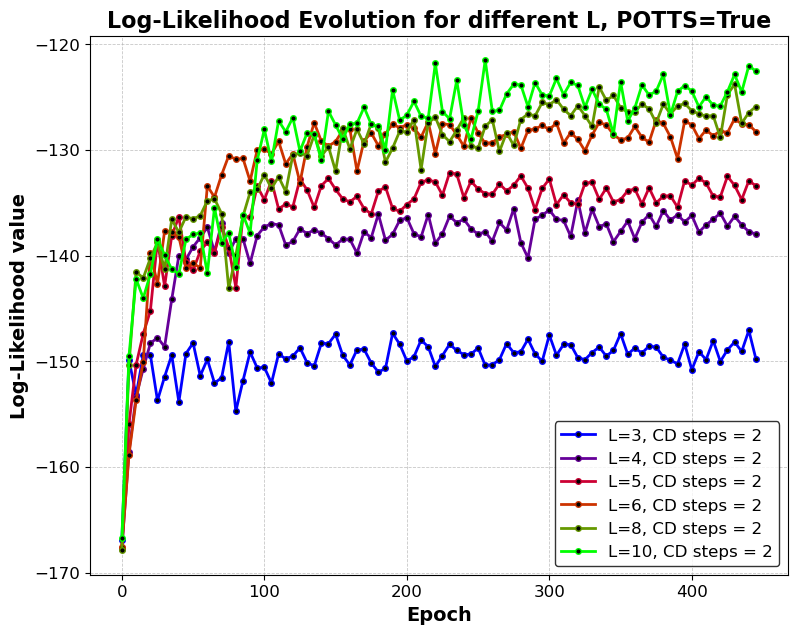

In [34]:
# drawing graphs
fig, ax1 = plt.subplots(1,1,figsize=(9,7))
num_epo=[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100, 105, 110, 115, 120, 125, 130, 135, 140, 145, 150, 155, 160, 165, 170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230, 235, 240, 245, 250, 255, 260, 265, 270, 275, 280, 285, 290, 295, 300, 305, 310, 315, 320, 325, 330, 335, 340, 345, 350, 355, 360, 365, 370, 375, 380, 385, 390, 395, 400, 405, 410, 415, 420, 425, 430, 435, 440, 445]
L_v=[3,4,5,6,8,10]

colors = plt.cm.brg(np.linspace(0, 1, len(log_like_potts)))
for i,log_like in enumerate(log_like_potts): # fixed CD steps=2
    ax1.plot(num_epo, log_like, label=f'L={L_v[i]}, CD steps = 2',linewidth=2, color=colors[i], marker='o',markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax1.set_title('Log-Likelihood Evolution for different L, POTTS=True', fontsize=16, fontweight='bold')
    ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    #ax1.set_xticks(num_epo)
    ax1.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

plt.show()


In [35]:
# Log-likelyhood after transient for different L and fixed CD steps = 4: stability check and mean; mean comparison for different L

log_like_potts_m=[]
log_like_potts_m_std=[]
Nepoch=450
num_epo=np.arange(Nepoch-10,Nepoch,1)
L_v=[3,4,5,6,8] ##Nt=4,
gamma=0.01
POTTS=True
    
    
for L in L_v:
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch


    log_like=[]
    log_like_std=[]
    for i in range(Nepoch-10,Nepoch,1):
        print(f'Epoch n.{i}')   ### è sbagliato il print 
        ll_iter= []
        for iter in range(5): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like.append(ll_mean)
        log_like_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_potts_m.append(log_like)
    log_like_potts_m_std.append(log_like_std)


a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.440


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13047.18it/s]


Log-likelihood= -147.2688066526187 +- 0.5232331529055225
Epoch n.441


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13037.15it/s]


Log-likelihood= -148.22592303956614 +- 0.4926299242680143
Epoch n.442


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13013.56it/s]


Log-likelihood= -147.75258204112438 +- 0.233174189199516
Epoch n.443


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12933.53it/s]


Log-likelihood= -148.13820656680275 +- 0.44403785923686095
Epoch n.444


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12950.67it/s]


Log-likelihood= -149.52763253776493 +- 0.6013571105551581
Epoch n.445


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13094.38it/s]


Log-likelihood= -148.54230360154136 +- 0.2732386937134813
Epoch n.446


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12868.22it/s]


Log-likelihood= -150.07897509551424 +- 0.16118458609291492
Epoch n.447


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 13101.70it/s]


Log-likelihood= -149.07787742135525 +- 0.5021640005442592
Epoch n.448


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12872.69it/s]


Log-likelihood= -148.938070348394 +- 0.4261383023473587
Epoch n.449


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 12802.32it/s]


Log-likelihood= -147.92807547446128 +- 0.17782525190599163
a_all L=4, Nt=4
b_all L=4, Nt=4
w_all L=4, Nt=4
Epoch n.440


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10042.54it/s]


Log-likelihood= -138.03762080136485 +- 0.40813931907416867
Epoch n.441


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10166.01it/s]


Log-likelihood= -137.3260540598933 +- 0.5657621504252331
Epoch n.442


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10309.19it/s]


Log-likelihood= -138.406212076499 +- 0.7052807559615732
Epoch n.443


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10254.52it/s]


Log-likelihood= -135.89216771842842 +- 0.5797190189335897
Epoch n.444


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10267.30it/s]


Log-likelihood= -137.22078230684275 +- 0.2966705996304934
Epoch n.445


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10150.77it/s]


Log-likelihood= -138.02540944944502 +- 0.8173604470776732
Epoch n.446


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10150.95it/s]


Log-likelihood= -135.20621364316747 +- 0.21167238824135853
Epoch n.447


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10110.16it/s]


Log-likelihood= -135.55683046922763 +- 0.5483531574503101
Epoch n.448


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10288.38it/s]


Log-likelihood= -136.40381013784253 +- 0.5536862384440929
Epoch n.449


Computing log-likelihood: 100%|██████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 10185.91it/s]


Log-likelihood= -137.96039138507743 +- 0.5759162496069137
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8047.06it/s]


Log-likelihood= -132.82266171538117 +- 0.47557707451431375
Epoch n.441


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8129.43it/s]


Log-likelihood= -133.96618272027 +- 0.4346112996190896
Epoch n.442


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8150.80it/s]


Log-likelihood= -133.2356417069946 +- 0.35253528994229666
Epoch n.443


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8022.64it/s]


Log-likelihood= -132.37147341762775 +- 0.8018900430305484
Epoch n.444


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8227.89it/s]


Log-likelihood= -133.94602305703762 +- 0.5154283170413856
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8190.62it/s]


Log-likelihood= -132.78658460691992 +- 0.10251150576067973
Epoch n.446


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8213.01it/s]


Log-likelihood= -133.99069129112647 +- 0.16987156635388984
Epoch n.447


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8224.49it/s]


Log-likelihood= -133.1829167020731 +- 0.25667756043681106
Epoch n.448


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8134.50it/s]


Log-likelihood= -132.754504300444 +- 0.3407376826192494
Epoch n.449


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 8019.28it/s]


Log-likelihood= -133.81761693099483 +- 0.5317009689838335
a_all L=6, Nt=4
b_all L=6, Nt=4
w_all L=6, Nt=4
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6702.28it/s]


Log-likelihood= -127.5602932357815 +- 0.6030448132898202
Epoch n.441


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6793.98it/s]


Log-likelihood= -128.7076528446224 +- 0.6212699335323623
Epoch n.442


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6787.59it/s]


Log-likelihood= -128.67269292613088 +- 0.36365861474667005
Epoch n.443


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6709.87it/s]


Log-likelihood= -127.64172073358804 +- 0.48149122040476683
Epoch n.444


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6841.51it/s]


Log-likelihood= -127.10766033694412 +- 0.35814589148906295
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6776.96it/s]


Log-likelihood= -127.75814314062575 +- 0.4661415297547675
Epoch n.446


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6770.08it/s]


Log-likelihood= -127.7231780928696 +- 0.4400968228811351
Epoch n.447


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6776.68it/s]


Log-likelihood= -127.91076831018162 +- 0.3000203272598412
Epoch n.448


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6933.19it/s]


Log-likelihood= -128.36761066041566 +- 0.8325251579540429
Epoch n.449


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:00<00:00, 6833.11it/s]


Log-likelihood= -128.350302456635 +- 0.5226210954184298
a_all L=8, Nt=4
b_all L=8, Nt=4
w_all L=8, Nt=4
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5183.65it/s]


Log-likelihood= -125.68476856540276 +- 0.41720221613924635
Epoch n.441


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5104.66it/s]


Log-likelihood= -128.1692417416317 +- 0.22961334692420757
Epoch n.442


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5103.20it/s]


Log-likelihood= -126.54131425584026 +- 0.7349736473420277
Epoch n.443


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5142.62it/s]


Log-likelihood= -125.91919994873156 +- 0.39881631400766765
Epoch n.444


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5143.12it/s]


Log-likelihood= -126.13104835384884 +- 0.6284866598511661
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5142.53it/s]


Log-likelihood= -124.93446160860947 +- 0.40357617476453866
Epoch n.446


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5169.32it/s]


Log-likelihood= -124.33648170506095 +- 0.8118996969281542
Epoch n.447


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5146.10it/s]


Log-likelihood= -128.00761702741863 +- 0.5606744783658413
Epoch n.448


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5179.08it/s]


Log-likelihood= -127.05097176720513 +- 0.4641308543634308
Epoch n.449


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 5135.13it/s]

Log-likelihood= -125.88400145161079 +- 0.46510841375451595


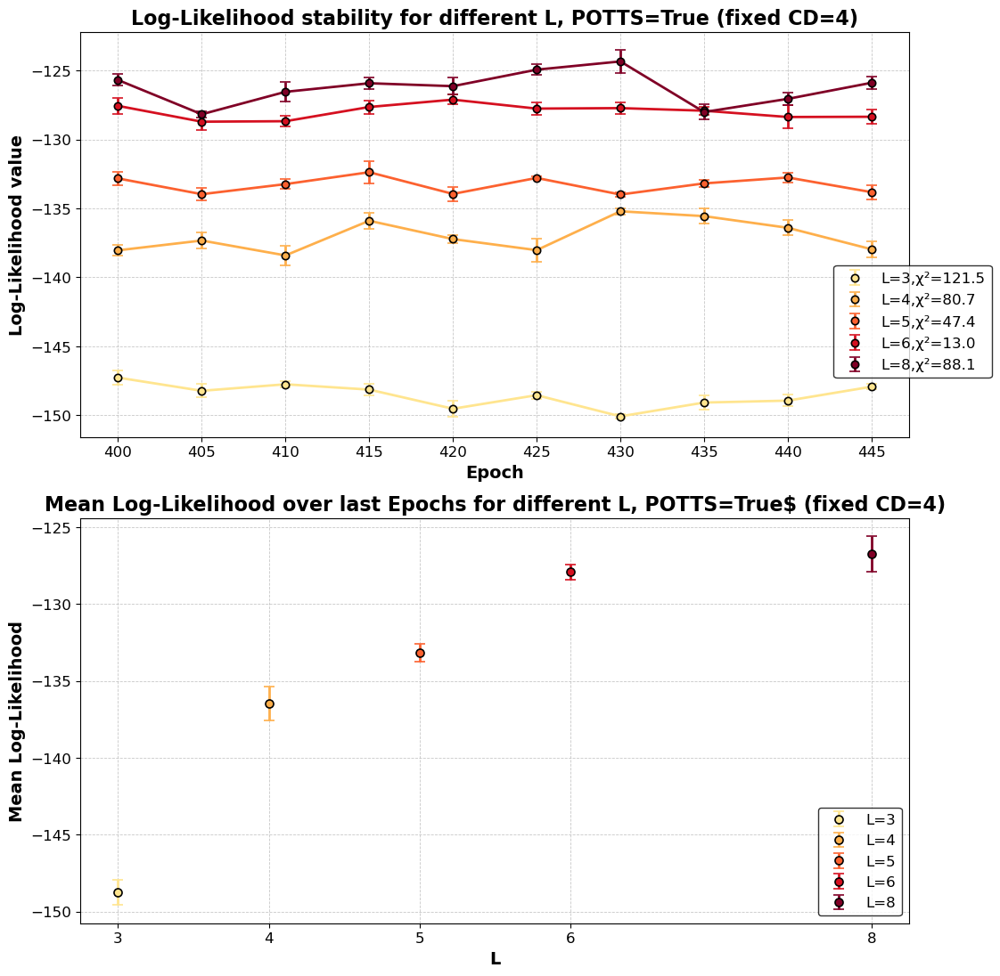

In [41]:
# variable gamma steps, fixed L=5 and CD steps=4
colors = plt.cm.YlOrRd(np.linspace(0.178, 1, len(log_like_potts_m)))
Nepoch=450
num_epo=np.arange(Nepoch-50,Nepoch,5)

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,13))

for i, log_like in enumerate(log_like_potts_m):
    weights = 1 / np.array(log_like_potts_m_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_potts_m_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_potts_m_std[i],fmt='o',color=colors[i],label=f'L={L_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(L_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'L={L_v[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
   

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different L, POTTS=True (fixed CD=4)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='center left', frameon=True, bbox_to_anchor=(0.9, 0.285), edgecolor='black')

ax2.set_xlabel('L', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last Epochs for different L, POTTS=True$ (fixed CD=4)', fontsize=16, fontweight='bold')
ax2.set_xticks(L_v)
#ax2.set_xticklabels([f'{tick:.1e}' for tick in gamma_v])
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

file_path = 'GRAPHS/log_like_gammas_plot.png'  # Path where you want to save the figure
fig.savefig(file_path, dpi=300, bbox_inches='tight')  # Save the figure as a .png file with high resolution


plt.show()